Problem Definition: The problem is to accurately identify and classify the weather conditions depicted in an image. This will include categories rain,cloudy,shine,sunrise.
Importance: This task is significant for various applications, such as climate research, meteorology, agriculture, and even in everyday applications like smart home systems or travel planning apps.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


import the necessary libraries in your Python script:

In [88]:
import cv2
import os
import shutil
from random import shuffle
import numpy as np
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, precision_recall_fscore_support
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.callbacks import EarlyStopping


AI Approaches for Problem Solving:

Machine Learning: Traditional machine learning techniques can be applied to this problem, such as support vector machines (SVMs).


Deep Learning: Convolutional Neural Networks (CNNs) are particularly suited for image recognition tasks. They can automatically learn the relevant features from the images without manual intervention.

Dataset Creation and Organization
Google Drive Setup:

We created a main project folder on Google Drive named "WeatherImageDataset."
Within this main folder, established four subfolders corresponding to each weather category: "Rain," "Cloudy," "Shine," and "Sunrise."

Preprocessing allows you to resize all images to the same size and convert them to grayscale to standardize the dataset and simplify the training process.
Below is a Python script that takes images from your specified source folders (each representing a weather category), preprocesses them by resizing and converting to grayscale, and then saves them to new corresponding folders.

In [ ]:
def preprocess_and_save_images(source_folder, target_folder, target_size=(64, 64)):
    """
    This function preprocesses images by resizing and converting them to grayscale
    and then saves them to a new folder structure.

    :param source_folder: The path to the source folder containing the categorized image subfolders.
    :param target_folder: The path to the target folder where the processed images will be saved.
    :param target_size: A tuple indicating the target size of the images, default is (64, 64).
    """
    categories = ['rain', 'cloudy', 'shine', 'sunrise']  # The weather categories

    for category in categories:
        # Define source and target directories for each category
        src_dir = os.path.join(source_folder, category)
        dest_dir = os.path.join(target_folder, category)
        os.makedirs(dest_dir, exist_ok=True)  # Create target directory if it doesn't exist

        for image_name in os.listdir(src_dir):
            image_path = os.path.join(src_dir, image_name)
            img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Read and convert to grayscale

            if img is not None:
                img_resized = cv2.resize(img, target_size)  # Resize the image if it's not empty
                # Save the preprocessed image in the corresponding target folder
                cv2.imwrite(os.path.join(dest_dir, image_name), img_resized)
            else:
                print(f"Warning: Image {image_path} could not be read and will be skipped.")

# Example usage - replace the paths with your actual paths
preprocess_and_save_images('/content/drive/MyDrive/WeatherImageDataset', '/content/drive/MyDrive/PreprocesWeatherImage')


In [ ]:
def split_dataset(source_folder, train_folder, test_folder, train_size=0.8):
    """
    Splits the dataset into training and testing sets.

    :param source_folder: The path to the source folder containing the categorized image subfolders.
    :param train_folder: The path to the folder where the training images will be stored.
    :param test_folder: The path to the folder where the testing images will be stored.
    :param train_size: The proportion of images to use for training (default is 0.8 for 80%).
    """
    categories = ['rain', 'cloudy', 'shine', 'sunrise']  # The weather categories

    for category in categories:
        category_path = os.path.join(source_folder, category)
        train_category_path = os.path.join(train_folder, category)
        test_category_path = os.path.join(test_folder, category)

        # Ensure the target directories exist
        os.makedirs(train_category_path, exist_ok=True)
        os.makedirs(test_category_path, exist_ok=True)

        # Get all image files in the current category
        images = [img for img in os.listdir(category_path) if img.lower().endswith(('.png', '.jpg', '.jpeg'))]
        shuffle(images)  # Randomize the order of images

        # Split the images based on the train_size
        split_index = int(len(images) * train_size)
        train_images = images[:split_index]
        test_images = images[split_index:]

        # Copy the images to the respective training and testing directories
        for img in train_images:
            shutil.copy(os.path.join(category_path, img), os.path.join(train_category_path, img))

        for img in test_images:
            shutil.copy(os.path.join(category_path, img), os.path.join(test_category_path, img))

# Example usage - replace the paths with your actual paths
split_dataset('/content/drive/MyDrive/PreprocesWeatherImage',
              '/content/drive/MyDrive/WeatherImageDataset/Training',
              '/content/drive/MyDrive/WeatherImageDataset/Testing')

In [ ]:
# Load and preprocess data
def load_images_from_folder(folder):
    images = []
    labels = []
    for label in os.listdir(folder):
        label_folder = os.path.join(folder, label)
        for filename in os.listdir(label_folder):
            img_path = os.path.join(label_folder, filename)
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            if img is not None:
                # Flatten the image into a one-dimensional vector
                img_flattened = img.flatten()
                images.append(img_flattened)
                labels.append(label)
    return images, labels

# Load your dataset
X_train, y_train = load_images_from_folder('/content/drive/MyDrive/WeatherImageDataset/Training')
X_test, y_test = load_images_from_folder('/content/drive/MyDrive/WeatherImageDataset/Testing')

# Convert lists to arrays
X_train = np.array(X_train)
X_test = np.array(X_test)

# Encode labels
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Create and train the SVM model
model = svm.SVC(kernel='linear')  # You can experiment with different kernels.
model.fit(X_train, y_train_encoded)

# Predict on the test set
y_pred = model.predict(X_test)

# Evaluate the model
print(f"Accuracy: {accuracy_score(y_test_encoded, y_pred)}")
print(classification_report(y_test_encoded, y_pred, target_names=label_encoder.classes_))

Accuracy: 0.584070796460177
              precision    recall  f1-score   support

      cloudy       0.43      0.48      0.45        60
        rain       0.62      0.49      0.55        43
       shine       0.79      0.61      0.69        51
     sunrise       0.60      0.71      0.65        72

    accuracy                           0.58       226
   macro avg       0.61      0.57      0.58       226
weighted avg       0.60      0.58      0.59       226



Manual Testing with Individual Images
To manually test the model with a new image, you'll need to preprocess the image similarly to how you processed the training and testing images, and then use the model to predict its category.

In [ ]:
def preprocess_and_predict(image_path, model, label_encoder):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print("Image not loaded correctly.")
        return

    img_resized = cv2.resize(img, (64, 64))  # Resize to match the input size of the model
    img_flattened = img_resized.flatten().reshape(1, -1)  # Flatten and reshape for the model

    prediction = model.predict(img_flattened)
    predicted_label = label_encoder.inverse_transform(prediction)
    return predicted_label[0]

# Example usage:
image_path = '/content/drive/MyDrive/WeatherImageDataset/Training/rain/rain101.jpg'
predicted_category = preprocess_and_predict(image_path, model, label_encoder)
print(f"The predicted category is: {predicted_category}")

The predicted category is: rain


 Convolutional Neural Network (CNN) model

In [ ]:
# Define the CNN architecture
model = models.Sequential([
    # Convolutional layer with 32 filters, a kernel size of 3, ReLU activation, and input shape defined
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 1)),
    layers.MaxPooling2D((2, 2)),
    # Second convolutional layer with 64 filters
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    # Third convolutional layer with 64 filters
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    # Output layer with 4 neurons (for 4 classes) with softmax activation
    layers.Dense(4, activation='softmax'),
])

model.summary()  # Display the architecture of the model

# Compile the model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 31, 31, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 14, 14, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 12, 12, 64)        36928     
                                                                 
 flatten (Flatten)           (None, 9216)              0

In [ ]:
# Rescale pixel values from [0, 255] to [0, 1]
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)  # using 20% of data for validation

# Load images from directories
train_generator = train_datagen.flow_from_directory(
        '/content/drive/MyDrive/WeatherImageDataset/Training',  # Training directory
        target_size=(64, 64),  # Resize images to 64x64
        batch_size=32,
        color_mode='grayscale',  # Images are in grayscale
        class_mode='sparse',  # Sparse labels
        subset='training')  # Specify this is training data

validation_generator = train_datagen.flow_from_directory(
        '/content/drive/MyDrive/WeatherImageDataset/Training',  # Validation directory (same as training in this case, using subset)
        target_size=(64, 64),
        batch_size=32,
        color_mode='grayscale',
        class_mode='sparse',
        subset='validation')  # Specify this is validation data

Found 718 images belonging to 4 classes.
Found 179 images belonging to 4 classes.


In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,  # Number of epochs to train for
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size)

Epoch 1/10
22/22 [==============================] - 9s 369ms/step - loss: 1.3216 - accuracy: 0.3601 - val_loss: 1.1785 - val_accuracy: 0.4500
Epoch 2/10
22/22 [==============================] - 6s 291ms/step - loss: 1.1244 - accuracy: 0.4854 - val_loss: 1.0685 - val_accuracy: 0.5625
Epoch 3/10
22/22 [==============================] - 8s 379ms/step - loss: 1.0303 - accuracy: 0.5394 - val_loss: 1.0520 - val_accuracy: 0.5188
Epoch 4/10
22/22 [==============================] - 8s 344ms/step - loss: 0.9866 - accuracy: 0.5860 - val_loss: 1.0974 - val_accuracy: 0.5375
Epoch 5/10
22/22 [==============================] - 6s 282ms/step - loss: 0.9178 - accuracy: 0.6151 - val_loss: 1.0381 - val_accuracy: 0.5312
Epoch 6/10
22/22 [==============================] - 8s 367ms/step - loss: 0.8502 - accuracy: 0.6516 - val_loss: 1.0747 - val_accuracy: 0.5437
Epoch 7/10
22/22 [==============================] - 7s 304ms/step - loss: 0.7280 - accuracy: 0.7055 - val_loss: 1.1220 - val_accuracy: 0.5437
Epoch 

In [ ]:
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
        '/content/drive/MyDrive/WeatherImageDataset/Testing',  # Test directory
        target_size=(64, 64),
        batch_size=32,
        color_mode='grayscale',  # If your model was trained on grayscale images
        class_mode='sparse',  # If your labels are integer encoded
        shuffle=False)  # Do not shuffle the data for evaluation

Found 226 images belonging to 4 classes.


In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=test_generator.samples // test_generator.batch_size)
print(f"Test accuracy: {test_accuracy}")

7/7 [==============================] - 1s 173ms/step - loss: 0.8852 - accuracy: 0.6830
Test accuracy: 0.6830357313156128


Manual Testing

In [ ]:
def make_prediction(image_path, model):
    img = image.load_img(image_path, target_size=(64, 64), color_mode='grayscale')
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Create a batch
    img_array /= 255.0  # Rescale the image values to [0, 1]

    prediction = model.predict(img_array)
    predicted_class = np.argmax(prediction, axis=1)
    return predicted_class

predicted_class = make_prediction('/path/to/your/image.jpg', model)
print(f"Predicted class: {predicted_class}")

In [ ]:
def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image.flatten())
                labels.append(category)


    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data
    X_train, X_test, y_train, y_test = train_test_split(
        np.array(data), encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train, y_train)
    svm_predictions = svm_model.predict(X_test)
    svm_accuracy = accuracy_score(y_test, svm_predictions)
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test, svm_predictions, target_names=label_encoder.classes_))

    # CNN model
    cnn_model = models.Sequential([
        # Adjust the input_shape to match the target_size
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 1)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax'),
    ])


    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    # Reshape data for CNN
    X_train_cnn = X_train.reshape((-1, target_size[0], target_size[1], 1))
    X_test_cnn = X_test.reshape((-1, target_size[0], target_size[1], 1))

    cnn_model.fit(X_train_cnn, y_train, epochs=10, validation_split=0.2)
    cnn_predictions = cnn_model.evaluate(X_test_cnn, y_test)
    print(f"CNN Accuracy: {cnn_predictions[1]}")

    return svm_accuracy, cnn_predictions[1]

for i in range (64,100):
  print(train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset',(i,i)))

SVM Accuracy: 0.6577777777777778
              precision    recall  f1-score   support

      cloudy       0.52      0.57      0.54        60
        rain       0.63      0.58      0.60        45
       shine       0.77      0.70      0.73        53
     sunrise       0.73      0.76      0.74        67

    accuracy                           0.66       225
   macro avg       0.66      0.65      0.66       225
weighted avg       0.66      0.66      0.66       225

Epoch 1/10
23/23 [==============================] - 11s 385ms/step - loss: 9.2055 - accuracy: 0.3287 - val_loss: 1.4159 - val_accuracy: 0.3500
Epoch 2/10
23/23 [==============================] - 6s 254ms/step - loss: 1.1775 - accuracy: 0.4429 - val_loss: 1.2117 - val_accuracy: 0.4333
Epoch 3/10
23/23 [==============================] - 5s 199ms/step - loss: 1.0632 - accuracy: 0.5404 - val_loss: 1.2870 - val_accuracy: 0.4611
Epoch 4/10
23/23 [==============================] - 4s 177ms/step - loss: 0.8733 - accuracy: 0.6407 - val

In [ ]:
def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path)
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image)
                labels.append(category)

    # Convert lists to numpy arrays
    data = np.array(data)
    labels = np.array(labels)

    # Flatten the data for SVM
    data_flattened = data.reshape(data.shape[0], -1)

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data for SVM
    X_train_svm, X_test_svm, y_train_svm, y_test_svm = train_test_split(
        data_flattened, encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train_svm, y_train_svm)
    svm_predictions = svm_model.predict(X_test_svm)
    svm_accuracy = accuracy_score(y_test_svm, svm_predictions)
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test_svm, svm_predictions, target_names=label_encoder.classes_))

    # Split data for CNN (no flattening needed here)
    X_train_cnn, X_test_cnn, y_train_cnn, y_test_cnn = train_test_split(
        data, encoded_labels, test_size=0.2, random_state=42)

    # CNN model
    cnn_model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax'),
    ])

    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    cnn_model.fit(X_train_cnn, y_train_cnn, epochs=10, validation_split=0.2)
    cnn_predictions = cnn_model.evaluate(X_test_cnn, y_test_cnn)
    print(f"CNN Accuracy: {cnn_predictions[1]}")

    return svm_accuracy, cnn_predictions[1]

# Example usage
train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset')

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.78      0.78      0.78        45
       shine       0.88      0.83      0.85        53
     sunrise       0.98      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.83      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 289ms/step - loss: 22.0761 - accuracy: 0.4986 - val_loss: 1.5845 - val_accuracy: 0.7167
Epoch 2/10
23/23 [==============================] - 7s 289ms/step - loss: 0.7029 - accuracy: 0.7201 - val_loss: 1.1867 - val_accuracy: 0.7556
Epoch 3/10
23/23 [==============================] - 4s 173ms/step - loss: 0.5777 - accuracy: 0.8050 - val_loss: 1.0335 - val_accuracy: 0.8056
Epoch 4/10
23/23 [==============================] - 4s 172ms/step - loss: 0.5058 - accuracy: 0.8092 - val

(0.8311111111111111, 0.8533333539962769)

SVM Accuracy: 0.6577777777777778
              precision    recall  f1-score   support

      cloudy       0.52      0.57      0.54        60
        rain       0.63      0.58      0.60        45
       shine       0.77      0.70      0.73        53
     sunrise       0.73      0.76      0.74        67

    accuracy                           0.66       225
   macro avg       0.66      0.65      0.66       225
weighted avg       0.66      0.66      0.66       225

Epoch 1/10
23/23 [==============================] - 5s 168ms/step - loss: 15.4510 - accuracy: 0.3064 - val_loss: 1.2226 - val_accuracy: 0.4000
Epoch 2/10
23/23 [==============================] - 6s 285ms/step - loss: 1.1401 - accuracy: 0.5209 - val_loss: 1.0890 - val_accuracy: 0.5333
Epoch 3/10
23/23 [==============================] - 5s 233ms/step - loss: 0.9275 - accuracy: 0.6267 - val_loss: 1.1676 - val_accuracy: 0.5167
Epoch 4/10
23/23 [==============================] - 7s 307ms/step - loss: 0.7569 - accuracy: 0.7061 - val

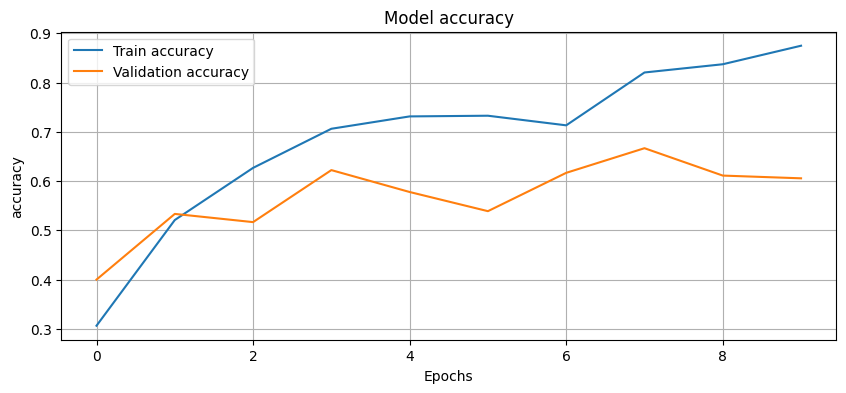

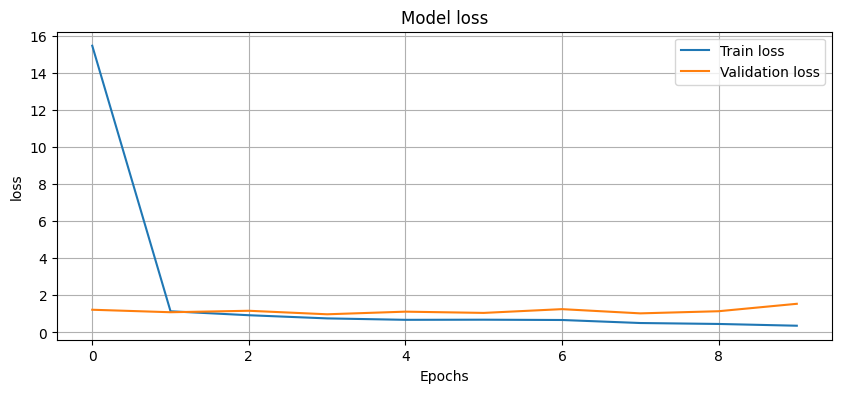

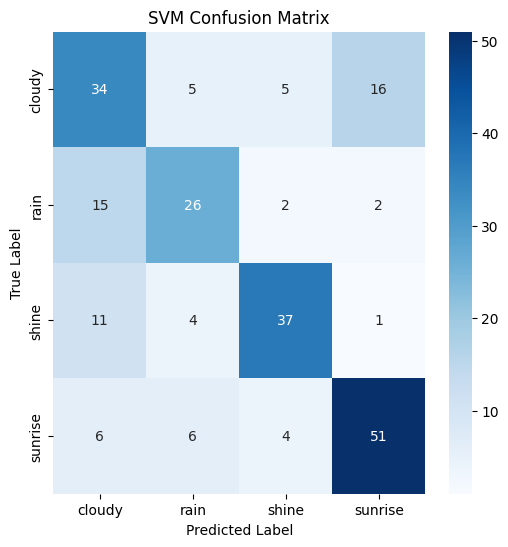

Epoch 1/10
23/23 [==============================] - 5s 222ms/step - loss: 0.2066 - accuracy: 0.9304 - val_loss: 1.2610 - val_accuracy: 0.6556
Epoch 2/10
23/23 [==============================] - 4s 157ms/step - loss: 0.2163 - accuracy: 0.9290 - val_loss: 1.4326 - val_accuracy: 0.6778
Epoch 3/10
23/23 [==============================] - 4s 160ms/step - loss: 0.1057 - accuracy: 0.9708 - val_loss: 1.3766 - val_accuracy: 0.6889
Epoch 4/10
23/23 [==============================] - 5s 242ms/step - loss: 0.0495 - accuracy: 0.9861 - val_loss: 1.5817 - val_accuracy: 0.6778
Epoch 5/10
23/23 [==============================] - 4s 165ms/step - loss: 0.0691 - accuracy: 0.9749 - val_loss: 1.2966 - val_accuracy: 0.7000
Epoch 6/10
23/23 [==============================] - 4s 165ms/step - loss: 0.0668 - accuracy: 0.9847 - val_loss: 1.7494 - val_accuracy: 0.6778
Epoch 7/10
23/23 [==============================] - 5s 220ms/step - loss: 0.0622 - accuracy: 0.9833 - val_loss: 1.5280 - val_accuracy: 0.7000
Epoch 

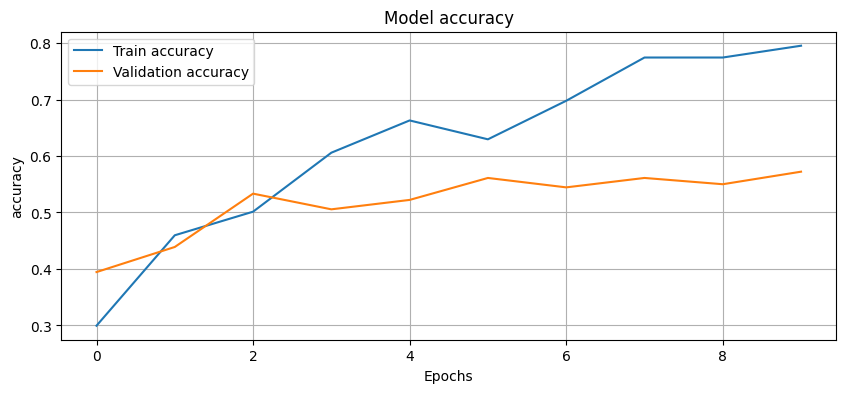

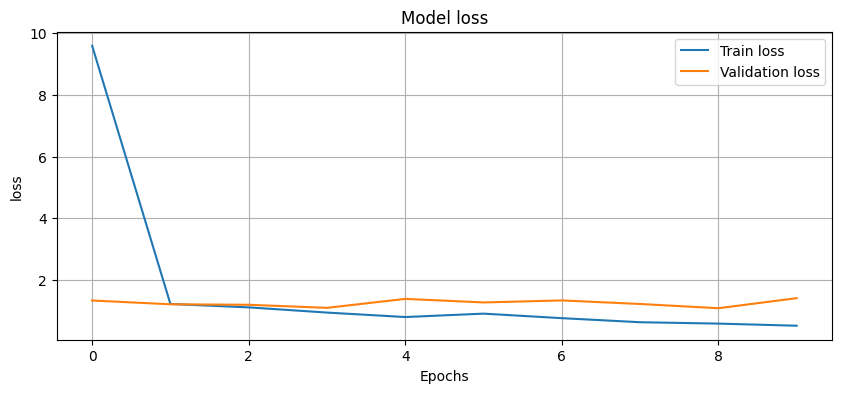

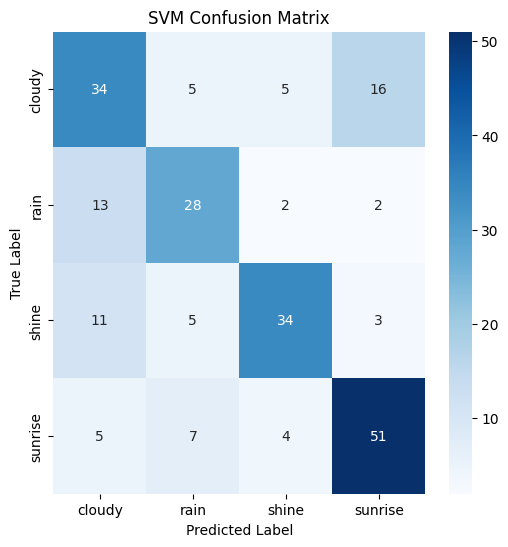

Epoch 1/10
23/23 [==============================] - 6s 255ms/step - loss: 0.4274 - accuracy: 0.8496 - val_loss: 1.3539 - val_accuracy: 0.6111
Epoch 2/10
23/23 [==============================] - 4s 170ms/step - loss: 0.5813 - accuracy: 0.7827 - val_loss: 1.9745 - val_accuracy: 0.5389
Epoch 3/10
23/23 [==============================] - 4s 164ms/step - loss: 0.3752 - accuracy: 0.8663 - val_loss: 1.6221 - val_accuracy: 0.5611
Epoch 4/10
23/23 [==============================] - 4s 188ms/step - loss: 0.3311 - accuracy: 0.8830 - val_loss: 2.0804 - val_accuracy: 0.6056
Epoch 5/10
23/23 [==============================] - 5s 210ms/step - loss: 0.3323 - accuracy: 0.8872 - val_loss: 1.7332 - val_accuracy: 0.5500
Epoch 6/10
23/23 [==============================] - 4s 162ms/step - loss: 0.2675 - accuracy: 0.8969 - val_loss: 1.6145 - val_accuracy: 0.5833
Epoch 7/10
23/23 [==============================] - 4s 167ms/step - loss: 0.2472 - accuracy: 0.9095 - val_loss: 1.7300 - val_accuracy: 0.5889
Epoch 

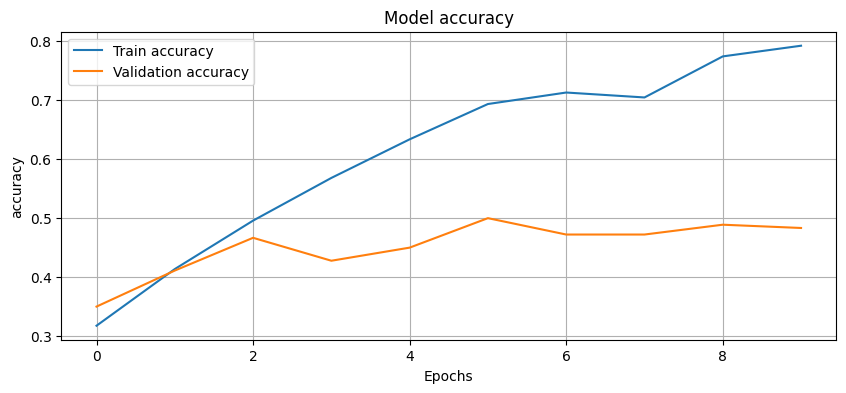

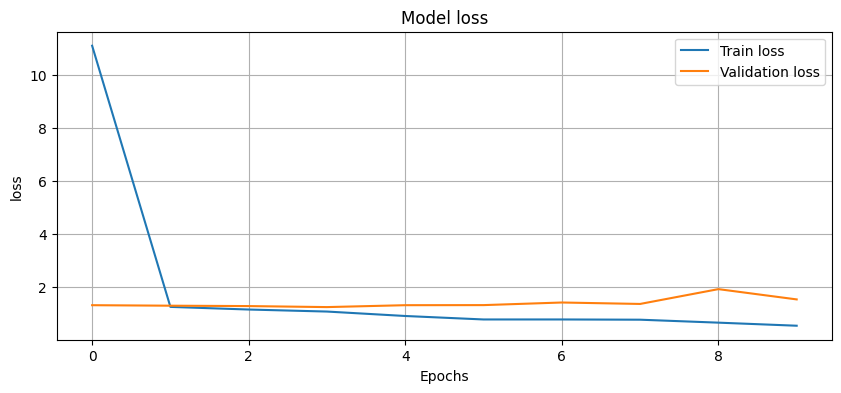

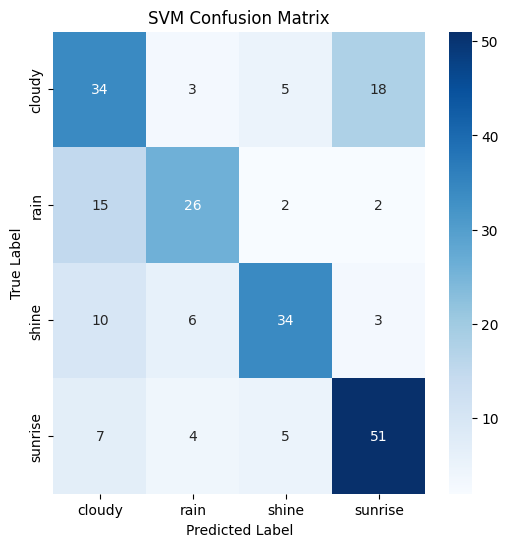

Epoch 1/10
23/23 [==============================] - 4s 166ms/step - loss: 0.5009 - accuracy: 0.7994 - val_loss: 2.0026 - val_accuracy: 0.5222
Epoch 2/10
23/23 [==============================] - 5s 226ms/step - loss: 0.5365 - accuracy: 0.7967 - val_loss: 2.0498 - val_accuracy: 0.5278
Epoch 3/10
23/23 [==============================] - 4s 177ms/step - loss: 0.4725 - accuracy: 0.8287 - val_loss: 1.9953 - val_accuracy: 0.5222
Epoch 4/10
23/23 [==============================] - 4s 164ms/step - loss: 0.3650 - accuracy: 0.8858 - val_loss: 2.7943 - val_accuracy: 0.5167
Epoch 5/10
23/23 [==============================] - 5s 202ms/step - loss: 0.2443 - accuracy: 0.9053 - val_loss: 2.3352 - val_accuracy: 0.5500
Epoch 6/10
23/23 [==============================] - 5s 203ms/step - loss: 0.1799 - accuracy: 0.9401 - val_loss: 3.1228 - val_accuracy: 0.5611
Epoch 7/10
23/23 [==============================] - 4s 165ms/step - loss: 0.1464 - accuracy: 0.9554 - val_loss: 7.8882 - val_accuracy: 0.3889
Epoch 

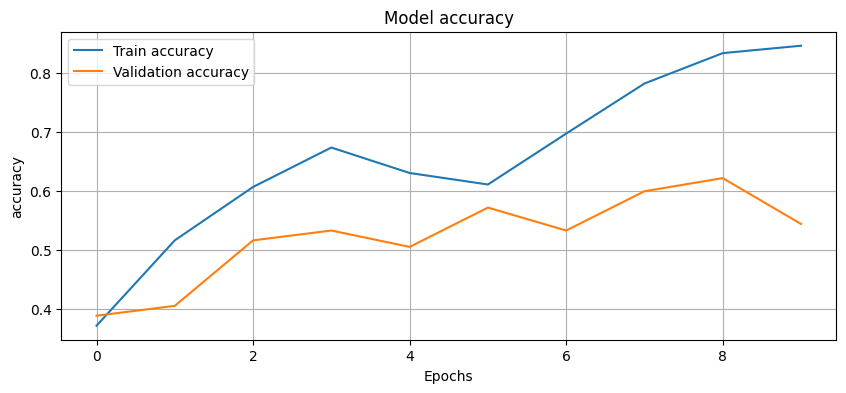

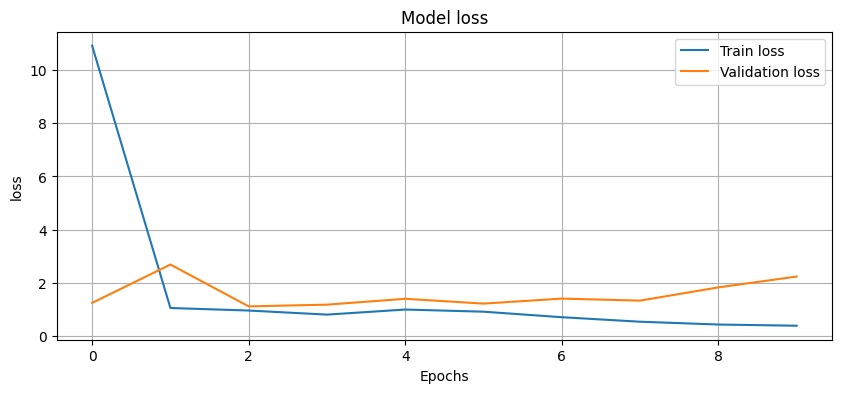

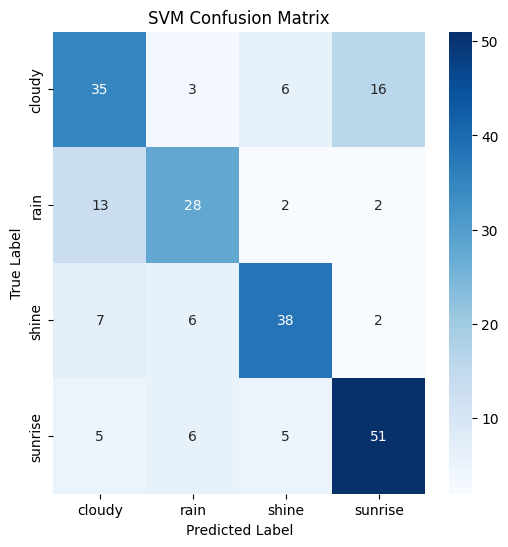

Epoch 1/10
23/23 [==============================] - 6s 247ms/step - loss: 0.3280 - accuracy: 0.8858 - val_loss: 1.8442 - val_accuracy: 0.5278
Epoch 2/10
23/23 [==============================] - 4s 168ms/step - loss: 0.3484 - accuracy: 0.8872 - val_loss: 2.1026 - val_accuracy: 0.5722
Epoch 3/10
23/23 [==============================] - 4s 168ms/step - loss: 0.2427 - accuracy: 0.9067 - val_loss: 2.2566 - val_accuracy: 0.6056
Epoch 4/10
23/23 [==============================] - 6s 248ms/step - loss: 0.1830 - accuracy: 0.9499 - val_loss: 2.0795 - val_accuracy: 0.5944
Epoch 5/10
23/23 [==============================] - 4s 166ms/step - loss: 0.2165 - accuracy: 0.9220 - val_loss: 2.2792 - val_accuracy: 0.5611
Epoch 6/10
23/23 [==============================] - 4s 167ms/step - loss: 0.2197 - accuracy: 0.9290 - val_loss: 2.3411 - val_accuracy: 0.6111
Epoch 7/10
23/23 [==============================] - 5s 222ms/step - loss: 0.0969 - accuracy: 0.9652 - val_loss: 2.8192 - val_accuracy: 0.5944
Epoch 

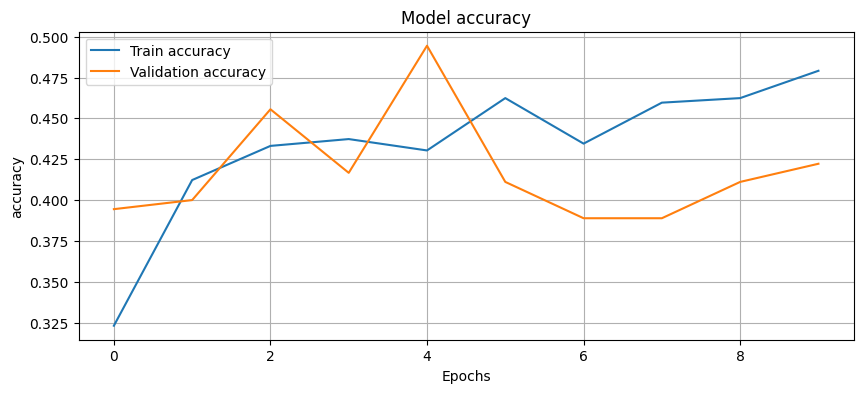

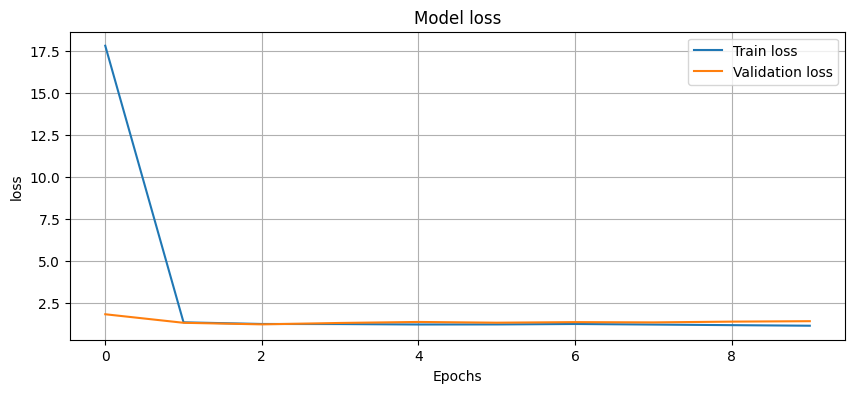

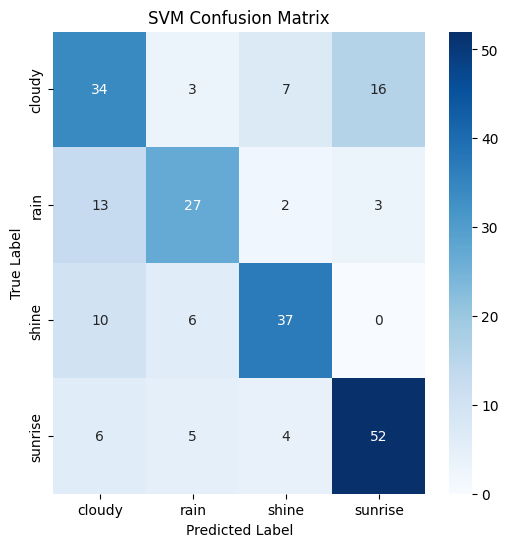

Epoch 1/10
23/23 [==============================] - 4s 175ms/step - loss: 1.1576 - accuracy: 0.4777 - val_loss: 1.2507 - val_accuracy: 0.4333
Epoch 2/10
23/23 [==============================] - 6s 253ms/step - loss: 1.1199 - accuracy: 0.4819 - val_loss: 1.3512 - val_accuracy: 0.3944
Epoch 3/10
23/23 [==============================] - 4s 176ms/step - loss: 1.1130 - accuracy: 0.4847 - val_loss: 1.2975 - val_accuracy: 0.4333
Epoch 4/10
23/23 [==============================] - 4s 178ms/step - loss: 1.0875 - accuracy: 0.4889 - val_loss: 1.2609 - val_accuracy: 0.4222
Epoch 5/10
23/23 [==============================] - 6s 249ms/step - loss: 1.1112 - accuracy: 0.4916 - val_loss: 1.3111 - val_accuracy: 0.4167
Epoch 6/10
23/23 [==============================] - 4s 172ms/step - loss: 1.1257 - accuracy: 0.4666 - val_loss: 1.2798 - val_accuracy: 0.4611
Epoch 7/10
23/23 [==============================] - 4s 175ms/step - loss: 1.0590 - accuracy: 0.4958 - val_loss: 1.3099 - val_accuracy: 0.4111
Epoch 

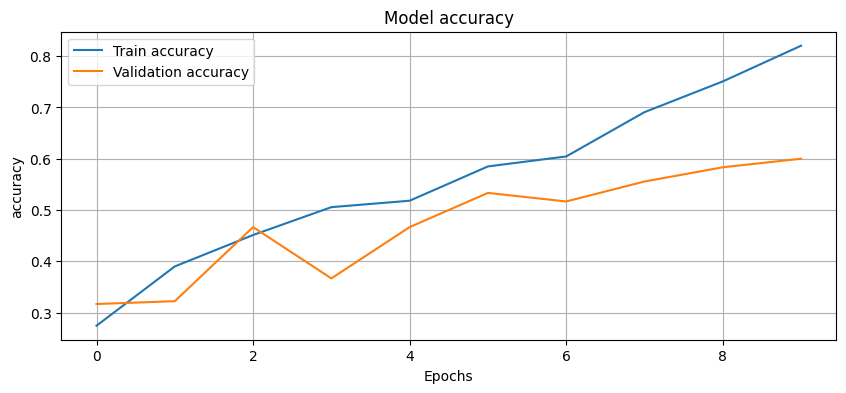

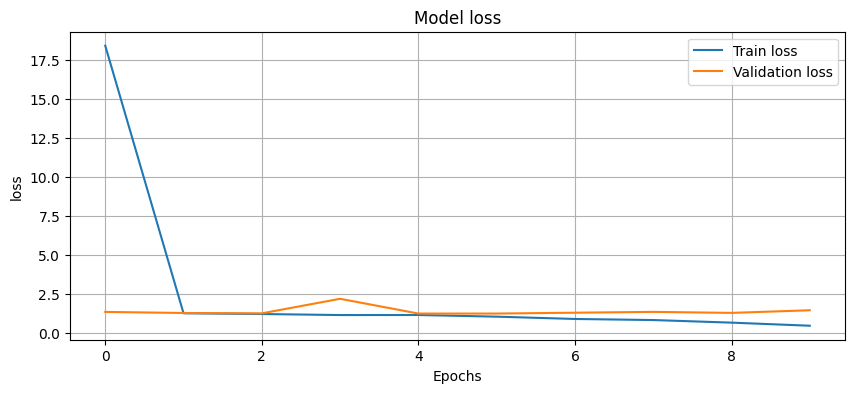

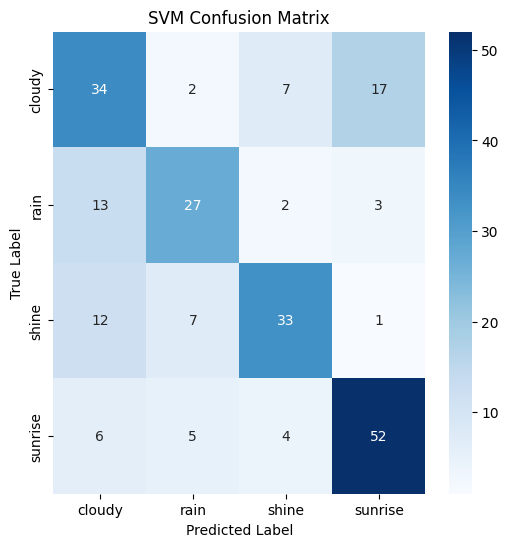

Epoch 1/10
23/23 [==============================] - 5s 215ms/step - loss: 0.4007 - accuracy: 0.8621 - val_loss: 1.6043 - val_accuracy: 0.6333
Epoch 2/10
23/23 [==============================] - 4s 176ms/step - loss: 0.2778 - accuracy: 0.9123 - val_loss: 1.4044 - val_accuracy: 0.6556
Epoch 3/10
23/23 [==============================] - 5s 208ms/step - loss: 0.1596 - accuracy: 0.9499 - val_loss: 1.5660 - val_accuracy: 0.6556
Epoch 4/10
23/23 [==============================] - 5s 220ms/step - loss: 0.1403 - accuracy: 0.9610 - val_loss: 1.7088 - val_accuracy: 0.6389
Epoch 5/10
23/23 [==============================] - 4s 176ms/step - loss: 0.0836 - accuracy: 0.9805 - val_loss: 1.6741 - val_accuracy: 0.6667
Epoch 6/10
23/23 [==============================] - 4s 190ms/step - loss: 0.0730 - accuracy: 0.9861 - val_loss: 1.9725 - val_accuracy: 0.6444
Epoch 7/10
23/23 [==============================] - 5s 233ms/step - loss: 0.0490 - accuracy: 0.9930 - val_loss: 1.9915 - val_accuracy: 0.6722
Epoch 

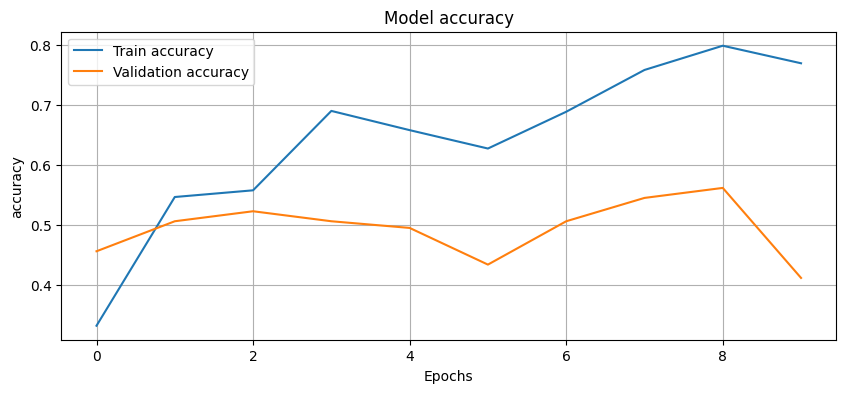

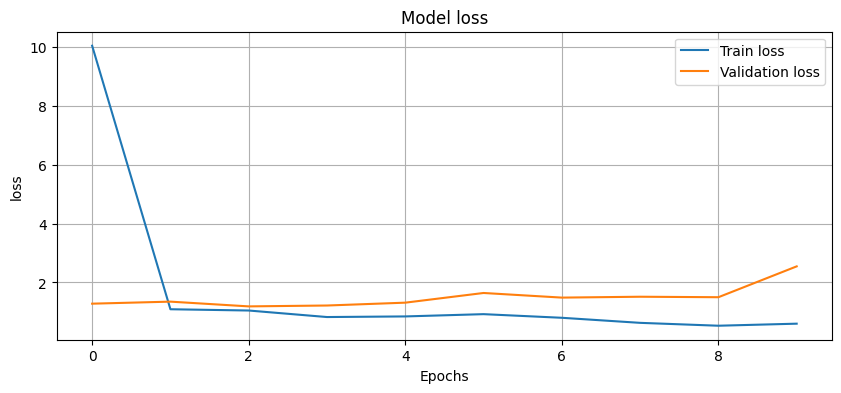

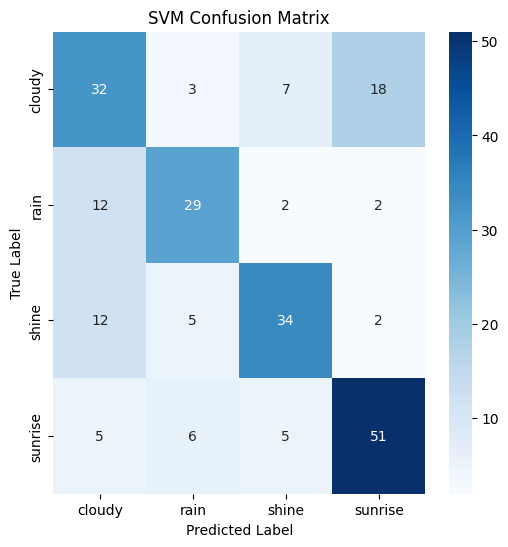

Epoch 1/10
23/23 [==============================] - 6s 244ms/step - loss: 0.8008 - accuracy: 0.7019 - val_loss: 1.6010 - val_accuracy: 0.5056
Epoch 2/10
23/23 [==============================] - 5s 207ms/step - loss: 0.6169 - accuracy: 0.7577 - val_loss: 2.0074 - val_accuracy: 0.5389
Epoch 3/10
23/23 [==============================] - 4s 189ms/step - loss: 0.5076 - accuracy: 0.8064 - val_loss: 2.0310 - val_accuracy: 0.5500
Epoch 4/10
23/23 [==============================] - 6s 260ms/step - loss: 0.3549 - accuracy: 0.8607 - val_loss: 2.3360 - val_accuracy: 0.5667
Epoch 5/10
23/23 [==============================] - 5s 193ms/step - loss: 0.2605 - accuracy: 0.9025 - val_loss: 1.8178 - val_accuracy: 0.5889
Epoch 6/10
23/23 [==============================] - 4s 191ms/step - loss: 0.2188 - accuracy: 0.9248 - val_loss: 2.2551 - val_accuracy: 0.6056
Epoch 7/10
23/23 [==============================] - 6s 267ms/step - loss: 0.1740 - accuracy: 0.9499 - val_loss: 2.4183 - val_accuracy: 0.5444
Epoch 

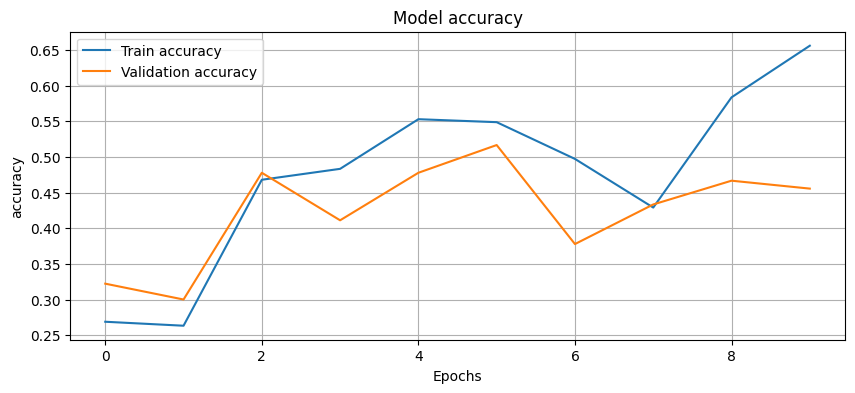

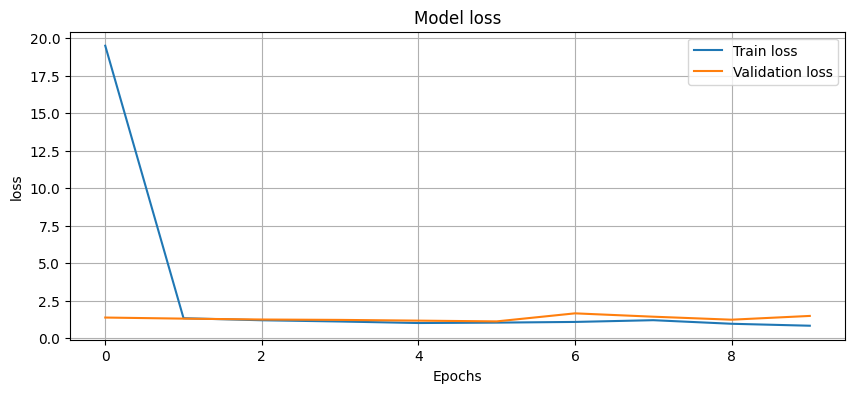

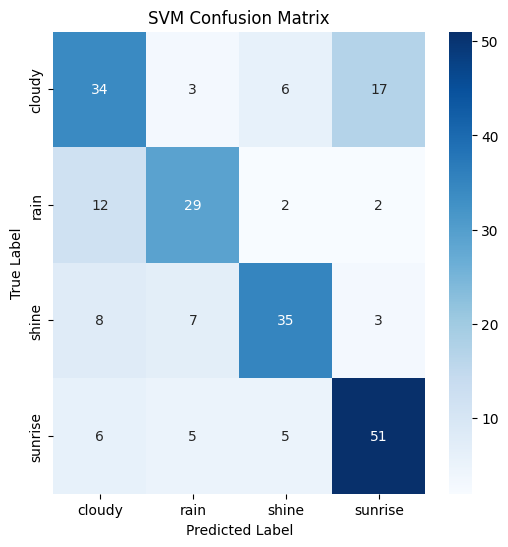

Epoch 1/10
23/23 [==============================] - 5s 240ms/step - loss: 0.7220 - accuracy: 0.7396 - val_loss: 1.4029 - val_accuracy: 0.5389
Epoch 2/10
23/23 [==============================] - 5s 220ms/step - loss: 0.5986 - accuracy: 0.7869 - val_loss: 1.5438 - val_accuracy: 0.5333
Epoch 3/10
23/23 [==============================] - 4s 190ms/step - loss: 0.4816 - accuracy: 0.8245 - val_loss: 1.8513 - val_accuracy: 0.5778
Epoch 4/10
23/23 [==============================] - 6s 259ms/step - loss: 0.4498 - accuracy: 0.8496 - val_loss: 3.2435 - val_accuracy: 0.5389
Epoch 5/10
23/23 [==============================] - 5s 197ms/step - loss: 0.6004 - accuracy: 0.7535 - val_loss: 1.8859 - val_accuracy: 0.5222
Epoch 6/10
23/23 [==============================] - 4s 192ms/step - loss: 0.3865 - accuracy: 0.8510 - val_loss: 2.2835 - val_accuracy: 0.5556
Epoch 7/10
23/23 [==============================] - 6s 268ms/step - loss: 0.3208 - accuracy: 0.8955 - val_loss: 2.0567 - val_accuracy: 0.5000
Epoch 

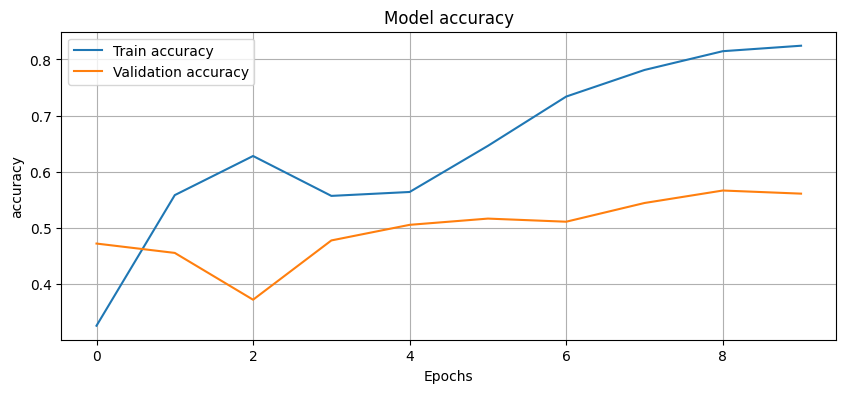

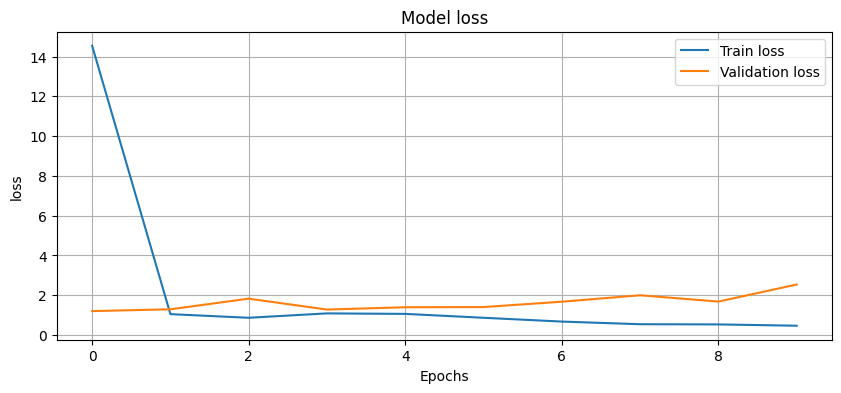

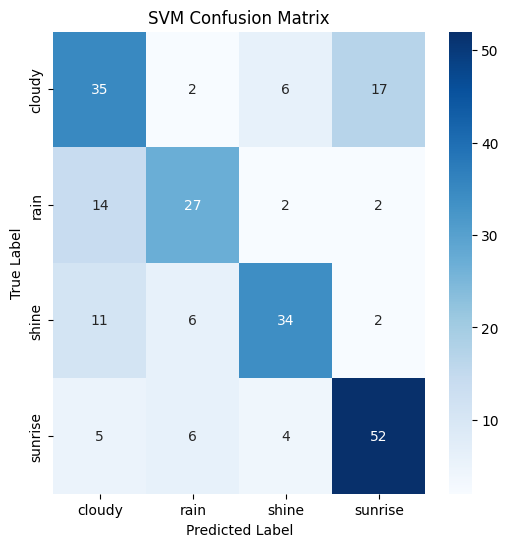

Epoch 1/10
23/23 [==============================] - 6s 237ms/step - loss: 0.3546 - accuracy: 0.8760 - val_loss: 2.3243 - val_accuracy: 0.5444
Epoch 2/10
23/23 [==============================] - 5s 201ms/step - loss: 0.3256 - accuracy: 0.8858 - val_loss: 2.6712 - val_accuracy: 0.5833
Epoch 3/10
23/23 [==============================] - 7s 291ms/step - loss: 0.2178 - accuracy: 0.9234 - val_loss: 2.7394 - val_accuracy: 0.5722
Epoch 4/10
23/23 [==============================] - 5s 203ms/step - loss: 0.1817 - accuracy: 0.9401 - val_loss: 3.3458 - val_accuracy: 0.6278
Epoch 5/10
23/23 [==============================] - 5s 200ms/step - loss: 0.2049 - accuracy: 0.9331 - val_loss: 2.8145 - val_accuracy: 0.5944
Epoch 6/10
23/23 [==============================] - 6s 274ms/step - loss: 0.1538 - accuracy: 0.9540 - val_loss: 2.4757 - val_accuracy: 0.5778
Epoch 7/10
23/23 [==============================] - 5s 203ms/step - loss: 0.1278 - accuracy: 0.9666 - val_loss: 3.4262 - val_accuracy: 0.5833
Epoch 

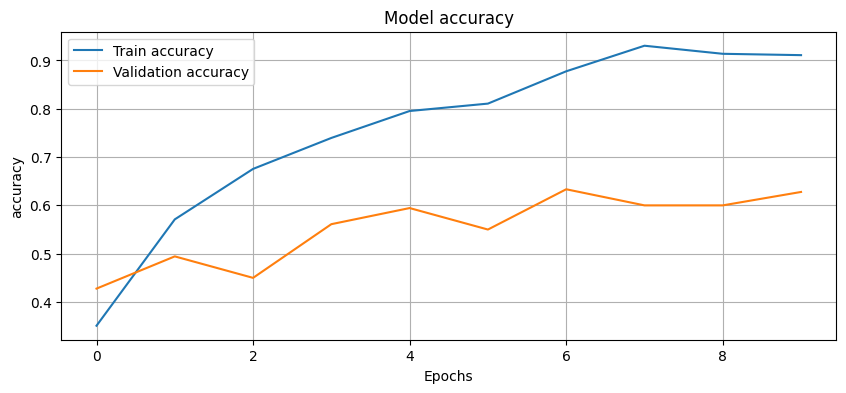

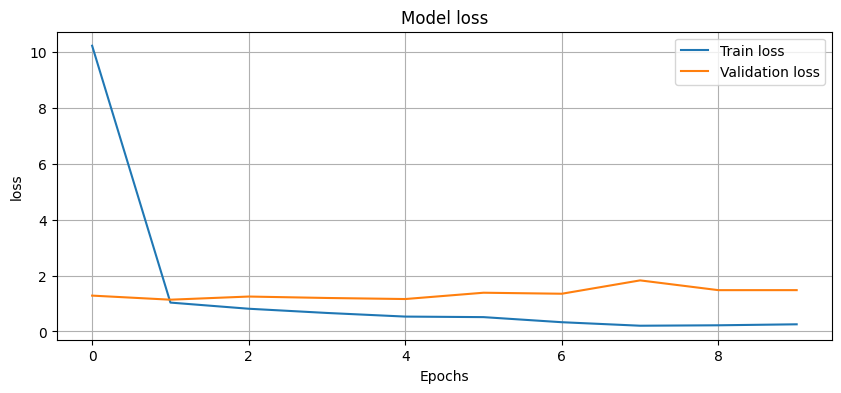

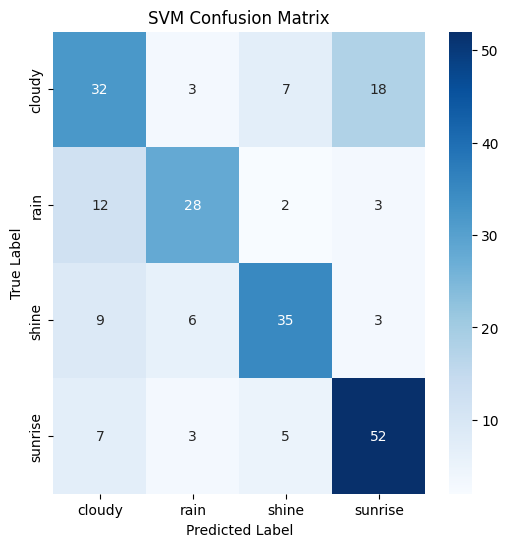

Epoch 1/10
23/23 [==============================] - 5s 225ms/step - loss: 0.1939 - accuracy: 0.9359 - val_loss: 2.8030 - val_accuracy: 0.5333
Epoch 2/10
23/23 [==============================] - 6s 252ms/step - loss: 0.3432 - accuracy: 0.8900 - val_loss: 1.8965 - val_accuracy: 0.6167
Epoch 3/10
23/23 [==============================] - 5s 203ms/step - loss: 0.2534 - accuracy: 0.9192 - val_loss: 2.1427 - val_accuracy: 0.5833
Epoch 4/10
23/23 [==============================] - 6s 252ms/step - loss: 0.5438 - accuracy: 0.8649 - val_loss: 2.0512 - val_accuracy: 0.5167
Epoch 5/10
23/23 [==============================] - 5s 219ms/step - loss: 0.3424 - accuracy: 0.8663 - val_loss: 4.0600 - val_accuracy: 0.4333
Epoch 6/10
23/23 [==============================] - 5s 201ms/step - loss: 0.2351 - accuracy: 0.9206 - val_loss: 2.0661 - val_accuracy: 0.6167
Epoch 7/10
23/23 [==============================] - 6s 277ms/step - loss: 0.0903 - accuracy: 0.9735 - val_loss: 2.4964 - val_accuracy: 0.6056
Epoch 

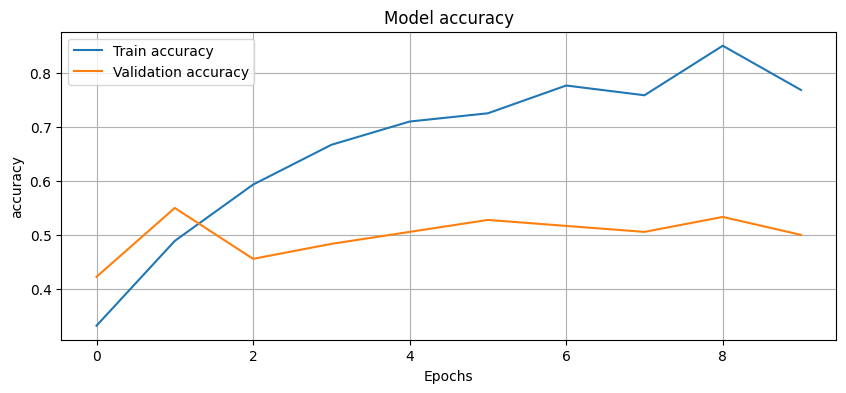

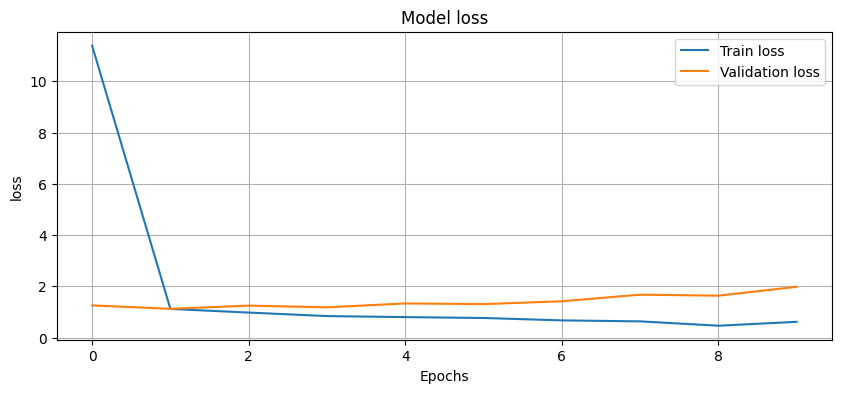

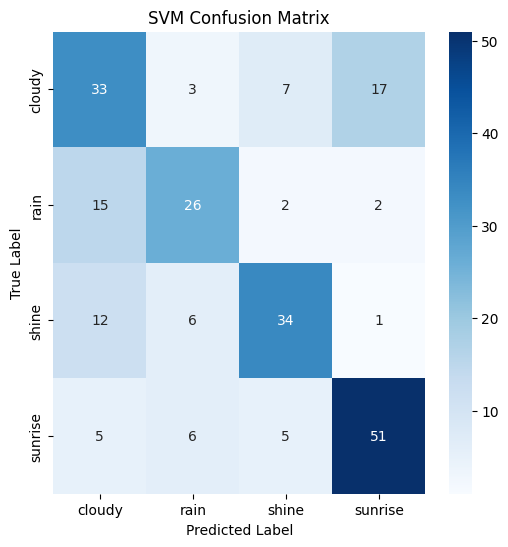

Epoch 1/10
23/23 [==============================] - 5s 224ms/step - loss: 0.4127 - accuracy: 0.8496 - val_loss: 2.3288 - val_accuracy: 0.5222
Epoch 2/10
23/23 [==============================] - 7s 310ms/step - loss: 0.2566 - accuracy: 0.9220 - val_loss: 2.0540 - val_accuracy: 0.5500
Epoch 3/10
23/23 [==============================] - 5s 222ms/step - loss: 0.1979 - accuracy: 0.9429 - val_loss: 2.2345 - val_accuracy: 0.5722
Epoch 4/10
23/23 [==============================] - 6s 246ms/step - loss: 0.1234 - accuracy: 0.9666 - val_loss: 2.3838 - val_accuracy: 0.5611
Epoch 5/10
23/23 [==============================] - 6s 267ms/step - loss: 0.0789 - accuracy: 0.9833 - val_loss: 3.0130 - val_accuracy: 0.6056
Epoch 6/10
23/23 [==============================] - 5s 223ms/step - loss: 0.0429 - accuracy: 0.9875 - val_loss: 3.0400 - val_accuracy: 0.6000
Epoch 7/10
23/23 [==============================] - 7s 302ms/step - loss: 0.0221 - accuracy: 0.9944 - val_loss: 3.0537 - val_accuracy: 0.5722
Epoch 

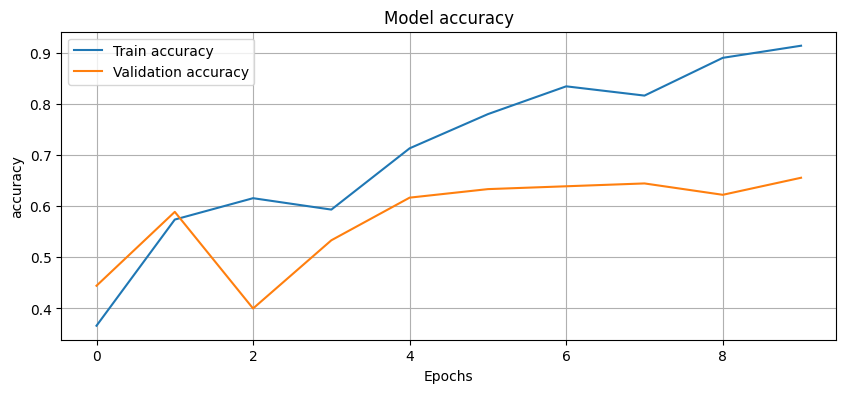

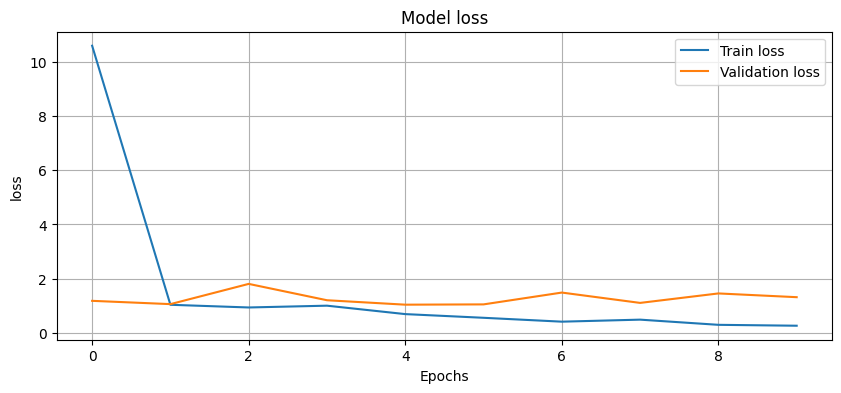

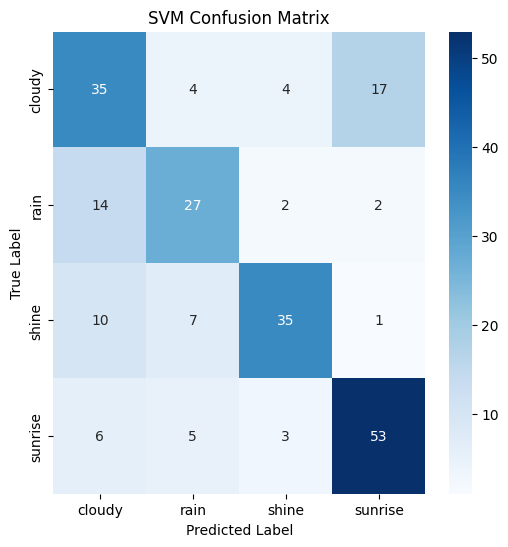

Epoch 1/10
23/23 [==============================] - 7s 303ms/step - loss: 0.1990 - accuracy: 0.9206 - val_loss: 2.2948 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 5s 224ms/step - loss: 0.2337 - accuracy: 0.9095 - val_loss: 1.6354 - val_accuracy: 0.6556
Epoch 3/10
23/23 [==============================] - 6s 250ms/step - loss: 0.2045 - accuracy: 0.9359 - val_loss: 1.7730 - val_accuracy: 0.6611
Epoch 4/10
23/23 [==============================] - 6s 264ms/step - loss: 0.2828 - accuracy: 0.9039 - val_loss: 1.8404 - val_accuracy: 0.6278
Epoch 5/10
23/23 [==============================] - 5s 224ms/step - loss: 0.1660 - accuracy: 0.9443 - val_loss: 1.7984 - val_accuracy: 0.6278
Epoch 6/10
23/23 [==============================] - 7s 300ms/step - loss: 0.1390 - accuracy: 0.9554 - val_loss: 1.8713 - val_accuracy: 0.6222
Epoch 7/10
23/23 [==============================] - 5s 223ms/step - loss: 0.0807 - accuracy: 0.9805 - val_loss: 2.1786 - val_accuracy: 0.6611
Epoch 

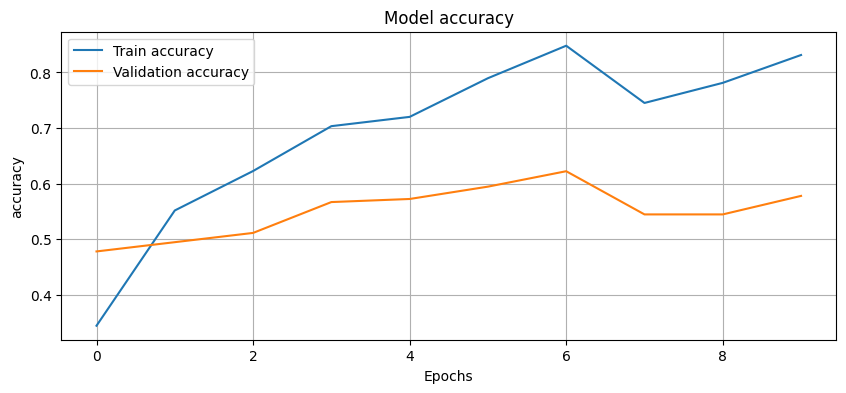

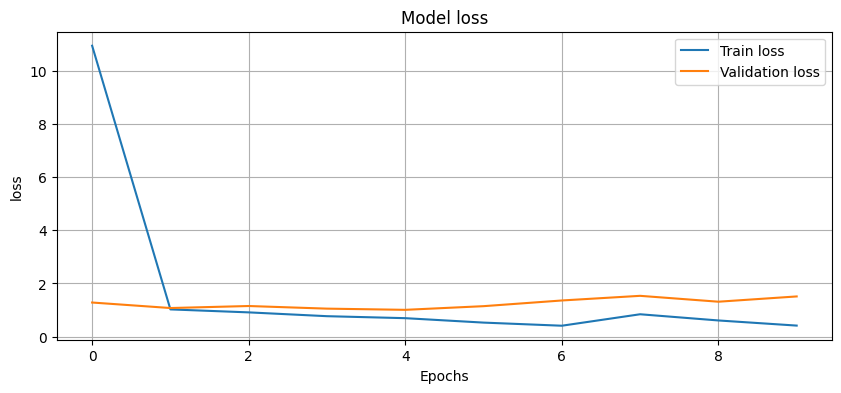

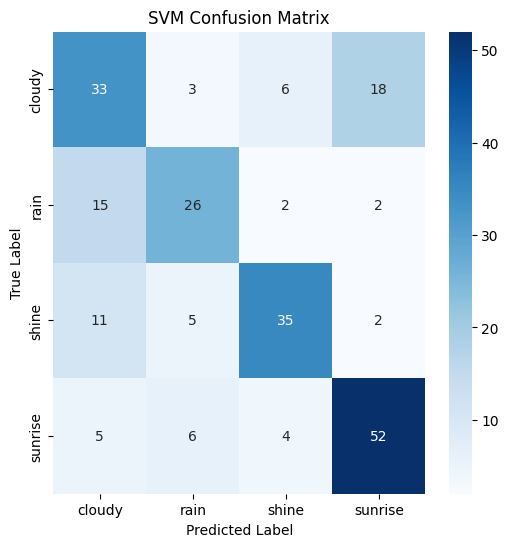

Epoch 1/10
23/23 [==============================] - 7s 284ms/step - loss: 0.2984 - accuracy: 0.9011 - val_loss: 1.7318 - val_accuracy: 0.5500
Epoch 2/10
23/23 [==============================] - 5s 230ms/step - loss: 0.2006 - accuracy: 0.9262 - val_loss: 2.0075 - val_accuracy: 0.6278
Epoch 3/10
23/23 [==============================] - 7s 308ms/step - loss: 0.1903 - accuracy: 0.9345 - val_loss: 1.9698 - val_accuracy: 0.6167
Epoch 4/10
23/23 [==============================] - 5s 235ms/step - loss: 0.4131 - accuracy: 0.8538 - val_loss: 2.6049 - val_accuracy: 0.5444
Epoch 5/10
23/23 [==============================] - 7s 303ms/step - loss: 0.2864 - accuracy: 0.9123 - val_loss: 2.1815 - val_accuracy: 0.5889
Epoch 6/10
23/23 [==============================] - 6s 243ms/step - loss: 0.1642 - accuracy: 0.9485 - val_loss: 2.4421 - val_accuracy: 0.5667
Epoch 7/10
23/23 [==============================] - 6s 253ms/step - loss: 0.1911 - accuracy: 0.9540 - val_loss: 2.9637 - val_accuracy: 0.5667
Epoch 

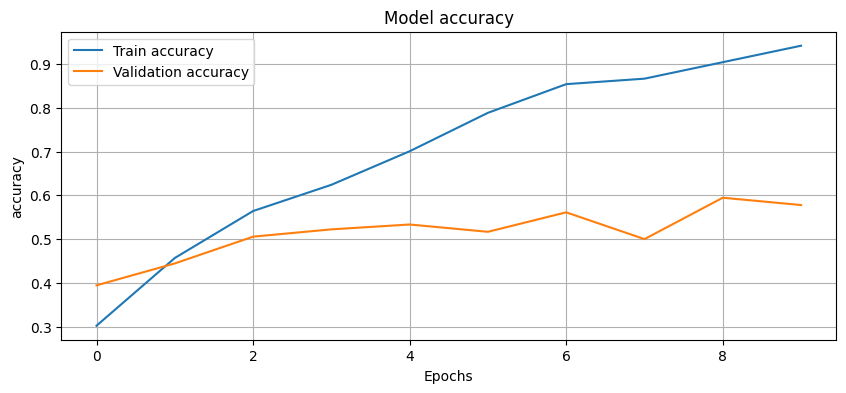

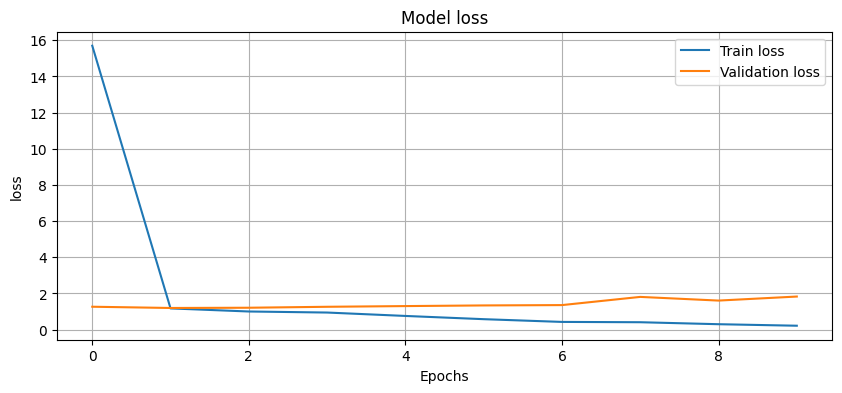

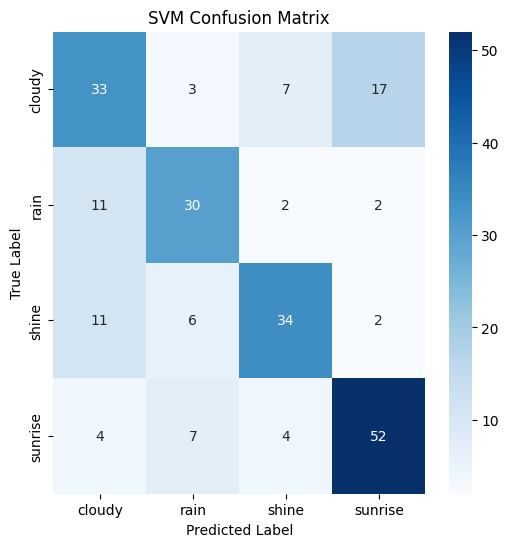

Epoch 1/10
23/23 [==============================] - 7s 310ms/step - loss: 0.2120 - accuracy: 0.9318 - val_loss: 1.9009 - val_accuracy: 0.5667
Epoch 2/10
23/23 [==============================] - 5s 236ms/step - loss: 0.1744 - accuracy: 0.9457 - val_loss: 2.2374 - val_accuracy: 0.6056
Epoch 3/10
23/23 [==============================] - 6s 262ms/step - loss: 0.1812 - accuracy: 0.9401 - val_loss: 3.5278 - val_accuracy: 0.5111
Epoch 4/10
23/23 [==============================] - 6s 277ms/step - loss: 0.2765 - accuracy: 0.9150 - val_loss: 2.4036 - val_accuracy: 0.5056
Epoch 5/10
23/23 [==============================] - 5s 233ms/step - loss: 0.2519 - accuracy: 0.9248 - val_loss: 2.4496 - val_accuracy: 0.5278
Epoch 6/10
23/23 [==============================] - 7s 309ms/step - loss: 0.1742 - accuracy: 0.9526 - val_loss: 2.3707 - val_accuracy: 0.5333
Epoch 7/10
23/23 [==============================] - 6s 250ms/step - loss: 0.1175 - accuracy: 0.9749 - val_loss: 2.7968 - val_accuracy: 0.5556
Epoch 

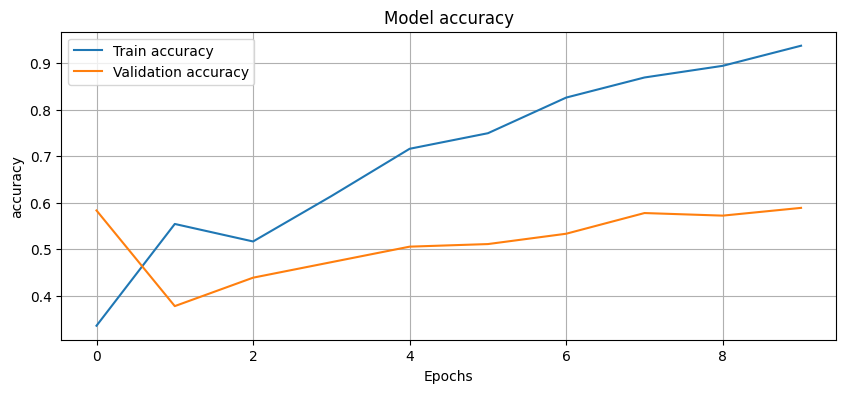

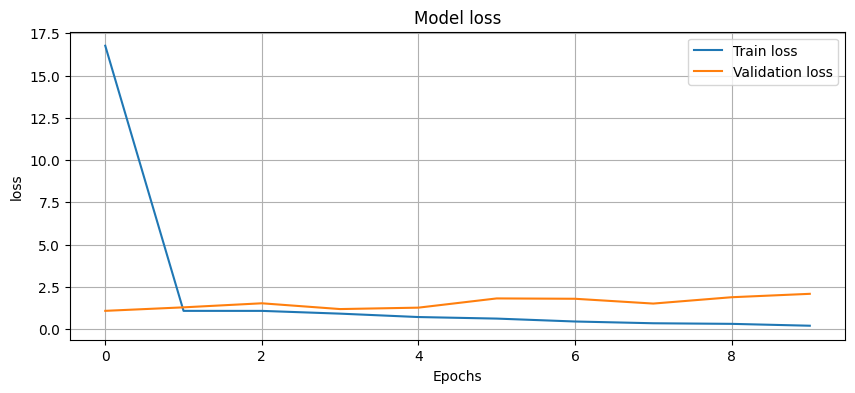

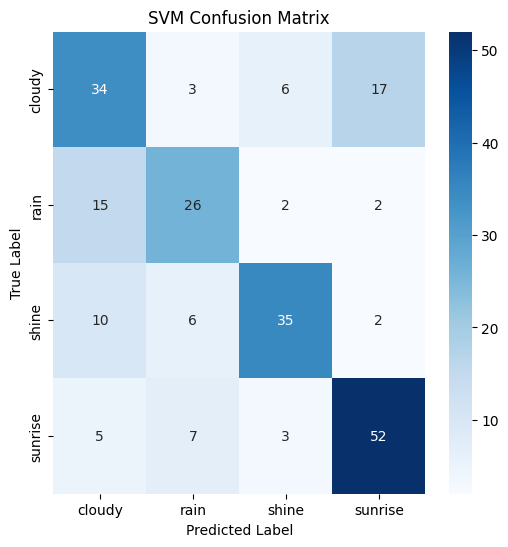

Epoch 1/10
23/23 [==============================] - 8s 331ms/step - loss: 0.1581 - accuracy: 0.9526 - val_loss: 2.4716 - val_accuracy: 0.6111
Epoch 2/10
23/23 [==============================] - 6s 240ms/step - loss: 0.2378 - accuracy: 0.9331 - val_loss: 2.7236 - val_accuracy: 0.5500
Epoch 3/10
23/23 [==============================] - 7s 313ms/step - loss: 0.2338 - accuracy: 0.9401 - val_loss: 2.2889 - val_accuracy: 0.6000
Epoch 4/10
23/23 [==============================] - 6s 252ms/step - loss: 0.2444 - accuracy: 0.9359 - val_loss: 1.6632 - val_accuracy: 0.5333
Epoch 5/10
23/23 [==============================] - 7s 288ms/step - loss: 0.1858 - accuracy: 0.9485 - val_loss: 2.3297 - val_accuracy: 0.5611
Epoch 6/10
23/23 [==============================] - 6s 276ms/step - loss: 0.1442 - accuracy: 0.9554 - val_loss: 1.8172 - val_accuracy: 0.5944
Epoch 7/10
23/23 [==============================] - 6s 244ms/step - loss: 0.1096 - accuracy: 0.9763 - val_loss: 2.1378 - val_accuracy: 0.6278
Epoch 

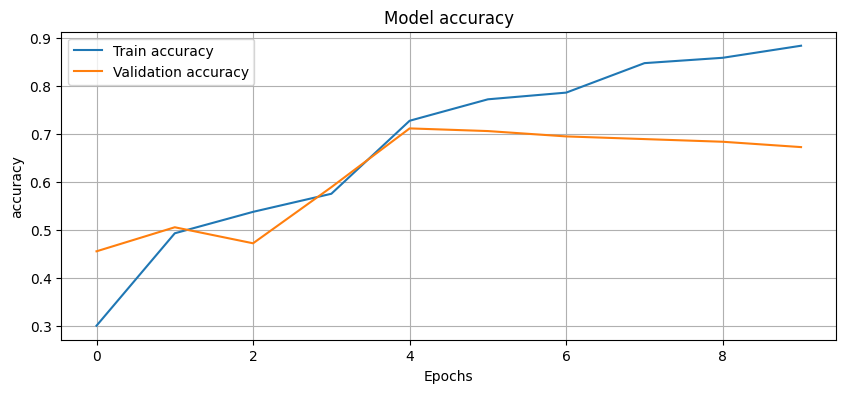

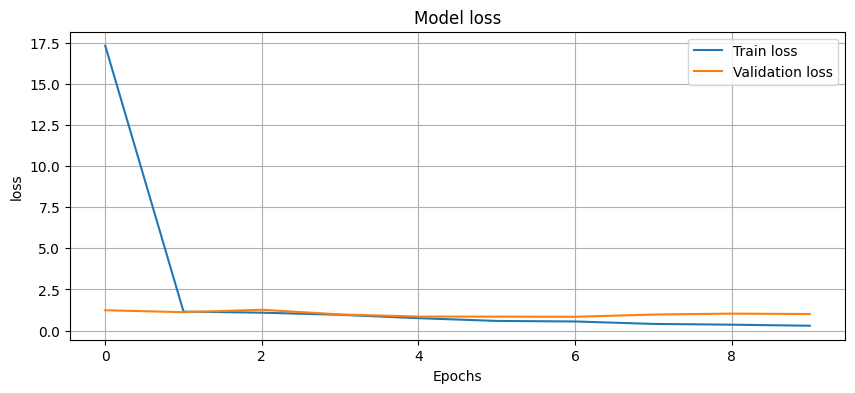

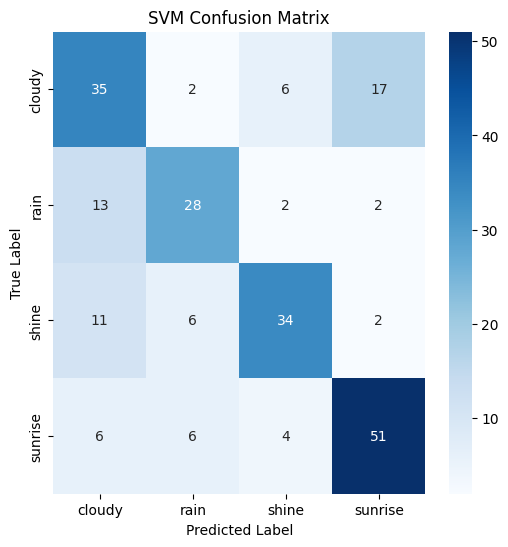

Epoch 1/10
23/23 [==============================] - 7s 289ms/step - loss: 0.3615 - accuracy: 0.8733 - val_loss: 1.1735 - val_accuracy: 0.6222
Epoch 2/10
23/23 [==============================] - 6s 267ms/step - loss: 0.4172 - accuracy: 0.8621 - val_loss: 0.9846 - val_accuracy: 0.6778
Epoch 3/10
23/23 [==============================] - 6s 255ms/step - loss: 0.2784 - accuracy: 0.9053 - val_loss: 1.1571 - val_accuracy: 0.6444
Epoch 4/10
23/23 [==============================] - 7s 322ms/step - loss: 0.4320 - accuracy: 0.8315 - val_loss: 1.3052 - val_accuracy: 0.6278
Epoch 5/10
23/23 [==============================] - 6s 255ms/step - loss: 0.2636 - accuracy: 0.9095 - val_loss: 1.1242 - val_accuracy: 0.6278
Epoch 6/10
23/23 [==============================] - 8s 330ms/step - loss: 0.2405 - accuracy: 0.9304 - val_loss: 1.4590 - val_accuracy: 0.6111
Epoch 7/10
23/23 [==============================] - 6s 255ms/step - loss: 0.1842 - accuracy: 0.9387 - val_loss: 1.3149 - val_accuracy: 0.7000
Epoch 

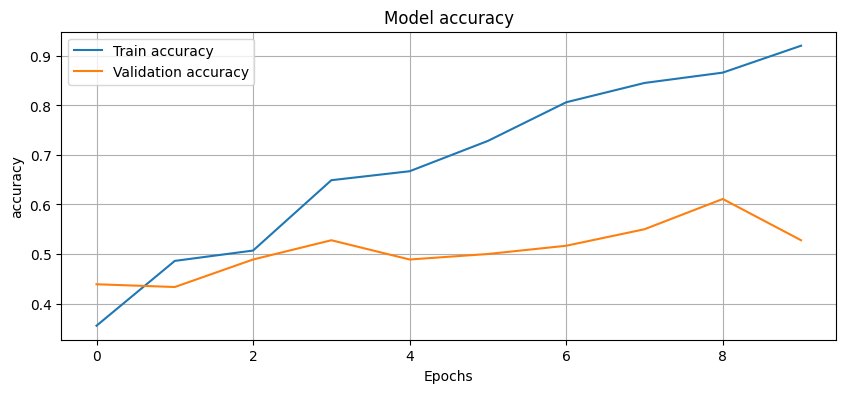

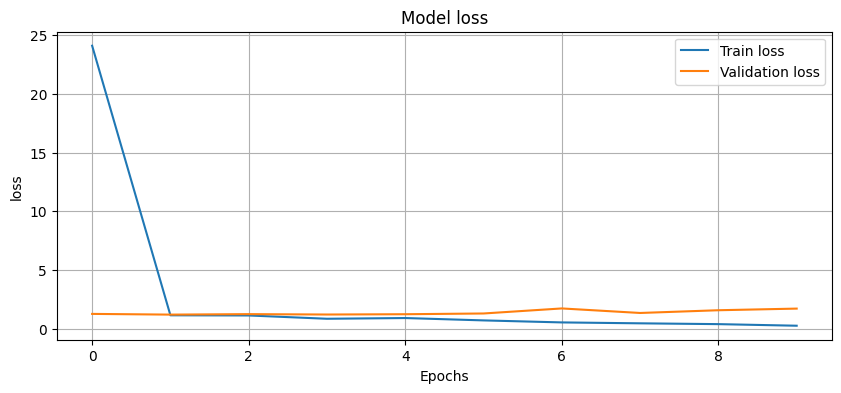

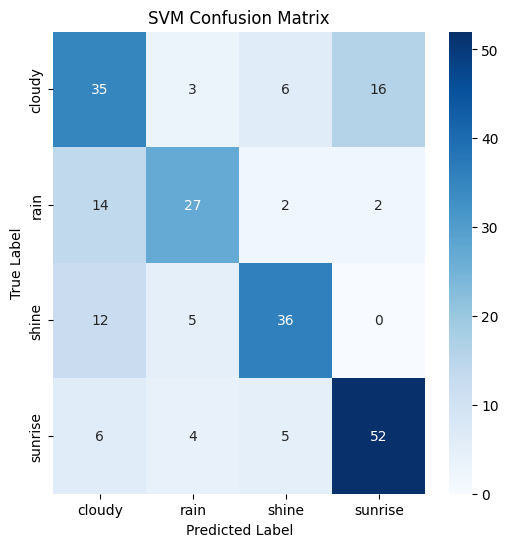

Epoch 1/10
23/23 [==============================] - 7s 305ms/step - loss: 0.2443 - accuracy: 0.9318 - val_loss: 1.9005 - val_accuracy: 0.6056
Epoch 2/10
23/23 [==============================] - 7s 280ms/step - loss: 0.1501 - accuracy: 0.9638 - val_loss: 2.3779 - val_accuracy: 0.5944
Epoch 3/10
23/23 [==============================] - 6s 279ms/step - loss: 0.1037 - accuracy: 0.9777 - val_loss: 2.0540 - val_accuracy: 0.5667
Epoch 4/10
23/23 [==============================] - 7s 293ms/step - loss: 0.2160 - accuracy: 0.9318 - val_loss: 4.7909 - val_accuracy: 0.4444
Epoch 5/10
23/23 [==============================] - 6s 251ms/step - loss: 0.3081 - accuracy: 0.8969 - val_loss: 1.8579 - val_accuracy: 0.5722
Epoch 6/10
23/23 [==============================] - 8s 340ms/step - loss: 0.3522 - accuracy: 0.8997 - val_loss: 1.5599 - val_accuracy: 0.5944
Epoch 7/10
23/23 [==============================] - 6s 264ms/step - loss: 0.3309 - accuracy: 0.9178 - val_loss: 1.7561 - val_accuracy: 0.5833
Epoch 

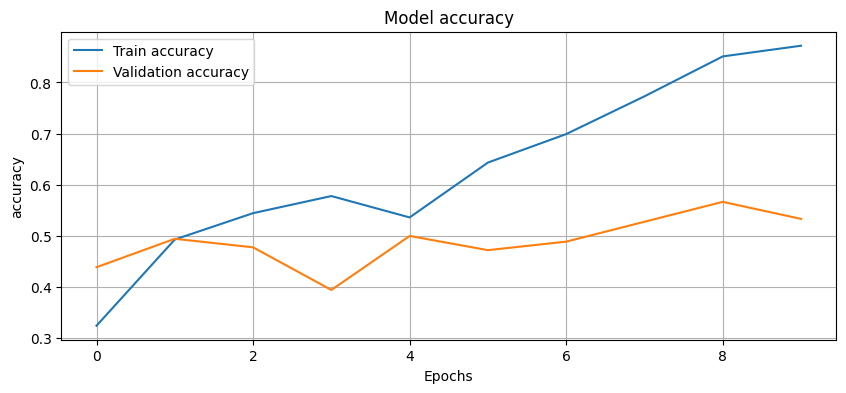

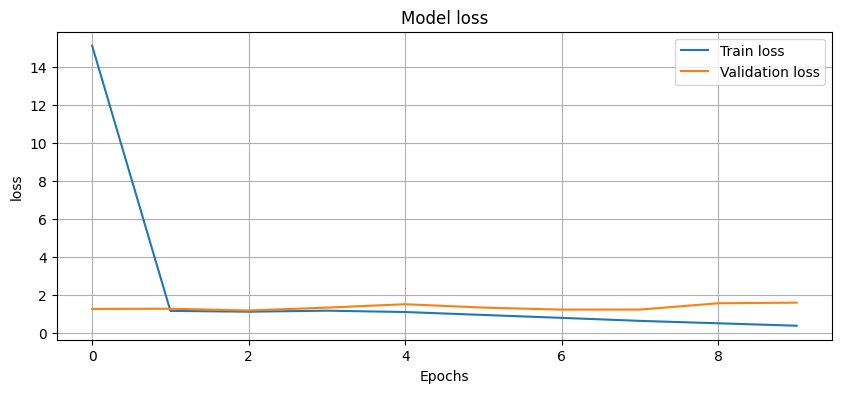

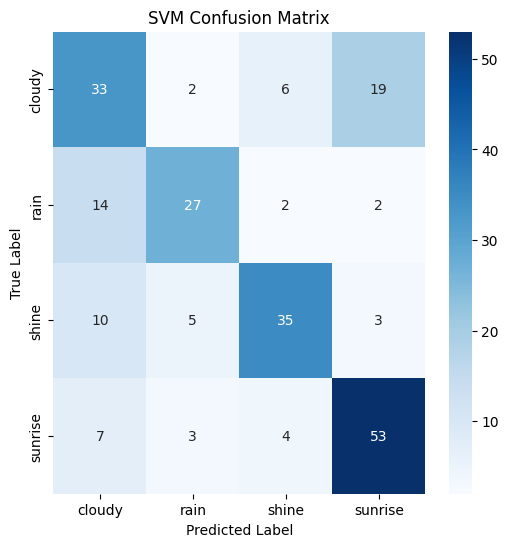

Epoch 1/10
23/23 [==============================] - 7s 304ms/step - loss: 0.2328 - accuracy: 0.9248 - val_loss: 1.9927 - val_accuracy: 0.5722
Epoch 2/10
23/23 [==============================] - 6s 266ms/step - loss: 0.1427 - accuracy: 0.9540 - val_loss: 2.1425 - val_accuracy: 0.5389
Epoch 3/10
23/23 [==============================] - 6s 269ms/step - loss: 0.1600 - accuracy: 0.9554 - val_loss: 2.4567 - val_accuracy: 0.5833
Epoch 4/10
23/23 [==============================] - 7s 318ms/step - loss: 0.2822 - accuracy: 0.9109 - val_loss: 2.6218 - val_accuracy: 0.5556
Epoch 5/10
23/23 [==============================] - 6s 263ms/step - loss: 0.2229 - accuracy: 0.9331 - val_loss: 2.0848 - val_accuracy: 0.5333
Epoch 6/10
23/23 [==============================] - 7s 324ms/step - loss: 0.1839 - accuracy: 0.9401 - val_loss: 2.1252 - val_accuracy: 0.5222
Epoch 7/10
23/23 [==============================] - 6s 251ms/step - loss: 0.1098 - accuracy: 0.9708 - val_loss: 2.6322 - val_accuracy: 0.5444
Epoch 

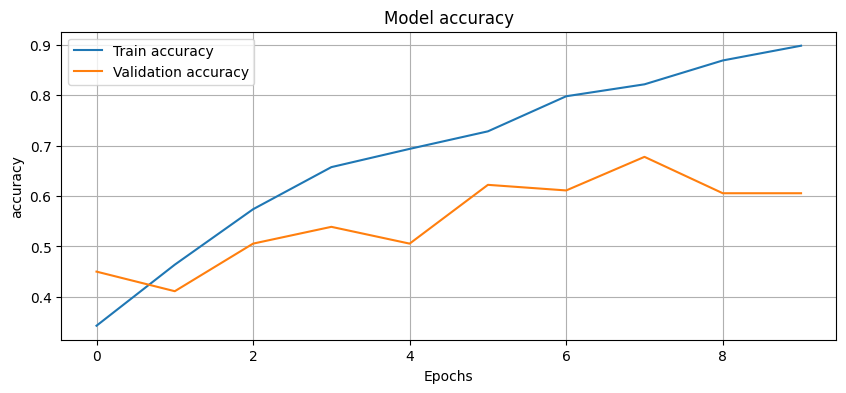

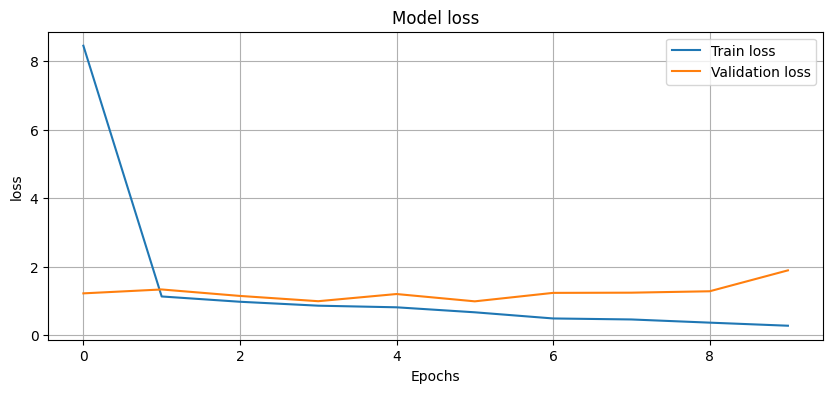

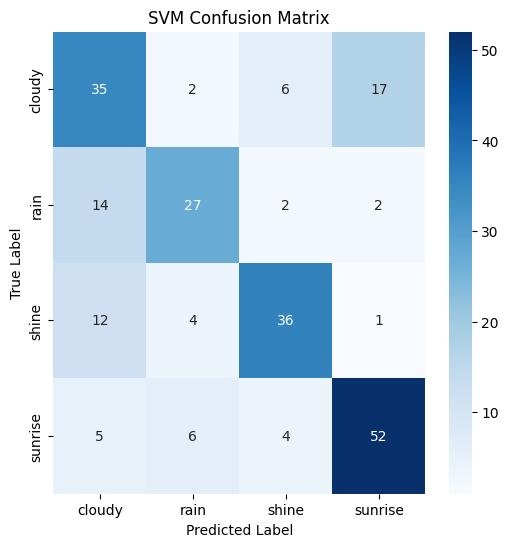

Epoch 1/10
23/23 [==============================] - 8s 339ms/step - loss: 0.9365 - accuracy: 0.6560 - val_loss: 1.8305 - val_accuracy: 0.4889
Epoch 2/10
23/23 [==============================] - 6s 274ms/step - loss: 0.5991 - accuracy: 0.7507 - val_loss: 1.5551 - val_accuracy: 0.6167
Epoch 3/10
23/23 [==============================] - 7s 326ms/step - loss: 0.3852 - accuracy: 0.8579 - val_loss: 1.7307 - val_accuracy: 0.6000
Epoch 4/10
23/23 [==============================] - 7s 301ms/step - loss: 0.4569 - accuracy: 0.8273 - val_loss: 2.2836 - val_accuracy: 0.6000
Epoch 5/10
23/23 [==============================] - 7s 321ms/step - loss: 0.2622 - accuracy: 0.9025 - val_loss: 2.2414 - val_accuracy: 0.5778
Epoch 6/10
23/23 [==============================] - 7s 307ms/step - loss: 0.1932 - accuracy: 0.9318 - val_loss: 2.2583 - val_accuracy: 0.5667
Epoch 7/10
23/23 [==============================] - 7s 324ms/step - loss: 0.1526 - accuracy: 0.9568 - val_loss: 2.3107 - val_accuracy: 0.6667
Epoch 

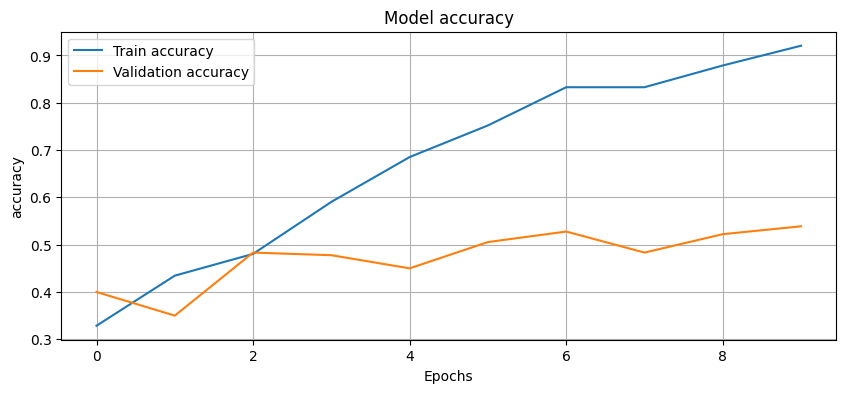

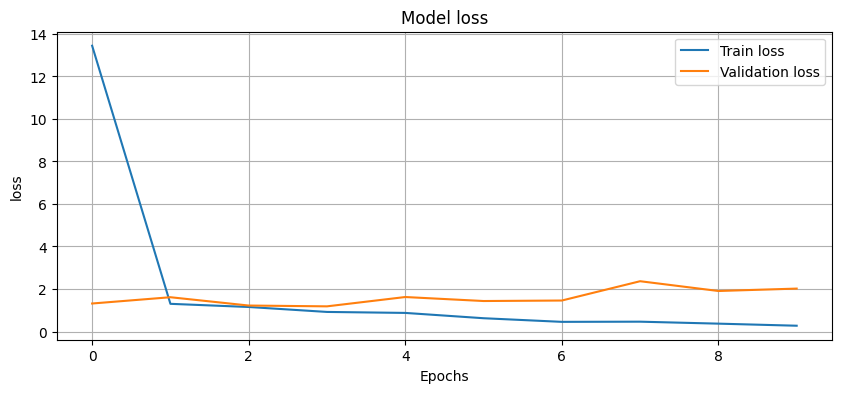

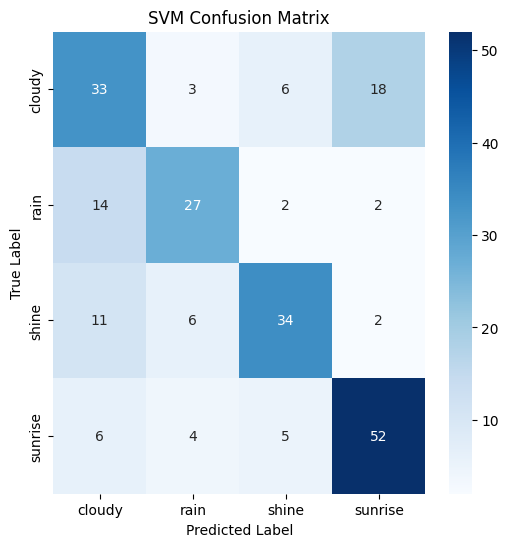

Epoch 1/10
23/23 [==============================] - 8s 359ms/step - loss: 0.2387 - accuracy: 0.9192 - val_loss: 1.9246 - val_accuracy: 0.5333
Epoch 2/10
23/23 [==============================] - 6s 271ms/step - loss: 0.2272 - accuracy: 0.9248 - val_loss: 2.1129 - val_accuracy: 0.5778
Epoch 3/10
23/23 [==============================] - 8s 349ms/step - loss: 0.1059 - accuracy: 0.9666 - val_loss: 2.6566 - val_accuracy: 0.5444
Epoch 4/10
23/23 [==============================] - 7s 288ms/step - loss: 0.1223 - accuracy: 0.9680 - val_loss: 2.6190 - val_accuracy: 0.5833
Epoch 5/10
23/23 [==============================] - 8s 348ms/step - loss: 0.1727 - accuracy: 0.9499 - val_loss: 2.8517 - val_accuracy: 0.5722
Epoch 6/10
23/23 [==============================] - 7s 285ms/step - loss: 0.0762 - accuracy: 0.9749 - val_loss: 3.4725 - val_accuracy: 0.6111
Epoch 7/10
23/23 [==============================] - 8s 359ms/step - loss: 0.0557 - accuracy: 0.9903 - val_loss: 3.5800 - val_accuracy: 0.5889
Epoch 

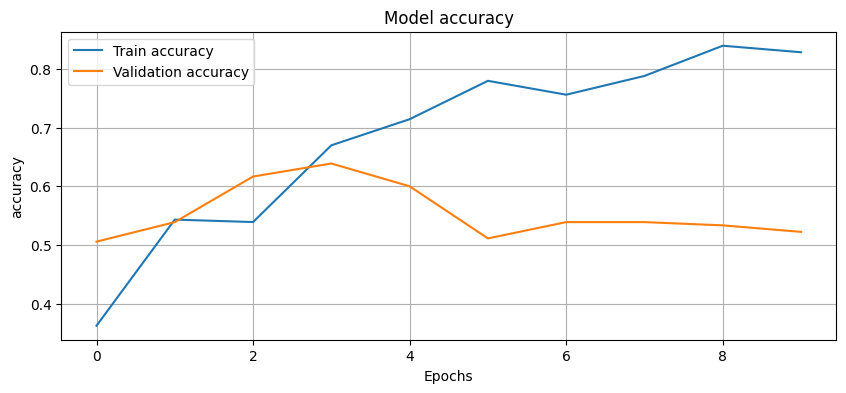

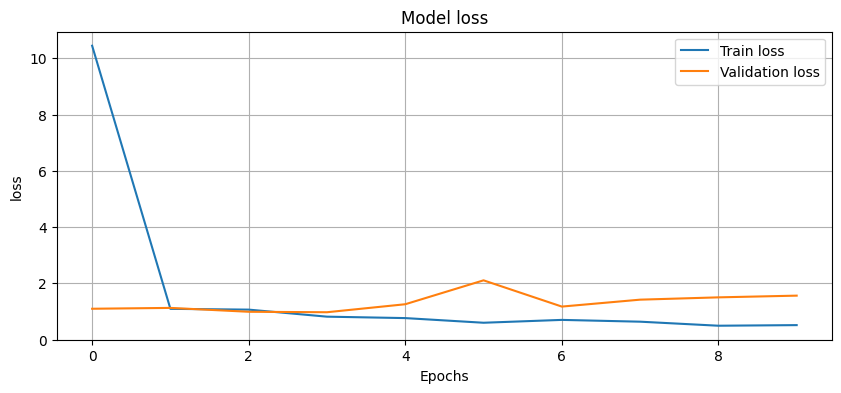

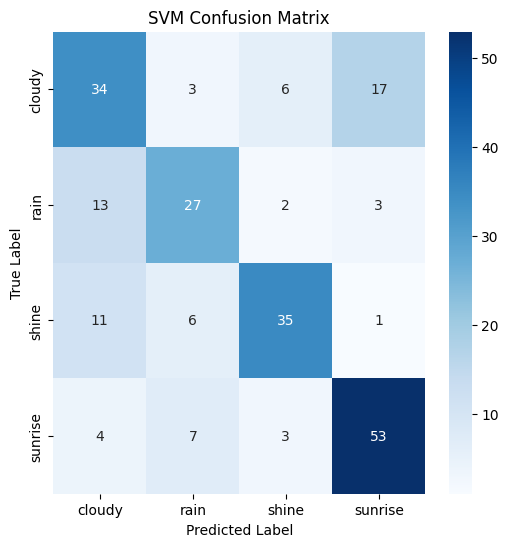

Epoch 1/10
23/23 [==============================] - 8s 363ms/step - loss: 0.3661 - accuracy: 0.8788 - val_loss: 1.4016 - val_accuracy: 0.5500
Epoch 2/10
23/23 [==============================] - 7s 290ms/step - loss: 0.3225 - accuracy: 0.9025 - val_loss: 1.6347 - val_accuracy: 0.5389
Epoch 3/10
23/23 [==============================] - 8s 353ms/step - loss: 0.2340 - accuracy: 0.9373 - val_loss: 1.8156 - val_accuracy: 0.5389
Epoch 4/10
23/23 [==============================] - 7s 290ms/step - loss: 0.1700 - accuracy: 0.9443 - val_loss: 1.7170 - val_accuracy: 0.5500
Epoch 5/10
23/23 [==============================] - 8s 352ms/step - loss: 0.1412 - accuracy: 0.9582 - val_loss: 2.0844 - val_accuracy: 0.5500
Epoch 6/10
23/23 [==============================] - 7s 289ms/step - loss: 0.1217 - accuracy: 0.9749 - val_loss: 2.5667 - val_accuracy: 0.5222
Epoch 7/10
23/23 [==============================] - 8s 365ms/step - loss: 0.3663 - accuracy: 0.8942 - val_loss: 1.9531 - val_accuracy: 0.5111
Epoch 

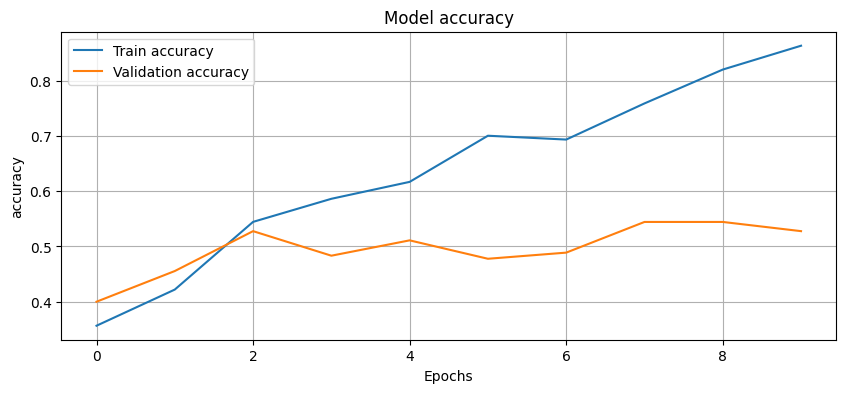

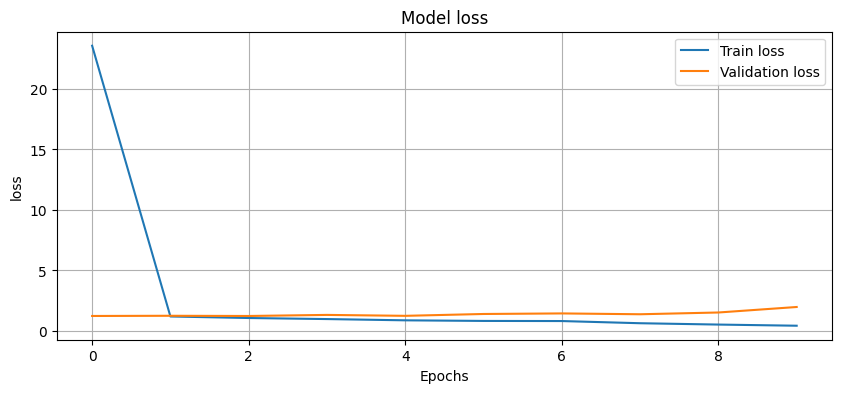

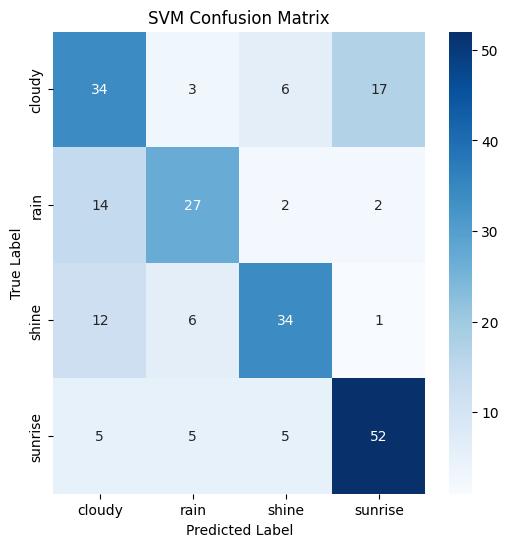

Epoch 1/10
23/23 [==============================] - 8s 353ms/step - loss: 0.5172 - accuracy: 0.8273 - val_loss: 1.5441 - val_accuracy: 0.5667
Epoch 2/10
23/23 [==============================] - 7s 291ms/step - loss: 0.3635 - accuracy: 0.8969 - val_loss: 2.2588 - val_accuracy: 0.5278
Epoch 3/10
23/23 [==============================] - 8s 357ms/step - loss: 0.4123 - accuracy: 0.8677 - val_loss: 1.9588 - val_accuracy: 0.5889
Epoch 4/10
23/23 [==============================] - 7s 293ms/step - loss: 0.2440 - accuracy: 0.9318 - val_loss: 2.0468 - val_accuracy: 0.5944
Epoch 5/10
23/23 [==============================] - 8s 368ms/step - loss: 0.1394 - accuracy: 0.9638 - val_loss: 2.3991 - val_accuracy: 0.5833
Epoch 6/10
23/23 [==============================] - 6s 283ms/step - loss: 0.2436 - accuracy: 0.9318 - val_loss: 1.7876 - val_accuracy: 0.5611
Epoch 7/10
23/23 [==============================] - 8s 367ms/step - loss: 0.1883 - accuracy: 0.9540 - val_loss: 2.6066 - val_accuracy: 0.5778
Epoch 

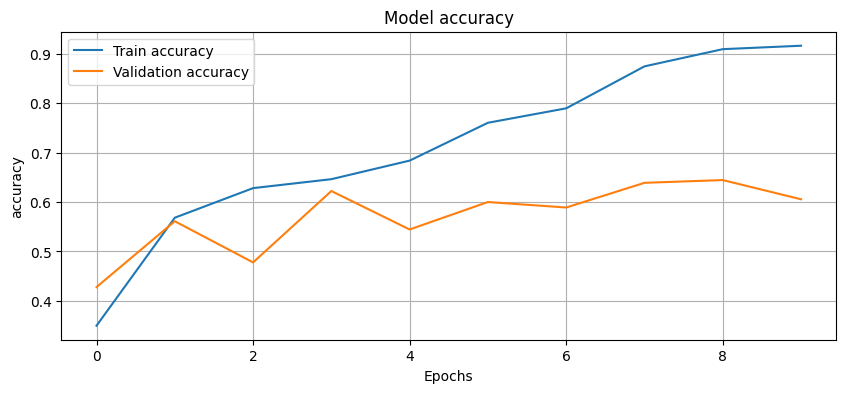

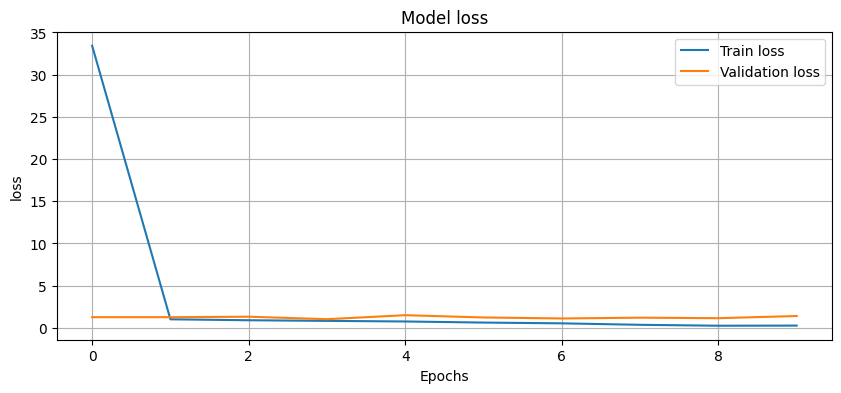

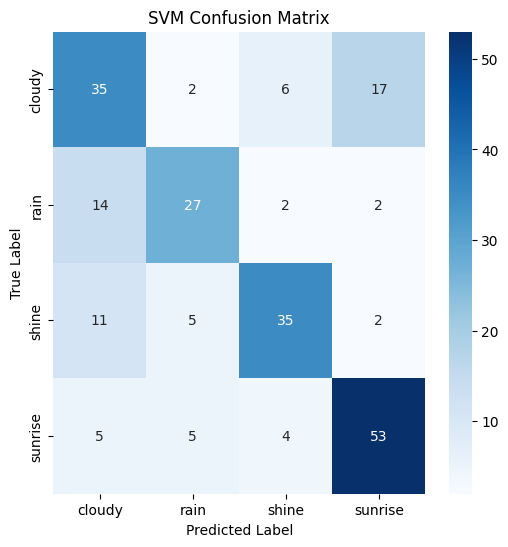

Epoch 1/10
23/23 [==============================] - 9s 374ms/step - loss: 0.3932 - accuracy: 0.8747 - val_loss: 1.6720 - val_accuracy: 0.5111
Epoch 2/10
23/23 [==============================] - 7s 298ms/step - loss: 0.3089 - accuracy: 0.8816 - val_loss: 1.8553 - val_accuracy: 0.6389
Epoch 3/10
23/23 [==============================] - 9s 383ms/step - loss: 0.2878 - accuracy: 0.8942 - val_loss: 1.7697 - val_accuracy: 0.6056
Epoch 4/10
23/23 [==============================] - 7s 312ms/step - loss: 0.1340 - accuracy: 0.9582 - val_loss: 1.8459 - val_accuracy: 0.6500
Epoch 5/10
23/23 [==============================] - 8s 363ms/step - loss: 0.0807 - accuracy: 0.9777 - val_loss: 1.8767 - val_accuracy: 0.6611
Epoch 6/10
23/23 [==============================] - 8s 341ms/step - loss: 0.0737 - accuracy: 0.9805 - val_loss: 2.0853 - val_accuracy: 0.6389
Epoch 7/10
23/23 [==============================] - 8s 334ms/step - loss: 0.0525 - accuracy: 0.9861 - val_loss: 2.3594 - val_accuracy: 0.6611
Epoch 

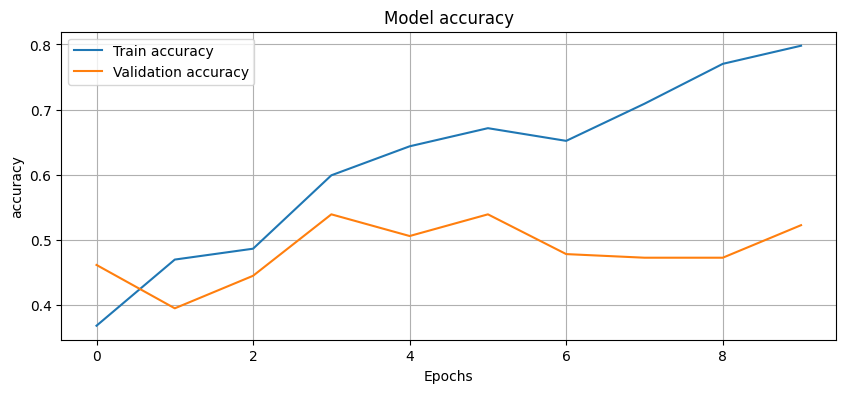

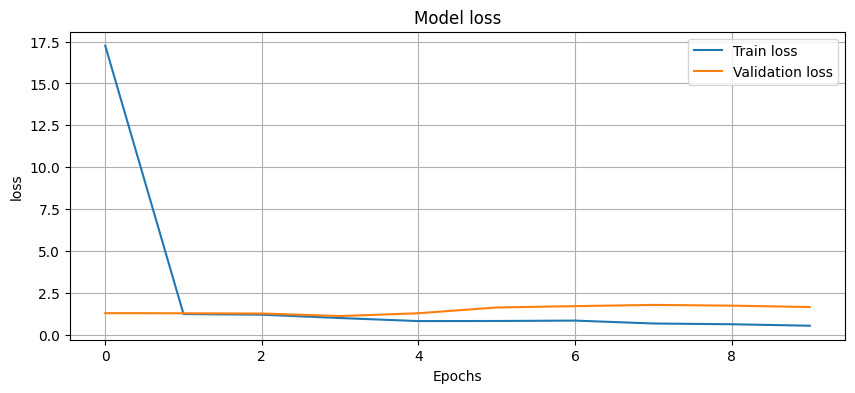

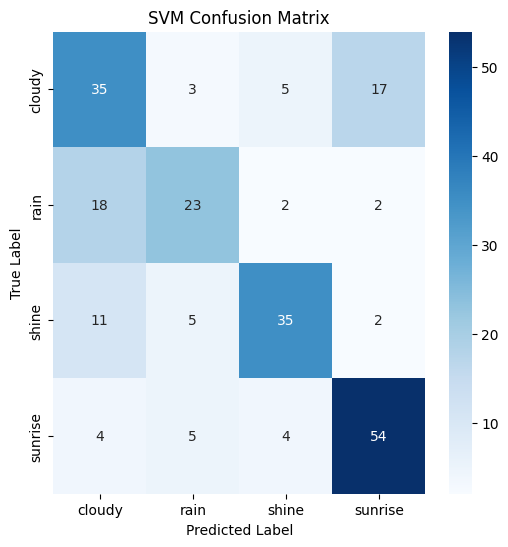

Epoch 1/10
23/23 [==============================] - 9s 377ms/step - loss: 0.4901 - accuracy: 0.8203 - val_loss: 1.8748 - val_accuracy: 0.5222
Epoch 2/10
23/23 [==============================] - 7s 310ms/step - loss: 0.4750 - accuracy: 0.8440 - val_loss: 2.2781 - val_accuracy: 0.5167
Epoch 3/10
23/23 [==============================] - 9s 380ms/step - loss: 0.3657 - accuracy: 0.8830 - val_loss: 2.2549 - val_accuracy: 0.4944
Epoch 4/10
23/23 [==============================] - 7s 298ms/step - loss: 0.3244 - accuracy: 0.8788 - val_loss: 3.2940 - val_accuracy: 0.5389
Epoch 5/10
23/23 [==============================] - 9s 374ms/step - loss: 0.2352 - accuracy: 0.9123 - val_loss: 2.7693 - val_accuracy: 0.5667
Epoch 6/10
23/23 [==============================] - 7s 310ms/step - loss: 0.1696 - accuracy: 0.9513 - val_loss: 3.2599 - val_accuracy: 0.5444
Epoch 7/10
23/23 [==============================] - 9s 376ms/step - loss: 0.1142 - accuracy: 0.9652 - val_loss: 4.8262 - val_accuracy: 0.5333
Epoch 

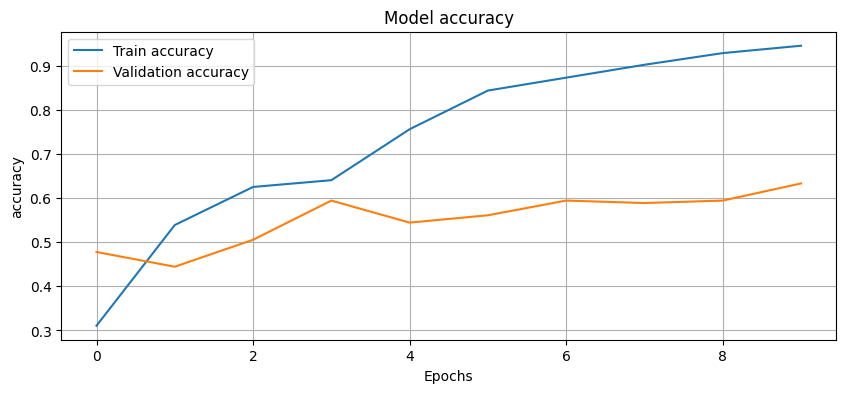

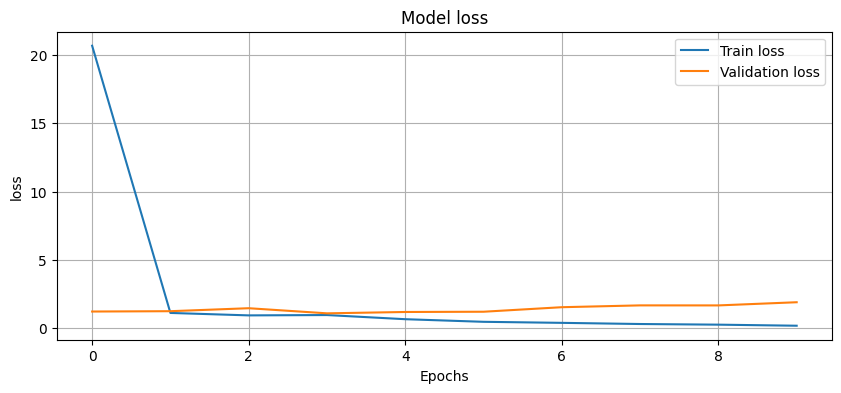

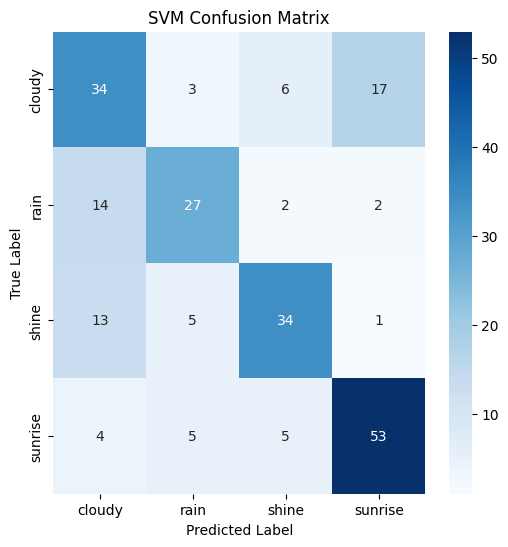

Epoch 1/10
23/23 [==============================] - 7s 311ms/step - loss: 0.1221 - accuracy: 0.9638 - val_loss: 1.6573 - val_accuracy: 0.6611
Epoch 2/10
23/23 [==============================] - 9s 386ms/step - loss: 0.0717 - accuracy: 0.9805 - val_loss: 1.8457 - val_accuracy: 0.6500
Epoch 3/10
23/23 [==============================] - 8s 369ms/step - loss: 0.0585 - accuracy: 0.9819 - val_loss: 2.4883 - val_accuracy: 0.6333
Epoch 4/10
23/23 [==============================] - 8s 346ms/step - loss: 0.0523 - accuracy: 0.9861 - val_loss: 2.4837 - val_accuracy: 0.6611
Epoch 5/10
23/23 [==============================] - 9s 388ms/step - loss: 0.0331 - accuracy: 0.9916 - val_loss: 2.7379 - val_accuracy: 0.6556
Epoch 6/10
23/23 [==============================] - 7s 323ms/step - loss: 0.0086 - accuracy: 1.0000 - val_loss: 2.5657 - val_accuracy: 0.6889
Epoch 7/10
23/23 [==============================] - 9s 387ms/step - loss: 0.0148 - accuracy: 0.9972 - val_loss: 2.6018 - val_accuracy: 0.6333
Epoch 

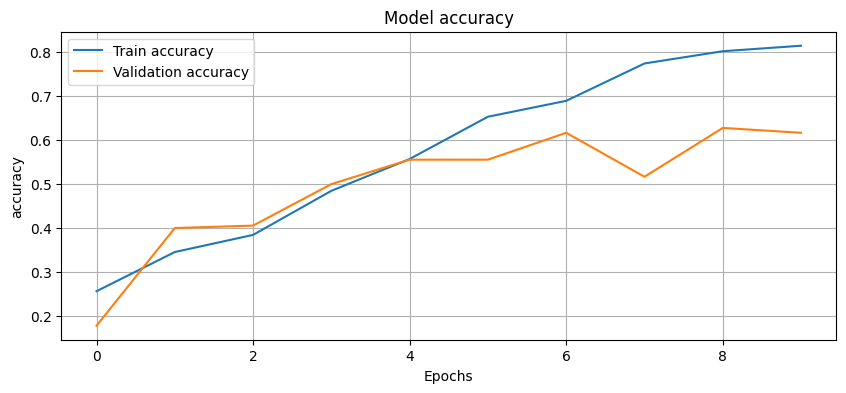

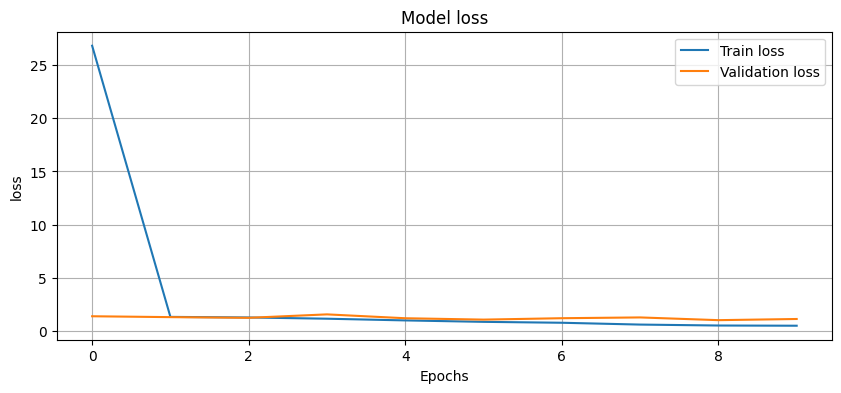

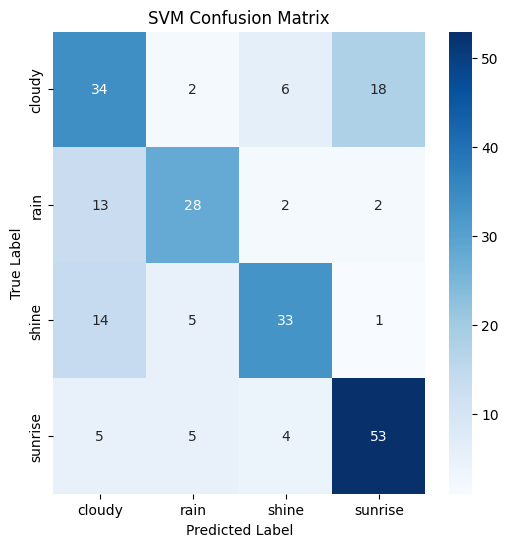

Epoch 1/10
23/23 [==============================] - 7s 317ms/step - loss: 0.4027 - accuracy: 0.8677 - val_loss: 1.3343 - val_accuracy: 0.6278
Epoch 2/10
23/23 [==============================] - 9s 391ms/step - loss: 0.3356 - accuracy: 0.8872 - val_loss: 1.4127 - val_accuracy: 0.6222
Epoch 3/10
23/23 [==============================] - 9s 376ms/step - loss: 0.3630 - accuracy: 0.8607 - val_loss: 1.6217 - val_accuracy: 0.5778
Epoch 4/10
23/23 [==============================] - 8s 344ms/step - loss: 0.2857 - accuracy: 0.9095 - val_loss: 1.7673 - val_accuracy: 0.6556
Epoch 5/10
23/23 [==============================] - 9s 404ms/step - loss: 0.1757 - accuracy: 0.9443 - val_loss: 1.8607 - val_accuracy: 0.6333
Epoch 6/10
23/23 [==============================] - 8s 328ms/step - loss: 0.1759 - accuracy: 0.9401 - val_loss: 1.6397 - val_accuracy: 0.6167
Epoch 7/10
23/23 [==============================] - 9s 409ms/step - loss: 0.1361 - accuracy: 0.9610 - val_loss: 1.9202 - val_accuracy: 0.6444
Epoch 

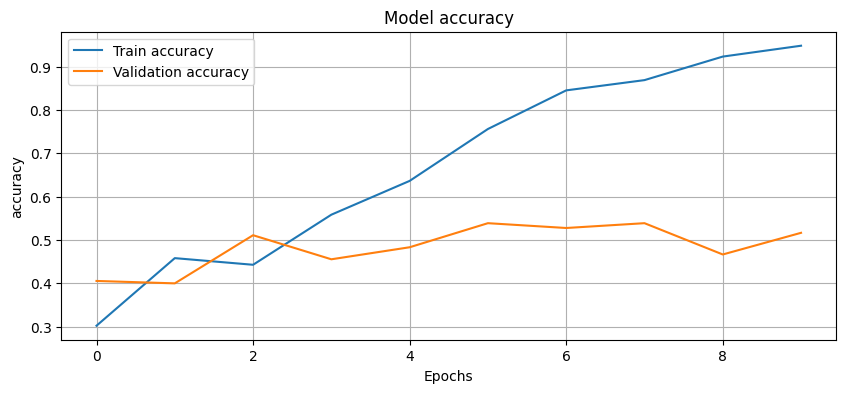

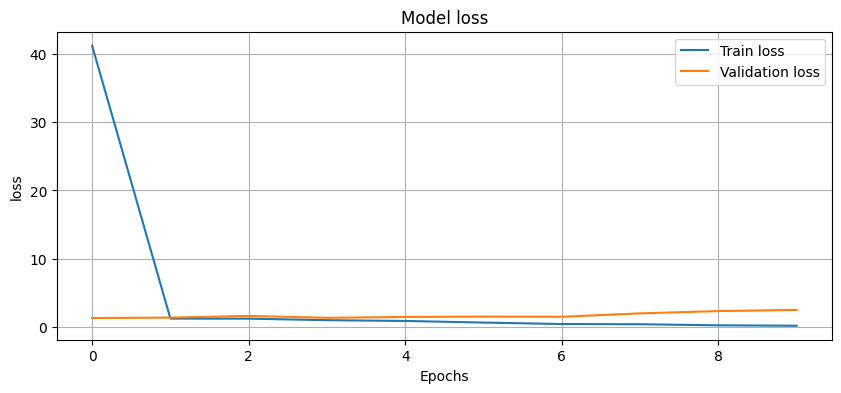

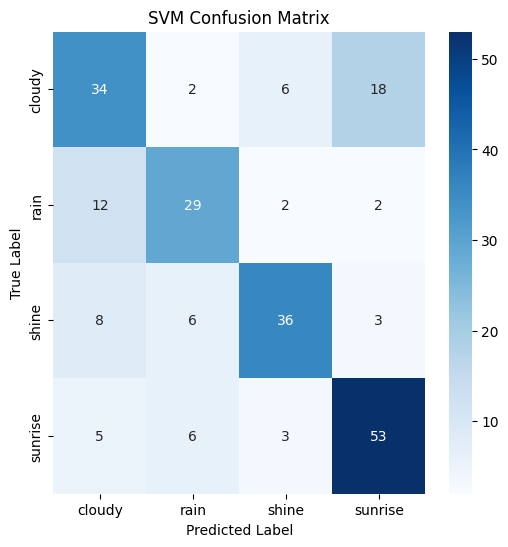

Epoch 1/10
23/23 [==============================] - 10s 430ms/step - loss: 0.0768 - accuracy: 0.9819 - val_loss: 2.6199 - val_accuracy: 0.5722
Epoch 2/10
23/23 [==============================] - 8s 342ms/step - loss: 0.0474 - accuracy: 0.9916 - val_loss: 3.2920 - val_accuracy: 0.5500
Epoch 3/10
23/23 [==============================] - 9s 408ms/step - loss: 0.0555 - accuracy: 0.9847 - val_loss: 2.7578 - val_accuracy: 0.5722
Epoch 4/10
23/23 [==============================] - 9s 379ms/step - loss: 0.1403 - accuracy: 0.9582 - val_loss: 2.9522 - val_accuracy: 0.5722
Epoch 5/10
23/23 [==============================] - 9s 373ms/step - loss: 0.7119 - accuracy: 0.7396 - val_loss: 2.4492 - val_accuracy: 0.5556
Epoch 6/10
23/23 [==============================] - 10s 418ms/step - loss: 0.2936 - accuracy: 0.9234 - val_loss: 2.3151 - val_accuracy: 0.5000
Epoch 7/10
23/23 [==============================] - 8s 342ms/step - loss: 0.1709 - accuracy: 0.9568 - val_loss: 2.4100 - val_accuracy: 0.5111
Epoc

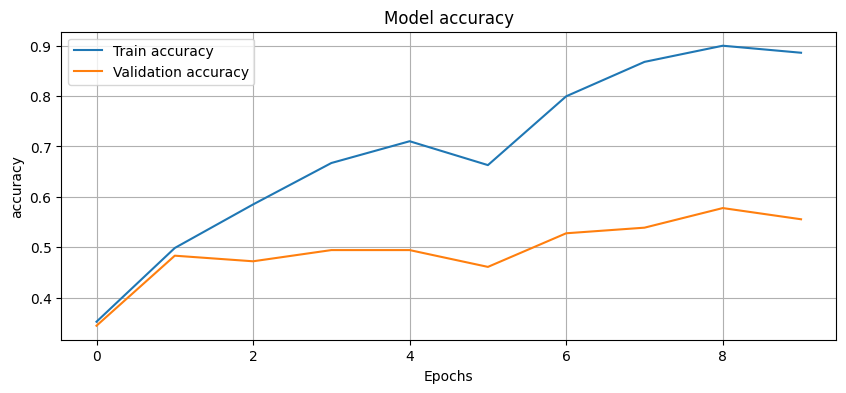

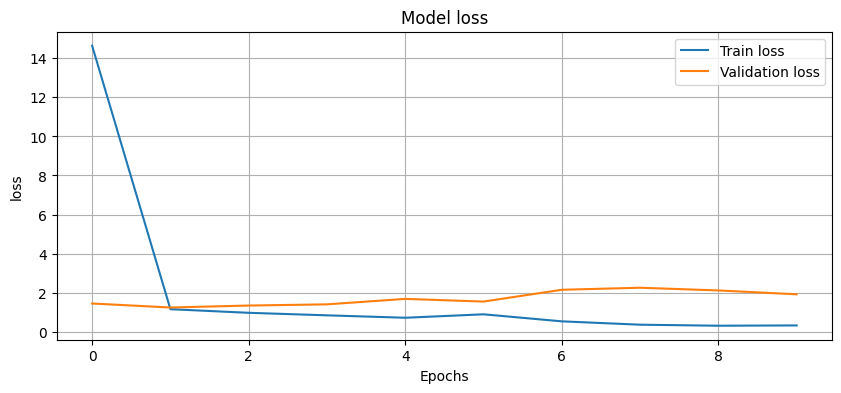

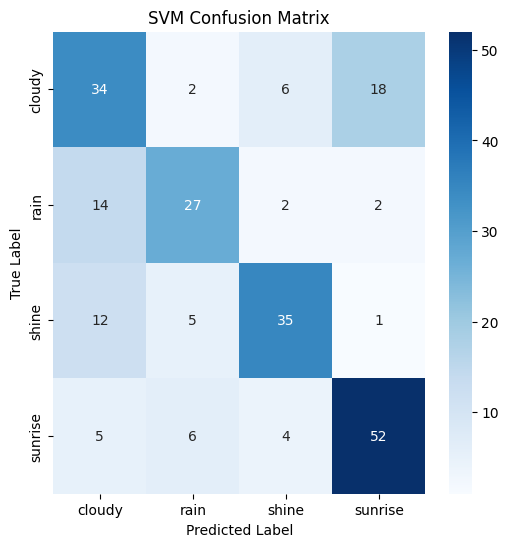

Epoch 1/10
23/23 [==============================] - 9s 415ms/step - loss: 0.2928 - accuracy: 0.9067 - val_loss: 2.1153 - val_accuracy: 0.5611
Epoch 2/10
23/23 [==============================] - 8s 339ms/step - loss: 0.2227 - accuracy: 0.9345 - val_loss: 2.6450 - val_accuracy: 0.5500
Epoch 3/10
23/23 [==============================] - 10s 422ms/step - loss: 0.1381 - accuracy: 0.9596 - val_loss: 2.6934 - val_accuracy: 0.5889
Epoch 4/10
23/23 [==============================] - 10s 421ms/step - loss: 0.1181 - accuracy: 0.9708 - val_loss: 2.9788 - val_accuracy: 0.5722
Epoch 5/10
23/23 [==============================] - 8s 343ms/step - loss: 0.0844 - accuracy: 0.9763 - val_loss: 3.0034 - val_accuracy: 0.5889
Epoch 6/10
23/23 [==============================] - 10s 417ms/step - loss: 0.0464 - accuracy: 0.9903 - val_loss: 3.5936 - val_accuracy: 0.6000
Epoch 7/10
23/23 [==============================] - 8s 367ms/step - loss: 0.0823 - accuracy: 0.9819 - val_loss: 3.9965 - val_accuracy: 0.5389
Epo

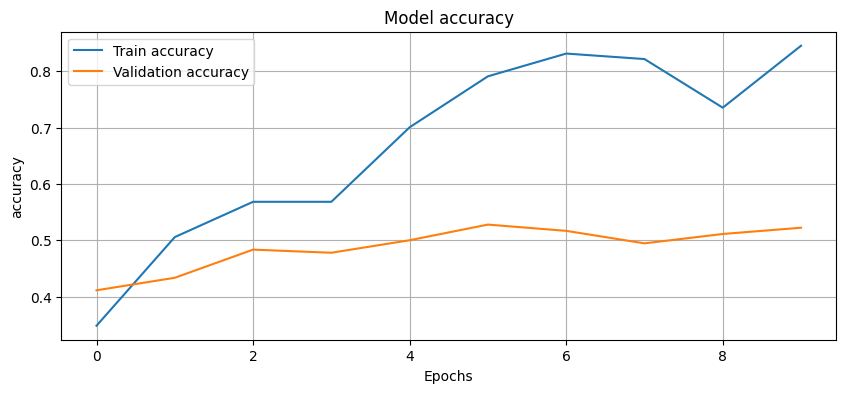

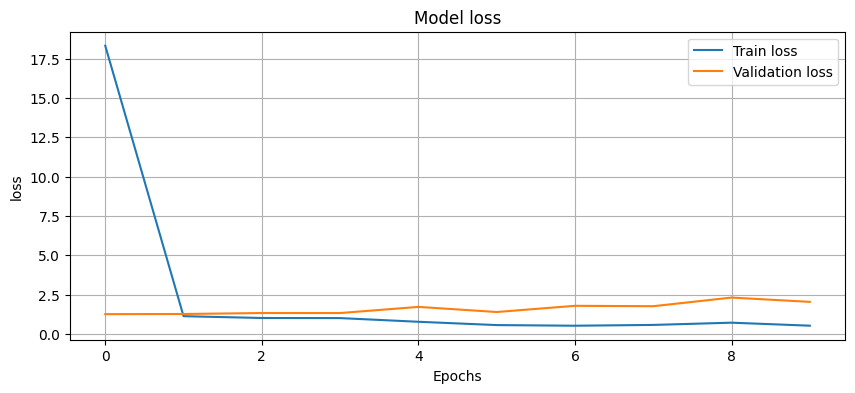

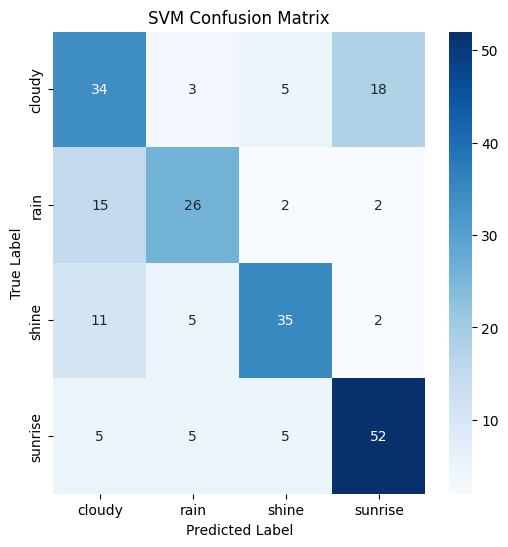

Epoch 1/10
23/23 [==============================] - 10s 421ms/step - loss: 0.3673 - accuracy: 0.8747 - val_loss: 1.6560 - val_accuracy: 0.5389
Epoch 2/10
23/23 [==============================] - 9s 394ms/step - loss: 0.2838 - accuracy: 0.9150 - val_loss: 1.8875 - val_accuracy: 0.5944
Epoch 3/10
23/23 [==============================] - 9s 374ms/step - loss: 0.2074 - accuracy: 0.9345 - val_loss: 1.9891 - val_accuracy: 0.5111
Epoch 4/10
23/23 [==============================] - 10s 428ms/step - loss: 0.2127 - accuracy: 0.9485 - val_loss: 1.9058 - val_accuracy: 0.5333
Epoch 5/10
23/23 [==============================] - 8s 351ms/step - loss: 0.1687 - accuracy: 0.9568 - val_loss: 3.0682 - val_accuracy: 0.5778
Epoch 6/10
23/23 [==============================] - 10s 420ms/step - loss: 0.1667 - accuracy: 0.9513 - val_loss: 2.3166 - val_accuracy: 0.5167
Epoch 7/10
23/23 [==============================] - 10s 420ms/step - loss: 0.3308 - accuracy: 0.8914 - val_loss: 2.2197 - val_accuracy: 0.5611
Ep

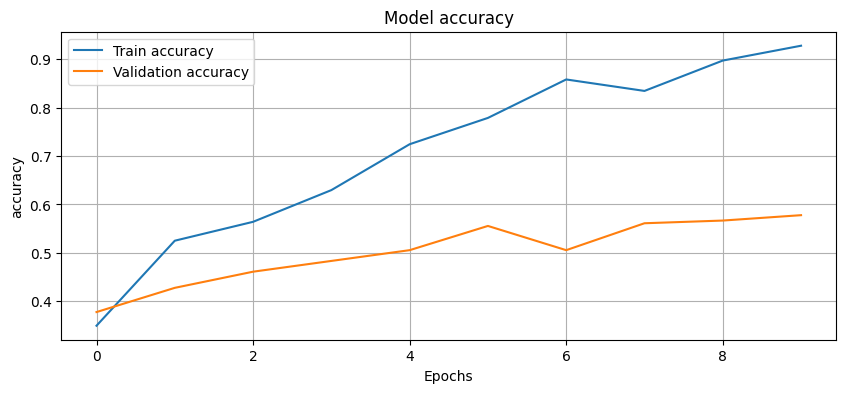

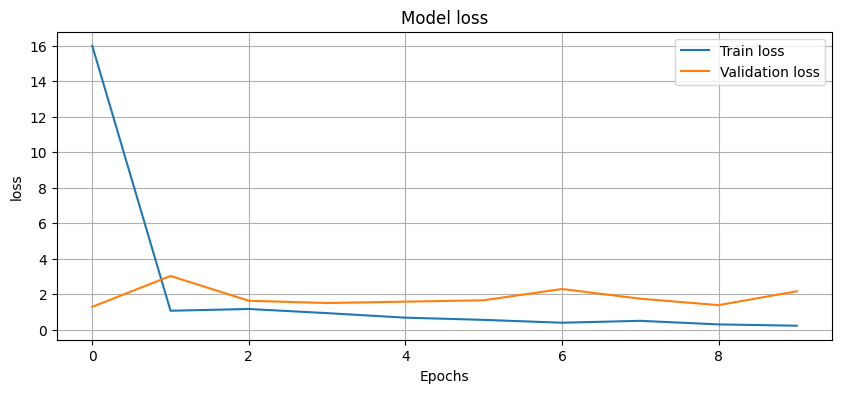

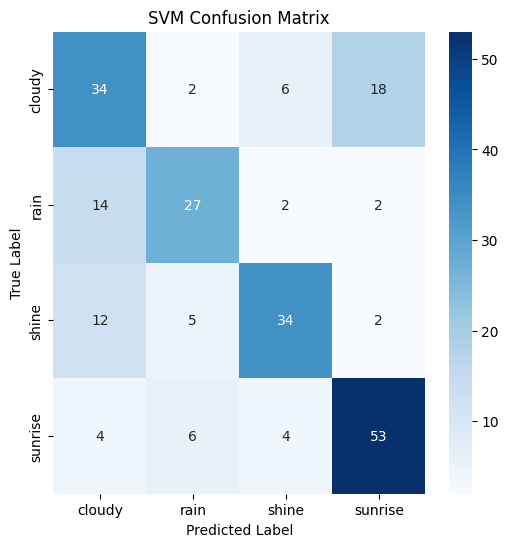

Epoch 1/10
23/23 [==============================] - 9s 373ms/step - loss: 0.1930 - accuracy: 0.9471 - val_loss: 1.8949 - val_accuracy: 0.5278
Epoch 2/10
23/23 [==============================] - 10s 441ms/step - loss: 0.1564 - accuracy: 0.9582 - val_loss: 1.9223 - val_accuracy: 0.6611
Epoch 3/10
23/23 [==============================] - 10s 451ms/step - loss: 0.1175 - accuracy: 0.9721 - val_loss: 2.6281 - val_accuracy: 0.5667
Epoch 4/10
23/23 [==============================] - 9s 374ms/step - loss: 0.0725 - accuracy: 0.9721 - val_loss: 3.2134 - val_accuracy: 0.5833
Epoch 5/10
23/23 [==============================] - 10s 438ms/step - loss: 0.0854 - accuracy: 0.9819 - val_loss: 2.6811 - val_accuracy: 0.5889
Epoch 6/10
23/23 [==============================] - 10s 443ms/step - loss: 0.0734 - accuracy: 0.9819 - val_loss: 2.8485 - val_accuracy: 0.5667
Epoch 7/10
23/23 [==============================] - 9s 375ms/step - loss: 0.0605 - accuracy: 0.9875 - val_loss: 3.3136 - val_accuracy: 0.5556
Ep

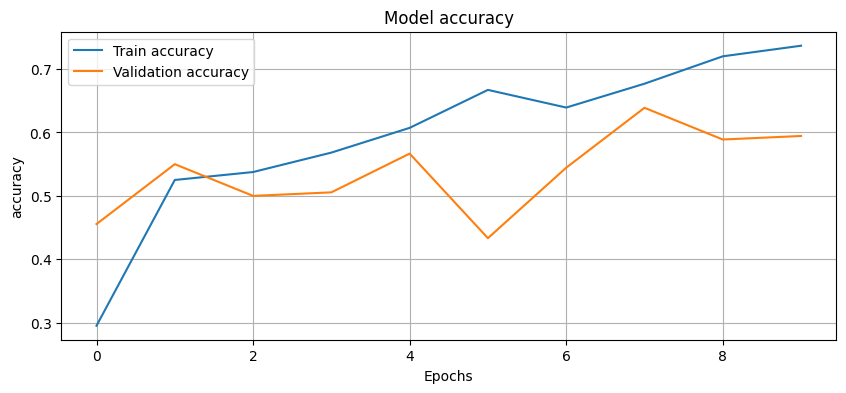

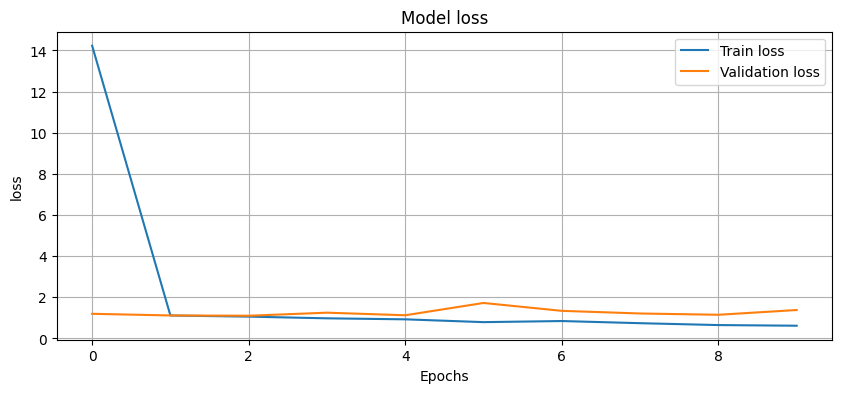

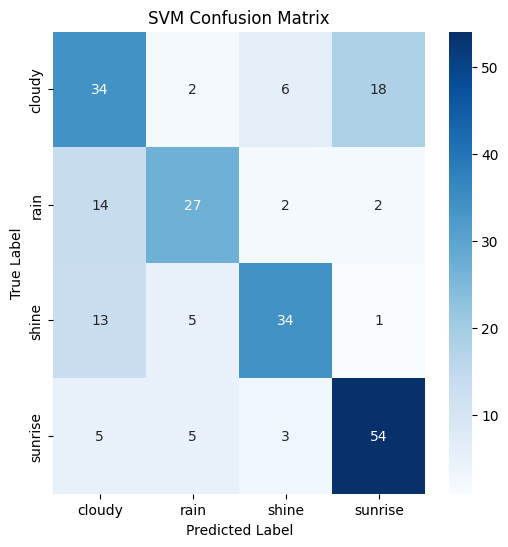

Epoch 1/10
23/23 [==============================] - 11s 473ms/step - loss: 0.5140 - accuracy: 0.7772 - val_loss: 1.1640 - val_accuracy: 0.5944
Epoch 2/10
23/23 [==============================] - 10s 452ms/step - loss: 0.4641 - accuracy: 0.8050 - val_loss: 1.3866 - val_accuracy: 0.6278
Epoch 3/10
23/23 [==============================] - 10s 410ms/step - loss: 0.4555 - accuracy: 0.8092 - val_loss: 1.3763 - val_accuracy: 0.6222
Epoch 4/10
23/23 [==============================] - 11s 469ms/step - loss: 0.4134 - accuracy: 0.8301 - val_loss: 1.3634 - val_accuracy: 0.6278
Epoch 5/10
23/23 [==============================] - 11s 474ms/step - loss: 0.3578 - accuracy: 0.8538 - val_loss: 1.7331 - val_accuracy: 0.6000
Epoch 6/10
23/23 [==============================] - 9s 396ms/step - loss: 0.2780 - accuracy: 0.8802 - val_loss: 1.8115 - val_accuracy: 0.6556
Epoch 7/10
23/23 [==============================] - 11s 465ms/step - loss: 0.2096 - accuracy: 0.9262 - val_loss: 2.0643 - val_accuracy: 0.6222


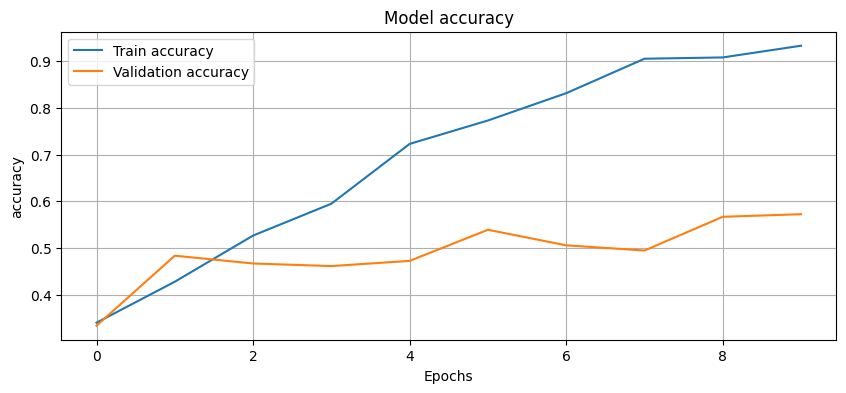

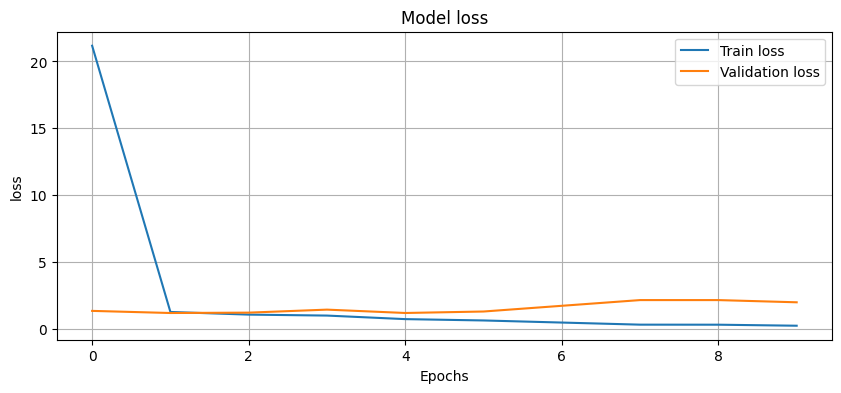

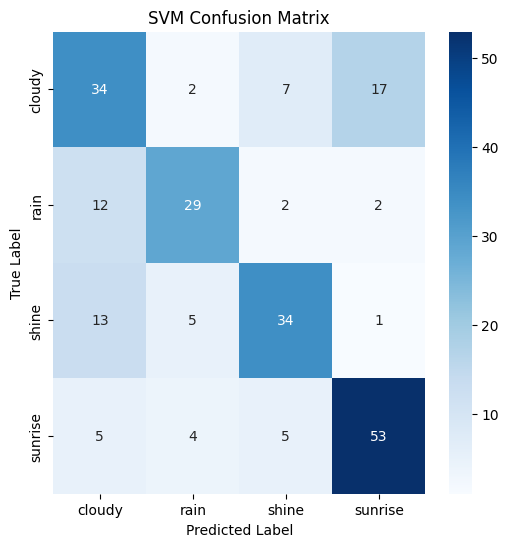

Epoch 1/10
23/23 [==============================] - 11s 468ms/step - loss: 0.1238 - accuracy: 0.9568 - val_loss: 2.3833 - val_accuracy: 0.5833
Epoch 2/10
23/23 [==============================] - 11s 459ms/step - loss: 0.1241 - accuracy: 0.9666 - val_loss: 2.1697 - val_accuracy: 0.5722
Epoch 3/10
23/23 [==============================] - 9s 400ms/step - loss: 0.1306 - accuracy: 0.9652 - val_loss: 2.0524 - val_accuracy: 0.5611
Epoch 4/10
23/23 [==============================] - 11s 468ms/step - loss: 0.1476 - accuracy: 0.9568 - val_loss: 1.9634 - val_accuracy: 0.5500
Epoch 5/10
23/23 [==============================] - 11s 471ms/step - loss: 0.1576 - accuracy: 0.9513 - val_loss: 2.0731 - val_accuracy: 0.5444
Epoch 6/10
23/23 [==============================] - 9s 395ms/step - loss: 0.1523 - accuracy: 0.9554 - val_loss: 2.8740 - val_accuracy: 0.5500
Epoch 7/10
23/23 [==============================] - 11s 463ms/step - loss: 0.1313 - accuracy: 0.9735 - val_loss: 3.2485 - val_accuracy: 0.5000
E

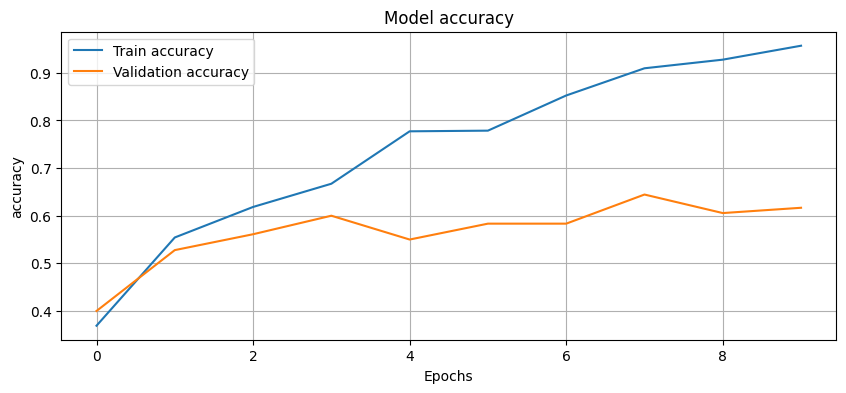

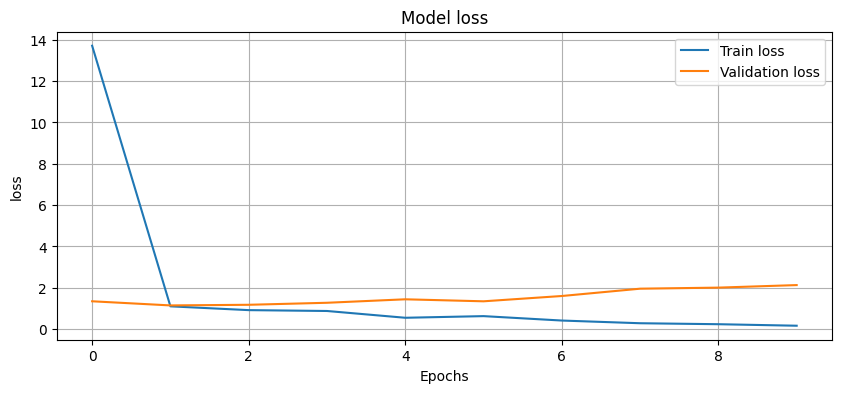

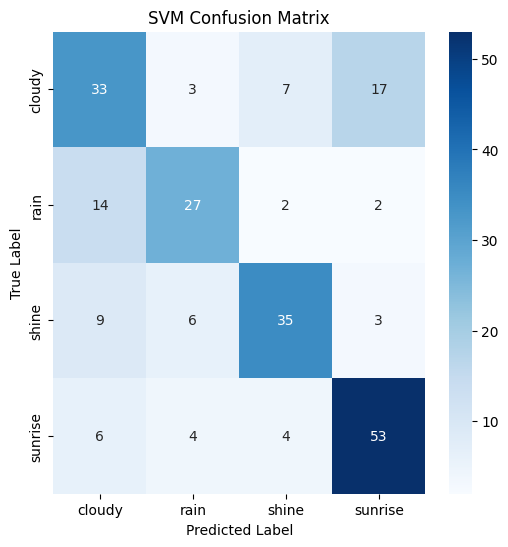

Epoch 1/10
23/23 [==============================] - 11s 492ms/step - loss: 0.1399 - accuracy: 0.9540 - val_loss: 2.5027 - val_accuracy: 0.6222
Epoch 2/10
23/23 [==============================] - 11s 487ms/step - loss: 0.0922 - accuracy: 0.9735 - val_loss: 2.7521 - val_accuracy: 0.6056
Epoch 3/10
23/23 [==============================] - 10s 457ms/step - loss: 0.0649 - accuracy: 0.9847 - val_loss: 2.6720 - val_accuracy: 0.5944
Epoch 4/10
23/23 [==============================] - 10s 444ms/step - loss: 0.0618 - accuracy: 0.9861 - val_loss: 3.0654 - val_accuracy: 0.6111
Epoch 5/10
23/23 [==============================] - 11s 487ms/step - loss: 0.0239 - accuracy: 0.9944 - val_loss: 3.6091 - val_accuracy: 0.6167
Epoch 6/10
23/23 [==============================] - 11s 485ms/step - loss: 0.0258 - accuracy: 0.9930 - val_loss: 3.3215 - val_accuracy: 0.6389
Epoch 7/10
23/23 [==============================] - 10s 448ms/step - loss: 0.0768 - accuracy: 0.9861 - val_loss: 3.5253 - val_accuracy: 0.6278

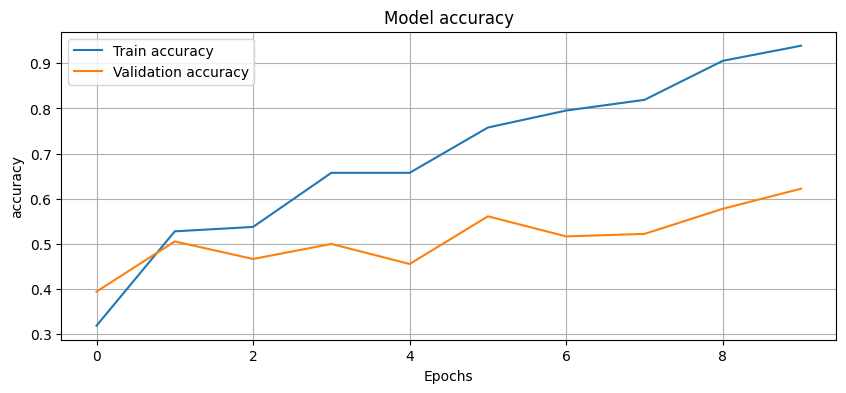

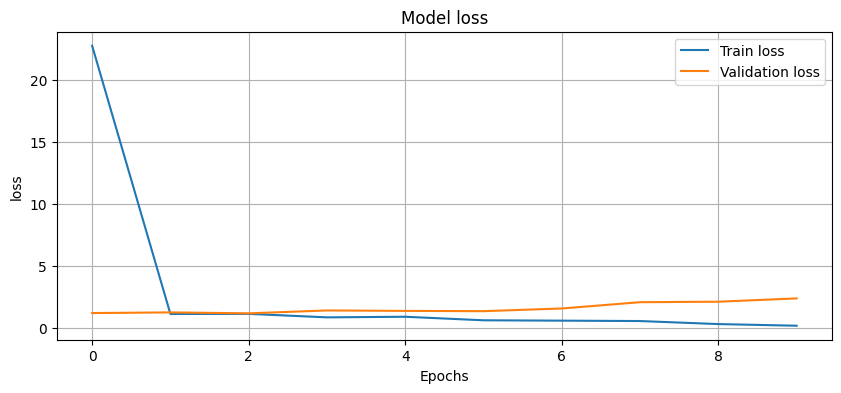

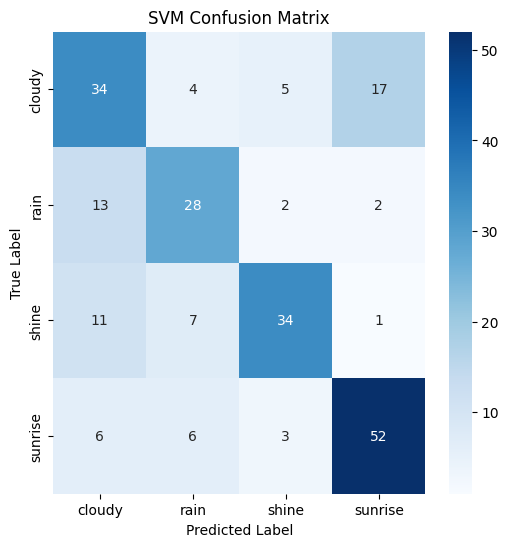

Epoch 1/10
23/23 [==============================] - 11s 484ms/step - loss: 0.0816 - accuracy: 0.9819 - val_loss: 2.4407 - val_accuracy: 0.6167
Epoch 2/10
23/23 [==============================] - 11s 485ms/step - loss: 0.0568 - accuracy: 0.9861 - val_loss: 2.4583 - val_accuracy: 0.6500
Epoch 3/10
23/23 [==============================] - 10s 437ms/step - loss: 0.0893 - accuracy: 0.9721 - val_loss: 2.6426 - val_accuracy: 0.5556
Epoch 4/10
23/23 [==============================] - 10s 443ms/step - loss: 0.1739 - accuracy: 0.9540 - val_loss: 3.3728 - val_accuracy: 0.4944
Epoch 5/10
23/23 [==============================] - 11s 482ms/step - loss: 0.2117 - accuracy: 0.9513 - val_loss: 2.7514 - val_accuracy: 0.5889
Epoch 6/10
23/23 [==============================] - 11s 497ms/step - loss: 0.0884 - accuracy: 0.9749 - val_loss: 3.5411 - val_accuracy: 0.5944
Epoch 7/10
23/23 [==============================] - 9s 407ms/step - loss: 0.0574 - accuracy: 0.9847 - val_loss: 3.5357 - val_accuracy: 0.5833


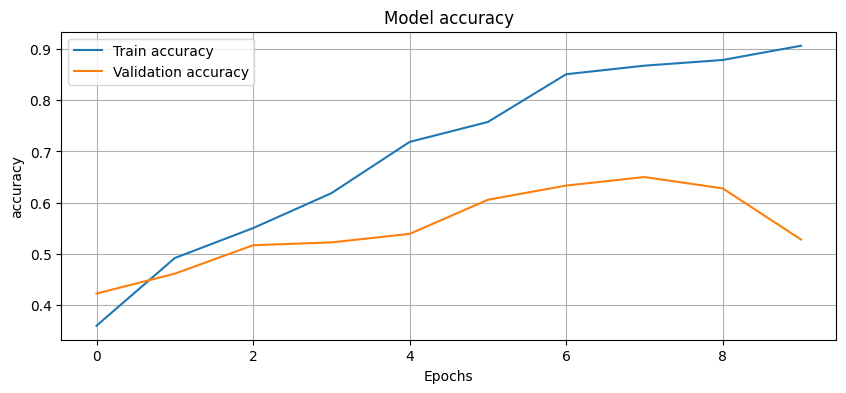

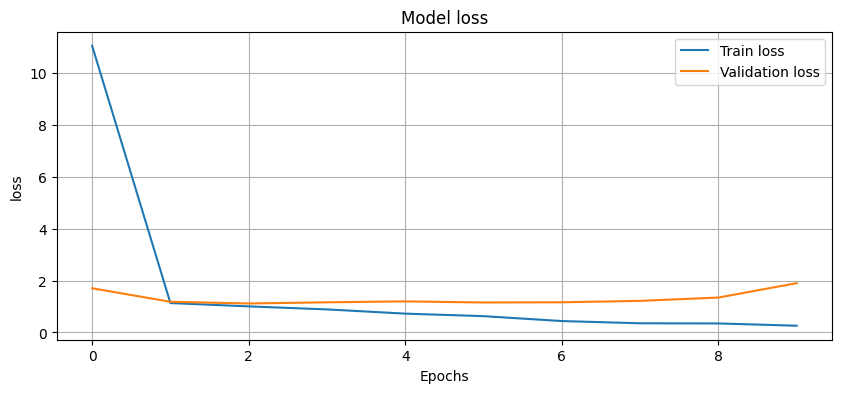

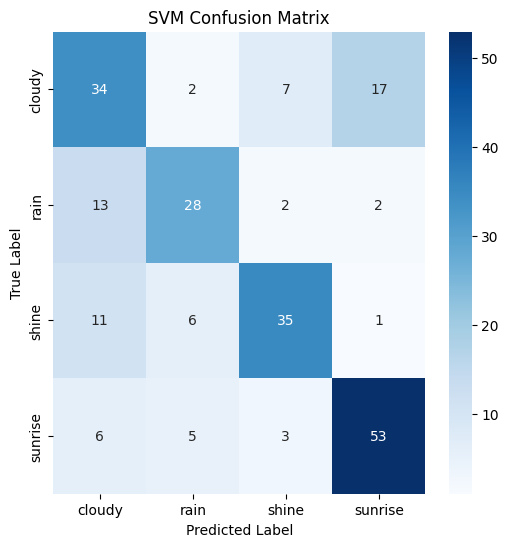

Epoch 1/10
23/23 [==============================] - 11s 492ms/step - loss: 0.2722 - accuracy: 0.9109 - val_loss: 3.2534 - val_accuracy: 0.5667
Epoch 2/10
23/23 [==============================] - 11s 488ms/step - loss: 0.4902 - accuracy: 0.8510 - val_loss: 2.2914 - val_accuracy: 0.6000
Epoch 3/10
23/23 [==============================] - 10s 439ms/step - loss: 0.2593 - accuracy: 0.9262 - val_loss: 2.3709 - val_accuracy: 0.5944
Epoch 4/10
23/23 [==============================] - 11s 459ms/step - loss: 0.1827 - accuracy: 0.9415 - val_loss: 2.8230 - val_accuracy: 0.6167
Epoch 5/10
23/23 [==============================] - 11s 503ms/step - loss: 0.1069 - accuracy: 0.9666 - val_loss: 2.6248 - val_accuracy: 0.5944
Epoch 6/10
23/23 [==============================] - 11s 501ms/step - loss: 0.0579 - accuracy: 0.9889 - val_loss: 2.9688 - val_accuracy: 0.5889
Epoch 7/10
23/23 [==============================] - 11s 474ms/step - loss: 0.0352 - accuracy: 0.9903 - val_loss: 3.0357 - val_accuracy: 0.6222

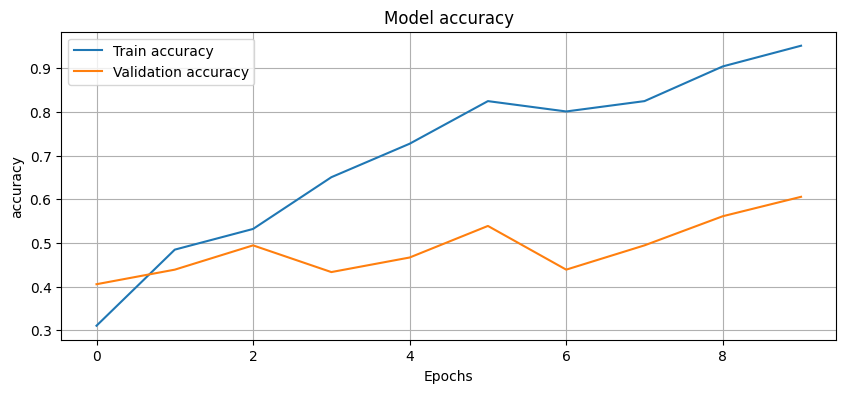

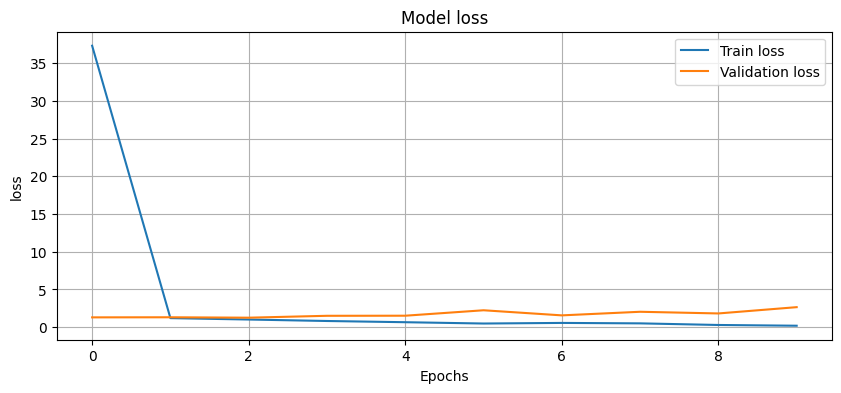

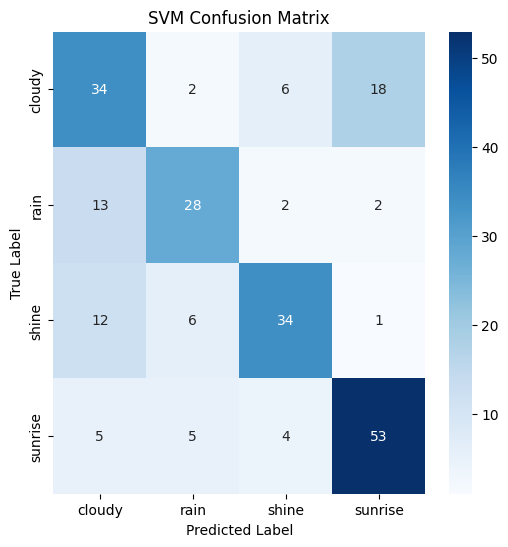

Epoch 1/10
23/23 [==============================] - 12s 510ms/step - loss: 0.1009 - accuracy: 0.9749 - val_loss: 2.8878 - val_accuracy: 0.6278
Epoch 2/10
23/23 [==============================] - 12s 504ms/step - loss: 0.1974 - accuracy: 0.9457 - val_loss: 2.7025 - val_accuracy: 0.4889
Epoch 3/10
23/23 [==============================] - 11s 494ms/step - loss: 0.2795 - accuracy: 0.9136 - val_loss: 2.6754 - val_accuracy: 0.5056
Epoch 4/10
23/23 [==============================] - 10s 440ms/step - loss: 0.2058 - accuracy: 0.9373 - val_loss: 3.0793 - val_accuracy: 0.5111
Epoch 5/10
23/23 [==============================] - 12s 504ms/step - loss: 0.1496 - accuracy: 0.9652 - val_loss: 2.6405 - val_accuracy: 0.5333
Epoch 6/10
23/23 [==============================] - 12s 510ms/step - loss: 0.0936 - accuracy: 0.9791 - val_loss: 3.5697 - val_accuracy: 0.5167
Epoch 7/10
23/23 [==============================] - 12s 526ms/step - loss: 0.1234 - accuracy: 0.9694 - val_loss: 4.0111 - val_accuracy: 0.5167

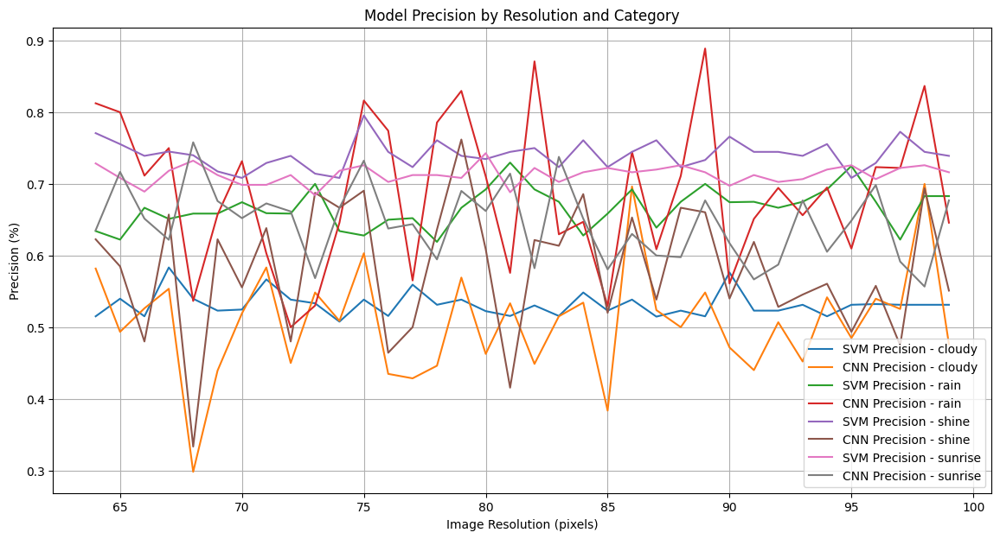

In [ ]:

def plot_metrics(history, metric='accuracy', val_metric='val_accuracy'):
    plt.figure(figsize=(10, 4))
    plt.plot(history.history[metric], label='Train ' + metric)
    plt.plot(history.history[val_metric], label='Validation ' + metric)
    plt.title('Model ' + metric)
    plt.ylabel(metric)
    plt.xlabel('Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image.flatten())
                labels.append(category)

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data
    X_train, X_test, y_train, y_test = train_test_split(
        np.array(data), encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train, y_train)
    svm_predictions = svm_model.predict(X_test)
    svm_accuracy = accuracy_score(y_test, svm_predictions)
    svm_report = precision_recall_fscore_support(y_test, svm_predictions, average=None, labels=[0,1,2,3])
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test, svm_predictions, target_names=label_encoder.classes_))

    # CNN model
    cnn_model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 1)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax')
    ])

    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    # Reshape data for CNN
    X_train_cnn = X_train.reshape((-1, target_size[0], target_size[1], 1))
    X_test_cnn = X_test.reshape((-1, target_size[0], target_size[1], 1))

    history = cnn_model.fit(X_train_cnn, y_train, epochs=10, validation_split=0.2)
    cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test_cnn, y_test)
    print(f"CNN Accuracy: {cnn_accuracy}")

    # Plot accuracy and loss
    plot_metrics(history, 'accuracy', 'val_accuracy')
    plot_metrics(history, 'loss', 'val_loss')

    # Confusion matrices
    svm_cm = confusion_matrix(y_test, svm_predictions)
    plot_confusion_matrix(svm_cm, label_encoder.classes_, "SVM Confusion Matrix")



    cnn_model.fit(X_train_cnn, y_train, epochs=10, validation_split=0.2)
    cnn_predictions = cnn_model.predict(X_test_cnn)
    cnn_predictions = np.argmax(cnn_predictions, axis=1)
    cnn_report = precision_recall_fscore_support(y_test, cnn_predictions, average=None, labels=[0,1,2,3])

    return svm_report, cnn_report, label_encoder.classes_

# Collecting accuracies
svm_results = []
cnn_results = []
resolutions = range(64, 100)  # Change range as needed
labels = []

for i in resolutions:
    svm_report, cnn_report, classes = train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset', (i, i))
    svm_results.append(svm_report)
    cnn_results.append(cnn_report)
    labels = classes  # Save label names for later use

# Plotting
plt.figure(figsize=(14, 7))

for i, category in enumerate(labels):
    category_accuracies_svm = [result[0][i] for result in svm_results]  # Precision values for SVM
    category_accuracies_cnn = [result[0][i] for result in cnn_results]  # Precision values for CNN
    plt.plot(resolutions, category_accuracies_svm, label=f'SVM Precision - {category}')
    plt.plot(resolutions, category_accuracies_cnn, label=f'CNN Precision - {category}')

plt.xlabel('Image Resolution (pixels)')
plt.ylabel('Precision (%)')
plt.title('Model Precision by Resolution and Category')
plt.legend()
plt.grid(True)
plt.show()

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.78      0.78      0.78        45
       shine       0.88      0.83      0.85        53
     sunrise       0.98      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.83      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 5s 165ms/step - loss: 17.3222 - accuracy: 0.4150 - val_loss: 1.1330 - val_accuracy: 0.5778
Epoch 2/10
23/23 [==============================] - 5s 229ms/step - loss: 0.7935 - accuracy: 0.6852 - val_loss: 1.0872 - val_accuracy: 0.6500
Epoch 3/10
23/23 [==============================] - 4s 156ms/step - loss: 0.7131 - accuracy: 0.7340 - val_loss: 1.5082 - val_accuracy: 0.7167
Epoch 4/10
23/23 [==============================] - 4s 157ms/step - loss: 0.6357 - accuracy: 0.7451 - val

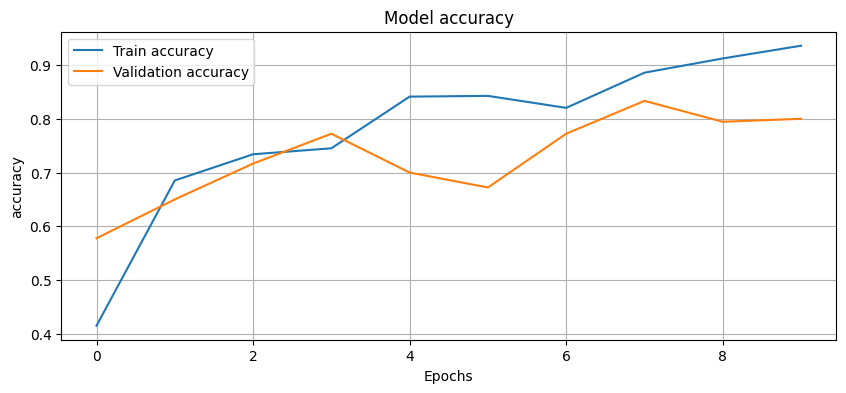

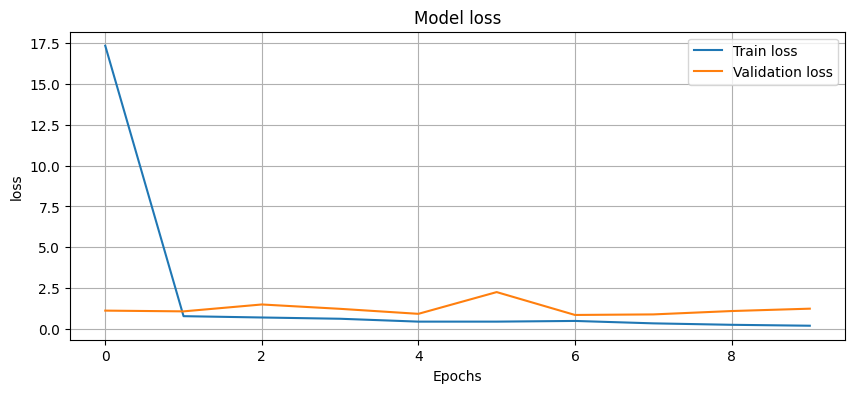

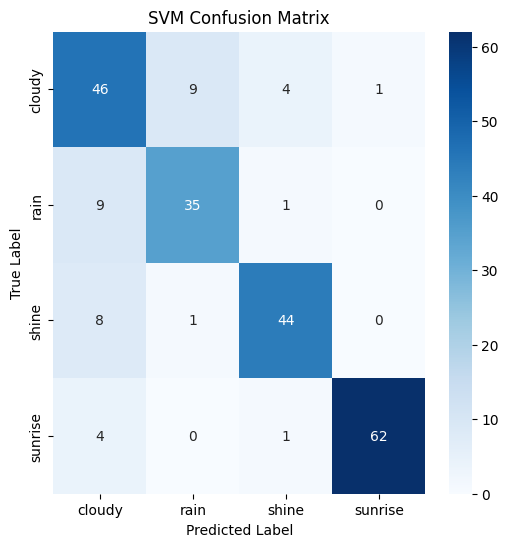

8/8 [==============================] - 0s 35ms/step


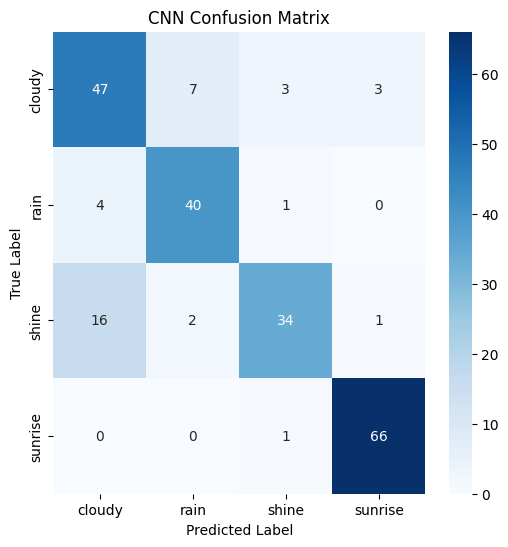

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 239ms/step - loss: 17.7959 - accuracy: 0.5167 - val_loss: 1.2511 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 4s 161ms/step - loss: 0.7241 - accuracy: 0.7047 - val_loss: 1.0760 - val_accuracy: 0.7444
Epoch 3/10
23/23 [==============================] - 4s 157ms/step - loss: 0.5089 - accuracy: 0.8189 - val_loss: 0.9275 - val_accuracy: 0.8111
Epoch 4/10
23/23 [==============================] - 5s 212ms/step - loss: 0.4807 - accuracy: 0.8357 - val

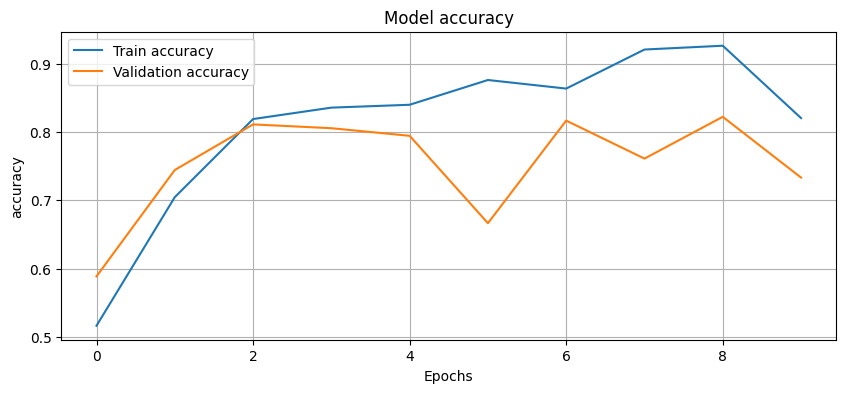

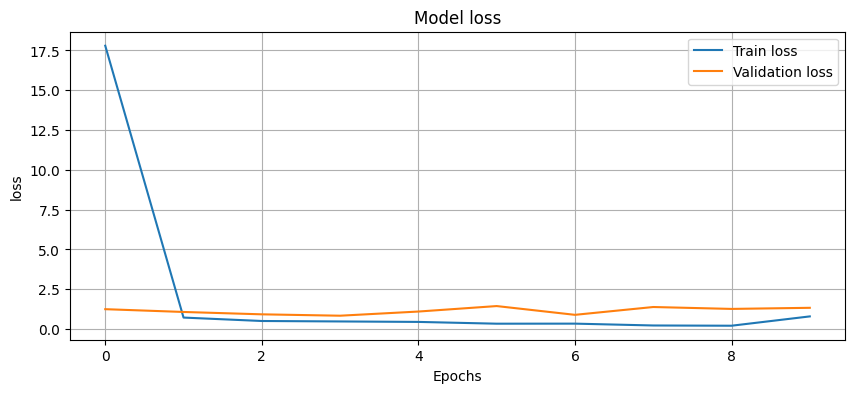

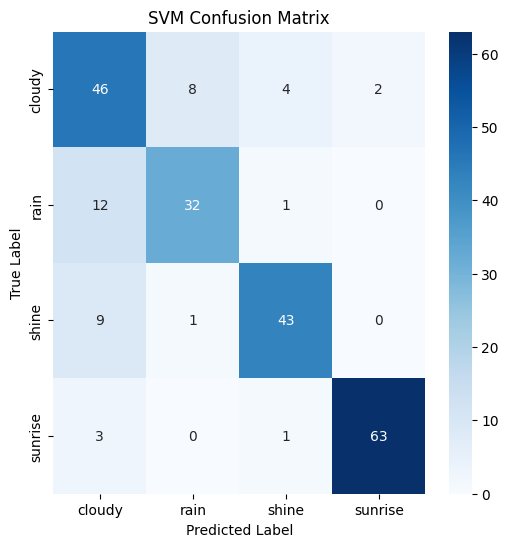

8/8 [==============================] - 0s 38ms/step


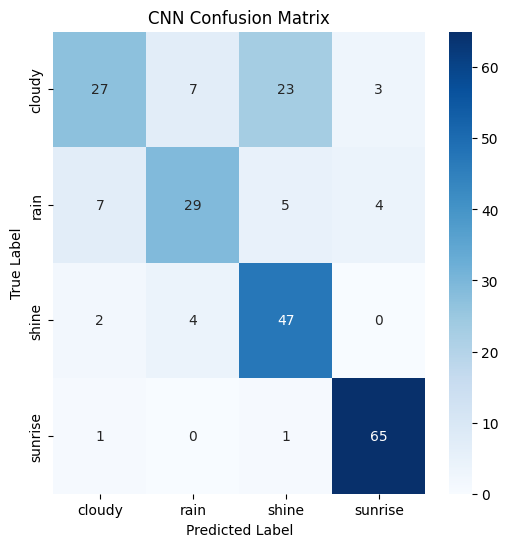

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 257ms/step - loss: 28.5624 - accuracy: 0.4025 - val_loss: 1.3785 - val_accuracy: 0.5278
Epoch 2/10
23/23 [==============================] - 4s 173ms/step - loss: 0.8548 - accuracy: 0.6490 - val_loss: 0.8558 - val_accuracy: 0.6389
Epoch 3/10
23/23 [==============================] - 4s 174ms/step - loss: 0.6517 - accuracy: 0.7145 - val_loss: 0.7114 - val_accuracy: 0.7389
Epoch 4/10
23/23 [==============================] - 6s 252ms/step - loss: 0.5081 - accuracy: 0.7925 - val

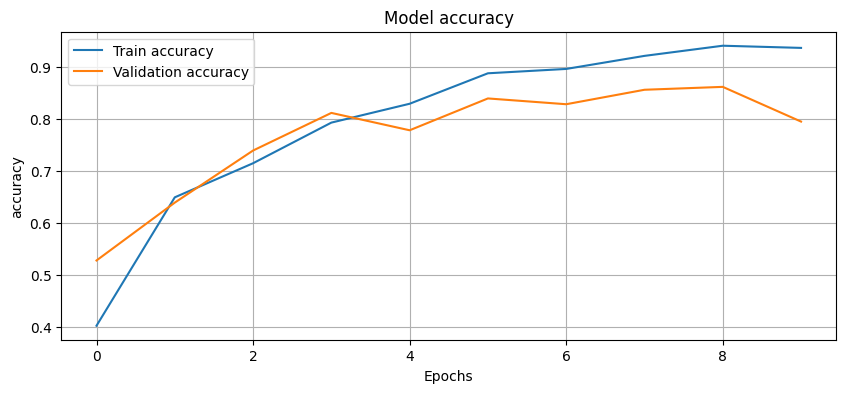

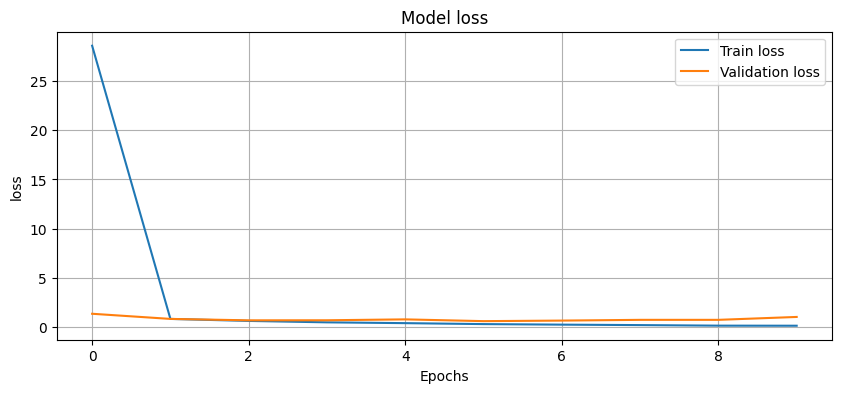

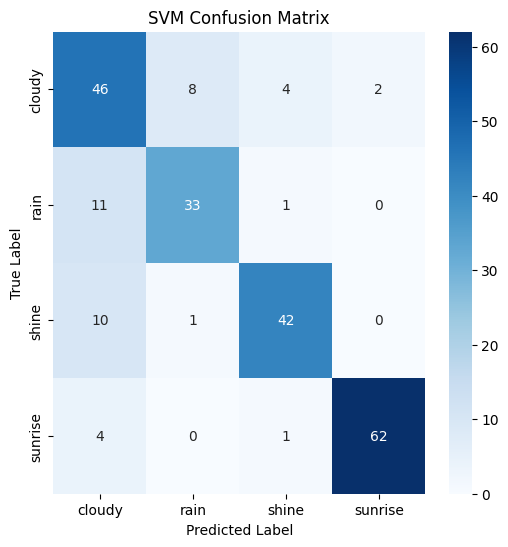

8/8 [==============================] - 1s 69ms/step


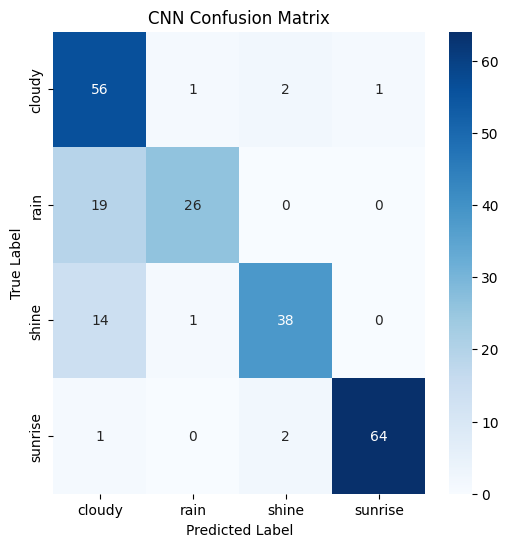

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 183ms/step - loss: 23.6329 - accuracy: 0.5334 - val_loss: 1.1184 - val_accuracy: 0.7111
Epoch 2/10
23/23 [==============================] - 6s 250ms/step - loss: 0.6938 - accuracy: 0.7465 - val_loss: 1.0100 - val_accuracy: 0.6722
Epoch 3/10
23/23 [==============================] - 4s 173ms/step - loss: 0.6334 - accuracy: 0.7813 - val_loss: 0.8565 - val_accuracy: 0.8000
Epoch 4/10
23/23 [==============================] - 4s 176ms/step - loss: 0.5529 - accuracy: 0.8189 - val

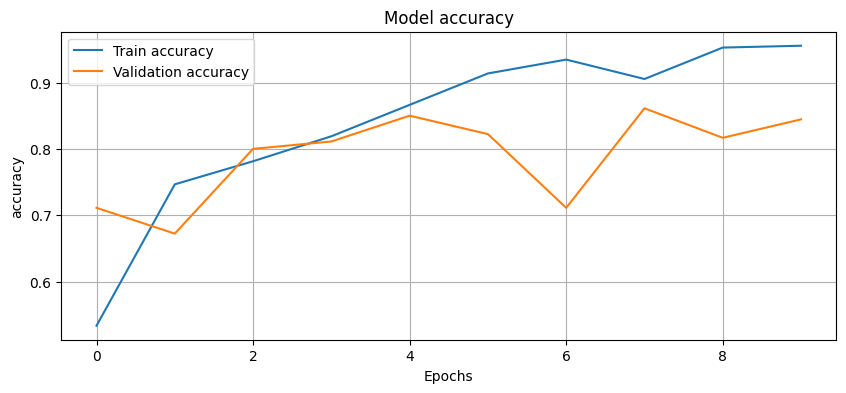

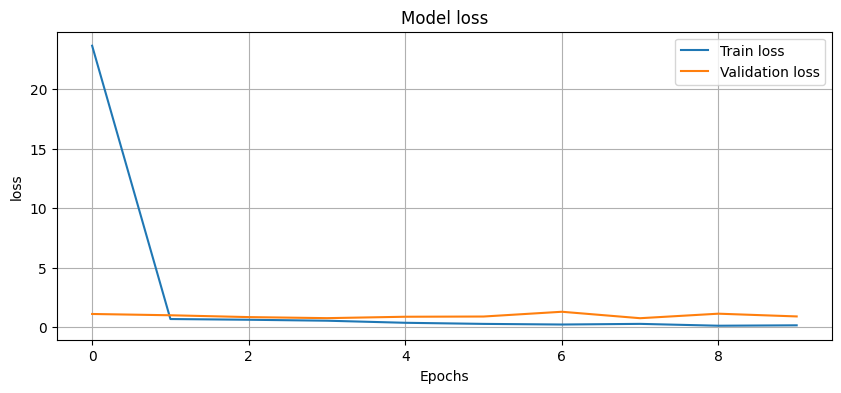

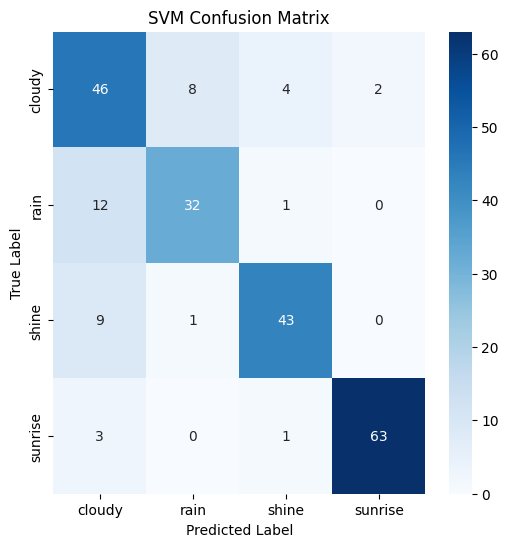

8/8 [==============================] - 0s 39ms/step


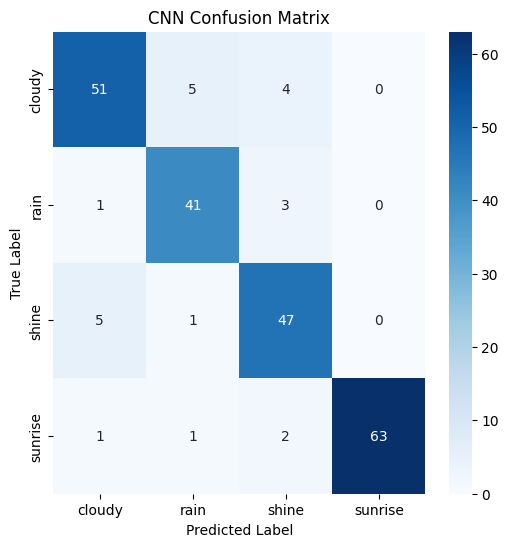

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 195ms/step - loss: 7.3558 - accuracy: 0.5710 - val_loss: 0.9186 - val_accuracy: 0.7500
Epoch 2/10
23/23 [==============================] - 6s 261ms/step - loss: 0.7089 - accuracy: 0.7604 - val_loss: 0.9707 - val_accuracy: 0.7500
Epoch 3/10
23/23 [==============================] - 4s 182ms/step - loss: 0.6347 - accuracy: 0.7479 - val_loss: 1.0857 - val_accuracy: 0.7389
Epoch 4/10
23/23 [==============================] - 4s 184ms/step - loss: 0.5361 - accuracy: 0.8106 - val_

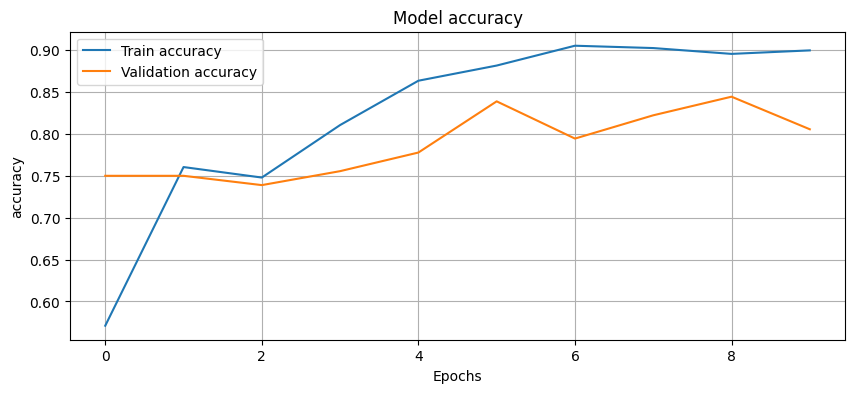

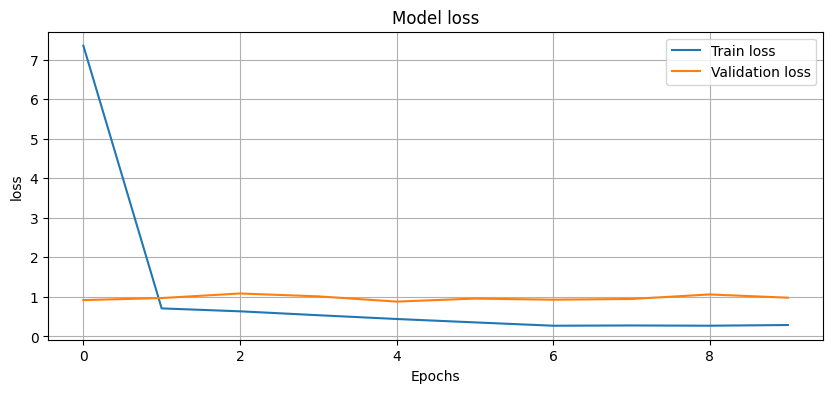

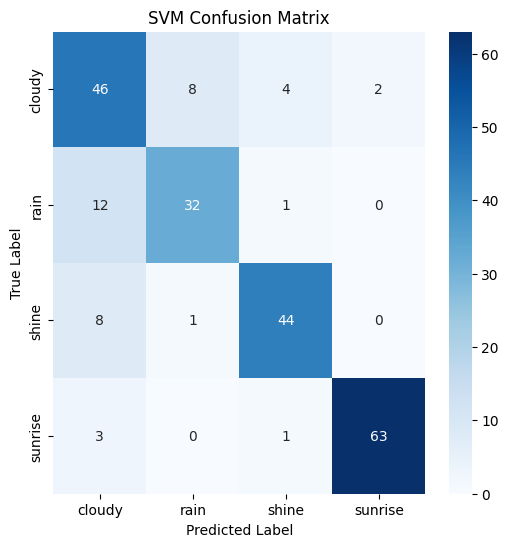

8/8 [==============================] - 0s 47ms/step


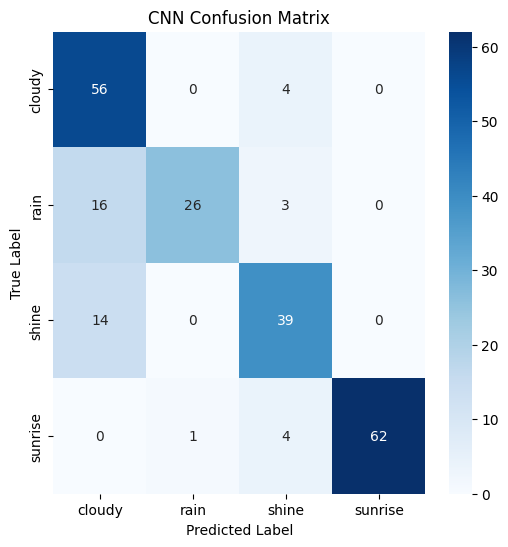

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 196ms/step - loss: 15.7852 - accuracy: 0.4903 - val_loss: 0.8630 - val_accuracy: 0.7278
Epoch 2/10
23/23 [==============================] - 5s 229ms/step - loss: 0.7495 - accuracy: 0.6783 - val_loss: 0.8330 - val_accuracy: 0.7944
Epoch 3/10
23/23 [==============================] - 5s 219ms/step - loss: 0.5319 - accuracy: 0.8273 - val_loss: 0.9900 - val_accuracy: 0.8222
Epoch 4/10
23/23 [==============================] - 4s 185ms/step - loss: 0.5707 - accuracy: 0.7827 - val

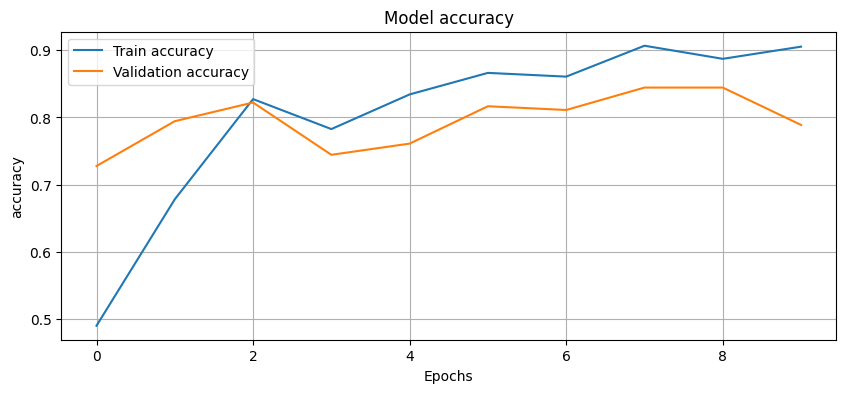

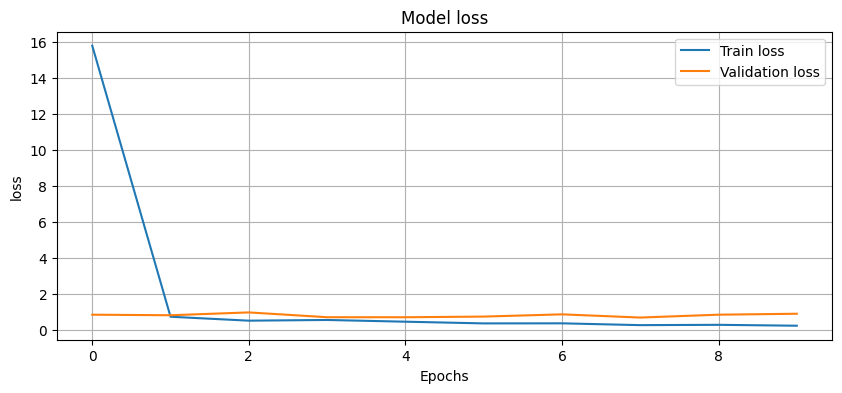

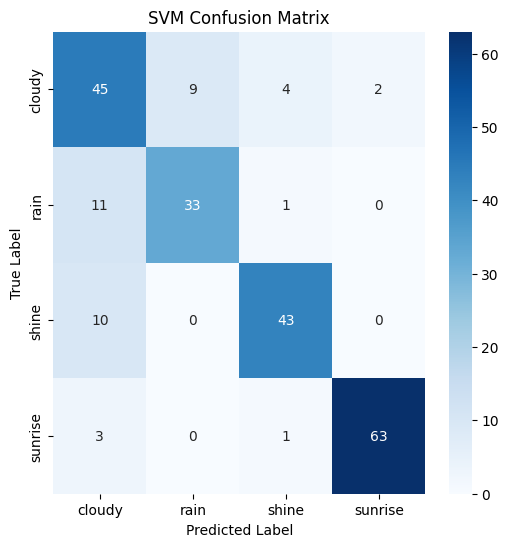

8/8 [==============================] - 0s 47ms/step


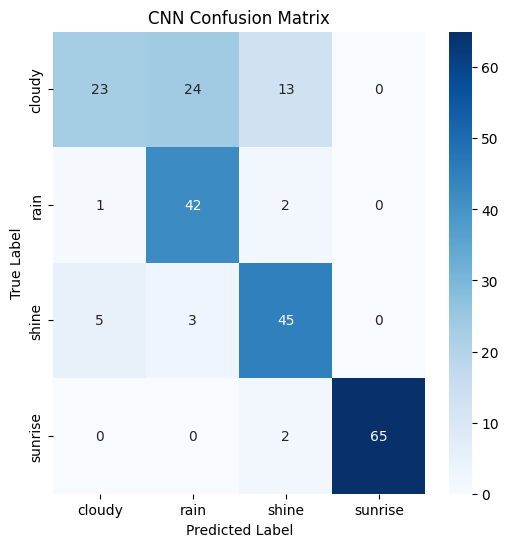

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.68      0.73      0.70        60
        rain       0.76      0.78      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.82      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 208ms/step - loss: 12.1965 - accuracy: 0.5084 - val_loss: 0.8586 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 5s 239ms/step - loss: 0.7226 - accuracy: 0.7187 - val_loss: 0.8493 - val_accuracy: 0.7500
Epoch 3/10
23/23 [==============================] - 5s 226ms/step - loss: 0.7188 - accuracy: 0.7396 - val_loss: 0.7960 - val_accuracy: 0.7444
Epoch 4/10
23/23 [==============================] - 5s 199ms/step - loss: 0.7111 - accuracy: 0.7340 - val

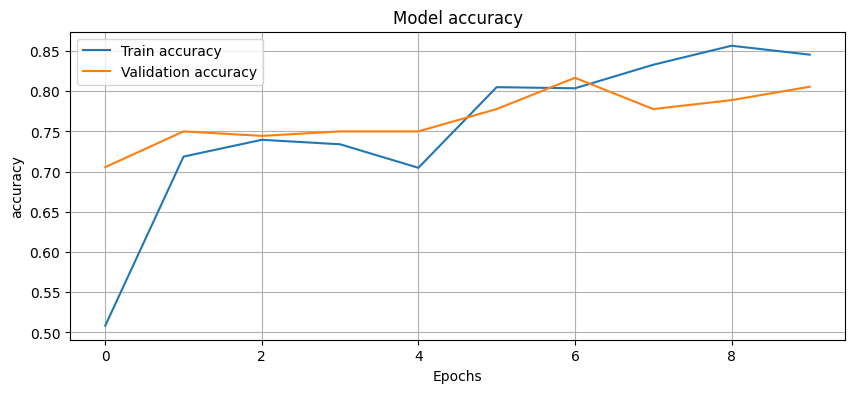

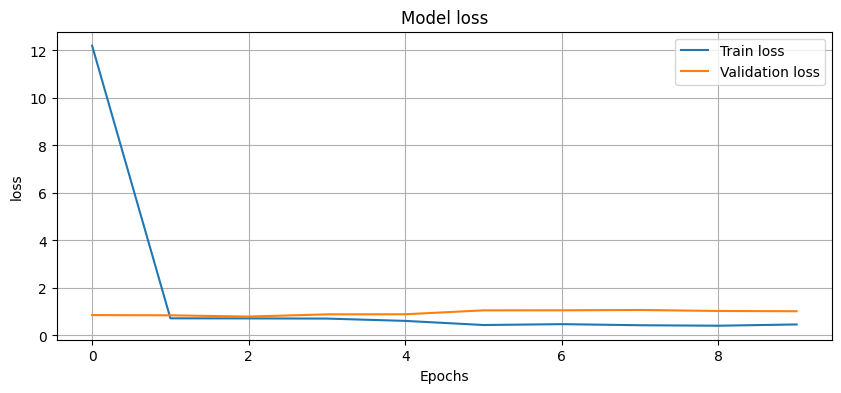

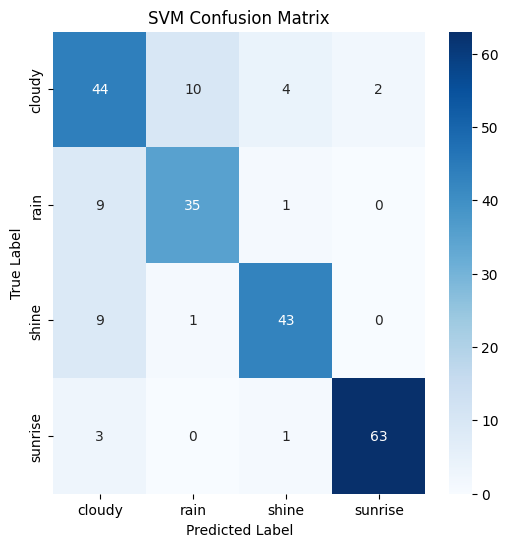

8/8 [==============================] - 0s 52ms/step


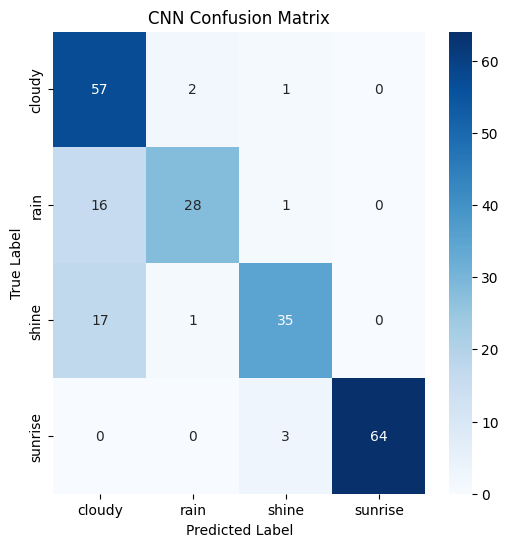

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 220ms/step - loss: 11.6322 - accuracy: 0.5237 - val_loss: 0.7622 - val_accuracy: 0.7556
Epoch 2/10
23/23 [==============================] - 5s 196ms/step - loss: 0.6485 - accuracy: 0.7493 - val_loss: 0.8152 - val_accuracy: 0.8222
Epoch 3/10
23/23 [==============================] - 6s 272ms/step - loss: 0.4502 - accuracy: 0.8370 - val_loss: 0.8240 - val_accuracy: 0.7778
Epoch 4/10
23/23 [==============================] - 5s 197ms/step - loss: 0.3885 - accuracy: 0.8607 - val

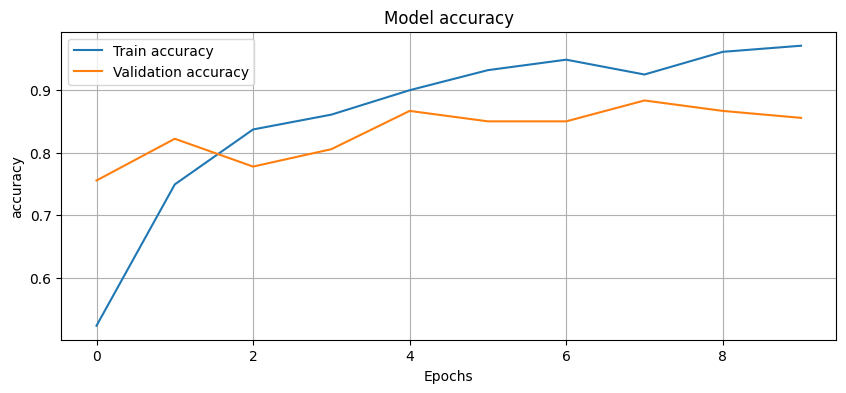

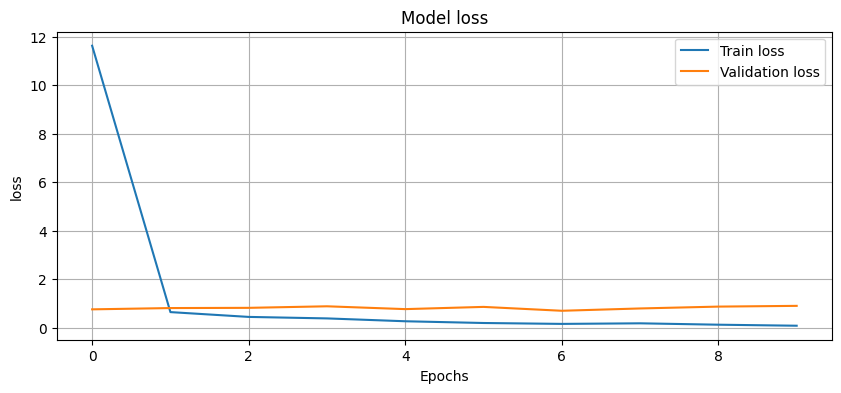

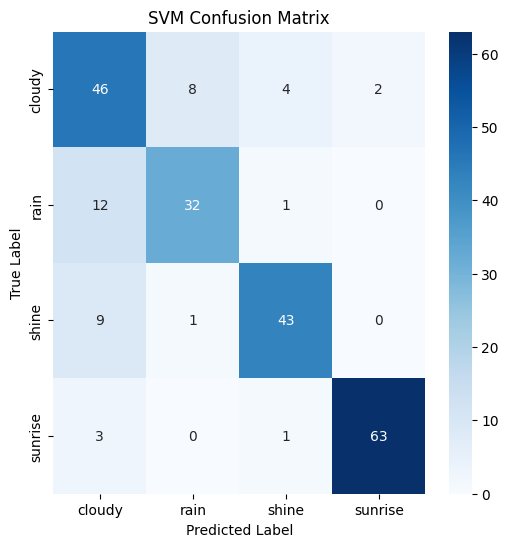

8/8 [==============================] - 0s 53ms/step


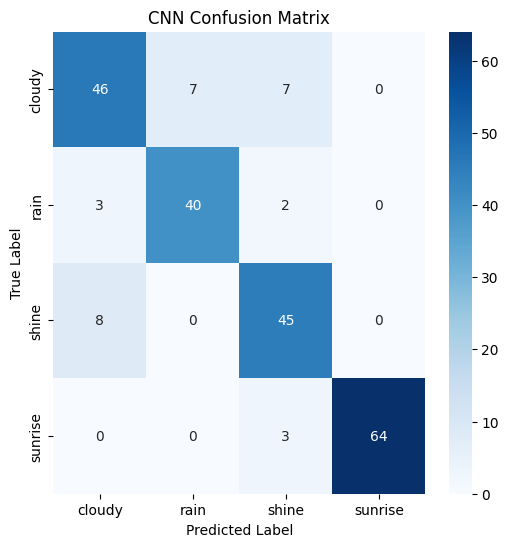

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 255ms/step - loss: 8.7144 - accuracy: 0.5669 - val_loss: 0.8474 - val_accuracy: 0.7222
Epoch 2/10
23/23 [==============================] - 5s 211ms/step - loss: 0.5177 - accuracy: 0.7883 - val_loss: 0.7901 - val_accuracy: 0.8444
Epoch 3/10
23/23 [==============================] - 6s 284ms/step - loss: 0.3773 - accuracy: 0.8844 - val_loss: 0.7427 - val_accuracy: 0.8500
Epoch 4/10
23/23 [==============================] - 5s 209ms/step - loss: 0.3017 - accuracy: 0.8955 - val_

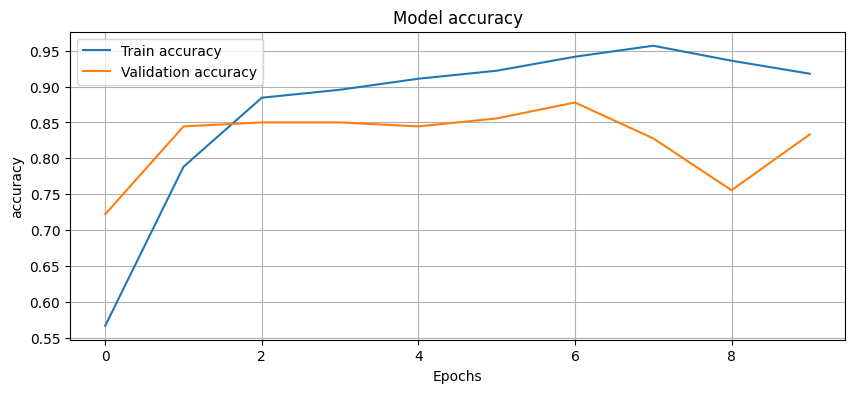

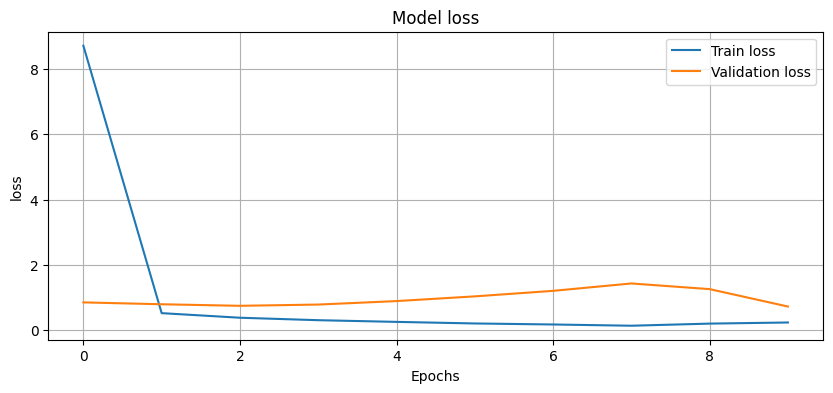

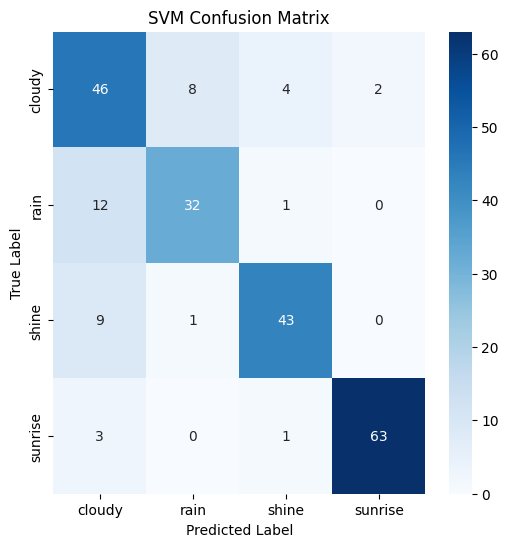

8/8 [==============================] - 1s 54ms/step


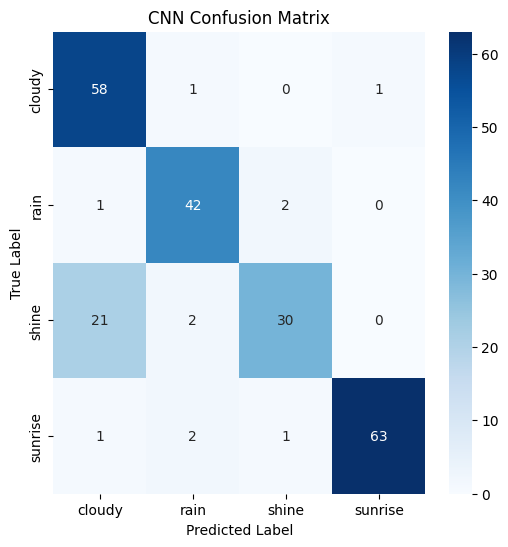

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.98      0.94      0.96        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 8s 297ms/step - loss: 10.1422 - accuracy: 0.5237 - val_loss: 1.2705 - val_accuracy: 0.7722
Epoch 2/10
23/23 [==============================] - 5s 211ms/step - loss: 0.6905 - accuracy: 0.7089 - val_loss: 1.6689 - val_accuracy: 0.7500
Epoch 3/10
23/23 [==============================] - 5s 209ms/step - loss: 0.6282 - accuracy: 0.7451 - val_loss: 1.2196 - val_accuracy: 0.7444
Epoch 4/10
23/23 [==============================] - 6s 283ms/step - loss: 0.4955 - accuracy: 0.8162 - val

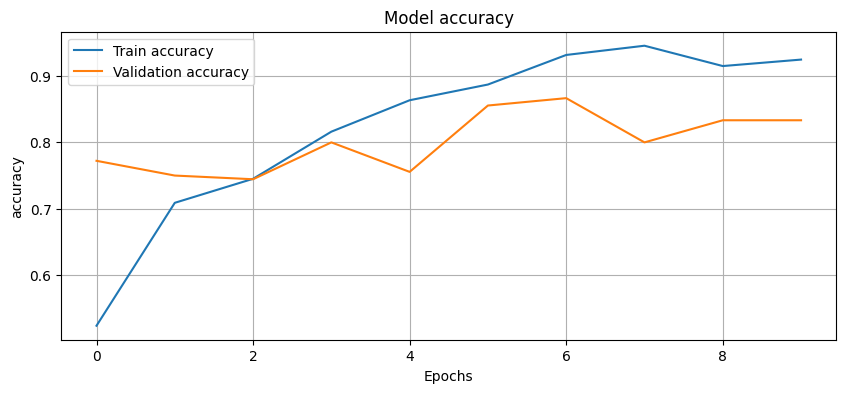

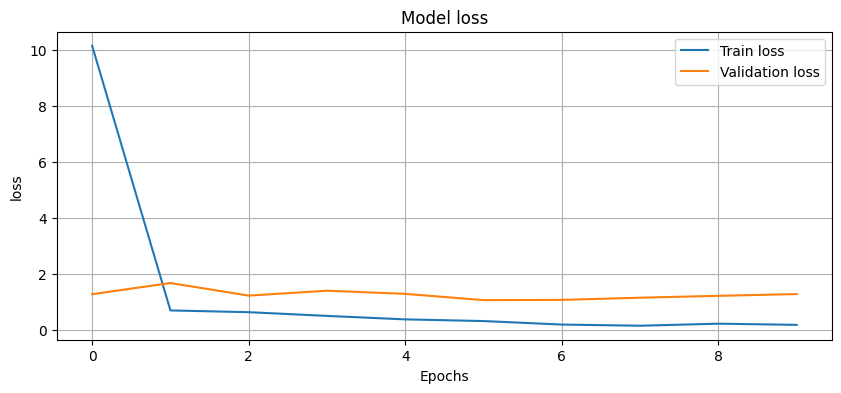

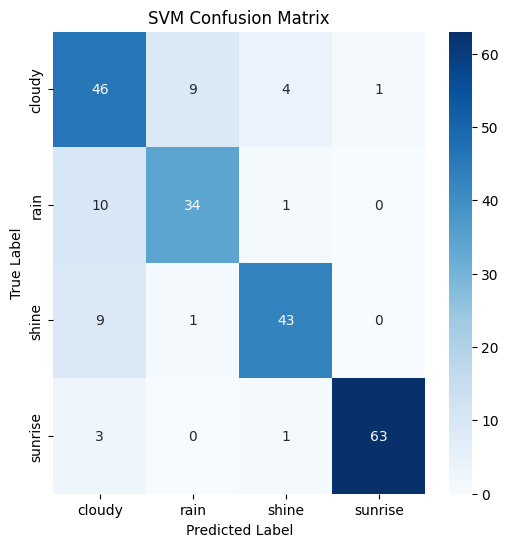

8/8 [==============================] - 1s 57ms/step


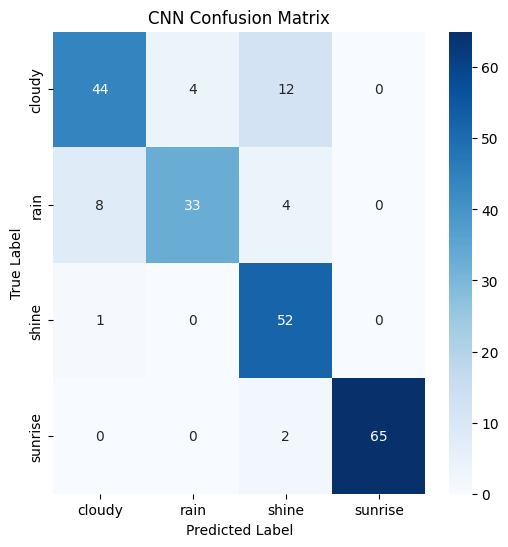

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 245ms/step - loss: 11.2596 - accuracy: 0.5850 - val_loss: 2.1435 - val_accuracy: 0.6611
Epoch 2/10
23/23 [==============================] - 7s 290ms/step - loss: 0.5871 - accuracy: 0.7883 - val_loss: 0.9473 - val_accuracy: 0.8111
Epoch 3/10
23/23 [==============================] - 5s 223ms/step - loss: 0.4364 - accuracy: 0.8343 - val_loss: 1.0369 - val_accuracy: 0.8167
Epoch 4/10
23/23 [==============================] - 7s 301ms/step - loss: 0.4052 - accuracy: 0.8482 - val

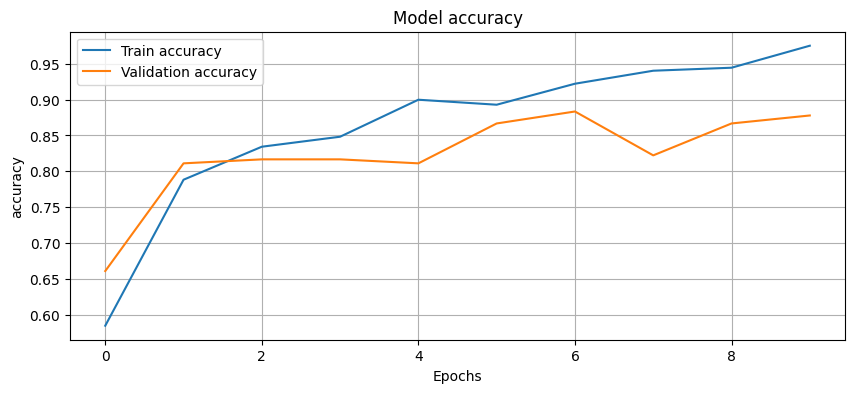

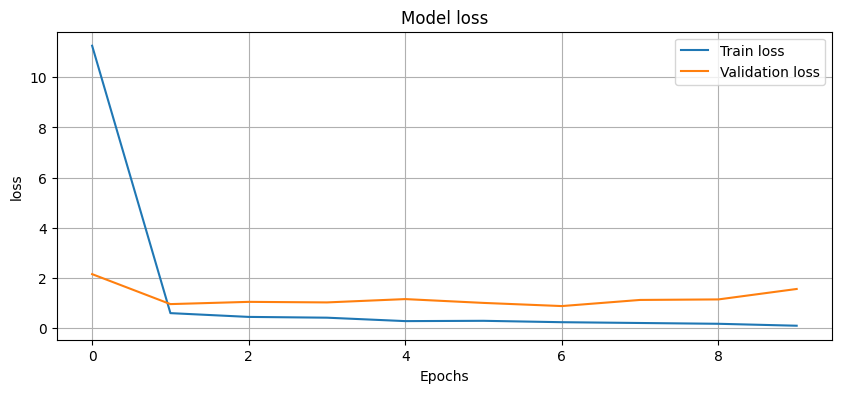

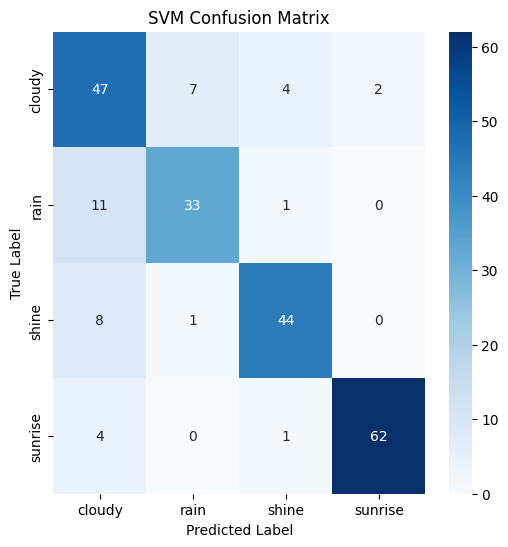

8/8 [==============================] - 1s 61ms/step


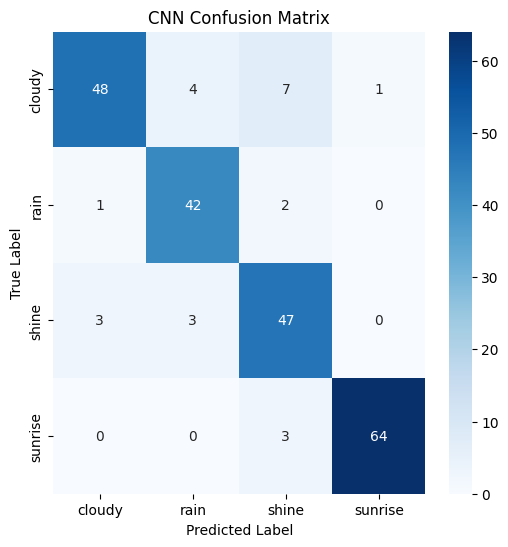

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.64      0.78      0.71        60
        rain       0.79      0.67      0.72        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 233ms/step - loss: 29.6709 - accuracy: 0.4916 - val_loss: 1.0641 - val_accuracy: 0.5278
Epoch 2/10
23/23 [==============================] - 6s 250ms/step - loss: 0.9483 - accuracy: 0.5599 - val_loss: 0.9447 - val_accuracy: 0.7889
Epoch 3/10
23/23 [==============================] - 6s 270ms/step - loss: 0.7932 - accuracy: 0.7103 - val_loss: 1.0249 - val_accuracy: 0.7611
Epoch 4/10
23/23 [==============================] - 5s 239ms/step - loss: 0.6434 - accuracy: 0.7535 - val

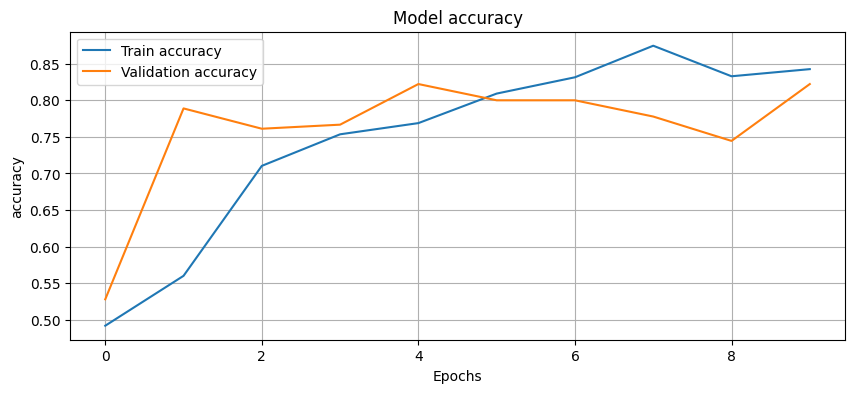

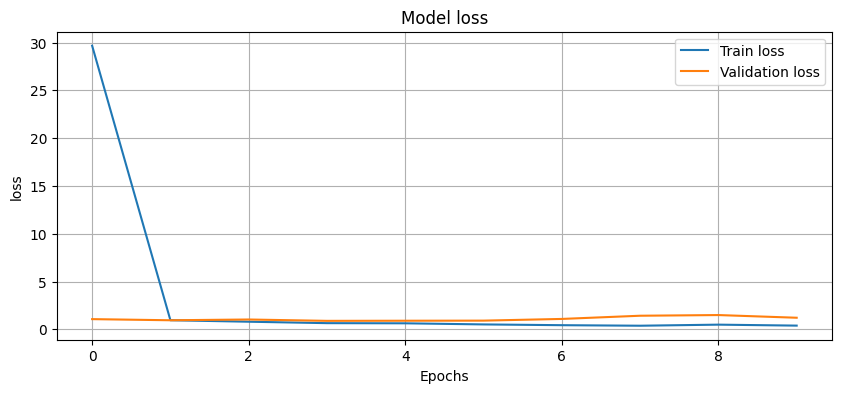

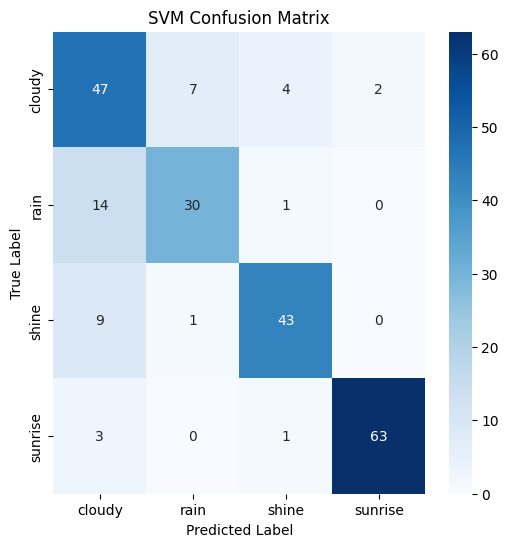

8/8 [==============================] - 1s 62ms/step


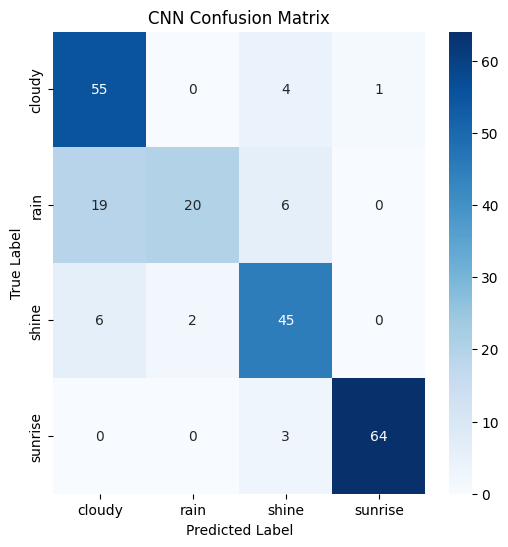

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 8s 303ms/step - loss: 30.5278 - accuracy: 0.4429 - val_loss: 1.1607 - val_accuracy: 0.4778
Epoch 2/10
23/23 [==============================] - 5s 239ms/step - loss: 1.0678 - accuracy: 0.5376 - val_loss: 1.1154 - val_accuracy: 0.5333
Epoch 3/10
23/23 [==============================] - 7s 326ms/step - loss: 0.9947 - accuracy: 0.5613 - val_loss: 1.0949 - val_accuracy: 0.5500
Epoch 4/10
23/23 [==============================] - 5s 236ms/step - loss: 0.9777 - accuracy: 0.5432 - val

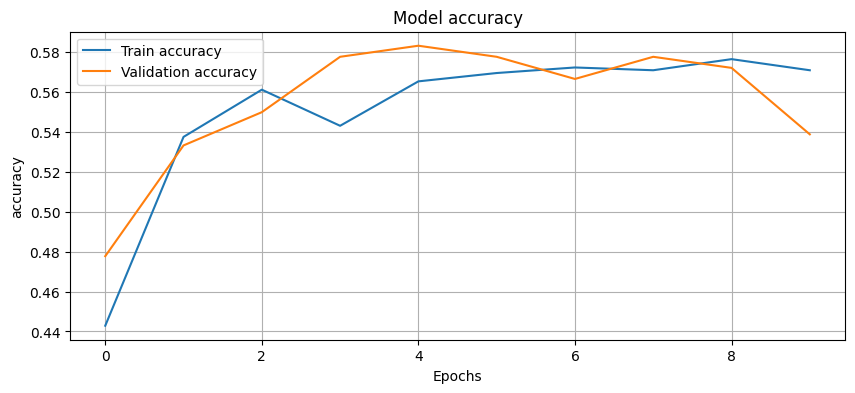

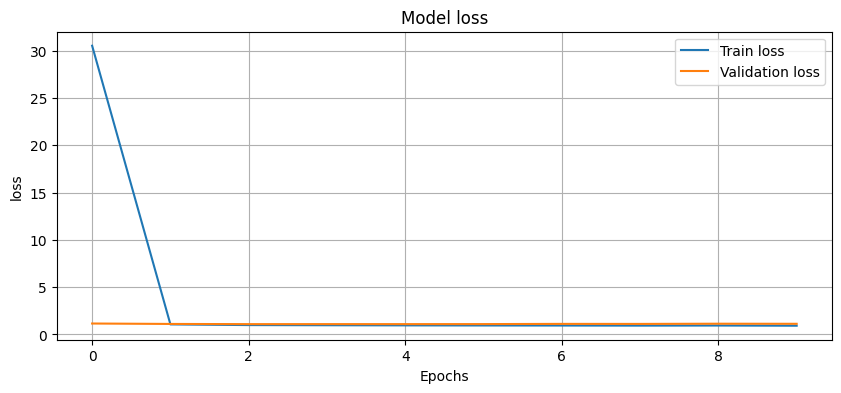

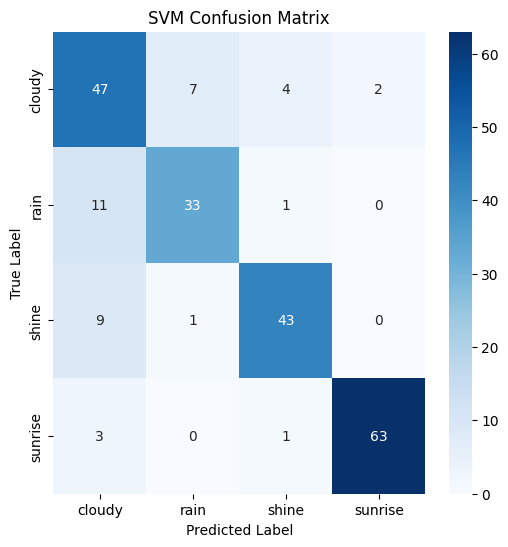

8/8 [==============================] - 1s 97ms/step


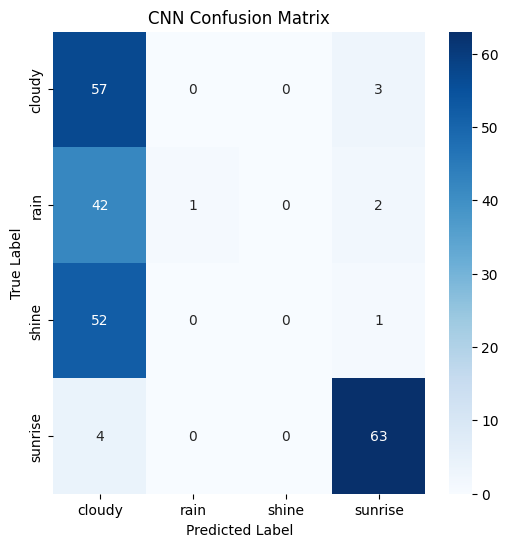

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 264ms/step - loss: 12.8166 - accuracy: 0.5501 - val_loss: 0.9638 - val_accuracy: 0.6278
Epoch 2/10
23/23 [==============================] - 7s 300ms/step - loss: 0.6604 - accuracy: 0.7298 - val_loss: 0.7687 - val_accuracy: 0.8222
Epoch 3/10
23/23 [==============================] - 5s 235ms/step - loss: 0.4399 - accuracy: 0.8524 - val_loss: 0.8768 - val_accuracy: 0.8222
Epoch 4/10
23/23 [==============================] - 7s 323ms/step - loss: 0.3201 - accuracy: 0.8844 - val

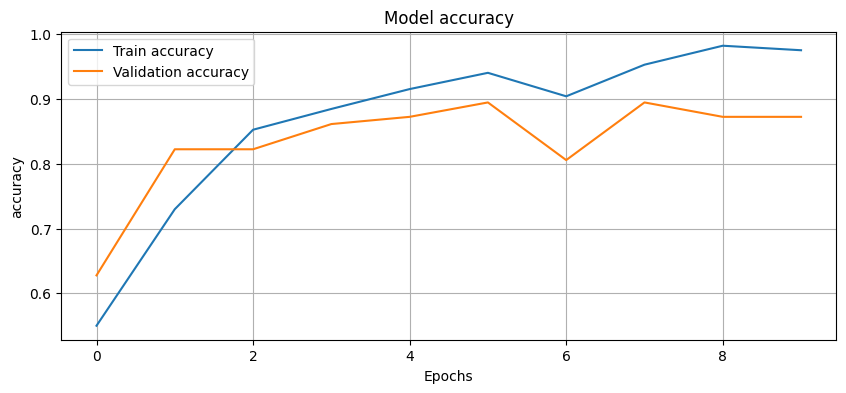

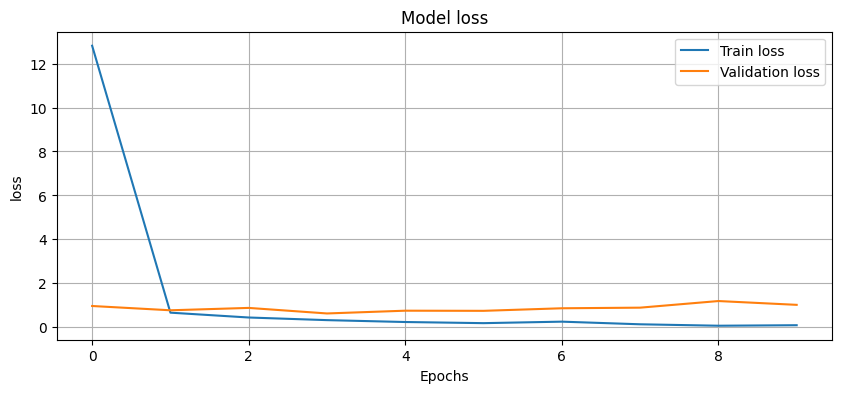

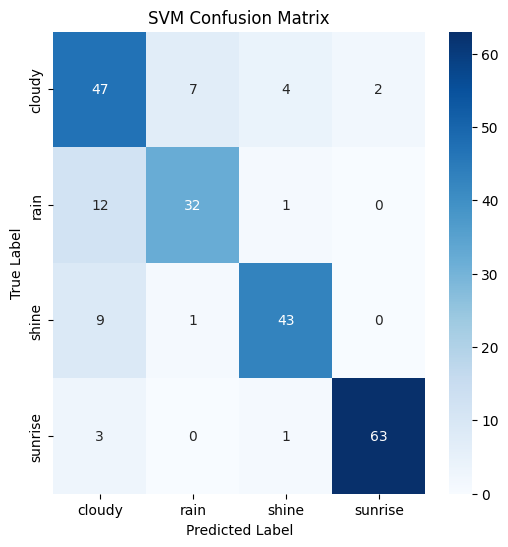

8/8 [==============================] - 1s 68ms/step


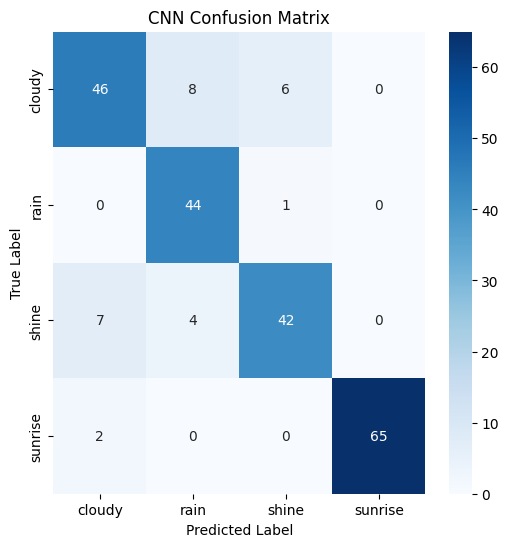

SVM Accuracy: 0.8088888888888889
              precision    recall  f1-score   support

      cloudy       0.64      0.75      0.69        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.80       225
weighted avg       0.82      0.81      0.81       225

Epoch 1/10
23/23 [==============================] - 7s 263ms/step - loss: 43.5529 - accuracy: 0.4206 - val_loss: 0.8672 - val_accuracy: 0.6222
Epoch 2/10
23/23 [==============================] - 7s 327ms/step - loss: 0.8434 - accuracy: 0.6267 - val_loss: 0.8914 - val_accuracy: 0.6667
Epoch 3/10
23/23 [==============================] - 6s 252ms/step - loss: 0.7977 - accuracy: 0.6630 - val_loss: 1.5253 - val_accuracy: 0.6667
Epoch 4/10
23/23 [==============================] - 7s 326ms/step - loss: 0.7167 - accuracy: 0.7228 - val

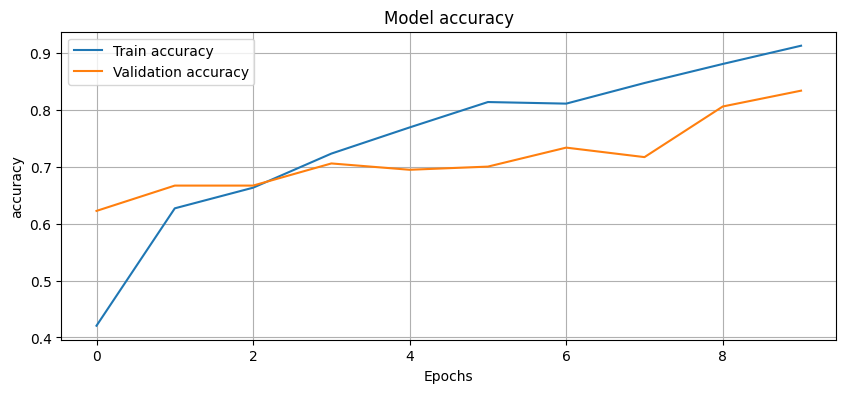

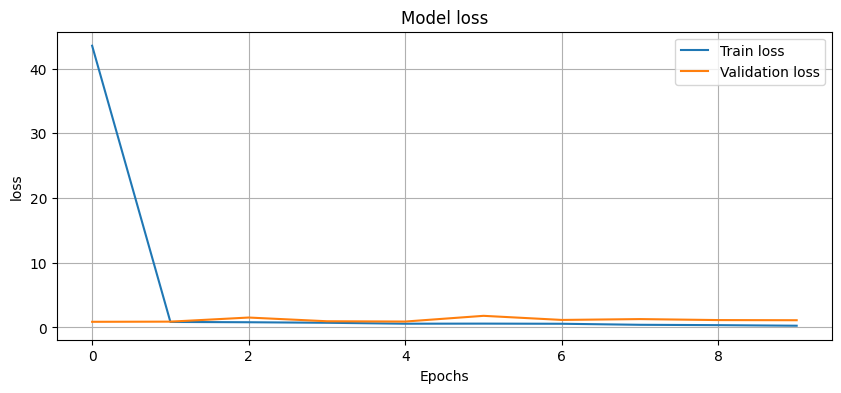

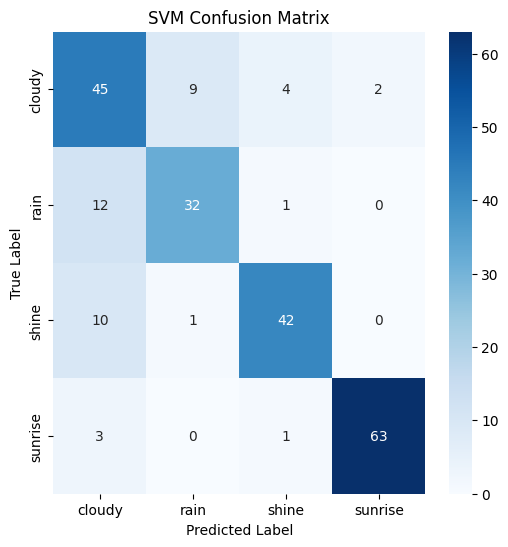

8/8 [==============================] - 1s 95ms/step


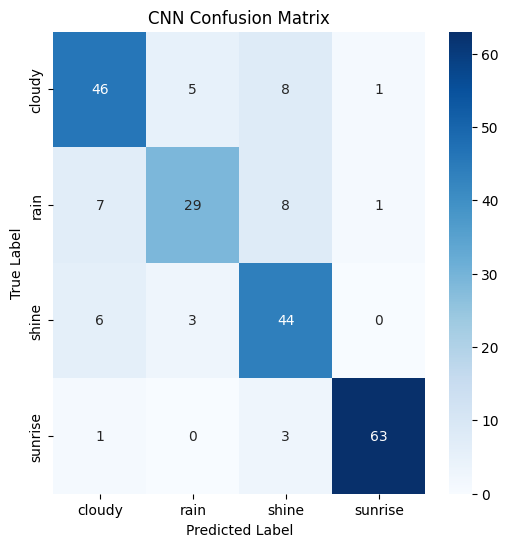

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 327ms/step - loss: 12.9965 - accuracy: 0.4318 - val_loss: 1.0982 - val_accuracy: 0.7389
Epoch 2/10
23/23 [==============================] - 6s 264ms/step - loss: 0.7906 - accuracy: 0.6783 - val_loss: 1.4062 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 7s 295ms/step - loss: 0.7263 - accuracy: 0.6922 - val_loss: 1.3042 - val_accuracy: 0.7556
Epoch 4/10
23/23 [==============================] - 7s 289ms/step - loss: 0.6123 - accuracy: 0.7716 - val

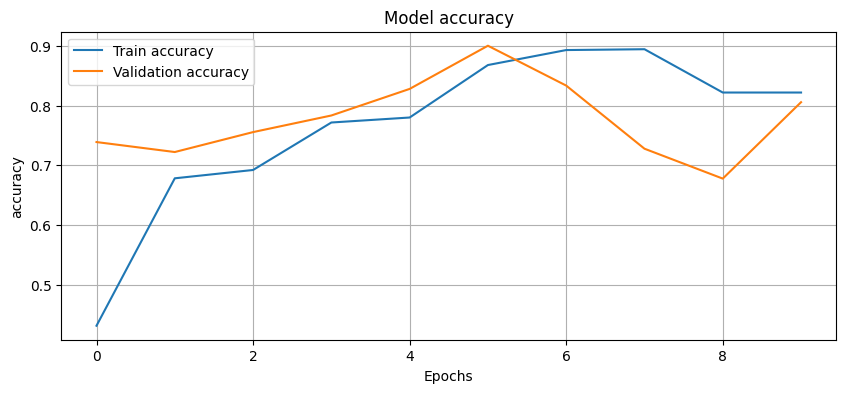

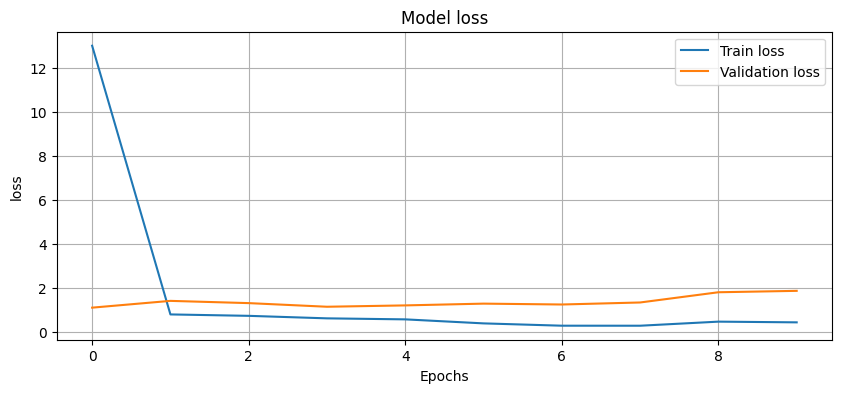

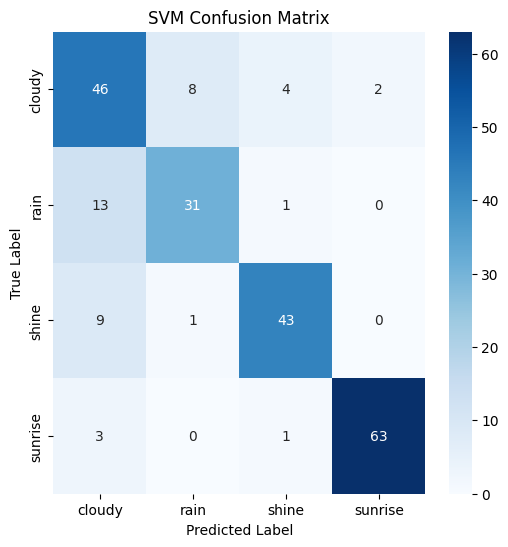

8/8 [==============================] - 1s 69ms/step


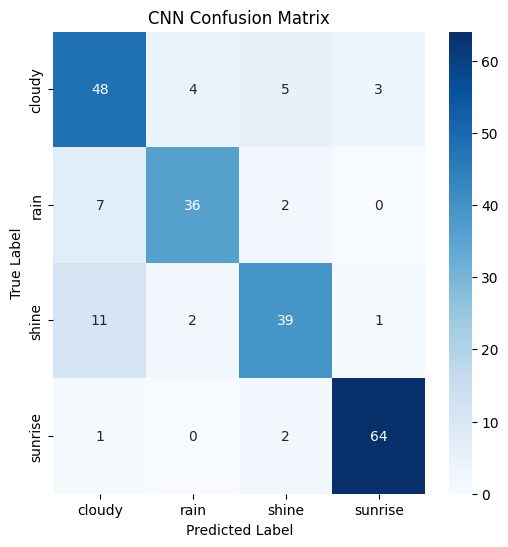

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 8s 294ms/step - loss: 44.7235 - accuracy: 0.3830 - val_loss: 0.9690 - val_accuracy: 0.6333
Epoch 2/10
23/23 [==============================] - 8s 359ms/step - loss: 0.8476 - accuracy: 0.6518 - val_loss: 1.1087 - val_accuracy: 0.6667
Epoch 3/10
23/23 [==============================] - 6s 281ms/step - loss: 0.8461 - accuracy: 0.5850 - val_loss: 1.1863 - val_accuracy: 0.5500
Epoch 4/10
23/23 [==============================] - 8s 347ms/step - loss: 0.7730 - accuracy: 0.6630 - val

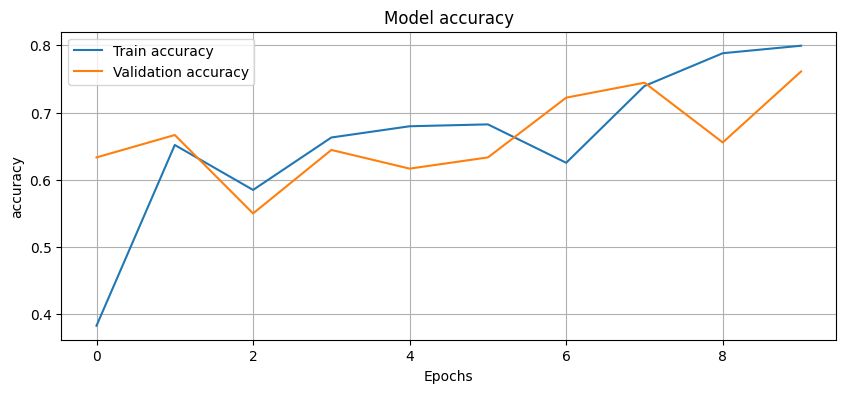

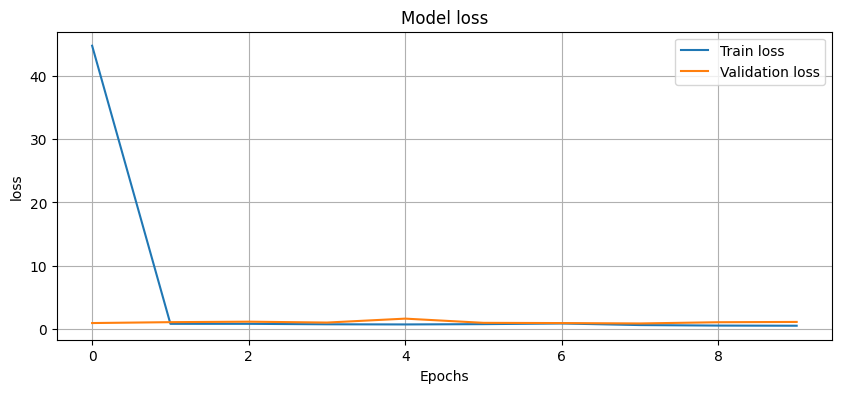

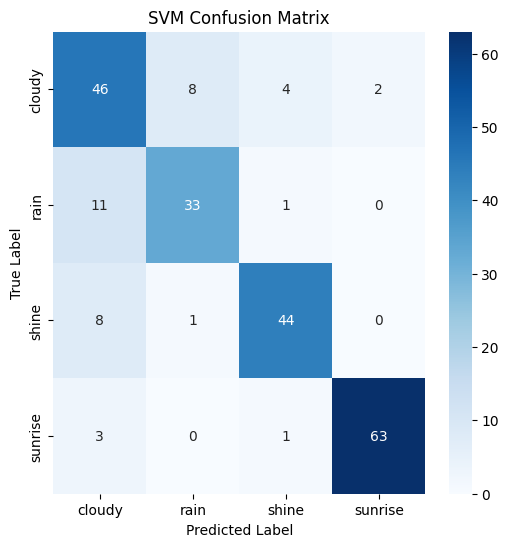

8/8 [==============================] - 1s 112ms/step


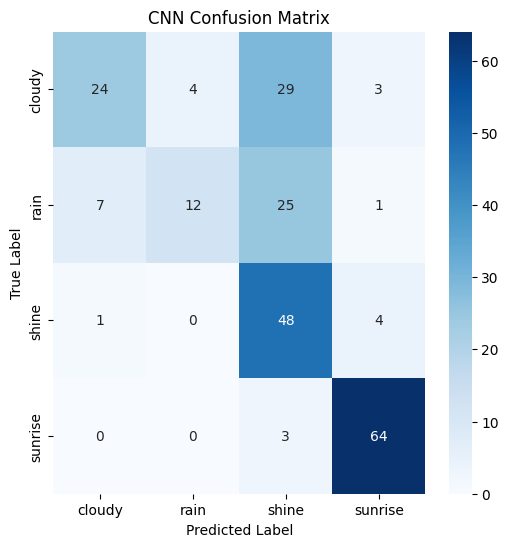

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 9s 363ms/step - loss: 25.8433 - accuracy: 0.4875 - val_loss: 1.3034 - val_accuracy: 0.6722
Epoch 2/10
23/23 [==============================] - 6s 282ms/step - loss: 0.6806 - accuracy: 0.7284 - val_loss: 0.9561 - val_accuracy: 0.8056
Epoch 3/10
23/23 [==============================] - 8s 365ms/step - loss: 0.5028 - accuracy: 0.7994 - val_loss: 1.0452 - val_accuracy: 0.8333
Epoch 4/10
23/23 [==============================] - 6s 276ms/step - loss: 0.4587 - accuracy: 0.8287 - val

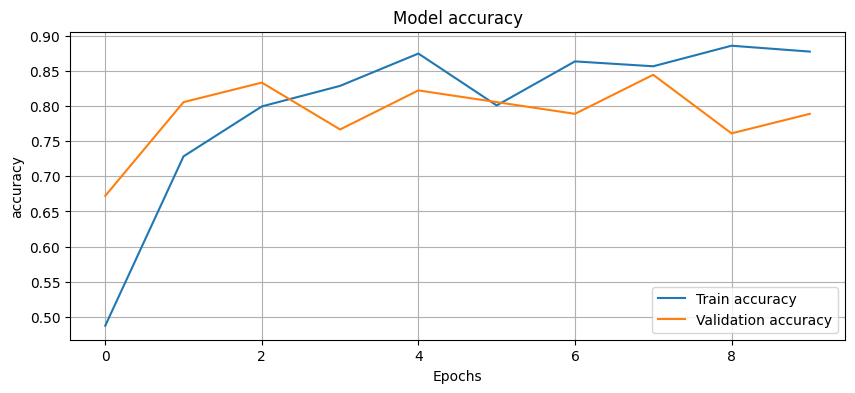

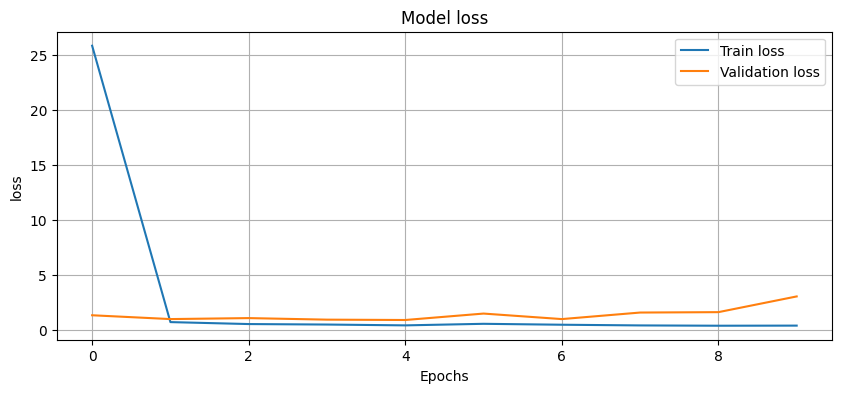

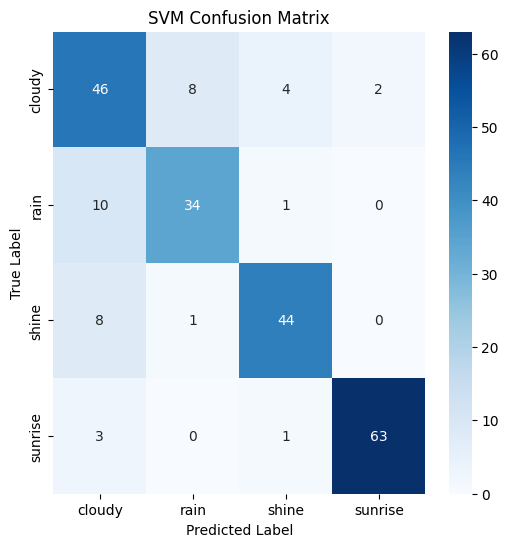

8/8 [==============================] - 1s 75ms/step


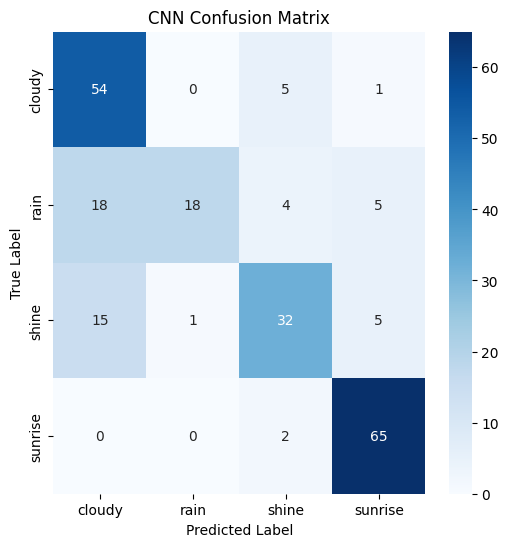

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 361ms/step - loss: 37.2577 - accuracy: 0.4861 - val_loss: 1.2241 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 7s 308ms/step - loss: 0.8940 - accuracy: 0.6170 - val_loss: 1.1024 - val_accuracy: 0.6056
Epoch 3/10
23/23 [==============================] - 8s 361ms/step - loss: 0.7884 - accuracy: 0.6588 - val_loss: 1.0984 - val_accuracy: 0.6056
Epoch 4/10
23/23 [==============================] - 7s 288ms/step - loss: 0.6110 - accuracy: 0.7284 - va

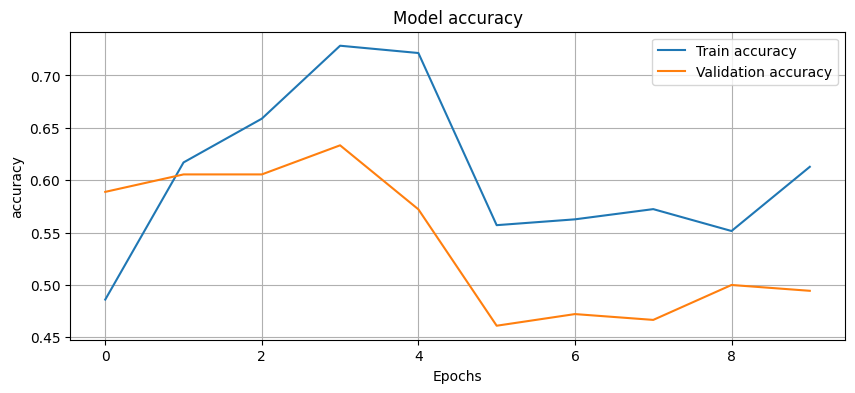

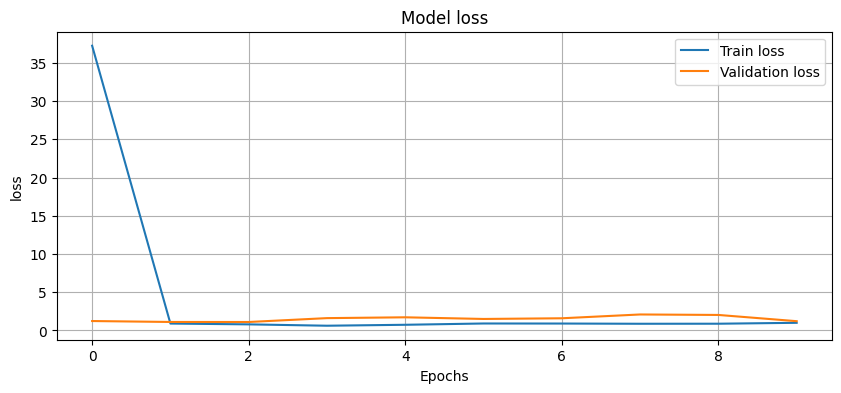

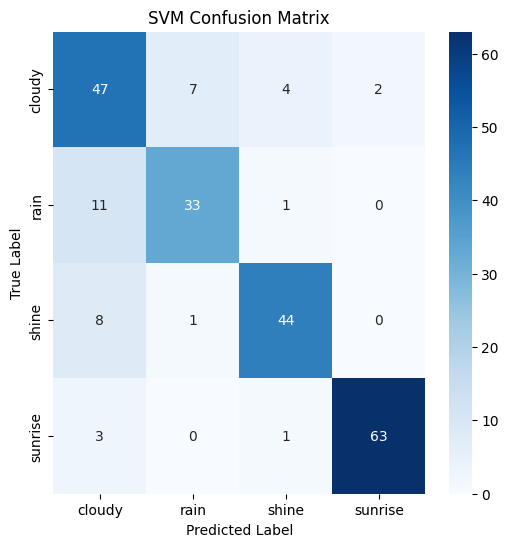

8/8 [==============================] - 1s 77ms/step


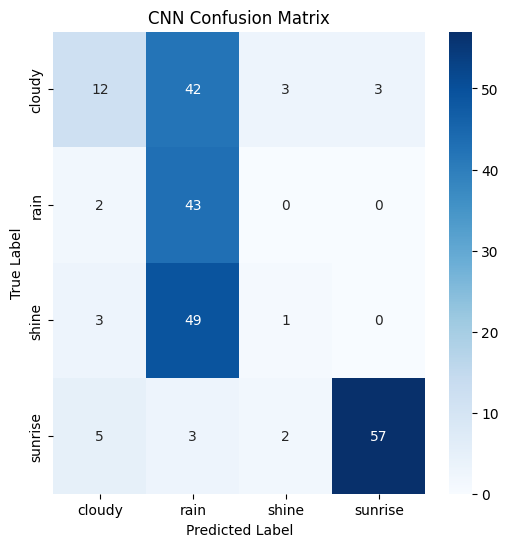

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 307ms/step - loss: 31.6892 - accuracy: 0.4735 - val_loss: 1.1589 - val_accuracy: 0.4944
Epoch 2/10
23/23 [==============================] - 8s 364ms/step - loss: 0.9645 - accuracy: 0.6156 - val_loss: 1.0409 - val_accuracy: 0.7167
Epoch 3/10
23/23 [==============================] - 7s 297ms/step - loss: 0.7428 - accuracy: 0.7368 - val_loss: 1.2943 - val_accuracy: 0.7778
Epoch 4/10
23/23 [==============================] - 9s 374ms/step - loss: 0.6870 - accuracy: 0.7702 - val

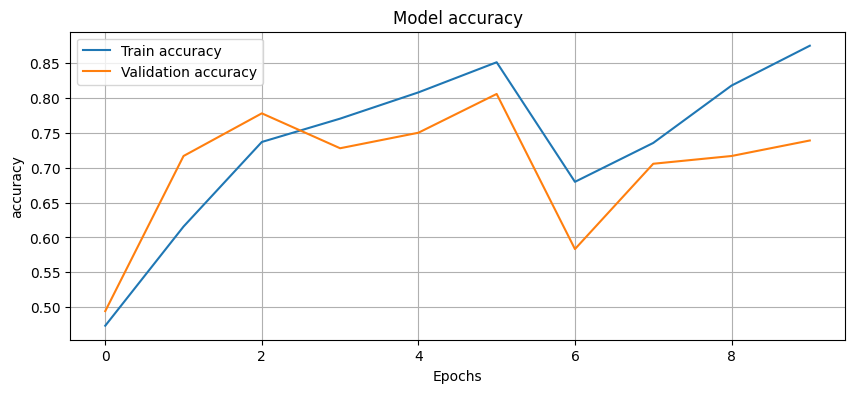

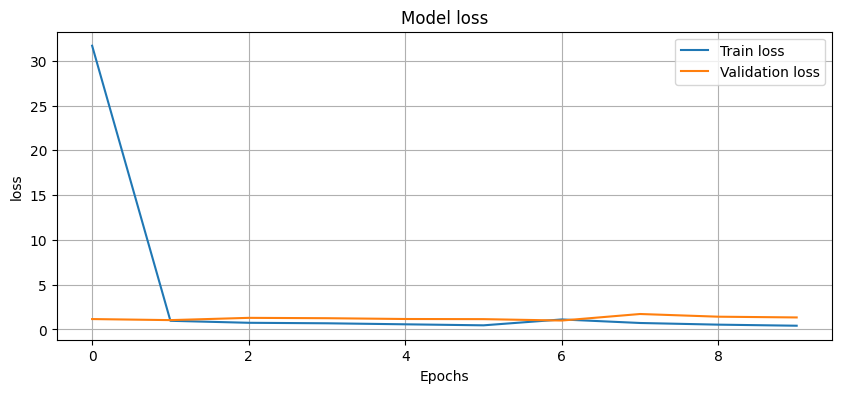

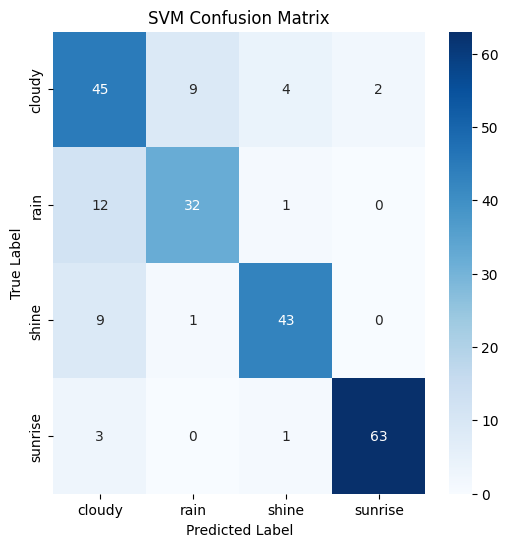

8/8 [==============================] - 1s 115ms/step


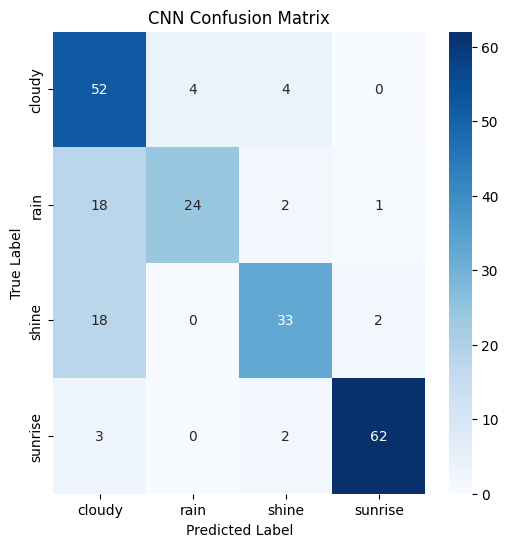

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 382ms/step - loss: 35.3485 - accuracy: 0.4471 - val_loss: 1.1282 - val_accuracy: 0.4667
Epoch 2/10
23/23 [==============================] - 7s 297ms/step - loss: 1.1128 - accuracy: 0.5348 - val_loss: 0.9880 - val_accuracy: 0.5500
Epoch 3/10
23/23 [==============================] - 9s 376ms/step - loss: 0.9133 - accuracy: 0.5794 - val_loss: 0.9438 - val_accuracy: 0.6222
Epoch 4/10
23/23 [==============================] - 8s 351ms/step - loss: 0.7160 - accuracy: 0.6630 - va

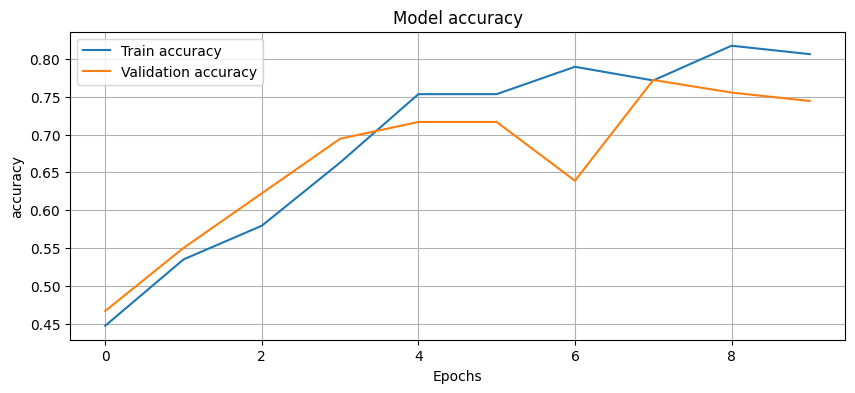

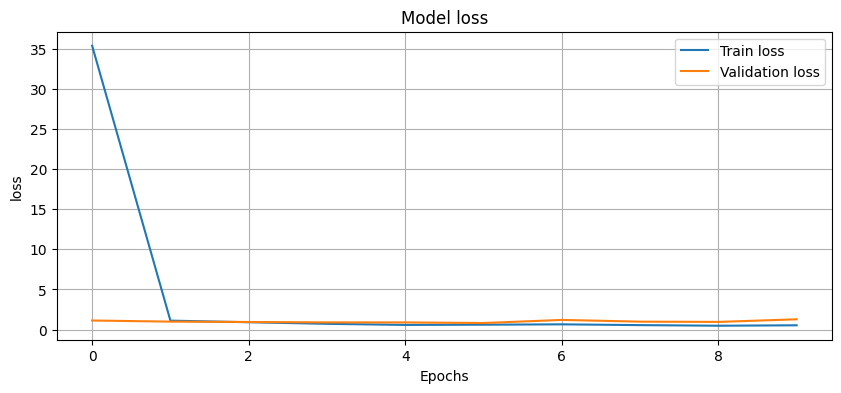

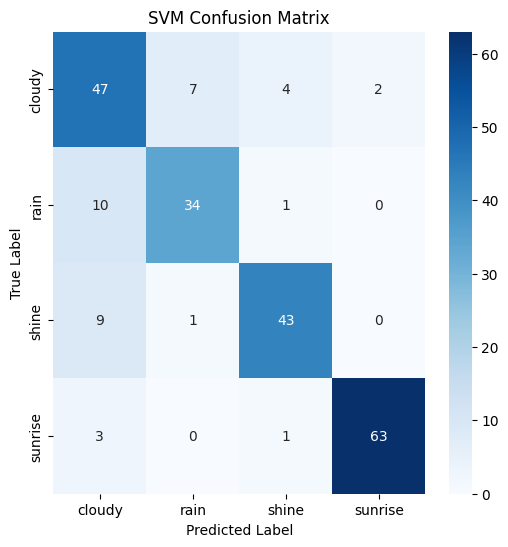

8/8 [==============================] - 1s 85ms/step


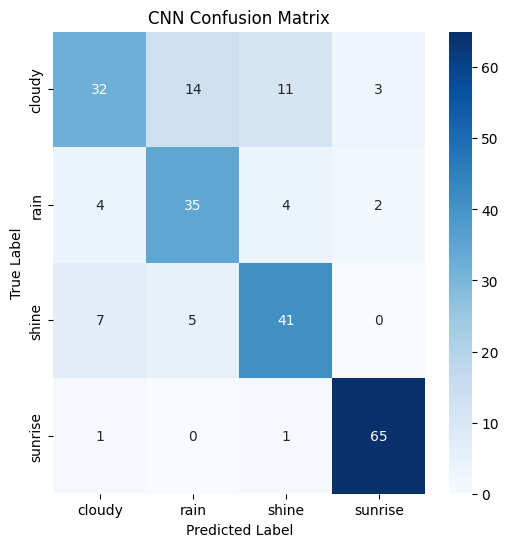

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 328ms/step - loss: 28.3383 - accuracy: 0.4708 - val_loss: 1.1230 - val_accuracy: 0.7111
Epoch 2/10
23/23 [==============================] - 9s 372ms/step - loss: 0.8003 - accuracy: 0.6880 - val_loss: 1.5232 - val_accuracy: 0.6000
Epoch 3/10
23/23 [==============================] - 8s 349ms/step - loss: 0.7503 - accuracy: 0.7368 - val_loss: 1.4686 - val_accuracy: 0.7556
Epoch 4/10
23/23 [==============================] - 8s 332ms/step - loss: 0.5839 - accuracy: 0.8203 - val

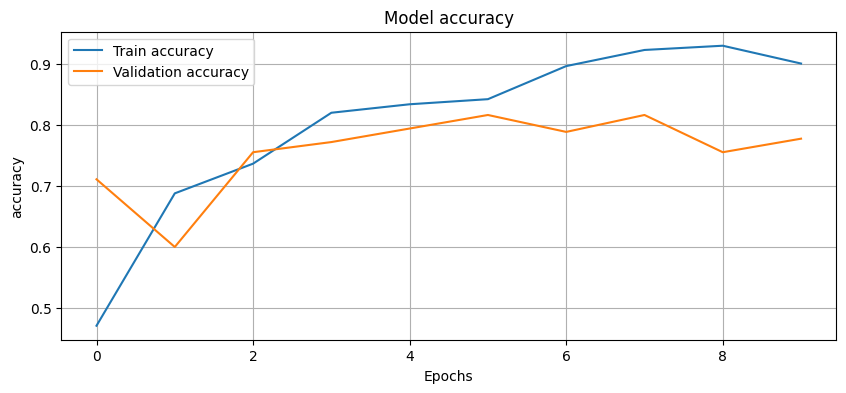

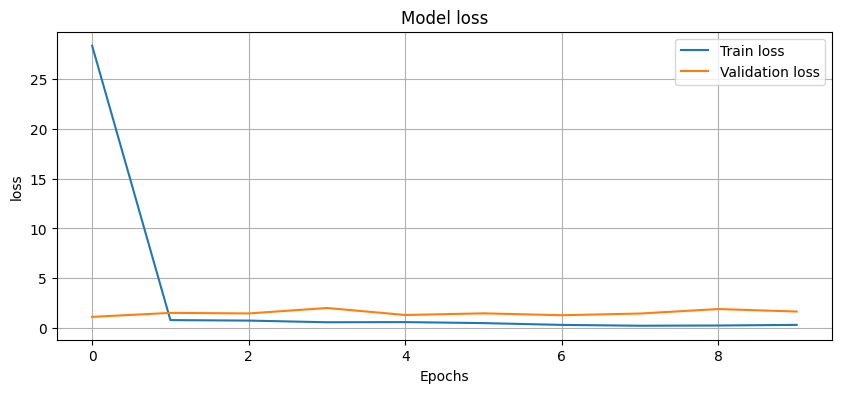

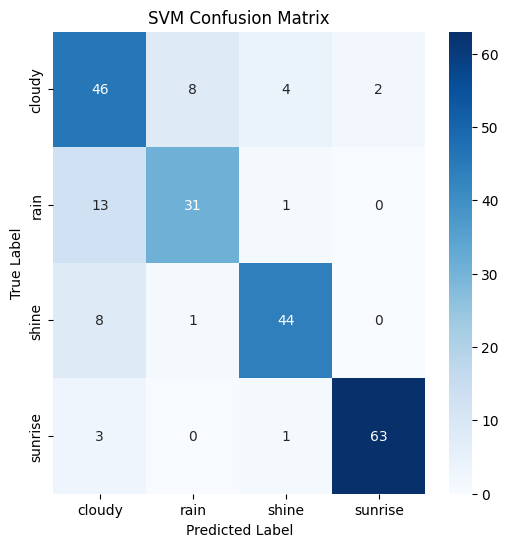

8/8 [==============================] - 1s 117ms/step


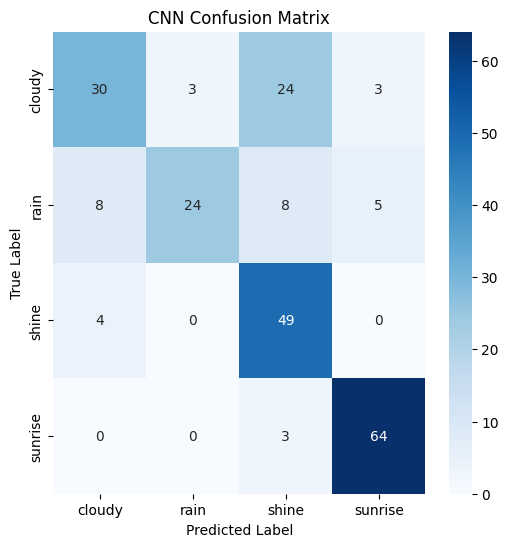

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 408ms/step - loss: 33.7530 - accuracy: 0.4610 - val_loss: 1.2273 - val_accuracy: 0.5722
Epoch 2/10
23/23 [==============================] - 9s 393ms/step - loss: 0.8228 - accuracy: 0.6490 - val_loss: 1.2026 - val_accuracy: 0.6556
Epoch 3/10
23/23 [==============================] - 7s 324ms/step - loss: 0.6893 - accuracy: 0.6950 - val_loss: 0.8765 - val_accuracy: 0.6167
Epoch 4/10
23/23 [==============================] - 9s 399ms/step - loss: 0.6007 - accuracy: 0.7632 - va

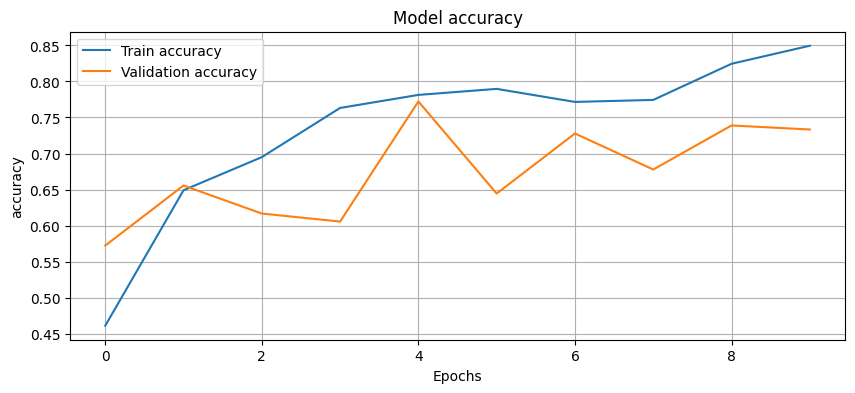

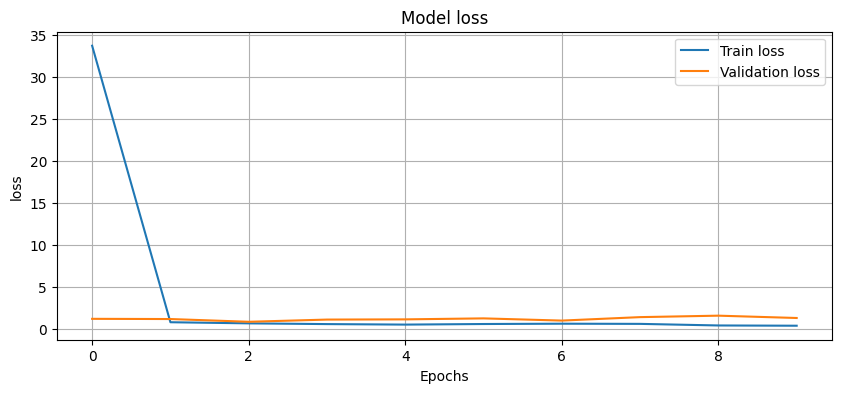

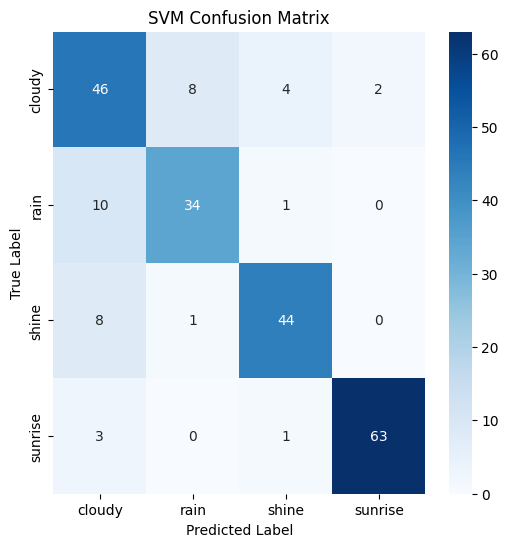

8/8 [==============================] - 1s 87ms/step


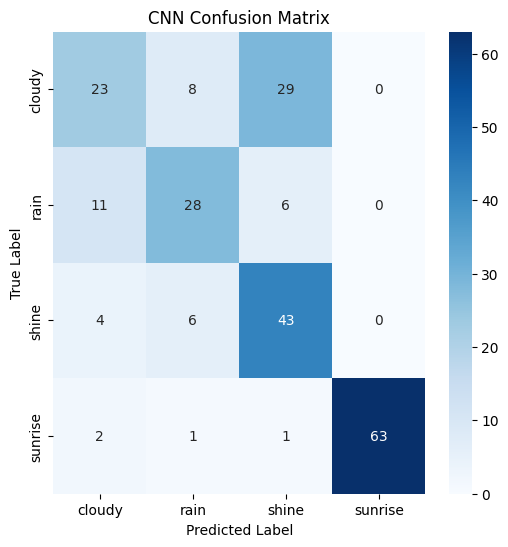

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 424ms/step - loss: 27.9947 - accuracy: 0.4805 - val_loss: 1.0658 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 8s 328ms/step - loss: 0.8395 - accuracy: 0.7228 - val_loss: 1.1681 - val_accuracy: 0.6667
Epoch 3/10
23/23 [==============================] - 9s 412ms/step - loss: 0.9143 - accuracy: 0.6184 - val_loss: 1.3826 - val_accuracy: 0.6444
Epoch 4/10
23/23 [==============================] - 9s 381ms/step - loss: 0.8400 - accuracy: 0.6602 - va

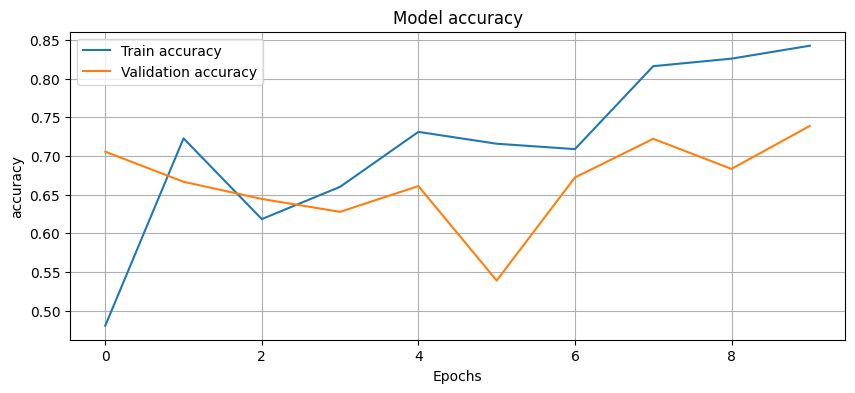

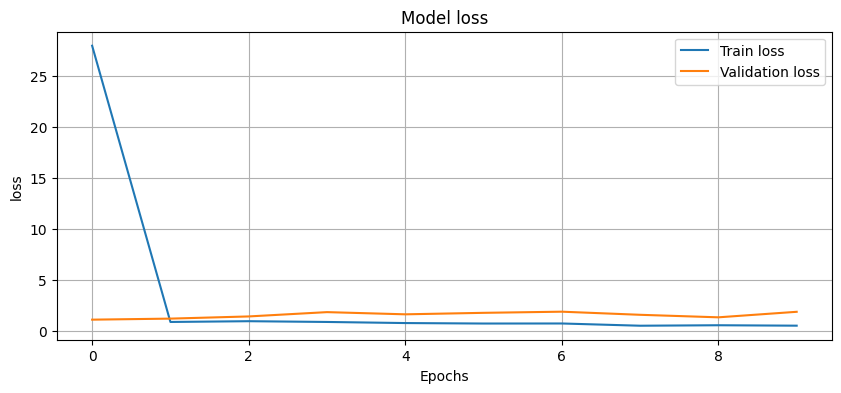

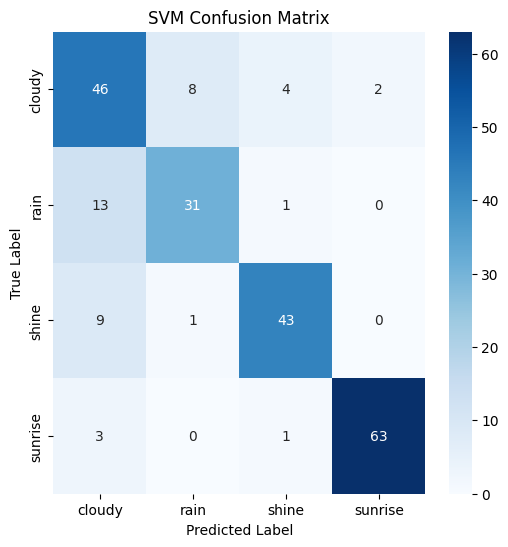

8/8 [==============================] - 1s 89ms/step


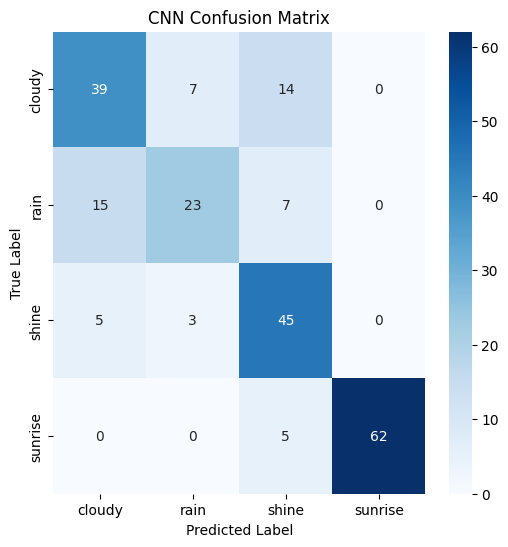

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 9s 355ms/step - loss: 25.7079 - accuracy: 0.5738 - val_loss: 1.3444 - val_accuracy: 0.7556
Epoch 2/10
23/23 [==============================] - 10s 414ms/step - loss: 0.6475 - accuracy: 0.7925 - val_loss: 2.0424 - val_accuracy: 0.6389
Epoch 3/10
23/23 [==============================] - 10s 433ms/step - loss: 0.5447 - accuracy: 0.7730 - val_loss: 1.7938 - val_accuracy: 0.7556
Epoch 4/10
23/23 [==============================] - 8s 350ms/step - loss: 0.6103 - accuracy: 0.7799 - v

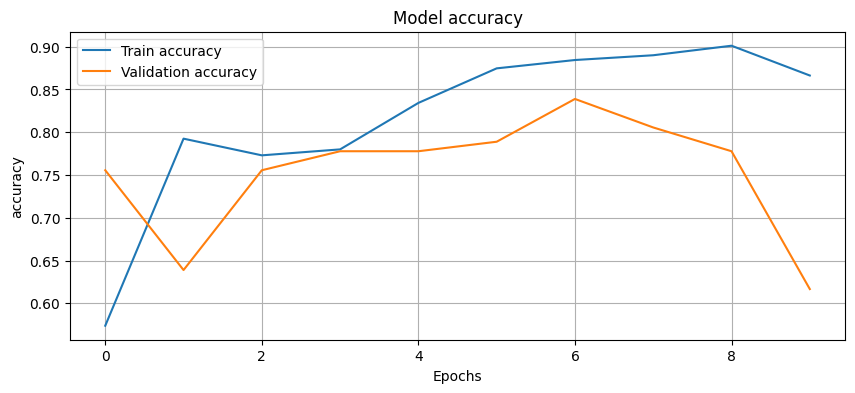

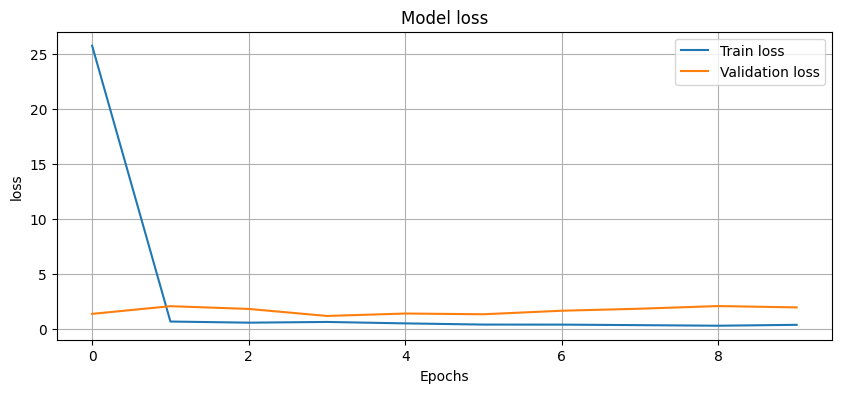

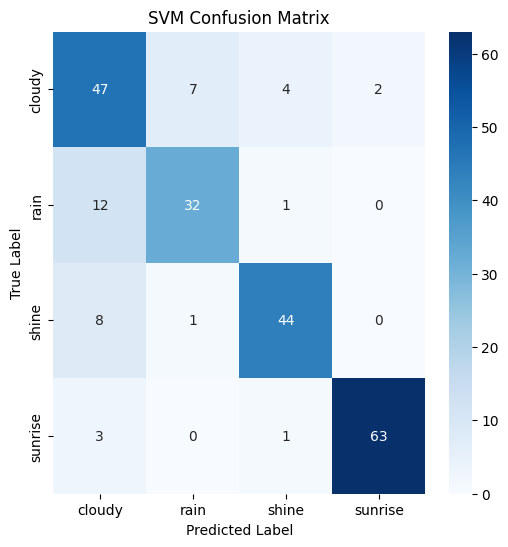

8/8 [==============================] - 1s 126ms/step


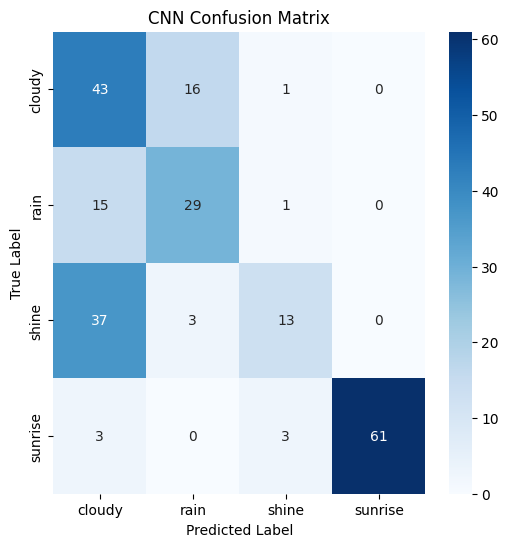

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 427ms/step - loss: 19.3336 - accuracy: 0.5070 - val_loss: 1.1351 - val_accuracy: 0.4500
Epoch 2/10
23/23 [==============================] - 9s 403ms/step - loss: 1.1023 - accuracy: 0.4457 - val_loss: 1.2617 - val_accuracy: 0.5000
Epoch 3/10
23/23 [==============================] - 9s 366ms/step - loss: 1.0131 - accuracy: 0.5543 - val_loss: 1.4939 - val_accuracy: 0.5833
Epoch 4/10
23/23 [==============================] - 10s 429ms/step - loss: 1.0524 - accuracy: 0.5195 - v

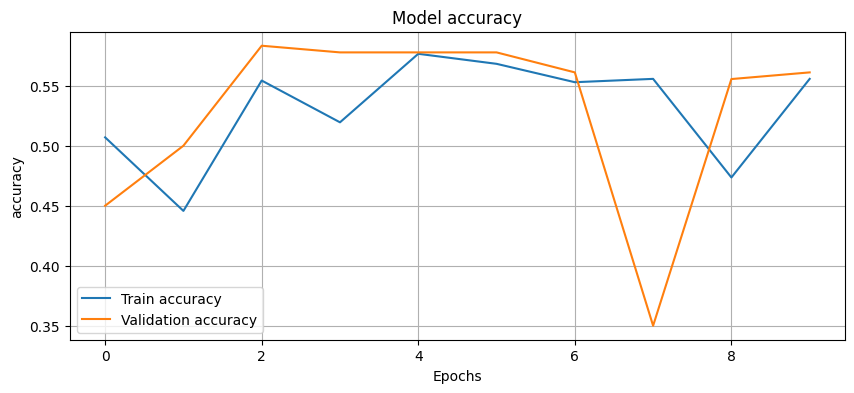

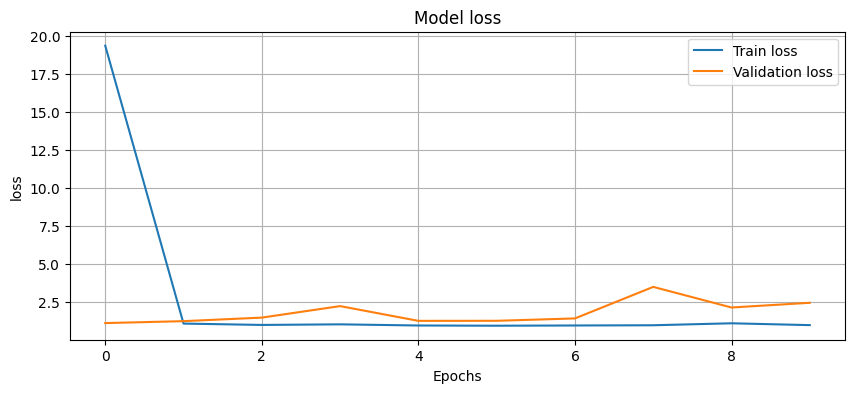

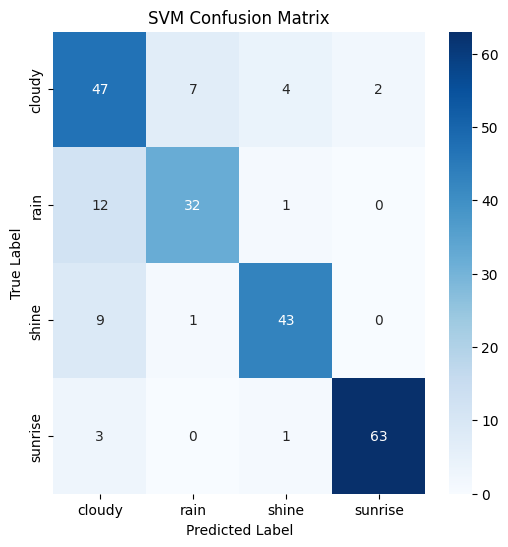

8/8 [==============================] - 1s 98ms/step


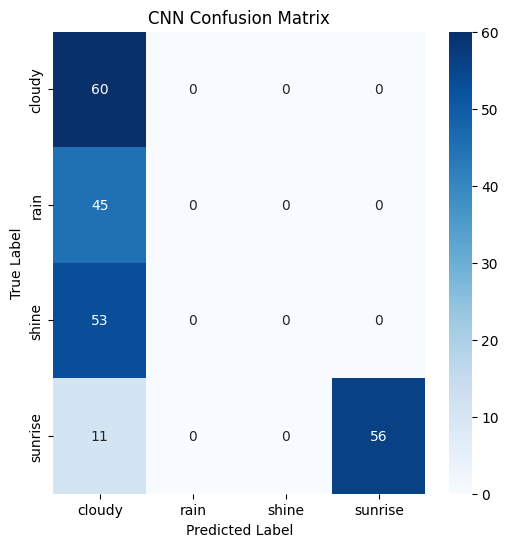

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 411ms/step - loss: 19.6322 - accuracy: 0.4847 - val_loss: 0.9630 - val_accuracy: 0.7222
Epoch 2/10
23/23 [==============================] - 9s 398ms/step - loss: 0.5440 - accuracy: 0.7758 - val_loss: 0.8150 - val_accuracy: 0.7944
Epoch 3/10
23/23 [==============================] - 10s 451ms/step - loss: 0.4558 - accuracy: 0.8538 - val_loss: 1.0991 - val_accuracy: 0.7833
Epoch 4/10
23/23 [==============================] - 10s 424ms/step - loss: 0.3284 - accuracy: 0.8774 - 

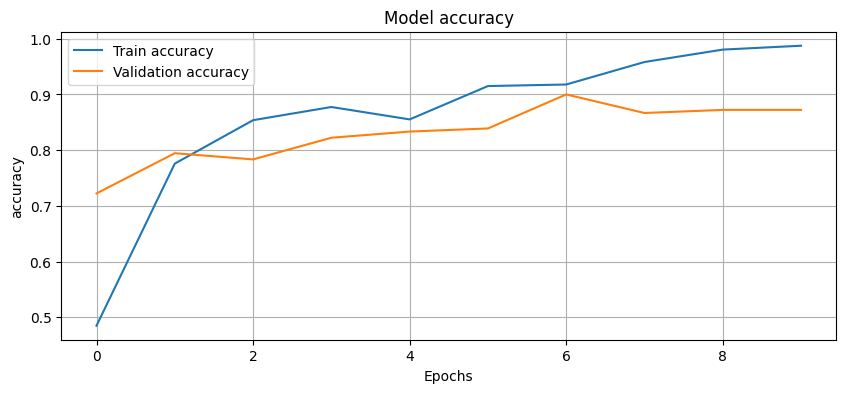

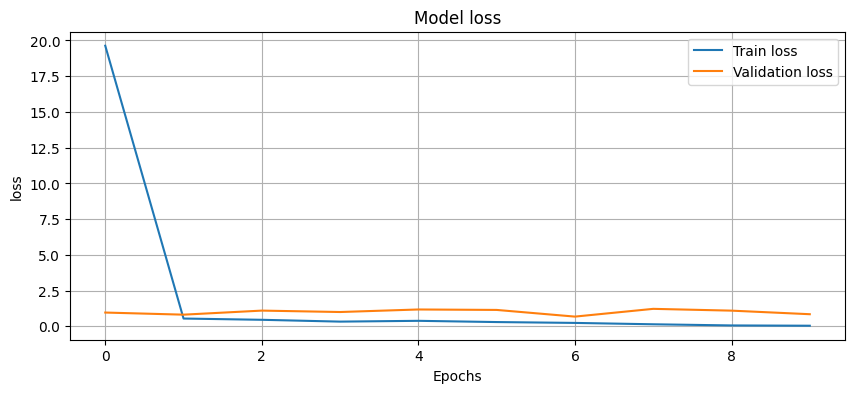

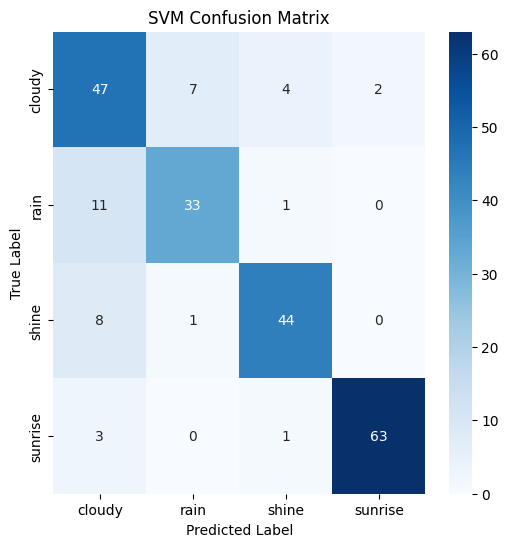

8/8 [==============================] - 1s 134ms/step


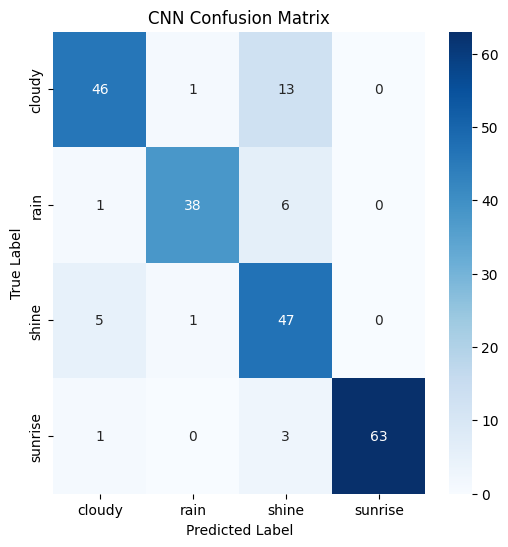

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.69      0.72        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 449ms/step - loss: 18.1387 - accuracy: 0.4582 - val_loss: 1.0870 - val_accuracy: 0.6667
Epoch 2/10
23/23 [==============================] - 10s 428ms/step - loss: 0.8550 - accuracy: 0.6657 - val_loss: 0.9827 - val_accuracy: 0.6722
Epoch 3/10
23/23 [==============================] - 8s 363ms/step - loss: 0.6421 - accuracy: 0.7409 - val_loss: 0.9905 - val_accuracy: 0.7222
Epoch 4/10
23/23 [==============================] - 10s 439ms/step - loss: 0.6101 - accuracy: 0.7883 - 

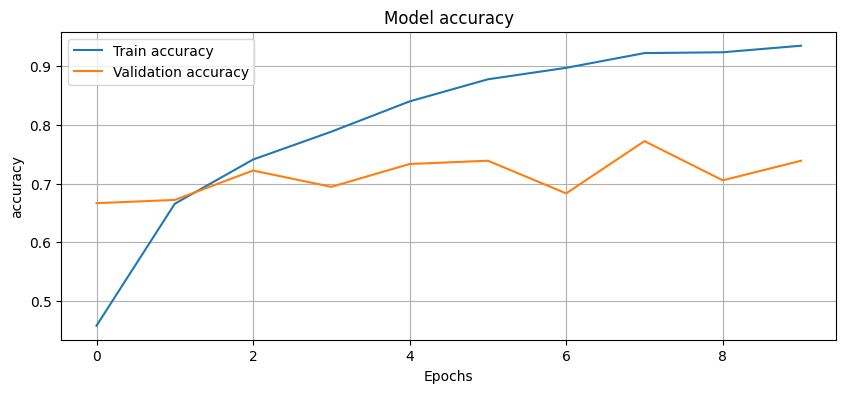

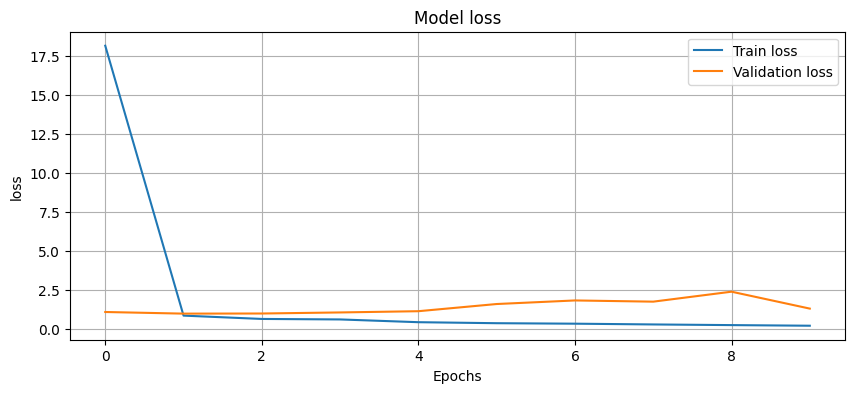

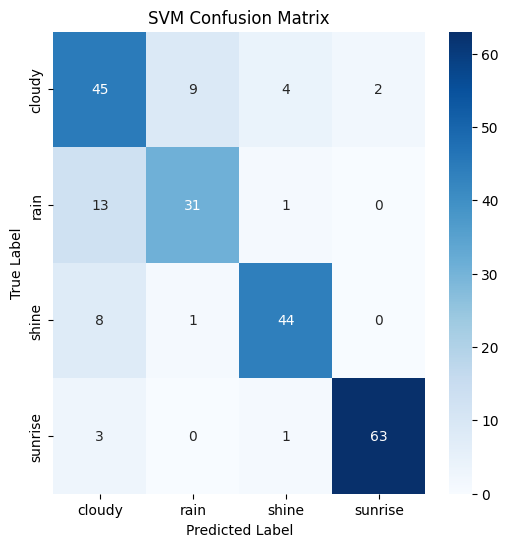

8/8 [==============================] - 1s 101ms/step


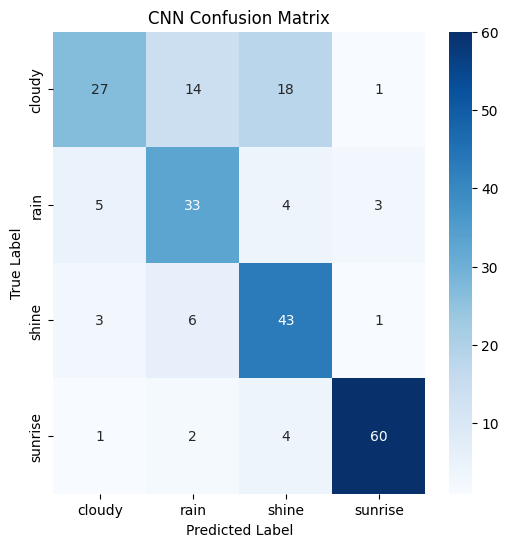

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 437ms/step - loss: 32.2852 - accuracy: 0.5097 - val_loss: 1.2279 - val_accuracy: 0.6889
Epoch 2/10
23/23 [==============================] - 9s 378ms/step - loss: 0.7585 - accuracy: 0.7256 - val_loss: 1.0635 - val_accuracy: 0.7611
Epoch 3/10
23/23 [==============================] - 10s 443ms/step - loss: 0.5559 - accuracy: 0.7841 - val_loss: 1.1500 - val_accuracy: 0.7500
Epoch 4/10
23/23 [==============================] - 10s 420ms/step - loss: 0.4103 - accuracy: 0.8607 - 

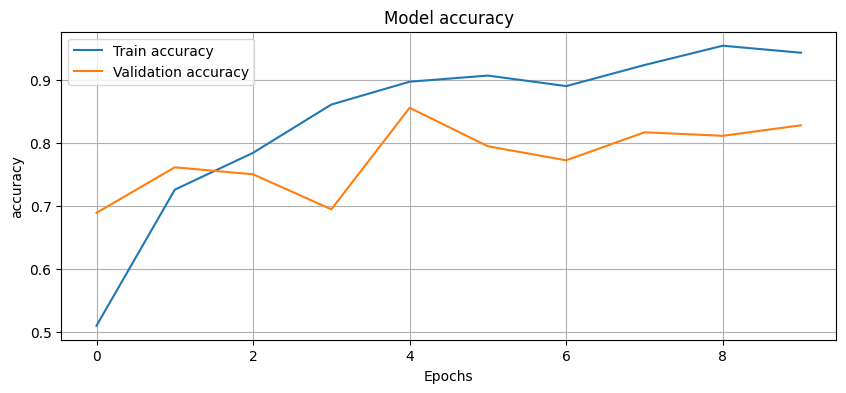

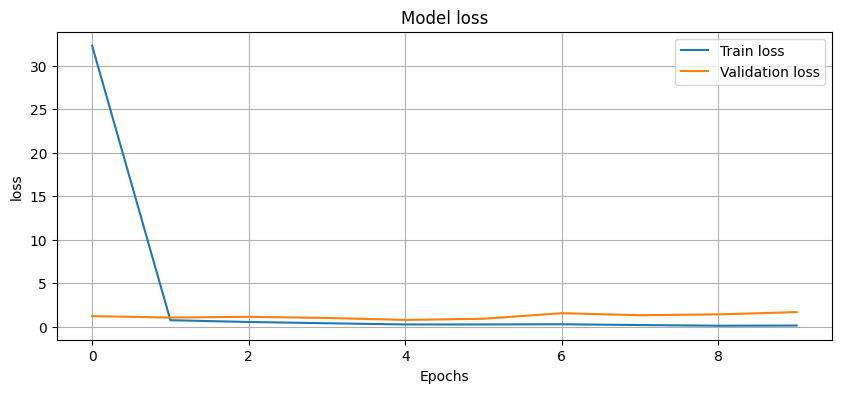

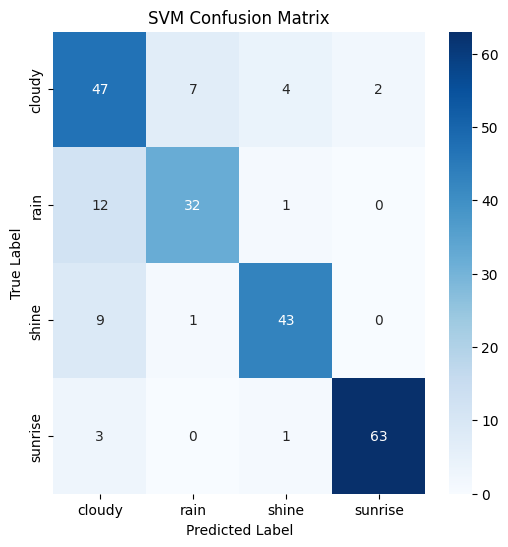

8/8 [==============================] - 1s 140ms/step


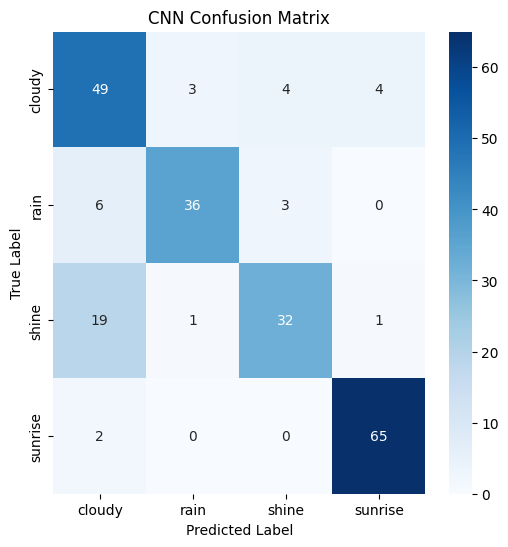

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 12s 485ms/step - loss: 54.6209 - accuracy: 0.4373 - val_loss: 1.6737 - val_accuracy: 0.5000
Epoch 2/10
23/23 [==============================] - 11s 473ms/step - loss: 0.8864 - accuracy: 0.6435 - val_loss: 0.7804 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 10s 429ms/step - loss: 0.6612 - accuracy: 0.7242 - val_loss: 1.0764 - val_accuracy: 0.6944
Epoch 4/10
23/23 [==============================] - 10s 428ms/step - loss: 0.6071 - accuracy: 0.7493 -

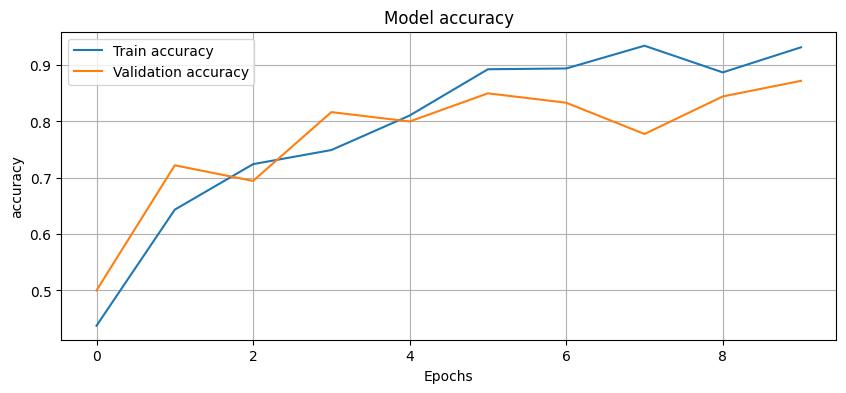

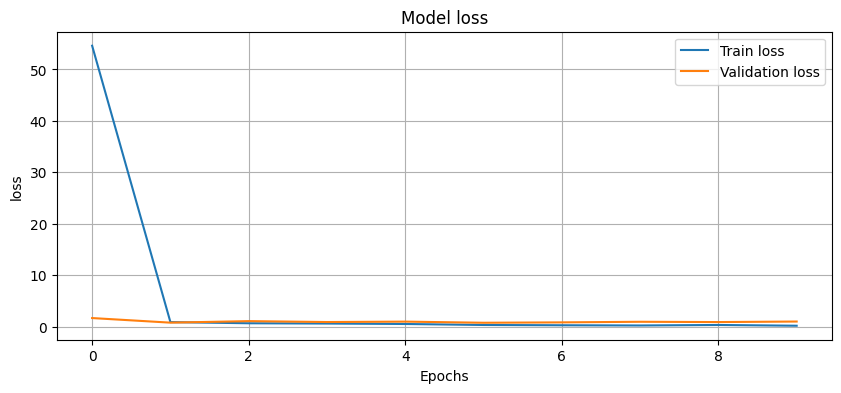

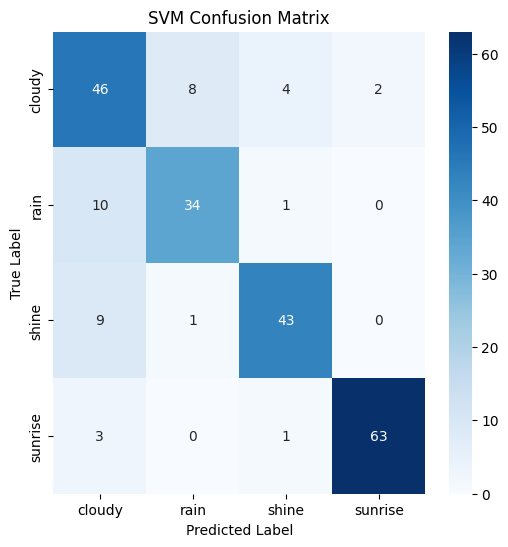

8/8 [==============================] - 1s 120ms/step


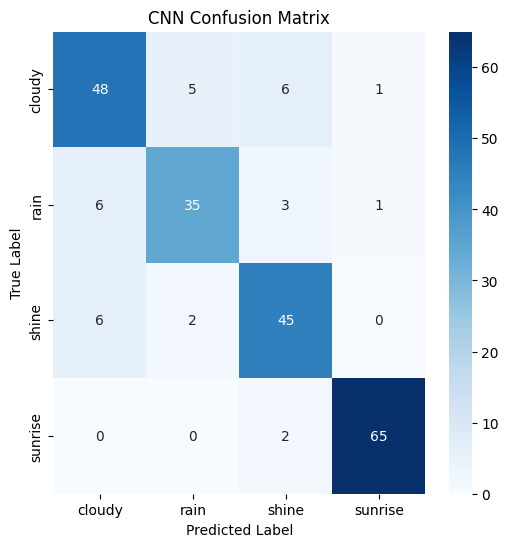

SVM Accuracy: 0.8355555555555556
              precision    recall  f1-score   support

      cloudy       0.69      0.78      0.73        60
        rain       0.81      0.78      0.80        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.84       225
   macro avg       0.84      0.83      0.83       225
weighted avg       0.84      0.84      0.84       225

Epoch 1/10
23/23 [==============================] - 12s 498ms/step - loss: 20.6226 - accuracy: 0.4540 - val_loss: 0.9934 - val_accuracy: 0.7000
Epoch 2/10
23/23 [==============================] - 10s 415ms/step - loss: 0.7147 - accuracy: 0.7382 - val_loss: 0.9716 - val_accuracy: 0.7889
Epoch 3/10
23/23 [==============================] - 11s 491ms/step - loss: 0.5655 - accuracy: 0.8189 - val_loss: 1.2557 - val_accuracy: 0.8389
Epoch 4/10
23/23 [==============================] - 11s 491ms/step - loss: 0.4366 - accuracy: 0.8579 -

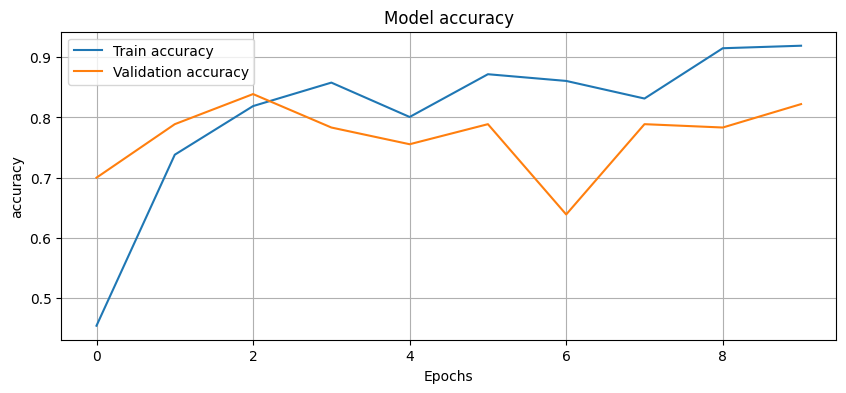

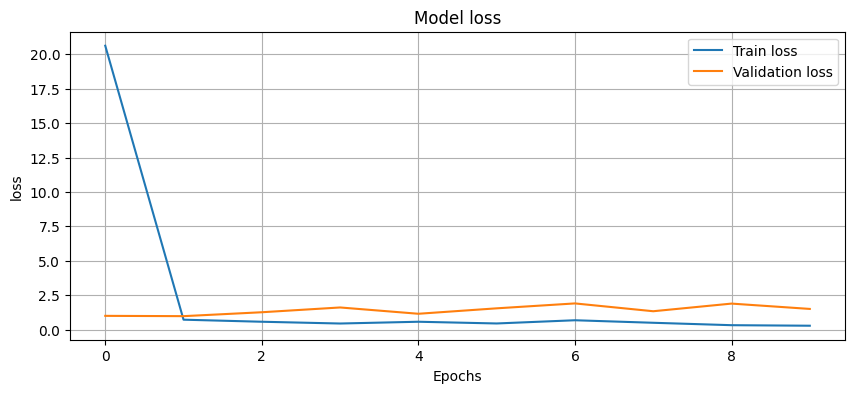

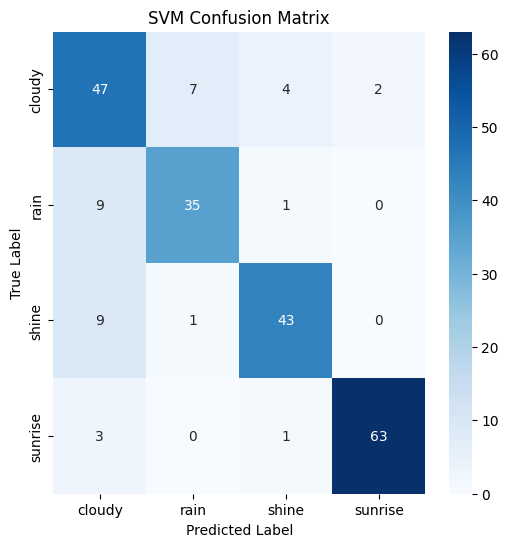

8/8 [==============================] - 1s 140ms/step


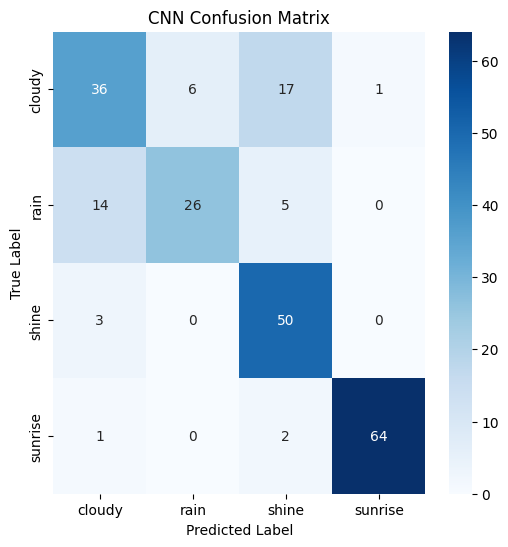

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 12s 507ms/step - loss: 35.3512 - accuracy: 0.4861 - val_loss: 1.6679 - val_accuracy: 0.5444
Epoch 2/10
23/23 [==============================] - 11s 497ms/step - loss: 0.9165 - accuracy: 0.6031 - val_loss: 0.9740 - val_accuracy: 0.6611
Epoch 3/10
23/23 [==============================] - 11s 495ms/step - loss: 0.7150 - accuracy: 0.7187 - val_loss: 1.0834 - val_accuracy: 0.7167
Epoch 4/10
23/23 [==============================] - 10s 422ms/step - loss: 0.5657 - accuracy: 0.7702 -

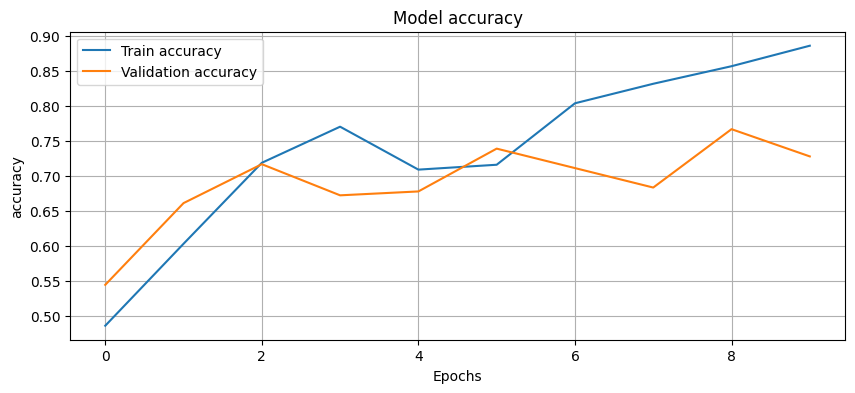

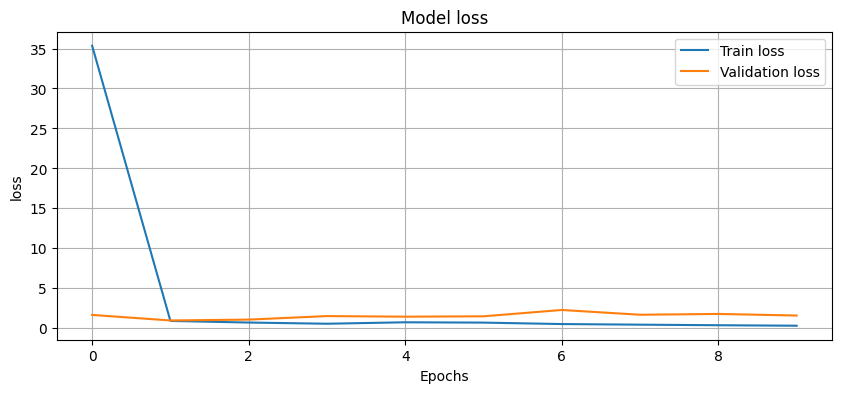

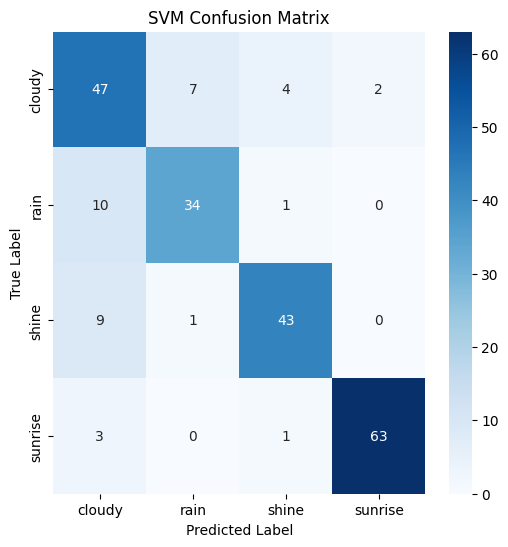

8/8 [==============================] - 1s 123ms/step


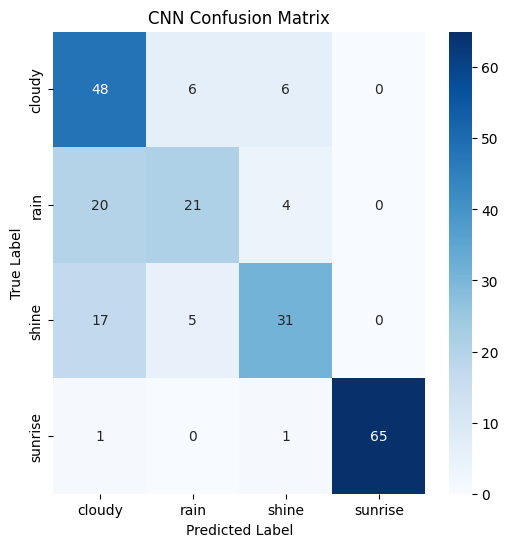

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.75      0.71        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 13s 529ms/step - loss: 16.3743 - accuracy: 0.5139 - val_loss: 0.8958 - val_accuracy: 0.7000
Epoch 2/10
23/23 [==============================] - 13s 550ms/step - loss: 0.7888 - accuracy: 0.6866 - val_loss: 1.2593 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 13s 556ms/step - loss: 0.7250 - accuracy: 0.7521 - val_loss: 1.2187 - val_accuracy: 0.6222
Epoch 4/10
23/23 [==============================] - 11s 502ms/step - loss: 0.6737 - accuracy: 0.7493 -

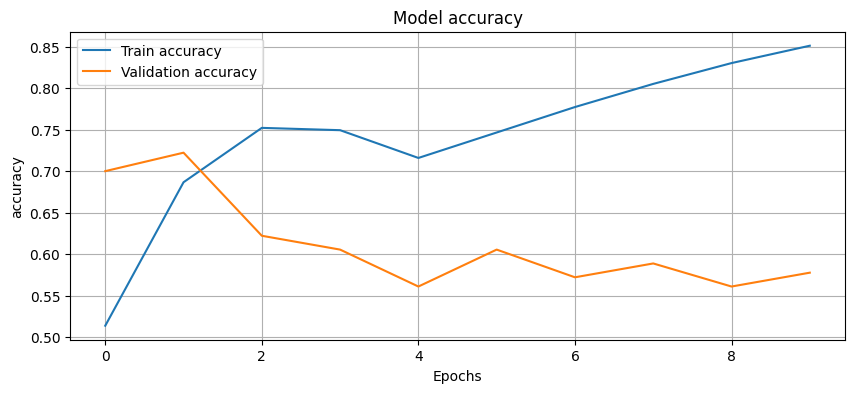

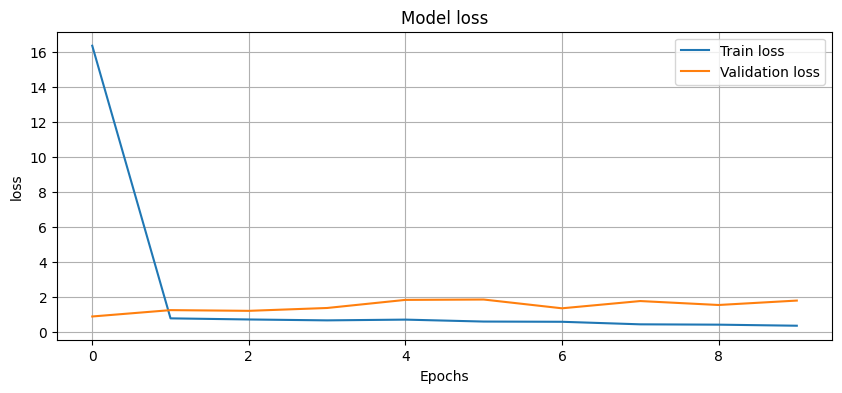

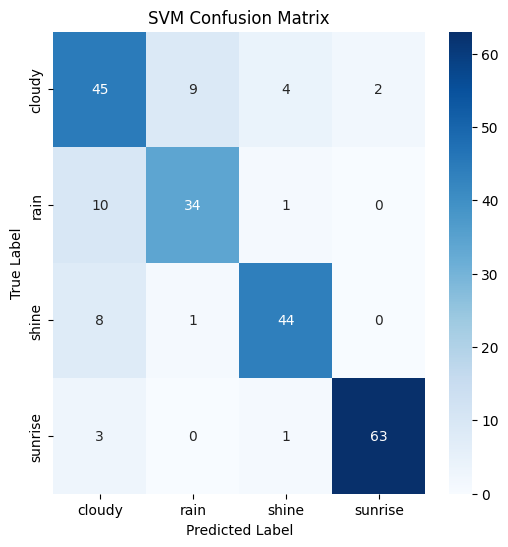

8/8 [==============================] - 2s 180ms/step


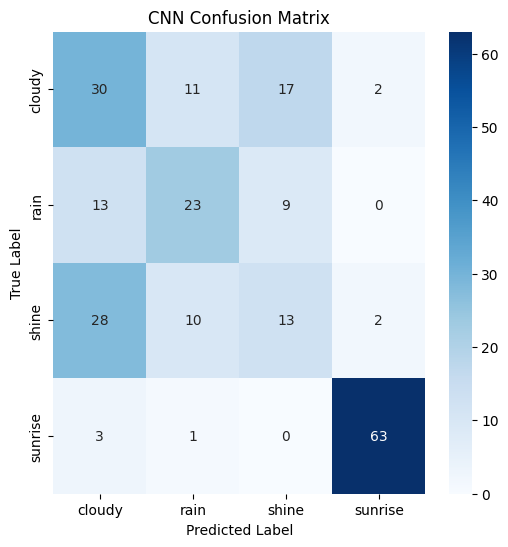

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 12s 486ms/step - loss: 20.1072 - accuracy: 0.5543 - val_loss: 0.9408 - val_accuracy: 0.6500
Epoch 2/10
23/23 [==============================] - 11s 492ms/step - loss: 0.6829 - accuracy: 0.7396 - val_loss: 0.8812 - val_accuracy: 0.8000
Epoch 3/10
23/23 [==============================] - 12s 509ms/step - loss: 0.5859 - accuracy: 0.8189 - val_loss: 0.8426 - val_accuracy: 0.7333
Epoch 4/10
23/23 [==============================] - 12s 505ms/step - loss: 0.4427 - accuracy: 0.8398 -

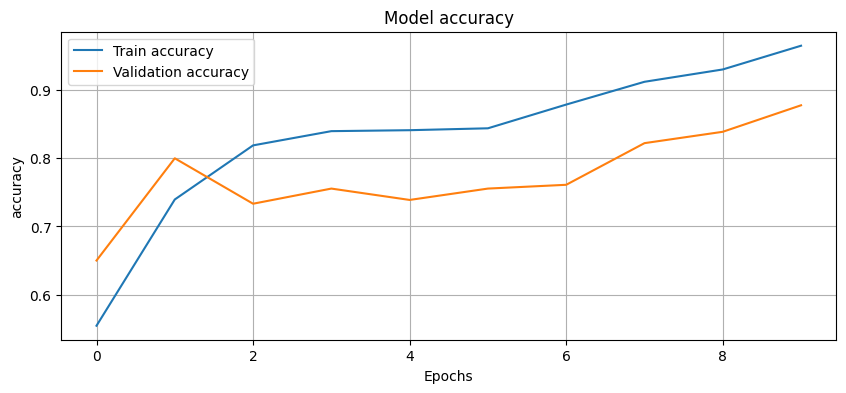

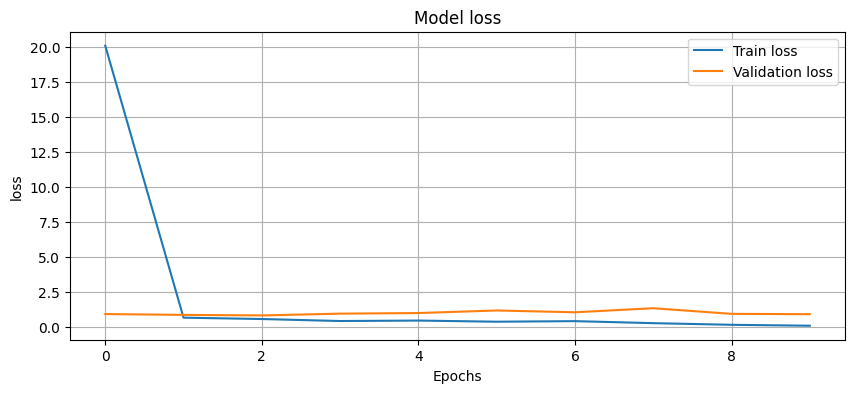

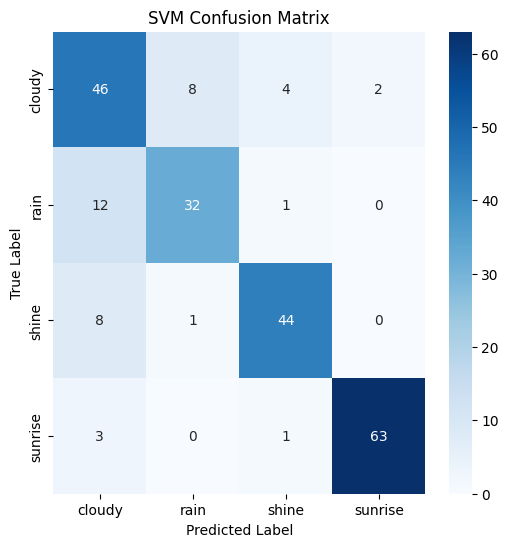

8/8 [==============================] - 1s 129ms/step


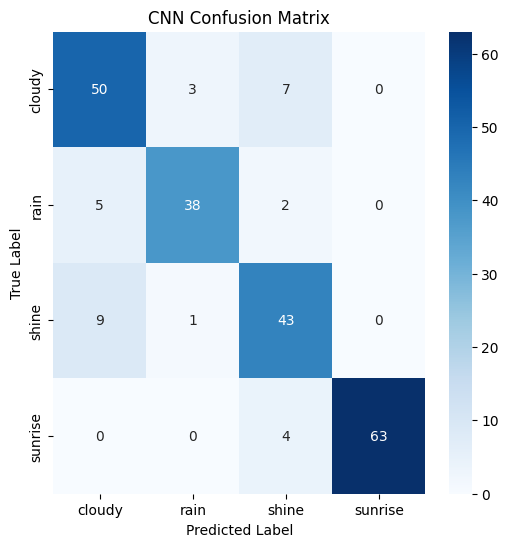

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 14s 579ms/step - loss: 40.1801 - accuracy: 0.5432 - val_loss: 1.0362 - val_accuracy: 0.7833
Epoch 2/10
23/23 [==============================] - 12s 536ms/step - loss: 0.8473 - accuracy: 0.6435 - val_loss: 1.9727 - val_accuracy: 0.6500
Epoch 3/10
23/23 [==============================] - 11s 491ms/step - loss: 0.6417 - accuracy: 0.6950 - val_loss: 2.1647 - val_accuracy: 0.7333
Epoch 4/10
23/23 [==============================] - 12s 498ms/step - loss: 0.5309 - accuracy: 0.7604 -

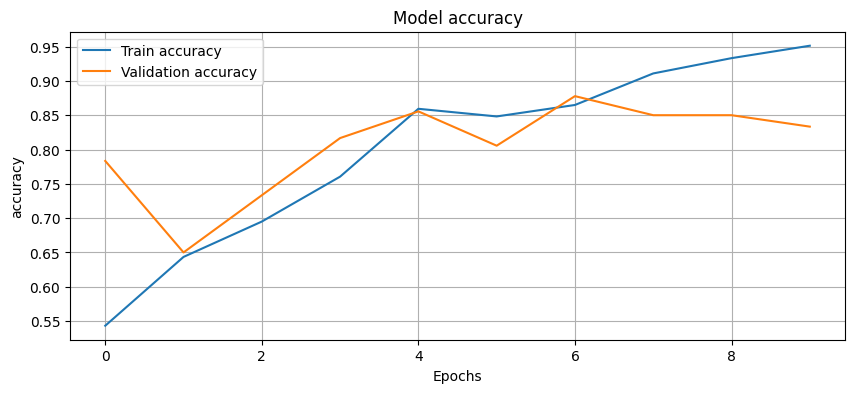

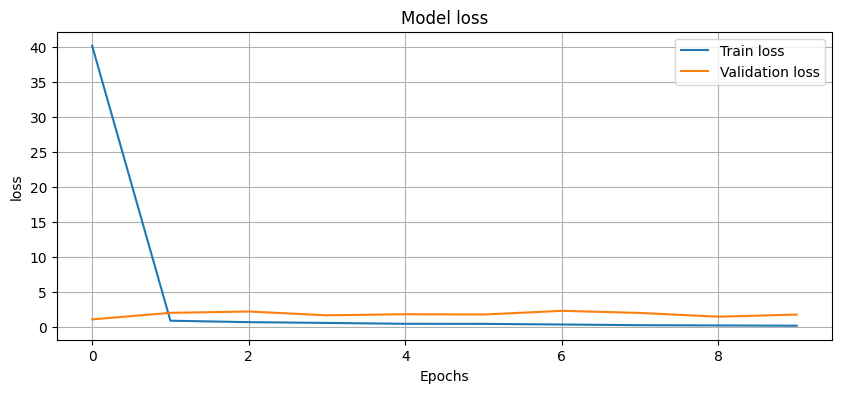

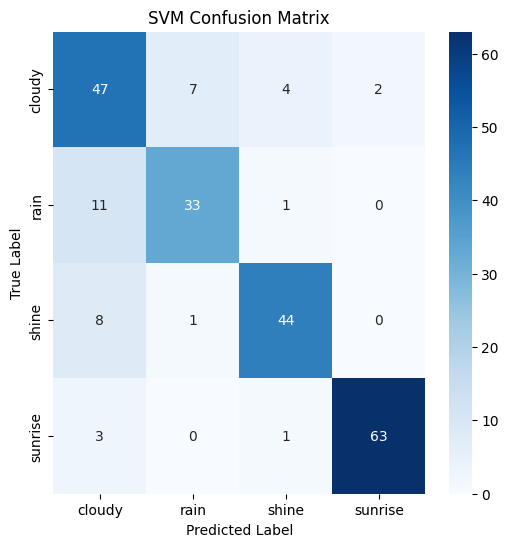

8/8 [==============================] - 1s 135ms/step


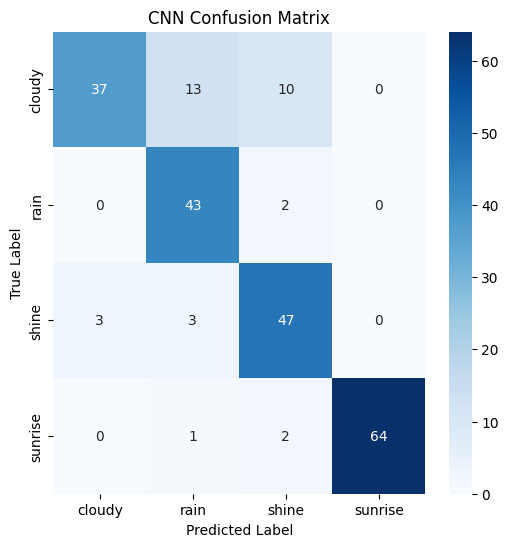

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 14s 585ms/step - loss: 48.8075 - accuracy: 0.5251 - val_loss: 0.8445 - val_accuracy: 0.7833
Epoch 2/10
23/23 [==============================] - 12s 531ms/step - loss: 0.5274 - accuracy: 0.8203 - val_loss: 0.8354 - val_accuracy: 0.7333
Epoch 3/10
23/23 [==============================] - 12s 511ms/step - loss: 0.4978 - accuracy: 0.8106 - val_loss: 1.0823 - val_accuracy: 0.6778
Epoch 4/10
23/23 [==============================] - 13s 554ms/step - loss: 0.4981 - accuracy: 0.8148 -

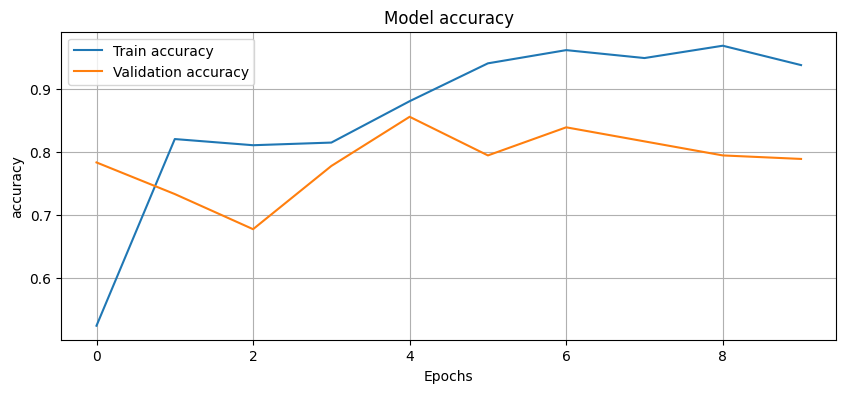

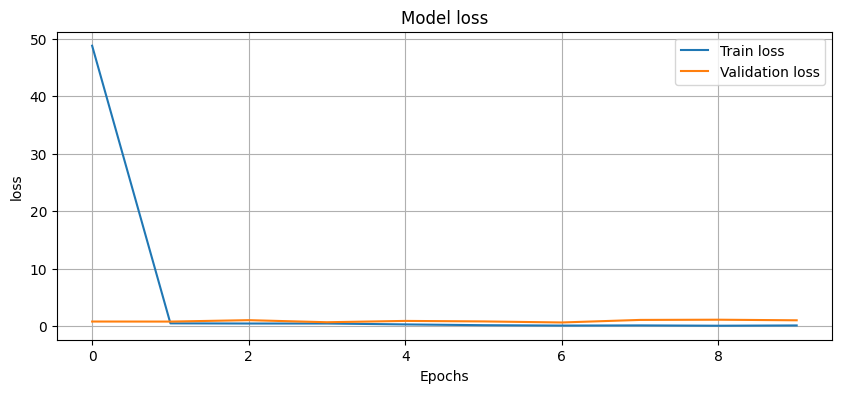

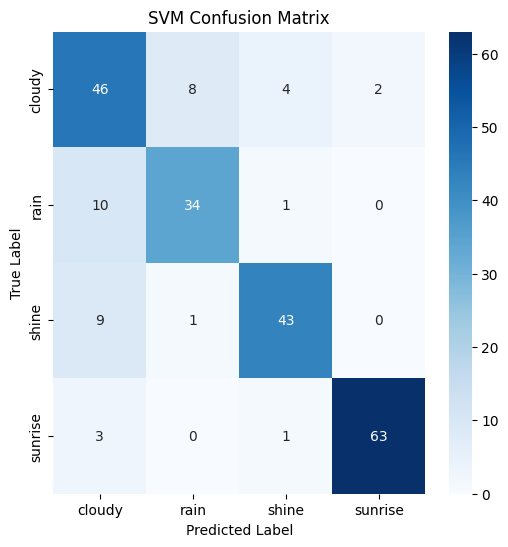

8/8 [==============================] - 1s 136ms/step


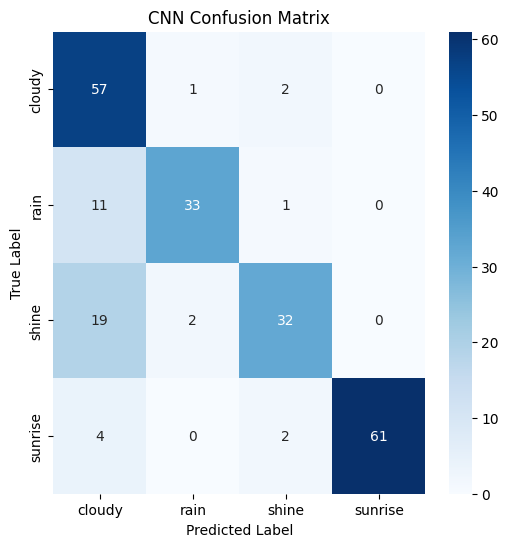

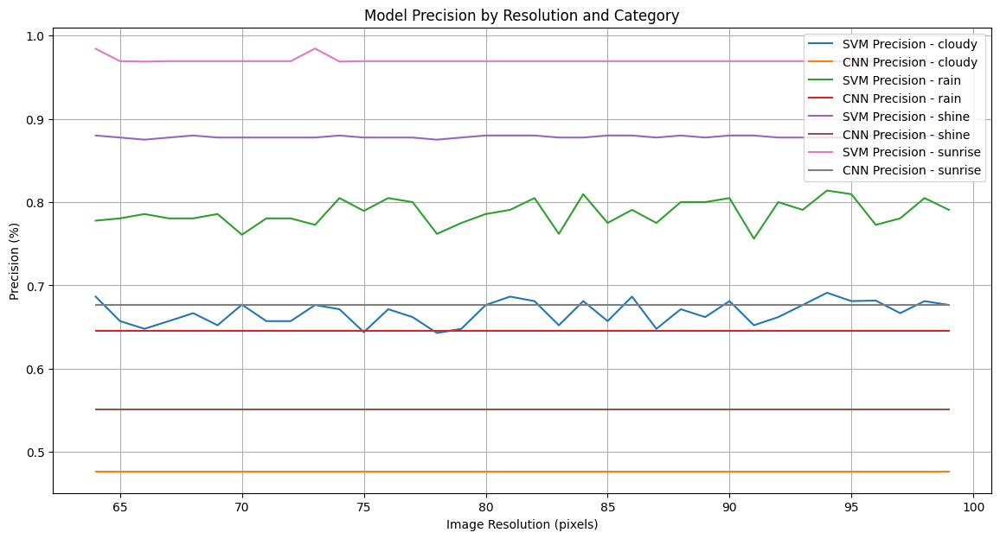

In [ ]:
def plot_metrics(history, metric='accuracy', val_metric='val_accuracy'):
    plt.figure(figsize=(10, 4))
    plt.plot(history.history[metric], label='Train ' + metric)
    plt.plot(history.history[val_metric], label='Validation ' + metric)
    plt.title('Model ' + metric)
    plt.ylabel(metric)
    plt.xlabel('Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path)  # Load in color
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image.flatten())
                labels.append(category)

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data
    X_train, X_test, y_train, y_test = train_test_split(
        np.array(data), encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train, y_train)
    svm_predictions = svm_model.predict(X_test)
    svm_accuracy = accuracy_score(y_test, svm_predictions)
    svm_report = precision_recall_fscore_support(y_test, svm_predictions, average=None, labels=[0,1,2,3])
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test, svm_predictions, target_names=label_encoder.classes_))

    # CNN model
    cnn_model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax')
    ])

    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    # Reshape data for CNN
    X_train_cnn = X_train.reshape((-1, target_size[0], target_size[1], 3))
    X_test_cnn = X_test.reshape((-1, target_size[0], target_size[1], 3))

    history = cnn_model.fit(X_train_cnn, y_train, epochs=10, validation_split=0.2)
    cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test_cnn, y_test)
    print(f"CNN Accuracy: {cnn_accuracy}")

    # Plot accuracy and loss
    plot_metrics(history, 'accuracy', 'val_accuracy')
    plot_metrics(history, 'loss', 'val_loss')

    # Confusion matrices
    svm_cm = confusion_matrix(y_test, svm_predictions)
    plot_confusion_matrix(svm_cm, label_encoder.classes_, "SVM Confusion Matrix")

    cnn_predictions = cnn_model.predict(X_test_cnn)
    cnn_predictions = np.argmax(cnn_predictions, axis=1)
    cnn_cm = confusion_matrix(y_test, cnn_predictions)
    plot_confusion_matrix(cnn_cm, label_encoder.classes_, "CNN Confusion Matrix")

    return svm_report, cnn_report, label_encoder.classes_

# Collecting accuracies
svm_results = []
cnn_results = []
resolutions = range(64, 100)  # Change range as needed
labels = []

for i in resolutions:
    svm_report, cnn_report, classes = train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset', (i, i))
    svm_results.append(svm_report)
    cnn_results.append(cnn_report)
    labels = classes  # Save label names for later use

# Plotting
plt.figure(figsize=(14, 7))

for i, category in enumerate(labels):
    category_accuracies_svm = [result[0][i] for result in svm_results]  # Precision values for SVM
    category_accuracies_cnn = [result[0][i] for result in cnn_results]  # Precision values for CNN
    plt.plot(resolutions, category_accuracies_svm, label=f'SVM Precision - {category}')
    plt.plot(resolutions, category_accuracies_cnn, label=f'CNN Precision - {category}')

plt.xlabel('Image Resolution (pixels)')
plt.ylabel('Precision (%)')
plt.title('Model Precision by Resolution and Category')
plt.legend()
plt.grid(True)
plt.show()

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.78      0.78      0.78        45
       shine       0.88      0.83      0.85        53
     sunrise       0.98      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.83      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 5s 193ms/step - loss: 19.5187 - accuracy: 0.4053 - val_loss: 1.1768 - val_accuracy: 0.4500
Epoch 2/10
23/23 [==============================] - 4s 174ms/step - loss: 1.0086 - accuracy: 0.5279 - val_loss: 1.0936 - val_accuracy: 0.5889
Epoch 3/10
23/23 [==============================] - 6s 250ms/step - loss: 0.9609 - accuracy: 0.6086 - val_loss: 1.0720 - val_accuracy: 0.6556
Epoch 4/10
23/23 [==============================] - 4s 176ms/step - loss: 0.8248 - accuracy: 0.6699 - val

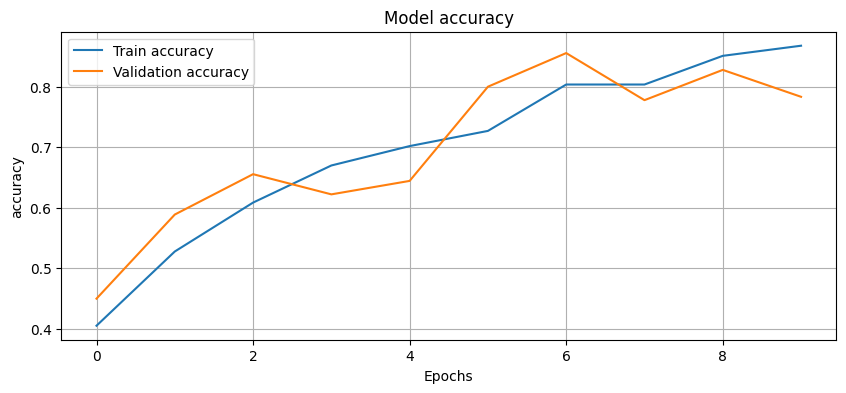

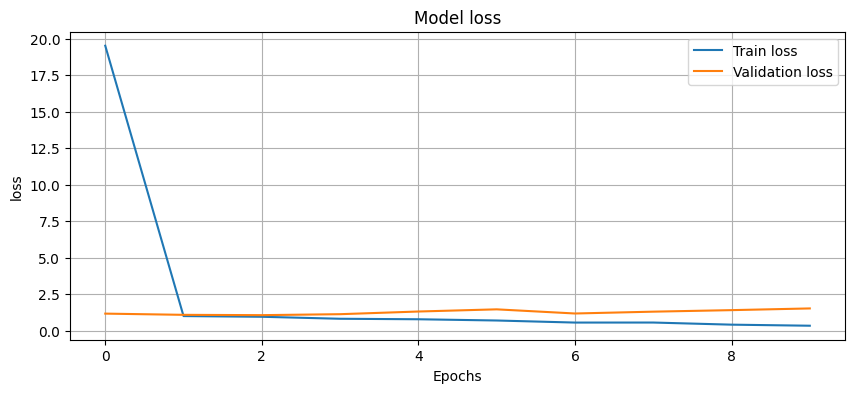

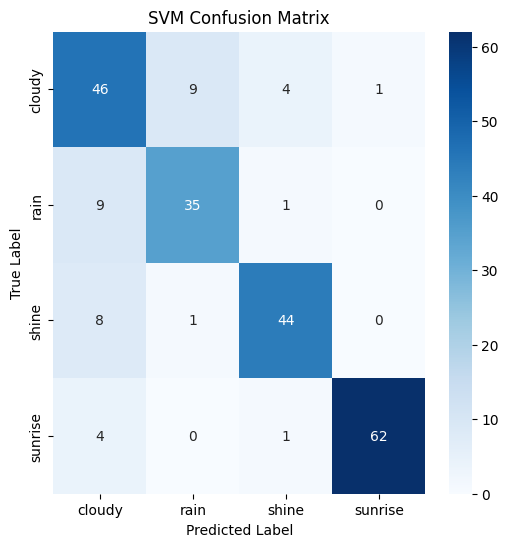

8/8 [==============================] - 0s 38ms/step


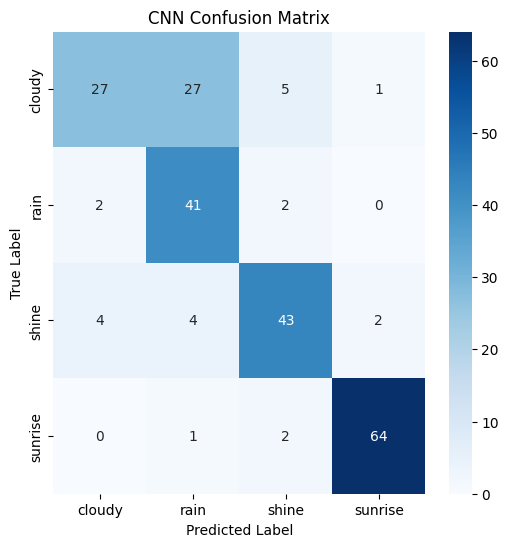

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 186ms/step - loss: 13.0116 - accuracy: 0.4958 - val_loss: 0.8437 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 6s 252ms/step - loss: 0.6255 - accuracy: 0.7423 - val_loss: 0.6980 - val_accuracy: 0.7944
Epoch 3/10
23/23 [==============================] - 4s 173ms/step - loss: 0.4045 - accuracy: 0.8398 - val_loss: 0.6881 - val_accuracy: 0.8556
Epoch 4/10
23/23 [==============================] - 4s 169ms/step - loss: 0.2414 - accuracy: 0.9109 - val

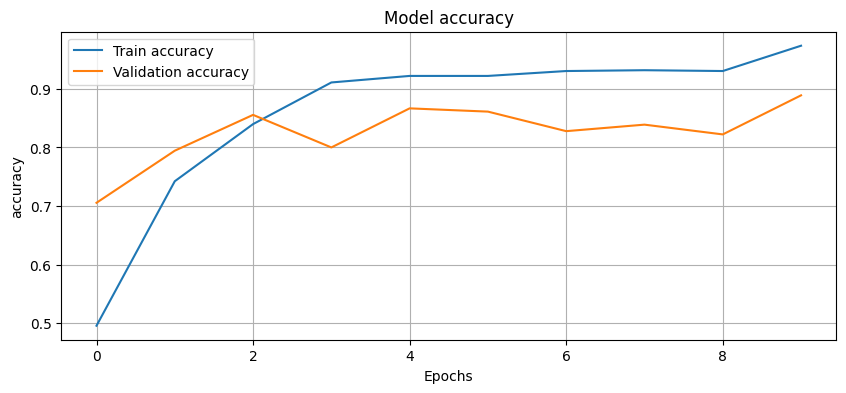

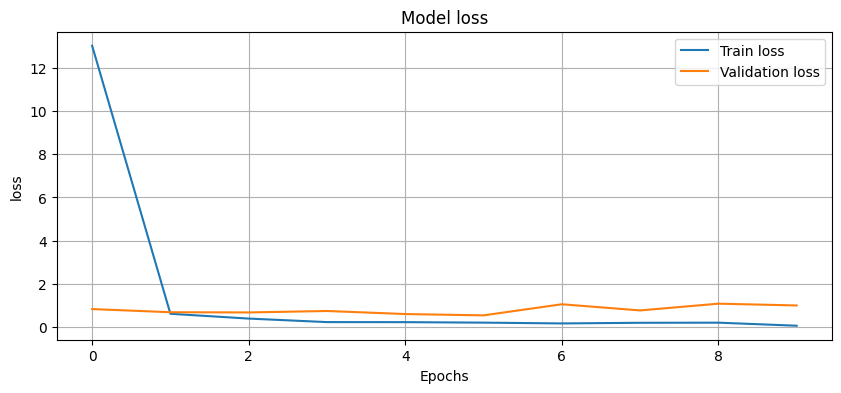

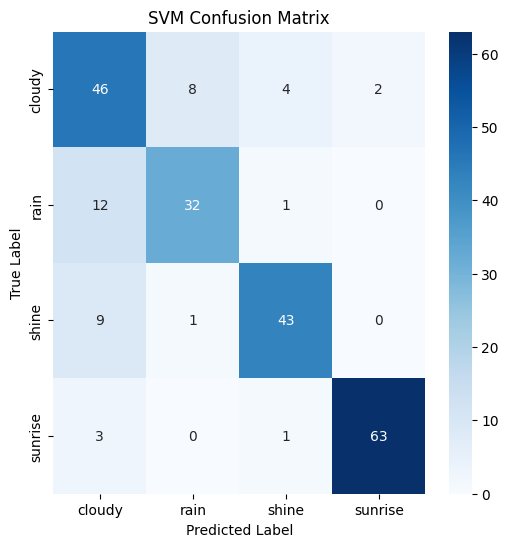

8/8 [==============================] - 0s 43ms/step


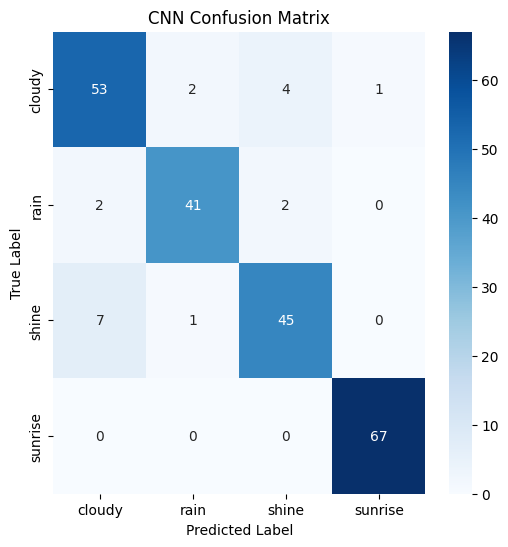

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 196ms/step - loss: 11.6920 - accuracy: 0.4582 - val_loss: 1.2123 - val_accuracy: 0.4278
Epoch 2/10
23/23 [==============================] - 6s 267ms/step - loss: 0.8897 - accuracy: 0.6017 - val_loss: 1.3032 - val_accuracy: 0.6056
Epoch 3/10
23/23 [==============================] - 4s 185ms/step - loss: 0.8934 - accuracy: 0.6281 - val_loss: 1.5654 - val_accuracy: 0.6278
Epoch 4/10
23/23 [==============================] - 4s 186ms/step - loss: 0.8220 - accuracy: 0.6769 - val

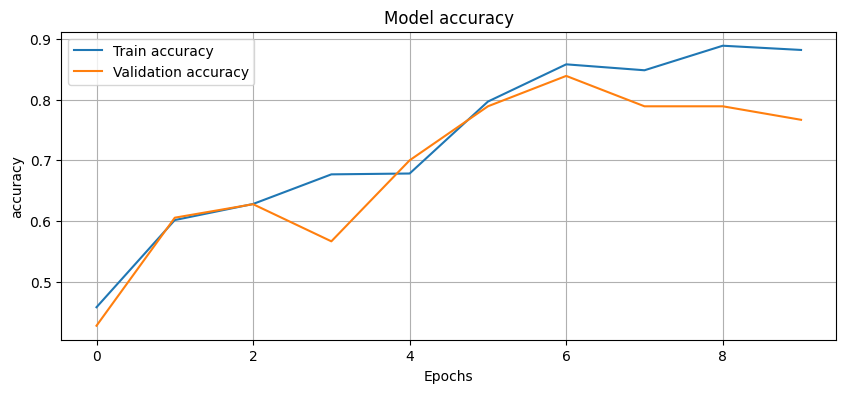

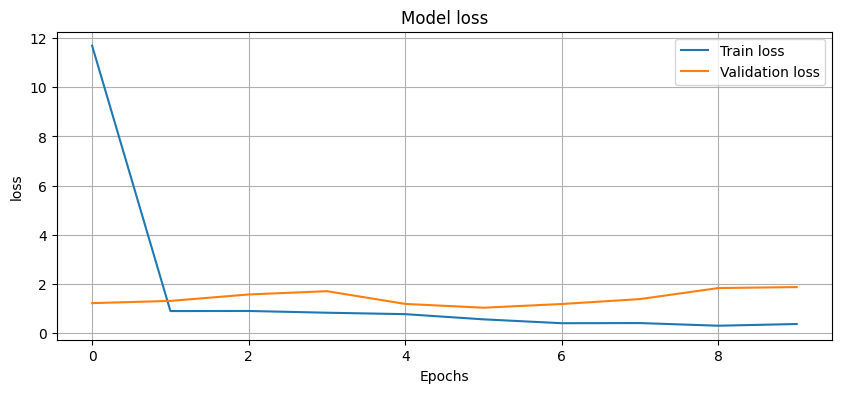

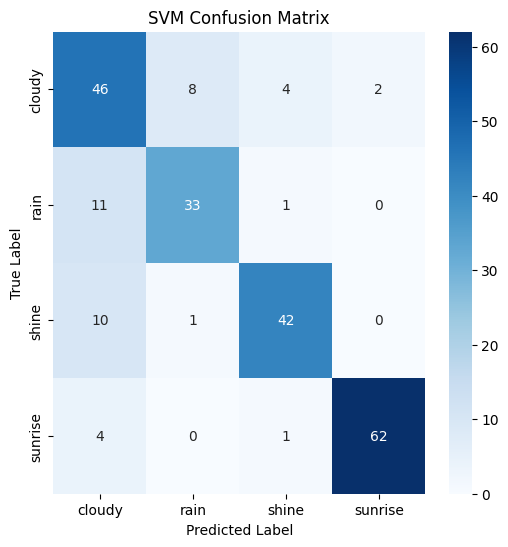

8/8 [==============================] - 0s 46ms/step


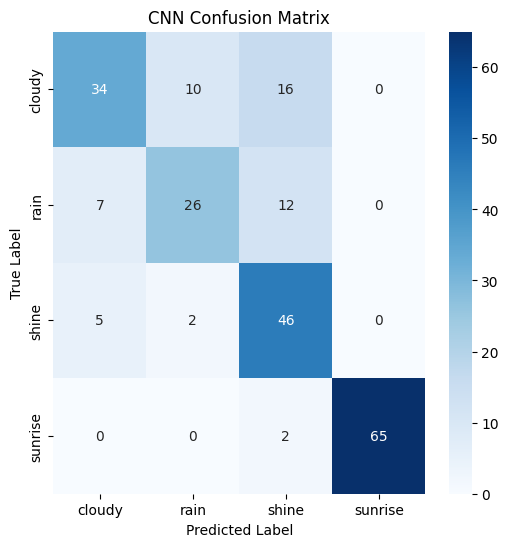

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 229ms/step - loss: 14.0542 - accuracy: 0.5390 - val_loss: 0.6777 - val_accuracy: 0.7667
Epoch 2/10
23/23 [==============================] - 5s 233ms/step - loss: 0.6707 - accuracy: 0.7423 - val_loss: 0.8435 - val_accuracy: 0.7944
Epoch 3/10
23/23 [==============================] - 4s 187ms/step - loss: 0.5463 - accuracy: 0.8231 - val_loss: 0.7921 - val_accuracy: 0.7944
Epoch 4/10
23/23 [==============================] - 5s 228ms/step - loss: 0.4719 - accuracy: 0.8120 - val

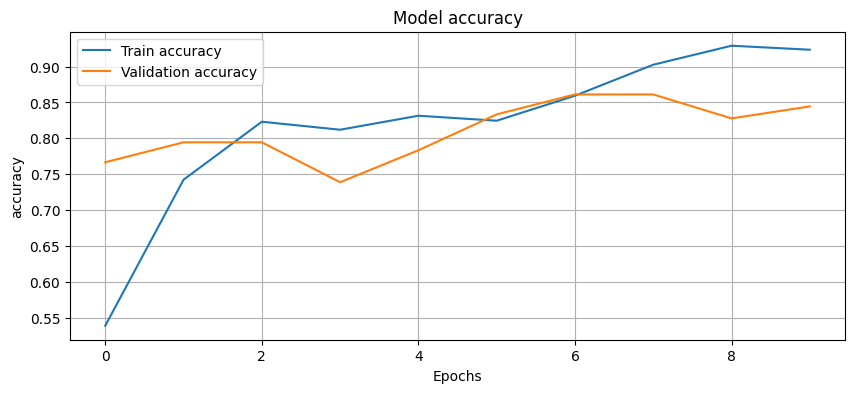

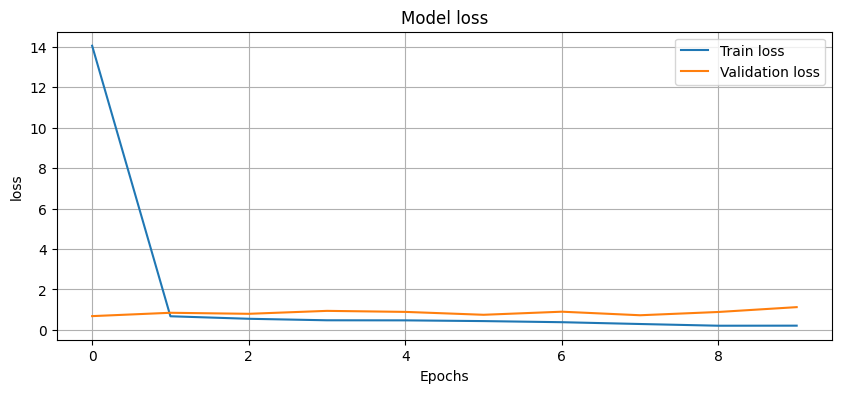

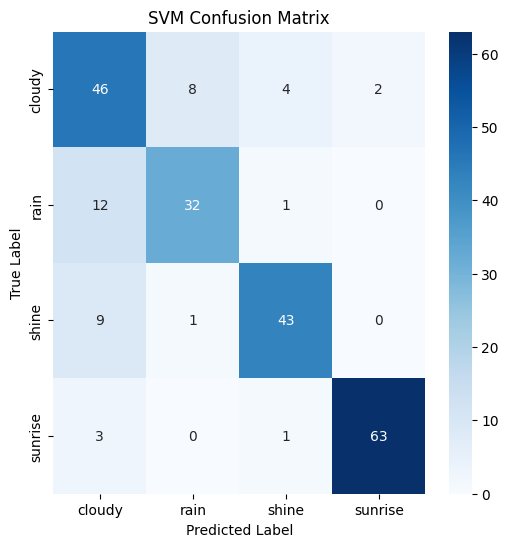

8/8 [==============================] - 0s 48ms/step


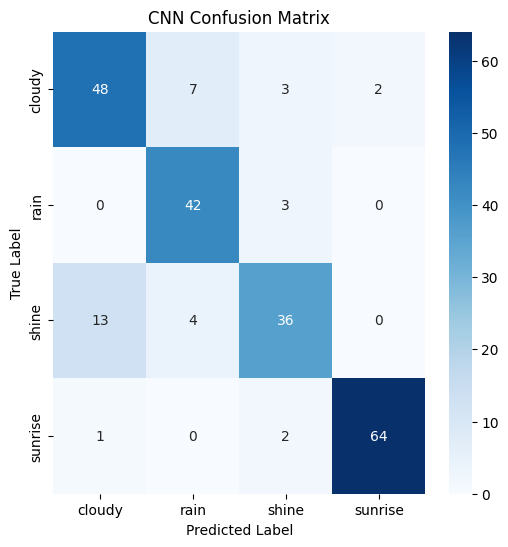

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 225ms/step - loss: 16.1286 - accuracy: 0.5348 - val_loss: 0.9794 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 6s 259ms/step - loss: 0.6581 - accuracy: 0.7535 - val_loss: 1.0542 - val_accuracy: 0.7722
Epoch 3/10
23/23 [==============================] - 5s 202ms/step - loss: 0.5945 - accuracy: 0.7758 - val_loss: 1.1592 - val_accuracy: 0.7611
Epoch 4/10
23/23 [==============================] - 5s 237ms/step - loss: 0.4524 - accuracy: 0.8398 - val

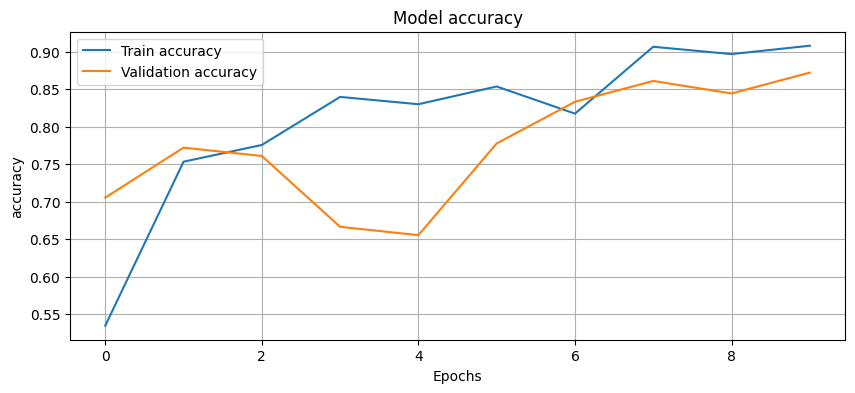

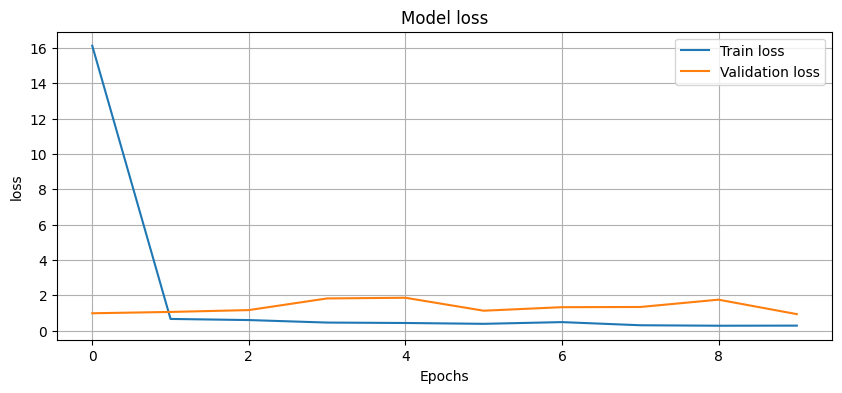

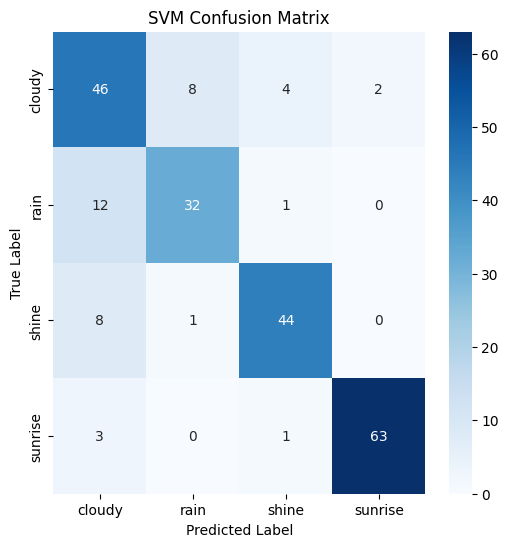

8/8 [==============================] - 1s 53ms/step


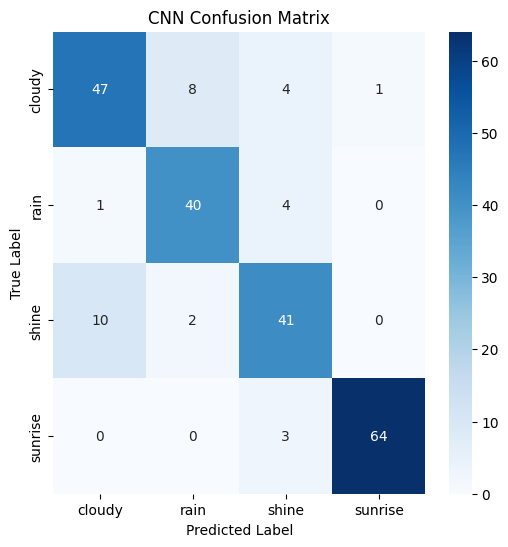

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 255ms/step - loss: 15.4861 - accuracy: 0.4638 - val_loss: 1.1781 - val_accuracy: 0.6722
Epoch 2/10
23/23 [==============================] - 5s 233ms/step - loss: 0.6788 - accuracy: 0.7409 - val_loss: 1.0120 - val_accuracy: 0.8500
Epoch 3/10
23/23 [==============================] - 5s 205ms/step - loss: 0.4311 - accuracy: 0.8496 - val_loss: 1.1143 - val_accuracy: 0.7167
Epoch 4/10
23/23 [==============================] - 7s 288ms/step - loss: 0.3769 - accuracy: 0.8482 - val

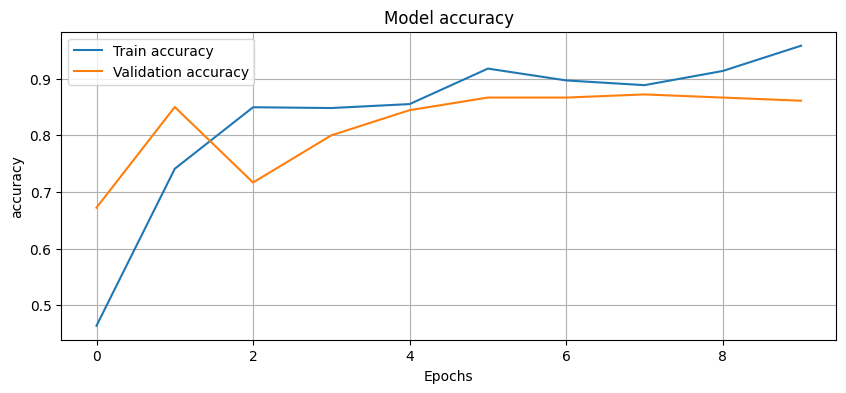

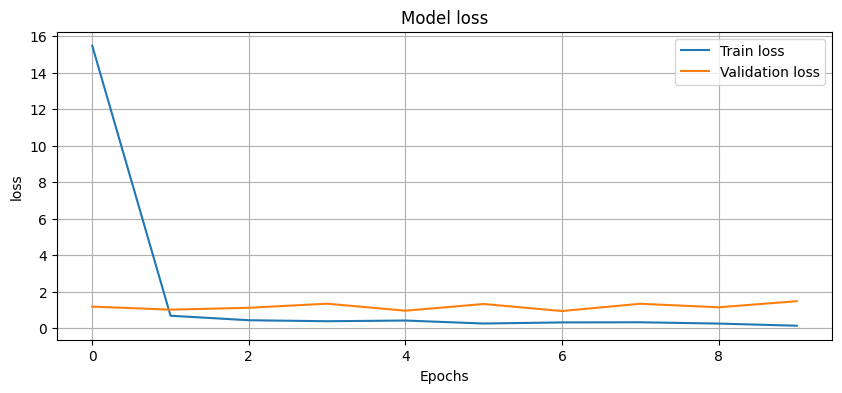

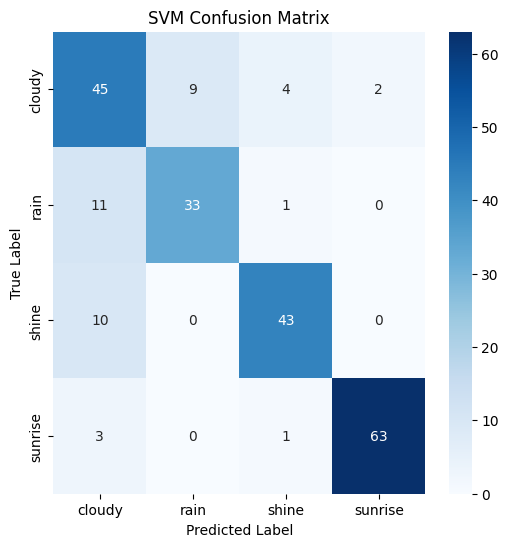

8/8 [==============================] - 1s 53ms/step


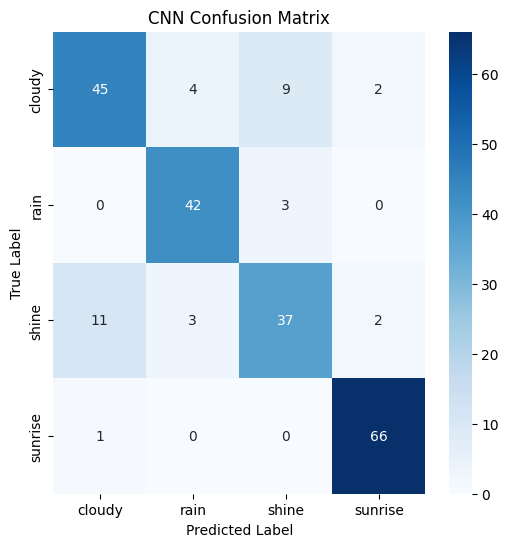

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.68      0.73      0.70        60
        rain       0.76      0.78      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.82      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 239ms/step - loss: 20.9244 - accuracy: 0.4735 - val_loss: 0.9669 - val_accuracy: 0.6444
Epoch 2/10
23/23 [==============================] - 6s 260ms/step - loss: 0.6113 - accuracy: 0.7507 - val_loss: 0.6261 - val_accuracy: 0.7722
Epoch 3/10
23/23 [==============================] - 6s 238ms/step - loss: 0.4786 - accuracy: 0.8245 - val_loss: 0.8514 - val_accuracy: 0.7722
Epoch 4/10
23/23 [==============================] - 5s 215ms/step - loss: 0.4449 - accuracy: 0.8217 - val

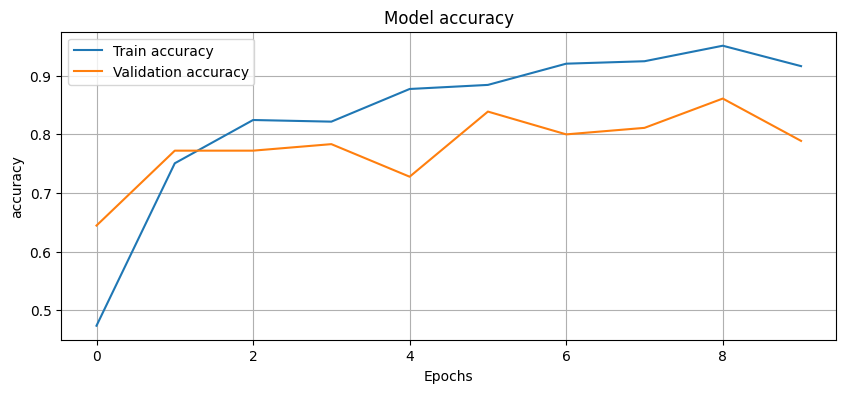

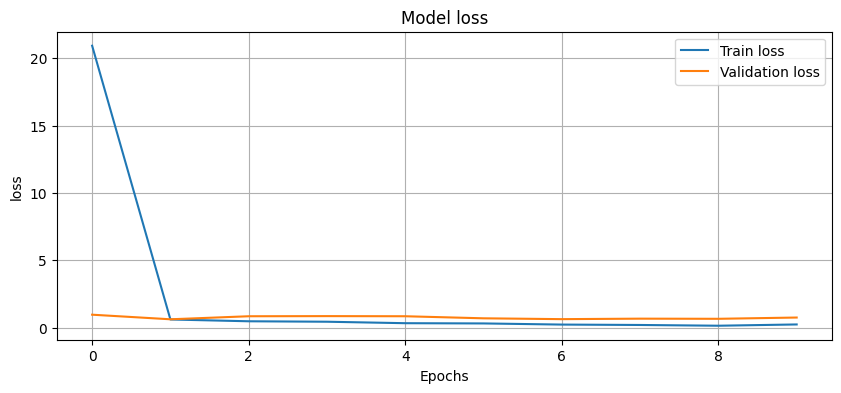

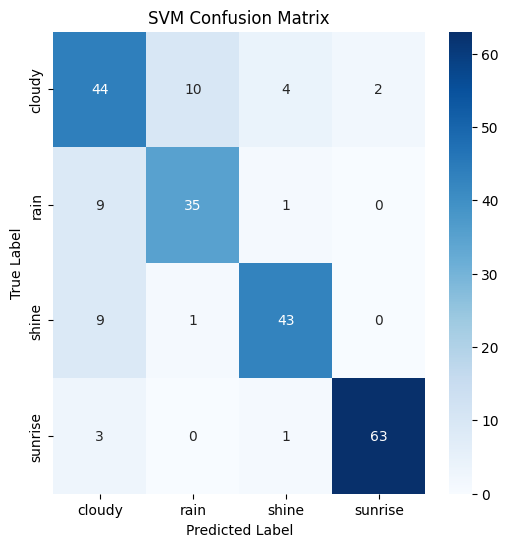

8/8 [==============================] - 1s 55ms/step


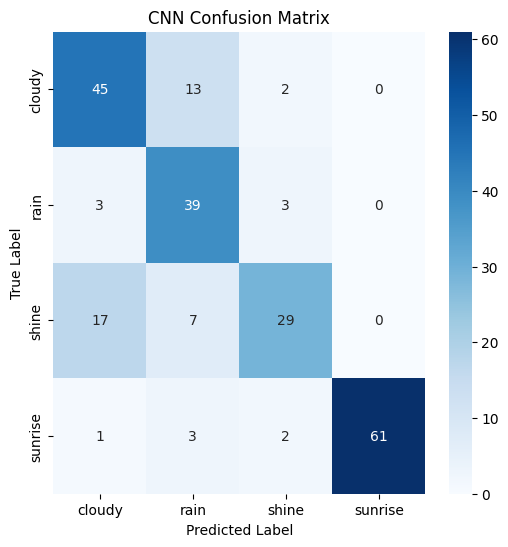

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 225ms/step - loss: 15.0480 - accuracy: 0.4889 - val_loss: 1.0902 - val_accuracy: 0.6167
Epoch 2/10
23/23 [==============================] - 7s 290ms/step - loss: 0.7143 - accuracy: 0.7061 - val_loss: 0.9630 - val_accuracy: 0.6500
Epoch 3/10
23/23 [==============================] - 5s 214ms/step - loss: 0.5673 - accuracy: 0.7674 - val_loss: 1.0479 - val_accuracy: 0.7444
Epoch 4/10
23/23 [==============================] - 5s 212ms/step - loss: 0.6850 - accuracy: 0.6992 - val

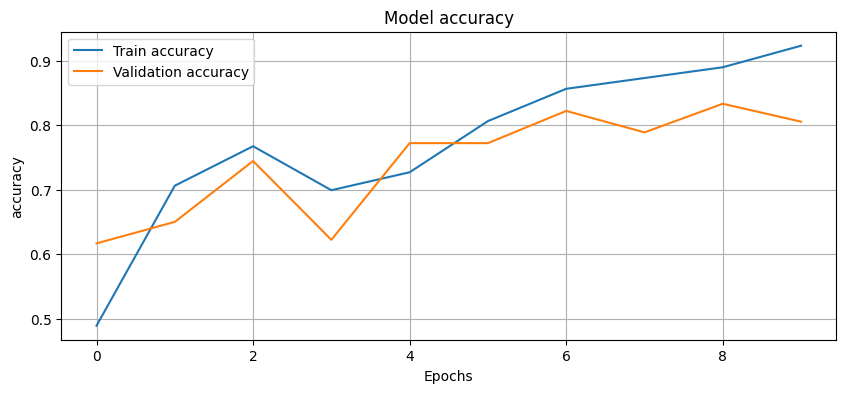

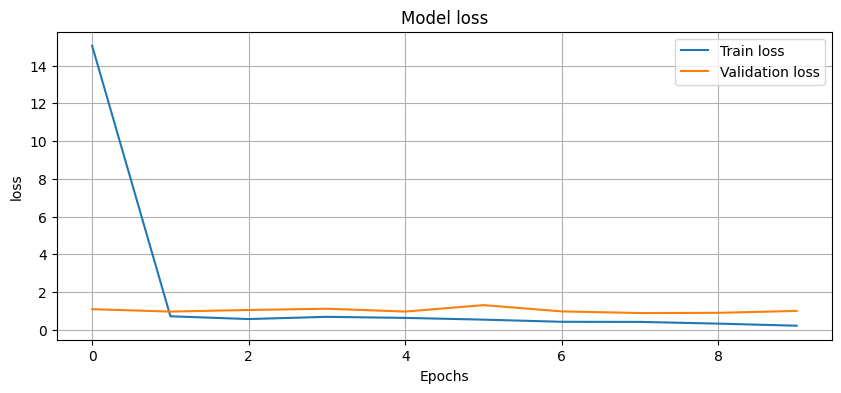

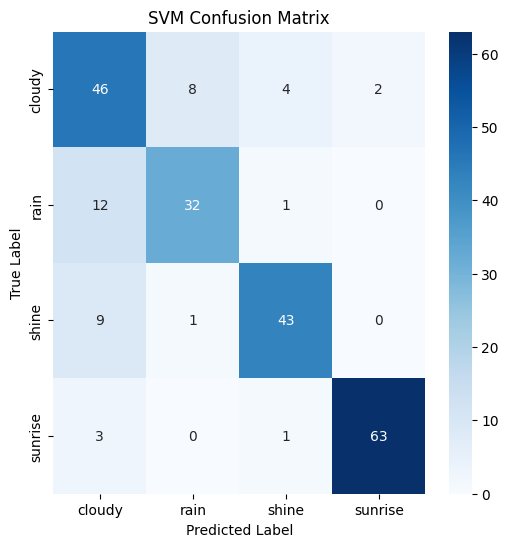

8/8 [==============================] - 1s 58ms/step


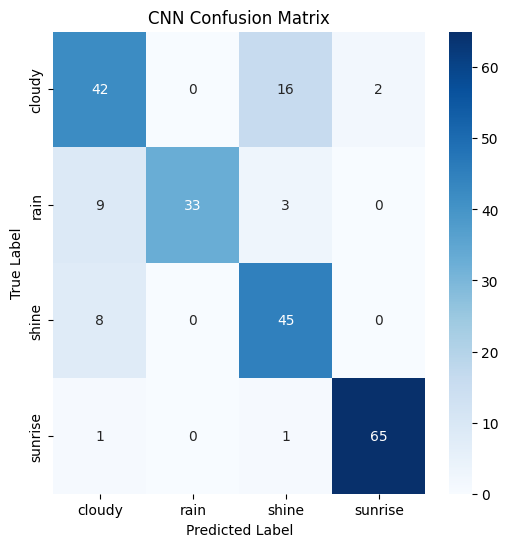

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 235ms/step - loss: 8.0598 - accuracy: 0.5543 - val_loss: 0.8370 - val_accuracy: 0.6722
Epoch 2/10
23/23 [==============================] - 5s 239ms/step - loss: 0.5550 - accuracy: 0.7897 - val_loss: 0.6646 - val_accuracy: 0.8667
Epoch 3/10
23/23 [==============================] - 7s 301ms/step - loss: 0.3545 - accuracy: 0.8705 - val_loss: 0.7352 - val_accuracy: 0.8222
Epoch 4/10
23/23 [==============================] - 5s 225ms/step - loss: 0.2871 - accuracy: 0.9011 - val_

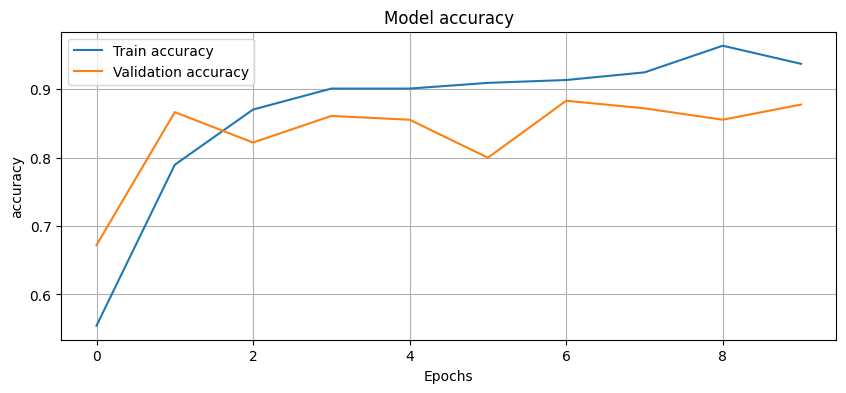

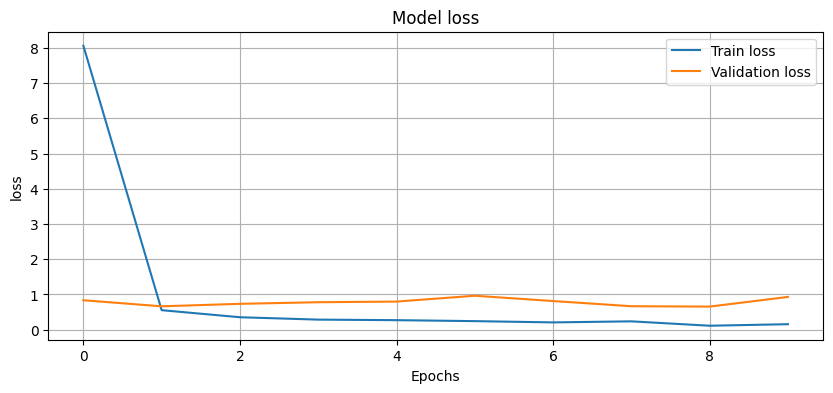

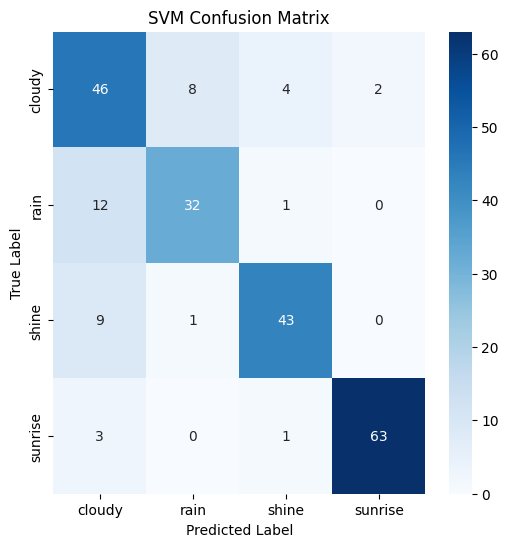

8/8 [==============================] - 1s 58ms/step


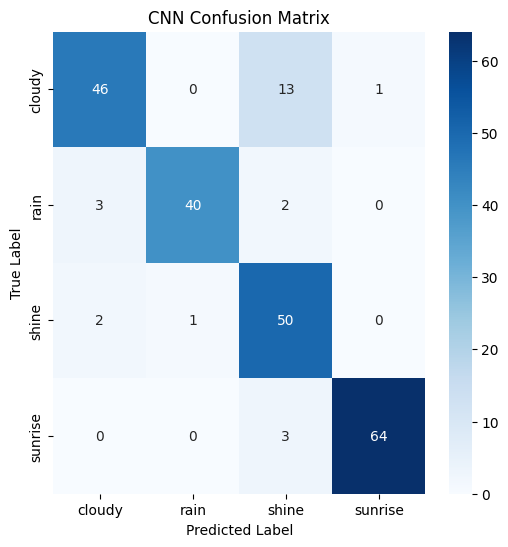

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.98      0.94      0.96        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 245ms/step - loss: 45.6144 - accuracy: 0.4471 - val_loss: 0.8551 - val_accuracy: 0.6889
Epoch 2/10
23/23 [==============================] - 6s 272ms/step - loss: 0.8253 - accuracy: 0.6922 - val_loss: 0.9659 - val_accuracy: 0.7611
Epoch 3/10
23/23 [==============================] - 7s 282ms/step - loss: 0.6146 - accuracy: 0.7521 - val_loss: 0.8915 - val_accuracy: 0.7500
Epoch 4/10
23/23 [==============================] - 6s 245ms/step - loss: 0.5276 - accuracy: 0.7883 - val

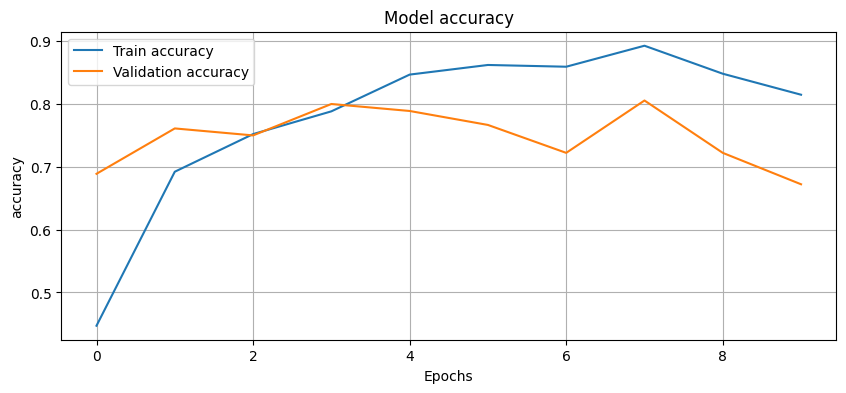

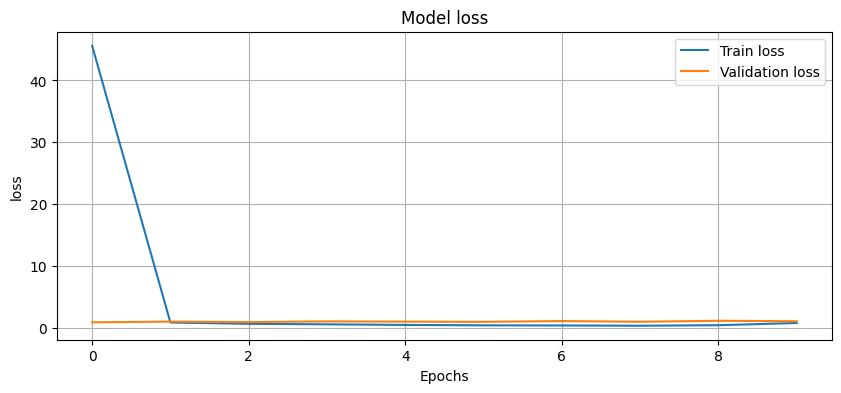

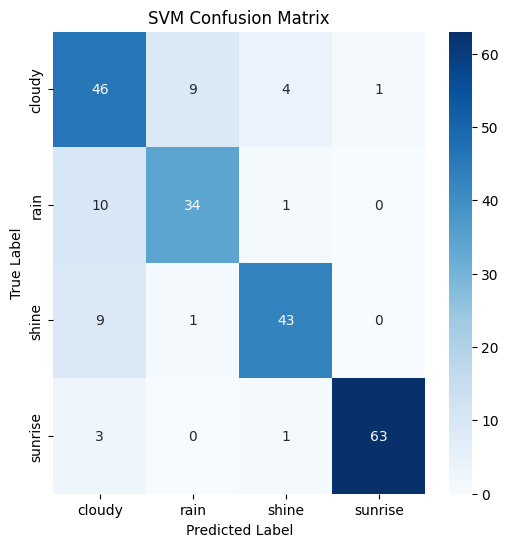

8/8 [==============================] - 1s 60ms/step


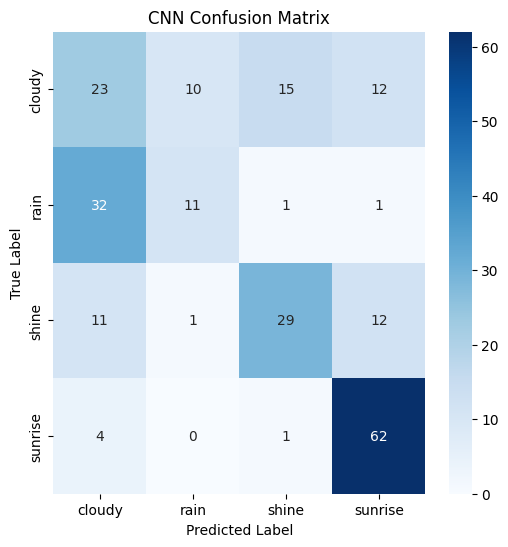

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 275ms/step - loss: 28.7880 - accuracy: 0.4123 - val_loss: 1.1446 - val_accuracy: 0.4611
Epoch 2/10
23/23 [==============================] - 8s 344ms/step - loss: 1.0000 - accuracy: 0.5209 - val_loss: 1.2826 - val_accuracy: 0.5889
Epoch 3/10
23/23 [==============================] - 6s 265ms/step - loss: 0.9400 - accuracy: 0.5933 - val_loss: 1.1884 - val_accuracy: 0.5111
Epoch 4/10
23/23 [==============================] - 8s 344ms/step - loss: 0.8912 - accuracy: 0.5919 - val

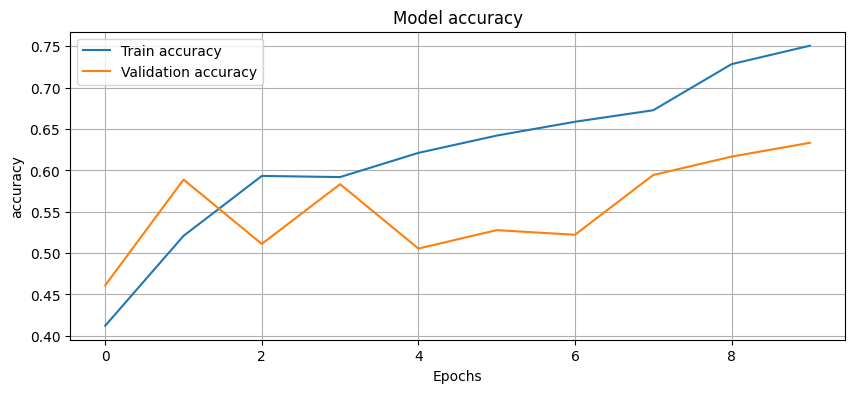

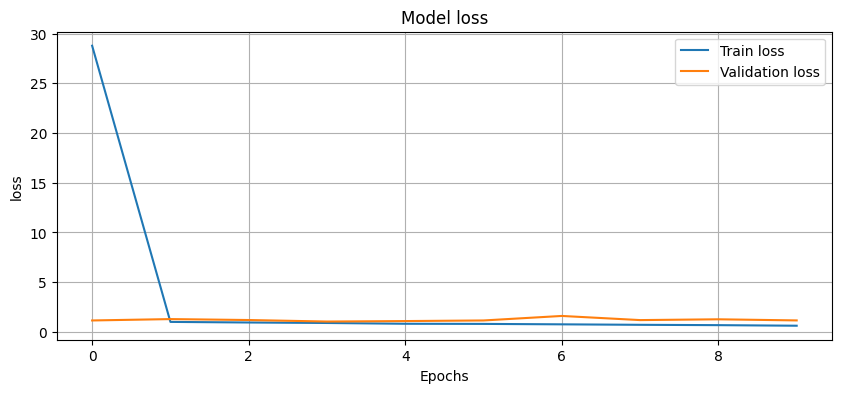

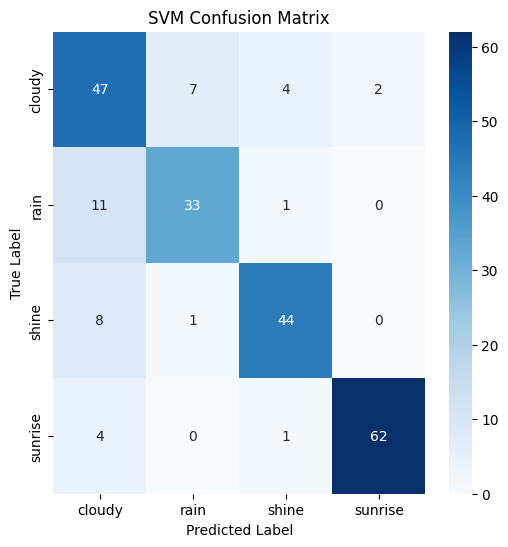

8/8 [==============================] - 1s 65ms/step


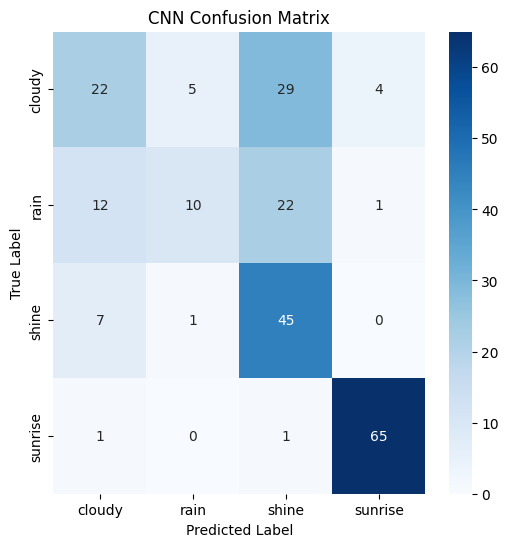

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.64      0.78      0.71        60
        rain       0.79      0.67      0.72        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 260ms/step - loss: 20.7698 - accuracy: 0.5279 - val_loss: 1.3553 - val_accuracy: 0.7333
Epoch 2/10
23/23 [==============================] - 9s 404ms/step - loss: 0.6197 - accuracy: 0.7925 - val_loss: 1.0052 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 13s 552ms/step - loss: 0.5594 - accuracy: 0.8175 - val_loss: 1.2740 - val_accuracy: 0.6667
Epoch 4/10
23/23 [==============================] - 6s 249ms/step - loss: 0.5154 - accuracy: 0.8148 - va

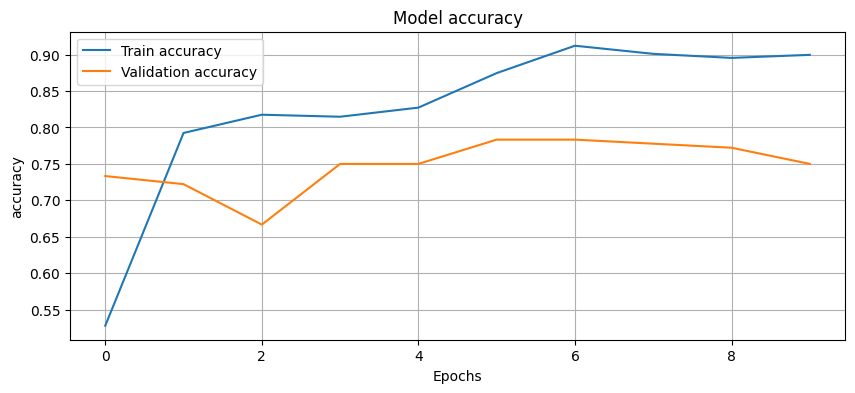

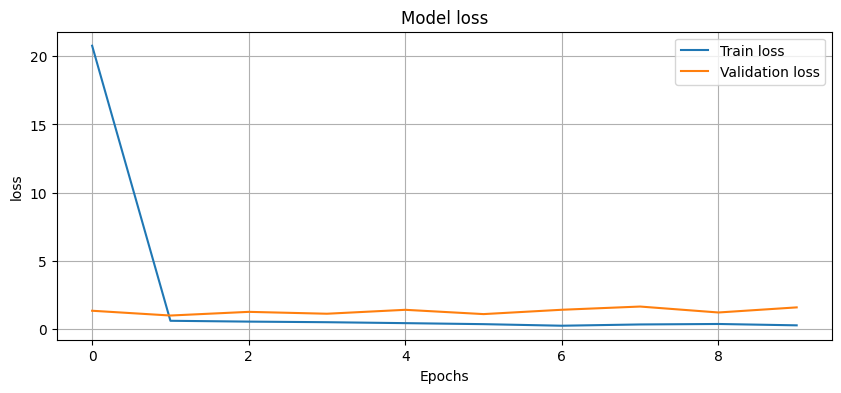

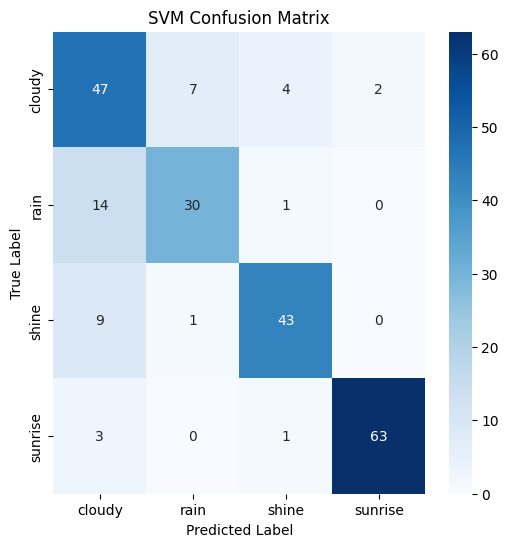

8/8 [==============================] - 1s 97ms/step


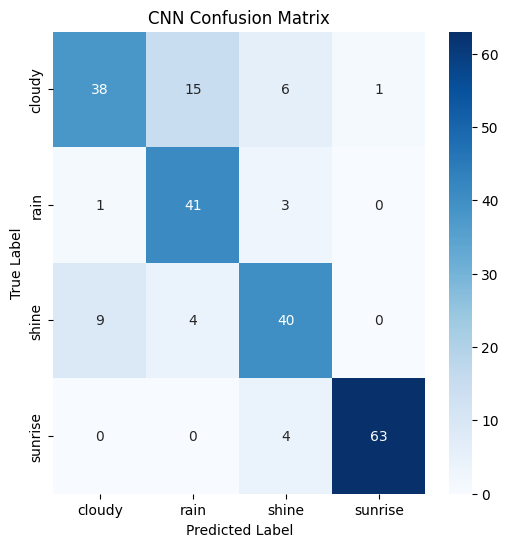

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 9s 355ms/step - loss: 17.7035 - accuracy: 0.4666 - val_loss: 1.0706 - val_accuracy: 0.4722
Epoch 2/10
23/23 [==============================] - 6s 265ms/step - loss: 0.8750 - accuracy: 0.6226 - val_loss: 0.8729 - val_accuracy: 0.7278
Epoch 3/10
23/23 [==============================] - 8s 334ms/step - loss: 1.0491 - accuracy: 0.6922 - val_loss: 1.1272 - val_accuracy: 0.6000
Epoch 4/10
23/23 [==============================] - 6s 268ms/step - loss: 0.8639 - accuracy: 0.6685 - val

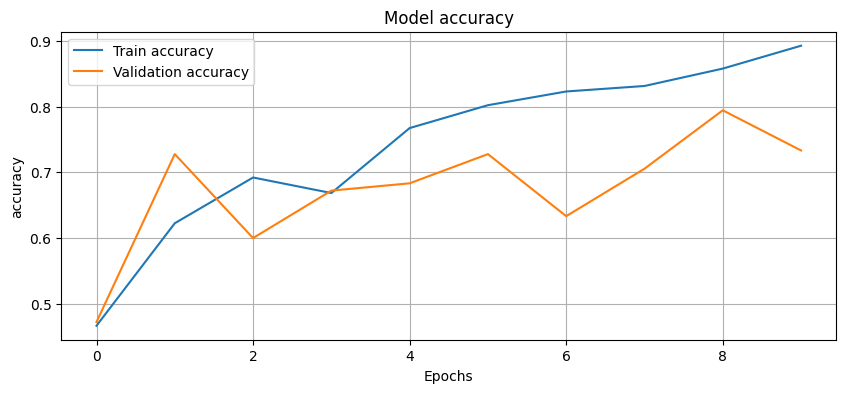

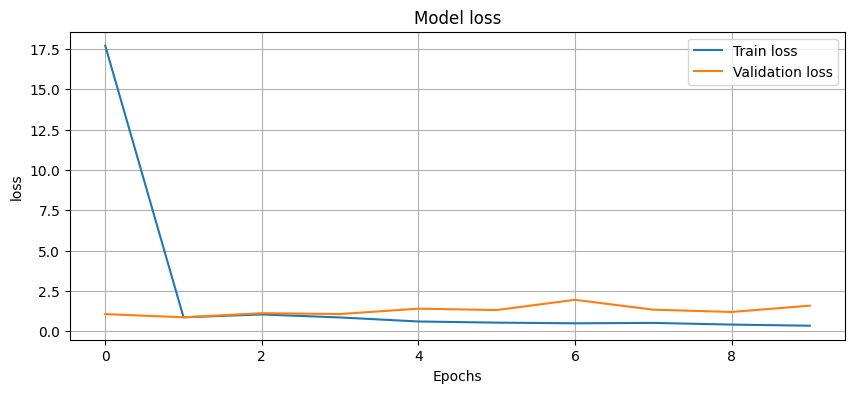

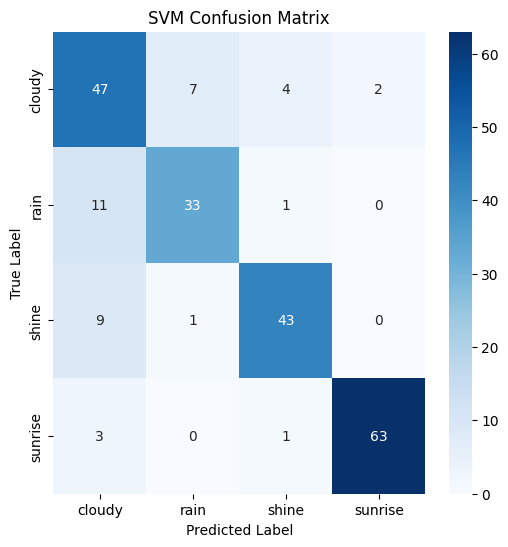

8/8 [==============================] - 1s 68ms/step


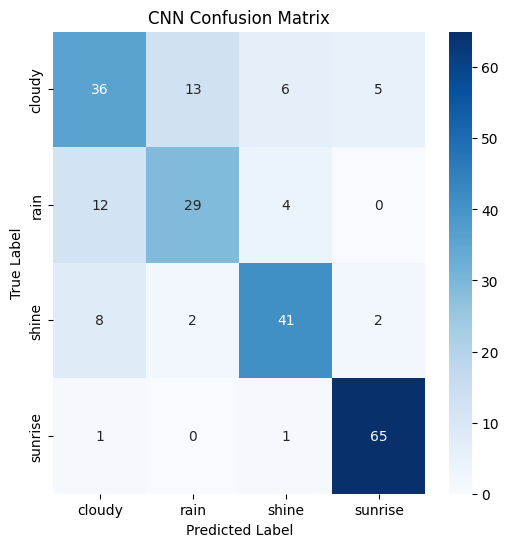

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 9s 355ms/step - loss: 34.1805 - accuracy: 0.4401 - val_loss: 1.0347 - val_accuracy: 0.5556
Epoch 2/10
23/23 [==============================] - 6s 273ms/step - loss: 0.8681 - accuracy: 0.6393 - val_loss: 1.4347 - val_accuracy: 0.6167
Epoch 3/10
23/23 [==============================] - 8s 330ms/step - loss: 0.6845 - accuracy: 0.7437 - val_loss: 1.0128 - val_accuracy: 0.7000
Epoch 4/10
23/23 [==============================] - 6s 272ms/step - loss: 0.5645 - accuracy: 0.8078 - val

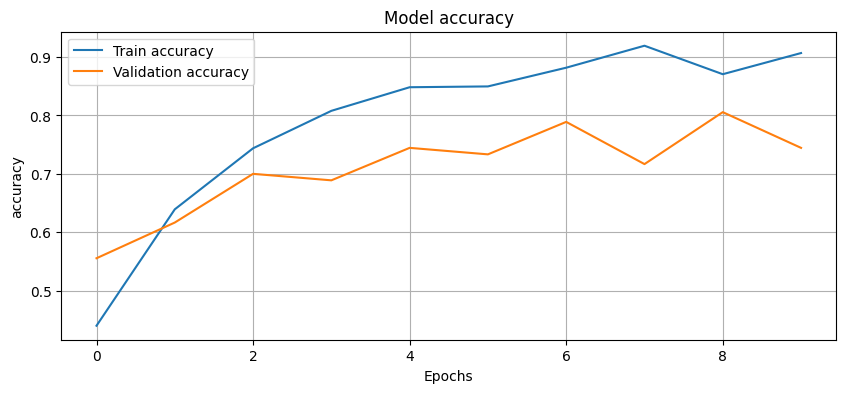

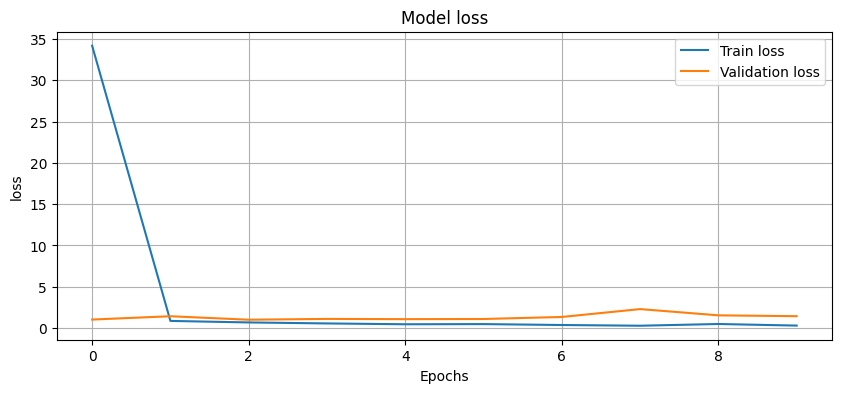

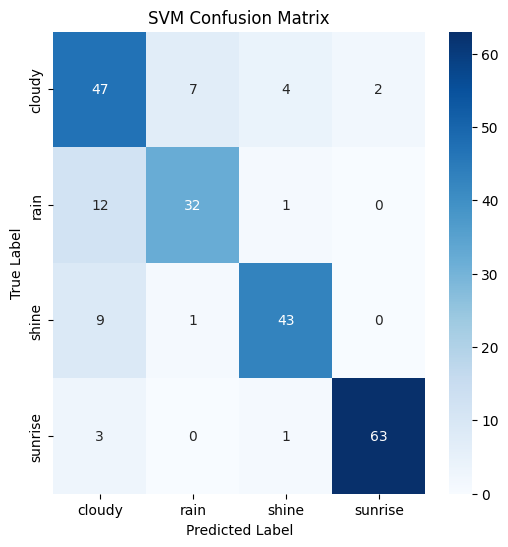

8/8 [==============================] - 1s 69ms/step


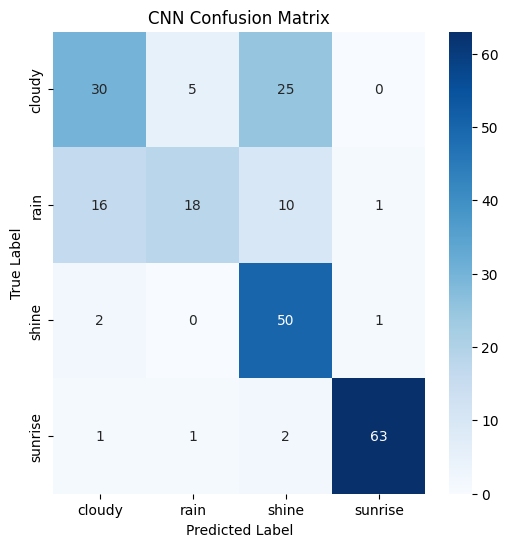

SVM Accuracy: 0.8088888888888889
              precision    recall  f1-score   support

      cloudy       0.64      0.75      0.69        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.80       225
weighted avg       0.82      0.81      0.81       225

Epoch 1/10
23/23 [==============================] - 8s 304ms/step - loss: 12.4582 - accuracy: 0.5334 - val_loss: 1.4085 - val_accuracy: 0.7500
Epoch 2/10
23/23 [==============================] - 8s 368ms/step - loss: 0.6691 - accuracy: 0.7507 - val_loss: 1.5794 - val_accuracy: 0.8389
Epoch 3/10
23/23 [==============================] - 7s 291ms/step - loss: 0.4746 - accuracy: 0.8315 - val_loss: 1.2335 - val_accuracy: 0.8167
Epoch 4/10
23/23 [==============================] - 8s 353ms/step - loss: 0.4194 - accuracy: 0.8565 - val

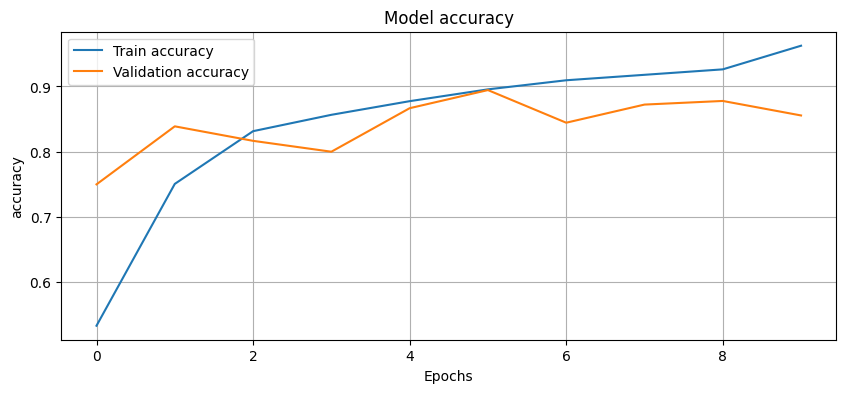

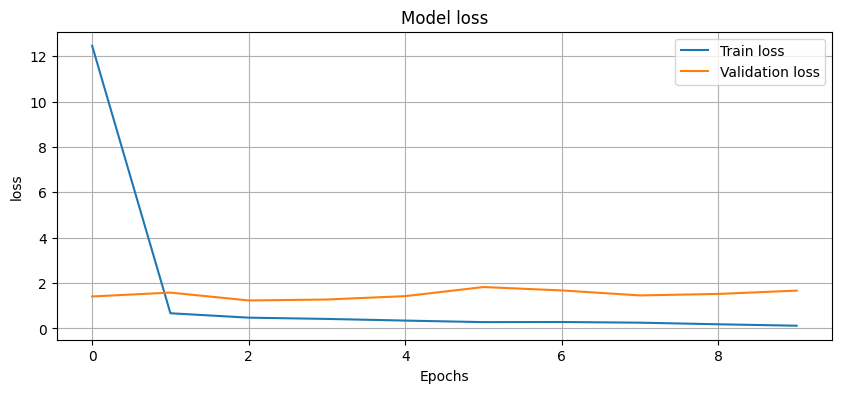

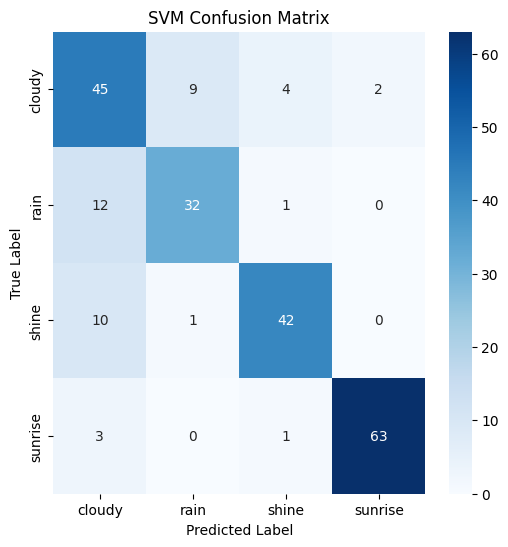

8/8 [==============================] - 1s 72ms/step


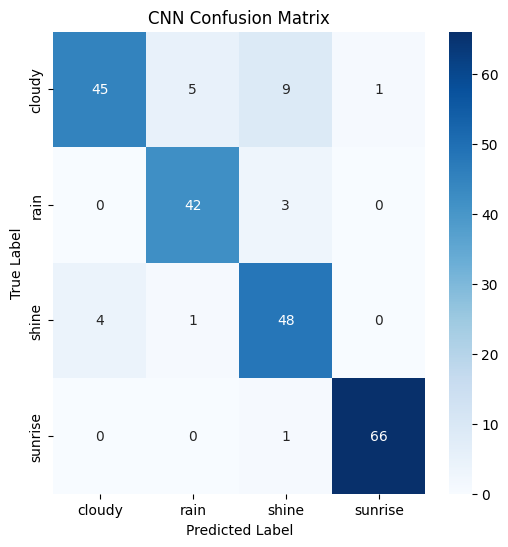

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 307ms/step - loss: 32.6846 - accuracy: 0.4415 - val_loss: 1.8959 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 9s 376ms/step - loss: 0.8005 - accuracy: 0.6560 - val_loss: 0.9795 - val_accuracy: 0.8111
Epoch 3/10
23/23 [==============================] - 7s 288ms/step - loss: 0.6369 - accuracy: 0.7535 - val_loss: 1.4552 - val_accuracy: 0.6556
Epoch 4/10
23/23 [==============================] - 9s 369ms/step - loss: 0.6475 - accuracy: 0.7019 - val

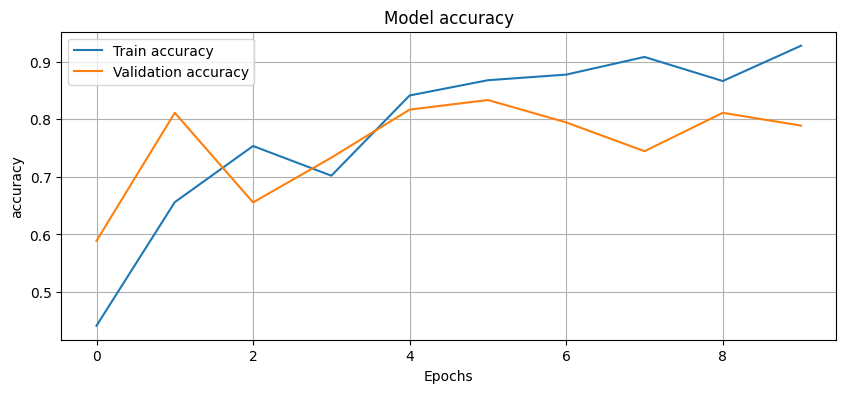

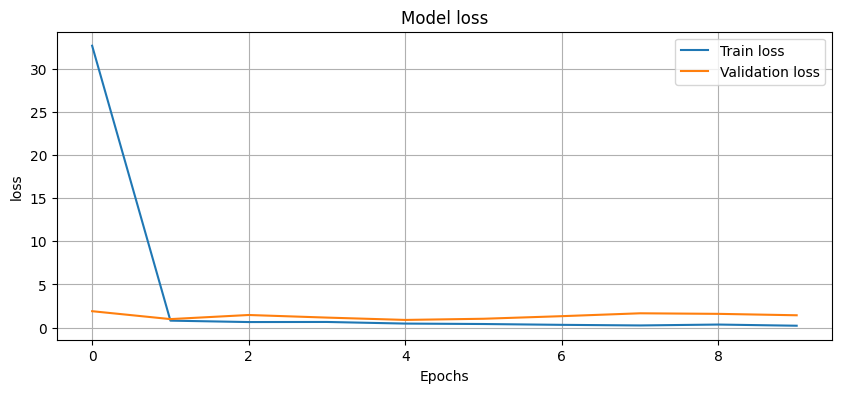

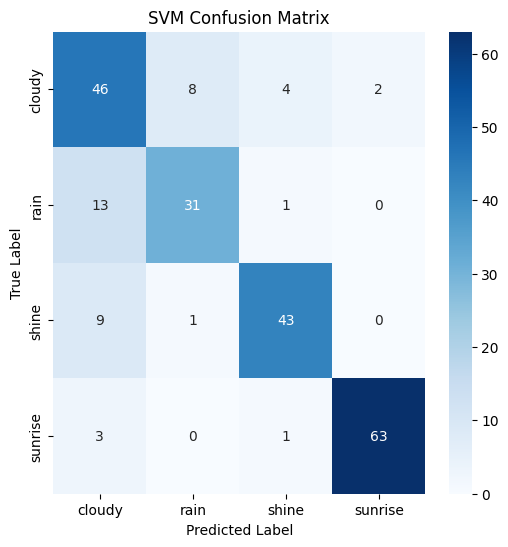

8/8 [==============================] - 1s 77ms/step


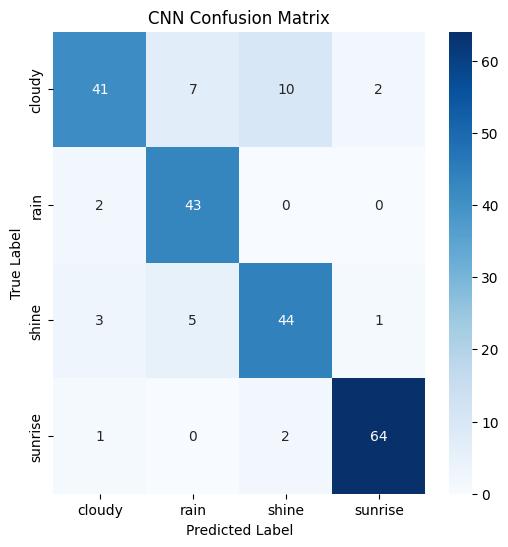

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 9s 308ms/step - loss: 21.3290 - accuracy: 0.5446 - val_loss: 1.0968 - val_accuracy: 0.6333
Epoch 2/10
23/23 [==============================] - 9s 384ms/step - loss: 0.7610 - accuracy: 0.6866 - val_loss: 1.7176 - val_accuracy: 0.6111
Epoch 3/10
23/23 [==============================] - 7s 297ms/step - loss: 0.7405 - accuracy: 0.6908 - val_loss: 1.3401 - val_accuracy: 0.7778
Epoch 4/10
23/23 [==============================] - 9s 381ms/step - loss: 0.6271 - accuracy: 0.7535 - val

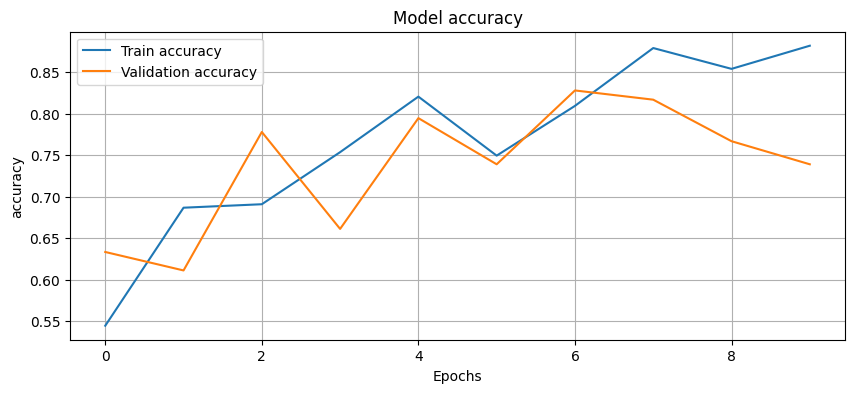

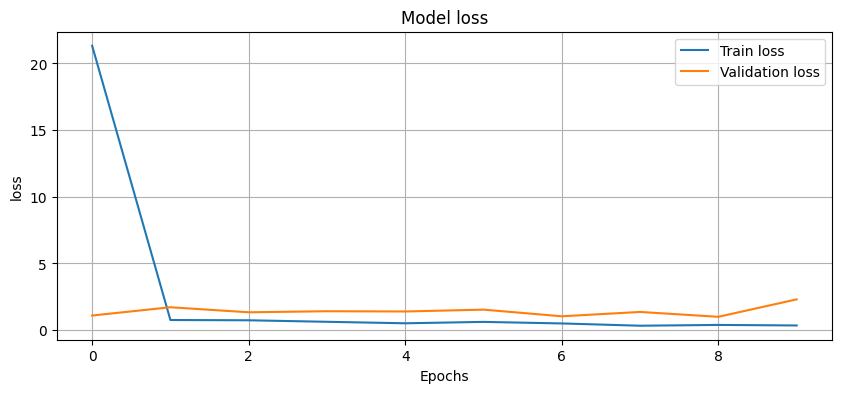

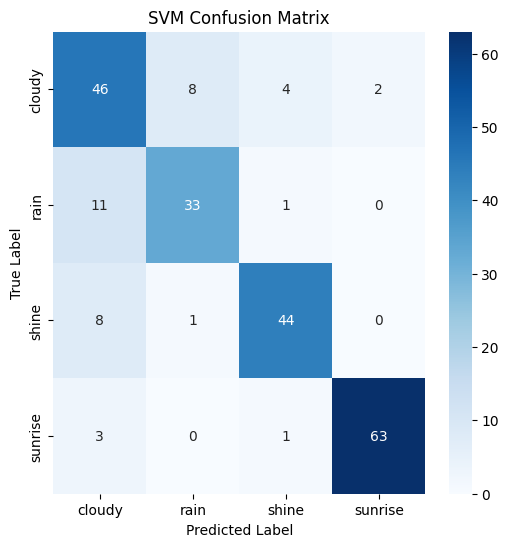

8/8 [==============================] - 1s 76ms/step


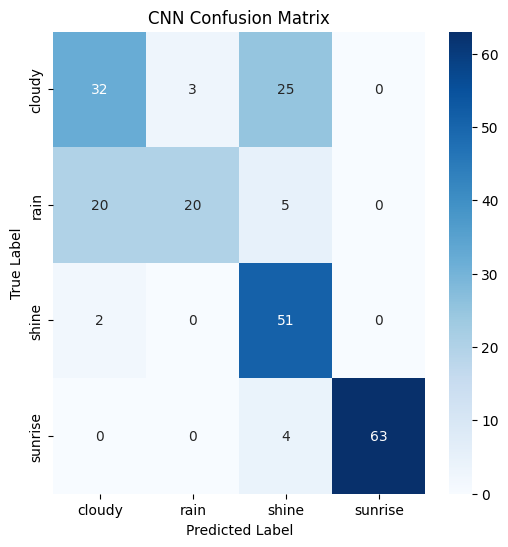

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 396ms/step - loss: 32.1001 - accuracy: 0.4610 - val_loss: 0.9515 - val_accuracy: 0.5833
Epoch 2/10
23/23 [==============================] - 7s 304ms/step - loss: 0.7394 - accuracy: 0.6755 - val_loss: 1.1353 - val_accuracy: 0.6667
Epoch 3/10
23/23 [==============================] - 9s 376ms/step - loss: 0.7033 - accuracy: 0.7799 - val_loss: 1.0172 - val_accuracy: 0.6778
Epoch 4/10
23/23 [==============================] - 7s 296ms/step - loss: 0.6296 - accuracy: 0.7688 - va

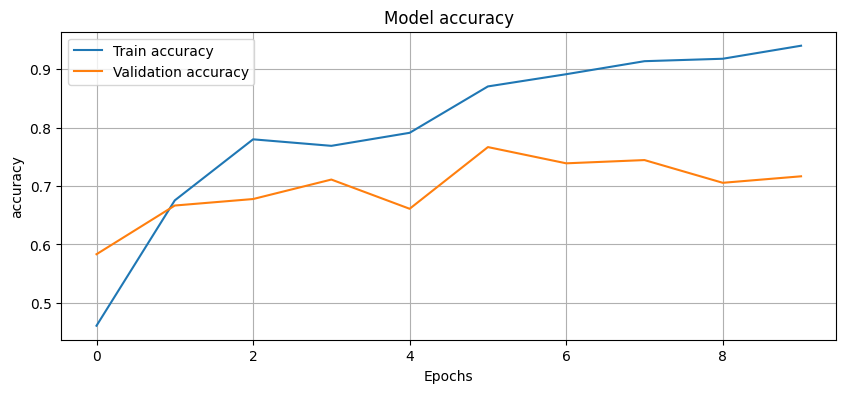

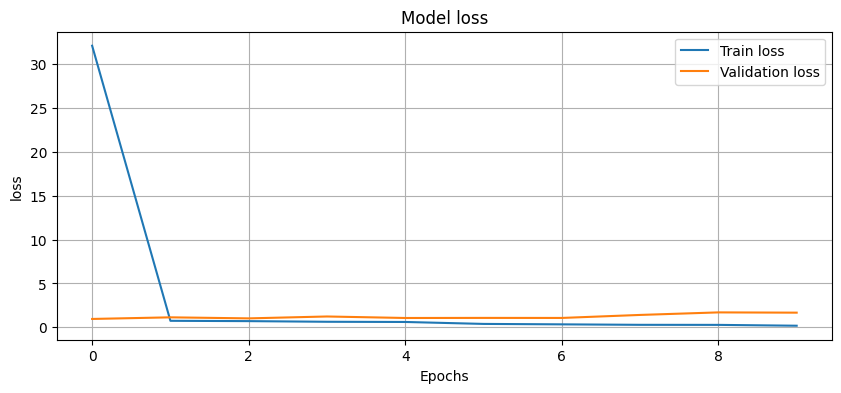

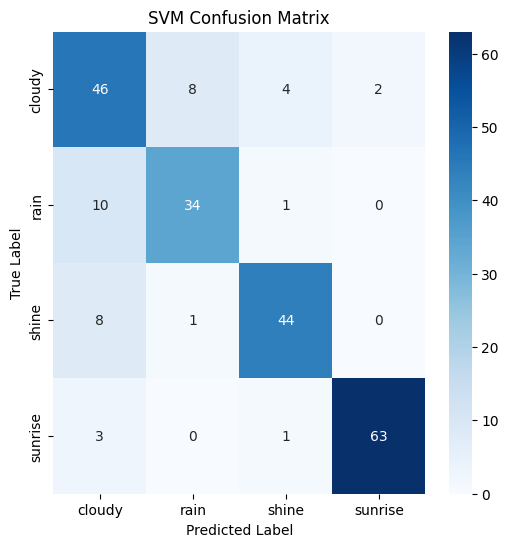

8/8 [==============================] - 1s 78ms/step


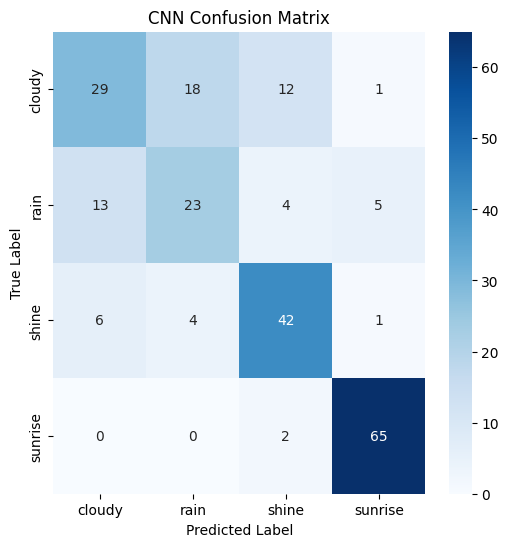

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 9s 337ms/step - loss: 42.0539 - accuracy: 0.4178 - val_loss: 1.1309 - val_accuracy: 0.5000
Epoch 2/10
23/23 [==============================] - 9s 393ms/step - loss: 0.9787 - accuracy: 0.5515 - val_loss: 1.1128 - val_accuracy: 0.6556
Epoch 3/10
23/23 [==============================] - 10s 419ms/step - loss: 0.8154 - accuracy: 0.7103 - val_loss: 1.4137 - val_accuracy: 0.5111
Epoch 4/10
23/23 [==============================] - 8s 335ms/step - loss: 0.8313 - accuracy: 0.6379 - va

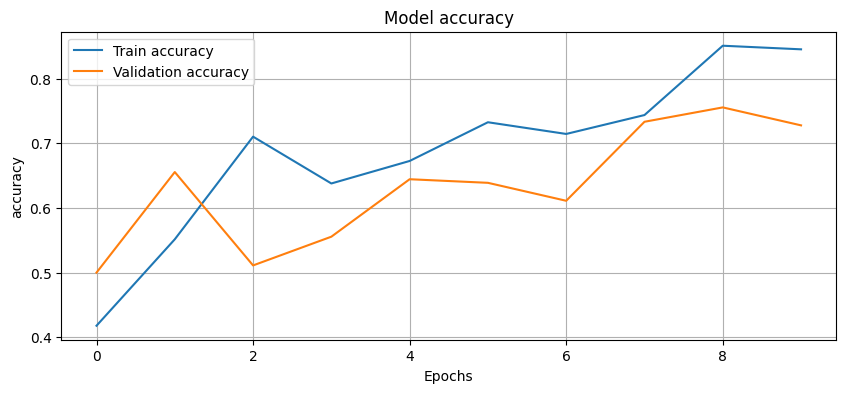

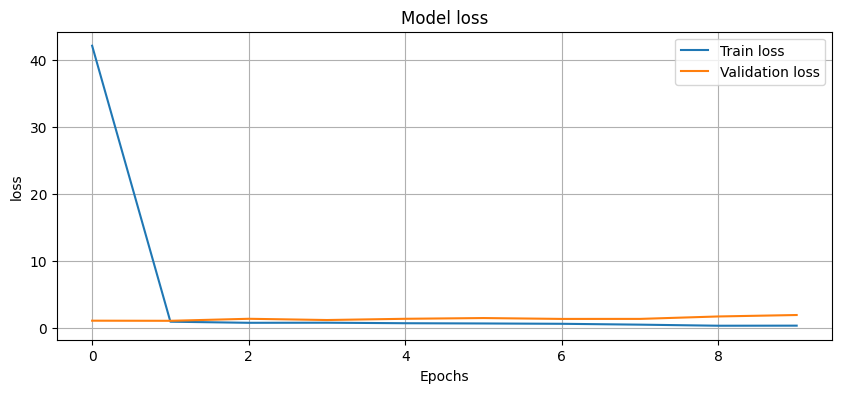

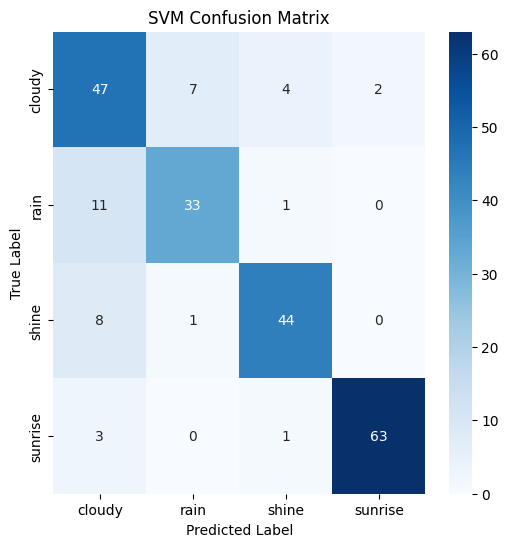

8/8 [==============================] - 1s 84ms/step


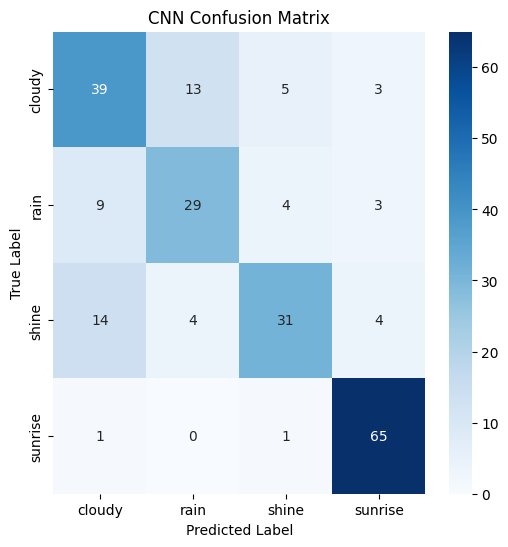

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 429ms/step - loss: 49.0195 - accuracy: 0.4123 - val_loss: 0.8942 - val_accuracy: 0.5778
Epoch 2/10
23/23 [==============================] - 7s 311ms/step - loss: 0.7578 - accuracy: 0.6699 - val_loss: 1.2566 - val_accuracy: 0.6000
Epoch 3/10
23/23 [==============================] - 9s 410ms/step - loss: 0.6936 - accuracy: 0.7117 - val_loss: 0.9386 - val_accuracy: 0.7167
Epoch 4/10
23/23 [==============================] - 8s 327ms/step - loss: 0.5181 - accuracy: 0.7869 - va

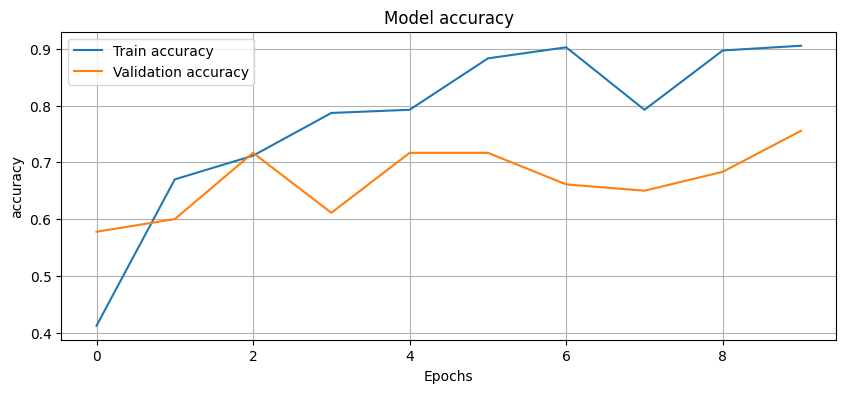

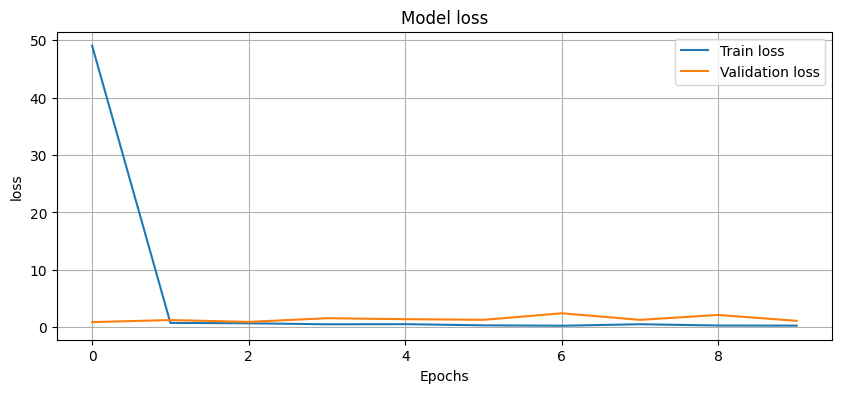

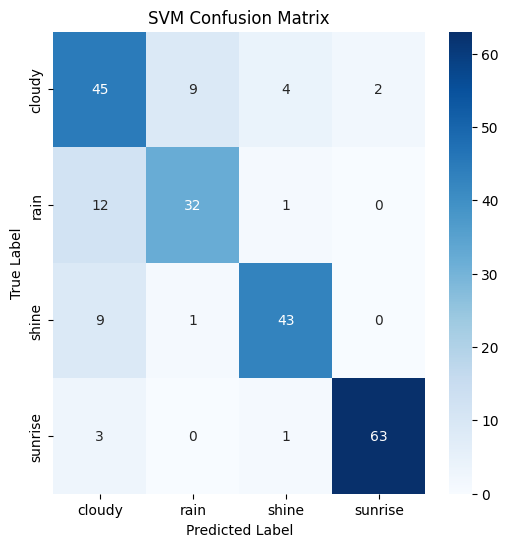

8/8 [==============================] - 1s 85ms/step


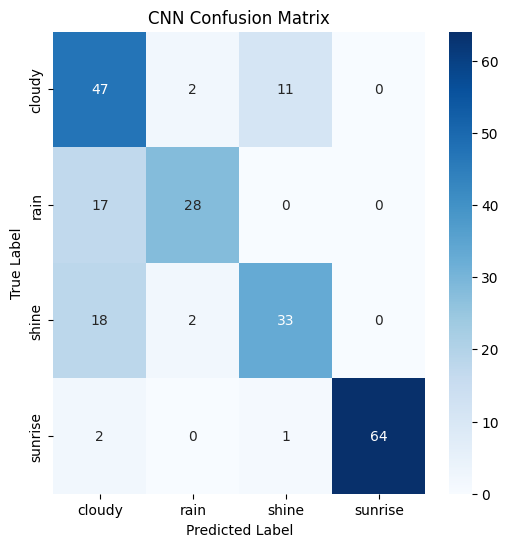

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 419ms/step - loss: 45.7531 - accuracy: 0.3955 - val_loss: 0.7788 - val_accuracy: 0.6444
Epoch 2/10
23/23 [==============================] - 8s 346ms/step - loss: 0.6202 - accuracy: 0.7535 - val_loss: 0.6882 - val_accuracy: 0.8056
Epoch 3/10
23/23 [==============================] - 10s 422ms/step - loss: 0.5348 - accuracy: 0.8022 - val_loss: 0.7898 - val_accuracy: 0.7333
Epoch 4/10
23/23 [==============================] - 9s 380ms/step - loss: 0.4664 - accuracy: 0.8259 - v

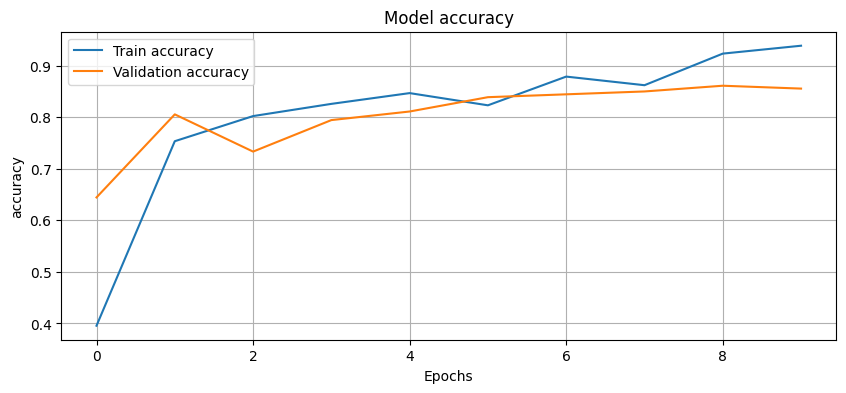

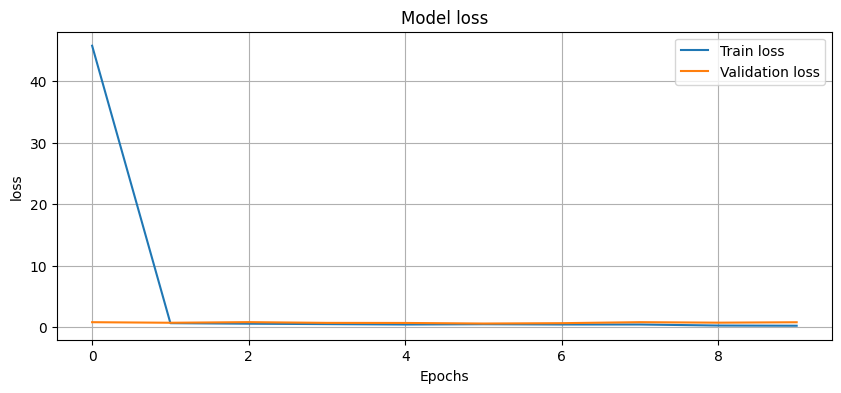

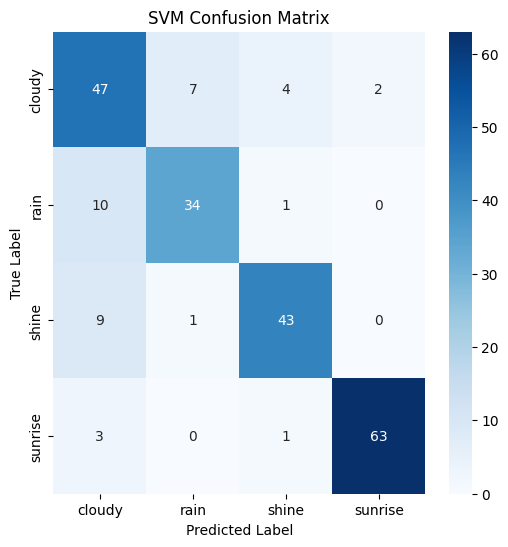

8/8 [==============================] - 1s 124ms/step


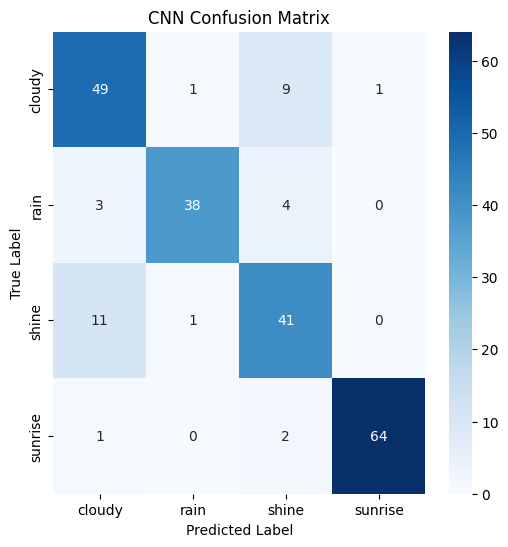

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 10s 392ms/step - loss: 38.2047 - accuracy: 0.5028 - val_loss: 0.9709 - val_accuracy: 0.7222
Epoch 2/10
23/23 [==============================] - 9s 395ms/step - loss: 0.6602 - accuracy: 0.7827 - val_loss: 1.3033 - val_accuracy: 0.7278
Epoch 3/10
23/23 [==============================] - 10s 429ms/step - loss: 0.4848 - accuracy: 0.7981 - val_loss: 1.1267 - val_accuracy: 0.7556
Epoch 4/10
23/23 [==============================] - 8s 347ms/step - loss: 0.5205 - accuracy: 0.8329 - v

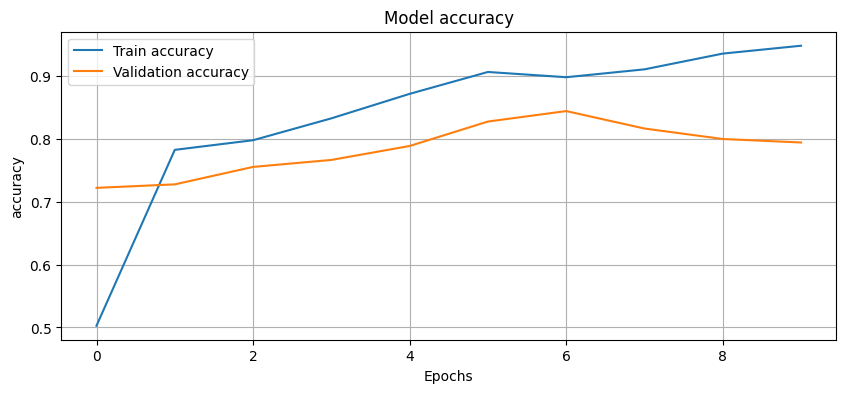

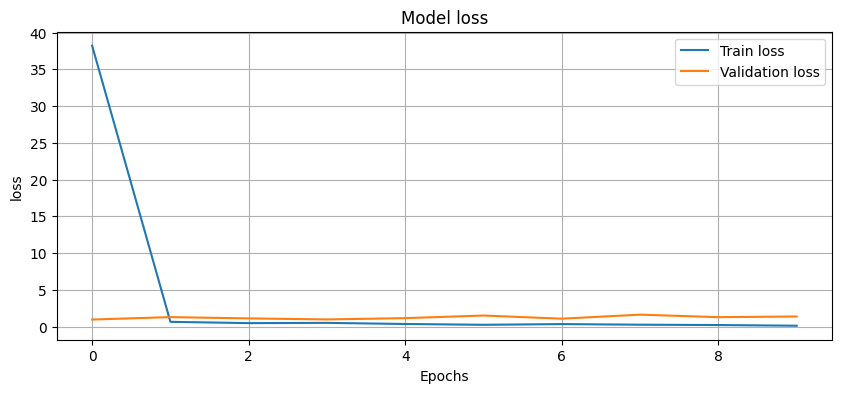

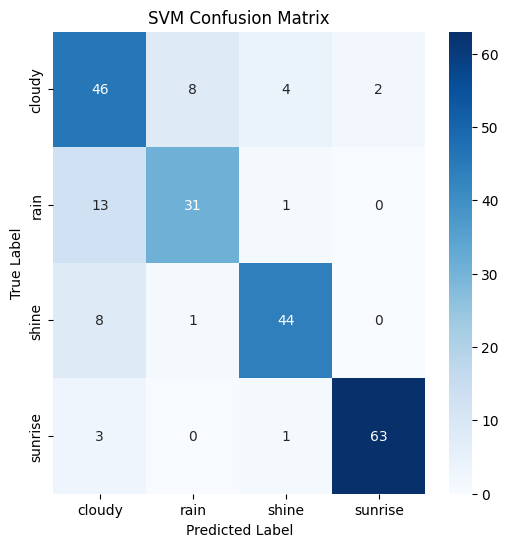

8/8 [==============================] - 1s 94ms/step


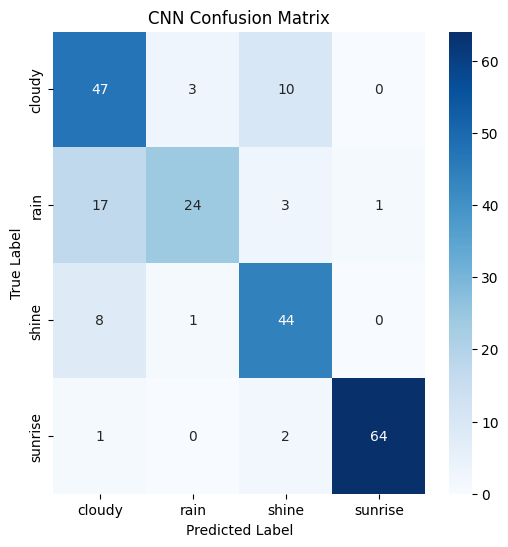

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 425ms/step - loss: 16.4222 - accuracy: 0.5989 - val_loss: 1.3479 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 10s 433ms/step - loss: 0.6205 - accuracy: 0.7911 - val_loss: 1.3659 - val_accuracy: 0.7889
Epoch 3/10
23/23 [==============================] - 8s 353ms/step - loss: 0.4165 - accuracy: 0.8635 - val_loss: 0.8678 - val_accuracy: 0.8333
Epoch 4/10
23/23 [==============================] - 10s 438ms/step - loss: 0.3742 - accuracy: 0.8593 - 

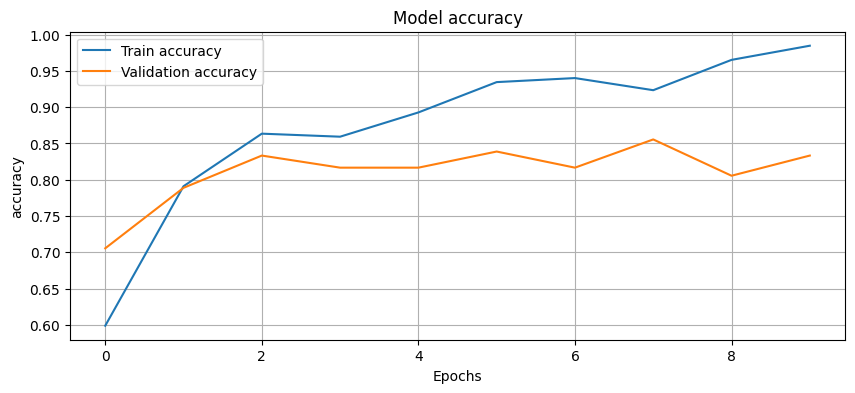

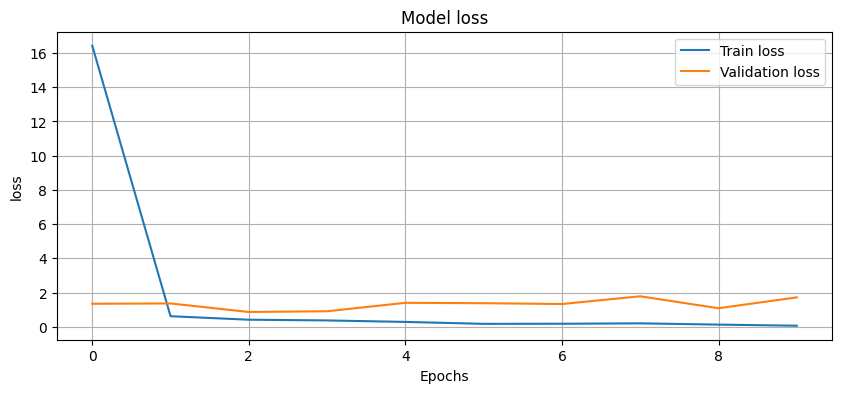

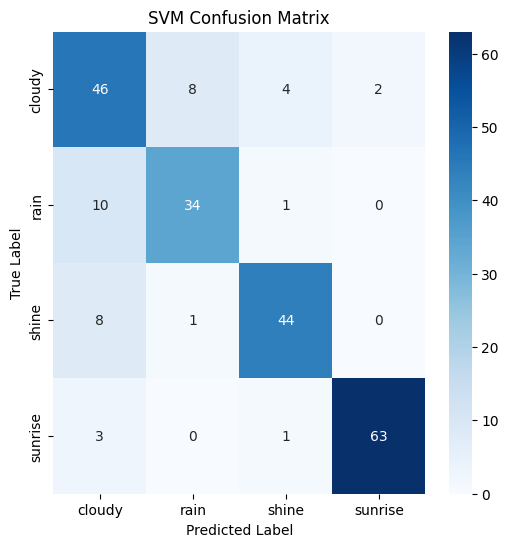

8/8 [==============================] - 1s 92ms/step


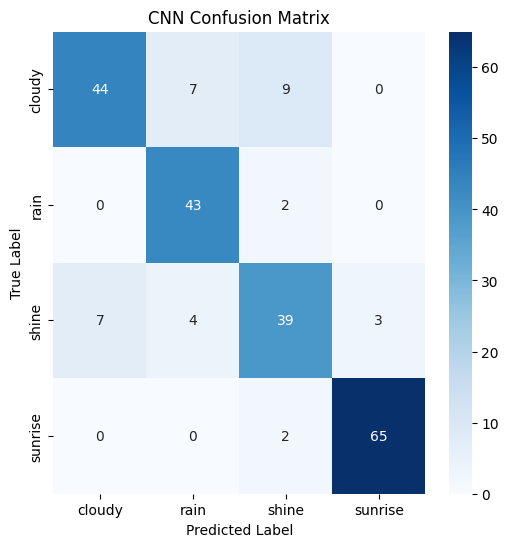

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 459ms/step - loss: 30.4203 - accuracy: 0.4499 - val_loss: 0.9293 - val_accuracy: 0.5667
Epoch 2/10
23/23 [==============================] - 8s 362ms/step - loss: 0.8447 - accuracy: 0.6253 - val_loss: 1.1265 - val_accuracy: 0.7333
Epoch 3/10
23/23 [==============================] - 10s 431ms/step - loss: 0.7346 - accuracy: 0.7228 - val_loss: 0.8297 - val_accuracy: 0.7444
Epoch 4/10
23/23 [==============================] - 10s 439ms/step - loss: 0.6693 - accuracy: 0.7716 - 

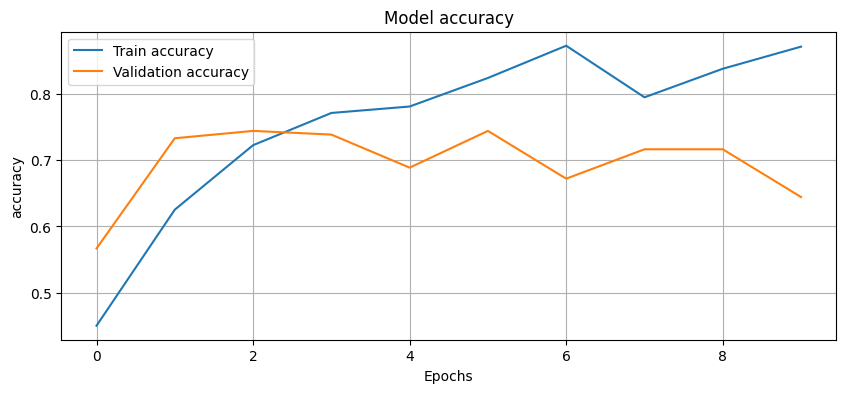

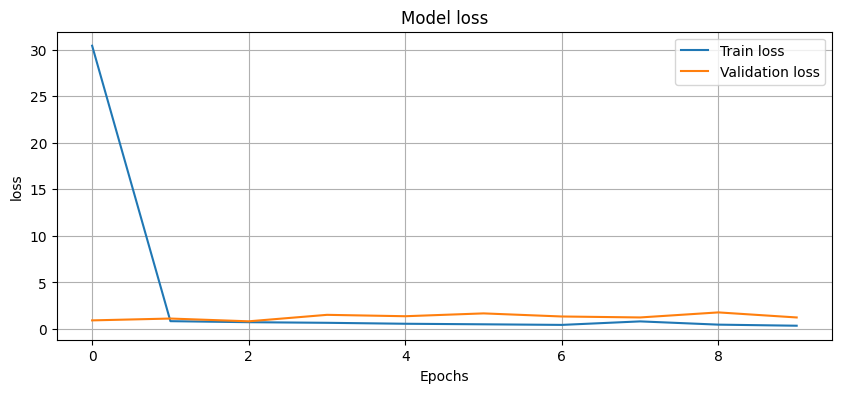

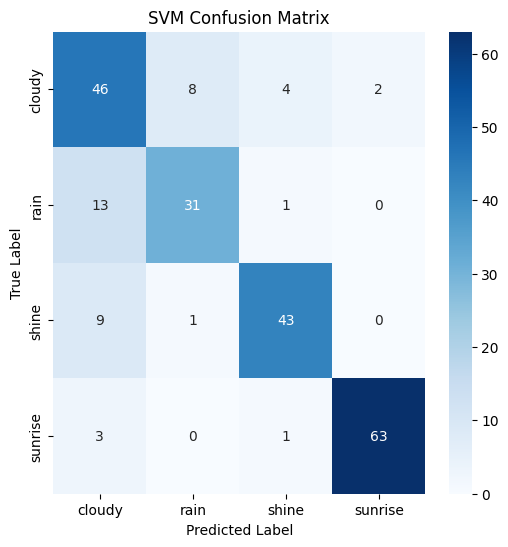

8/8 [==============================] - 1s 136ms/step


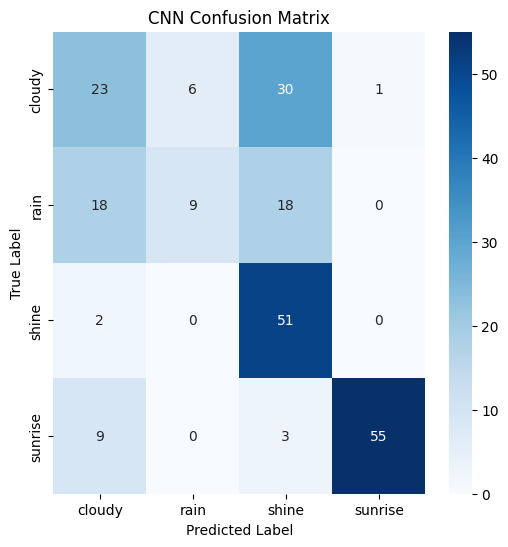

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 375ms/step - loss: 38.6302 - accuracy: 0.4666 - val_loss: 1.1100 - val_accuracy: 0.5667
Epoch 2/10
23/23 [==============================] - 10s 427ms/step - loss: 0.9644 - accuracy: 0.5543 - val_loss: 1.2942 - val_accuracy: 0.5444
Epoch 3/10
23/23 [==============================] - 10s 444ms/step - loss: 0.8313 - accuracy: 0.5989 - val_loss: 1.3851 - val_accuracy: 0.6000
Epoch 4/10
23/23 [==============================] - 8s 360ms/step - loss: 0.6943 - accuracy: 0.7382 - 

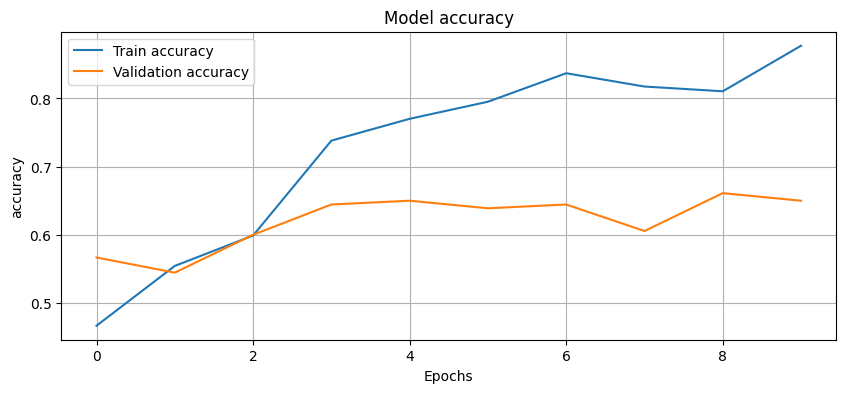

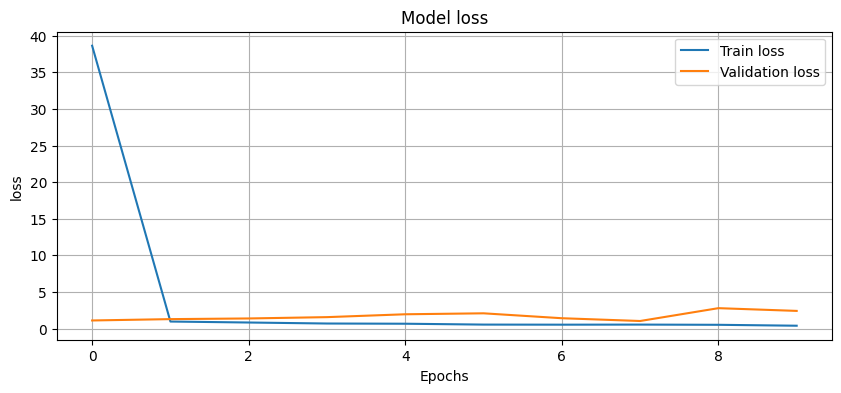

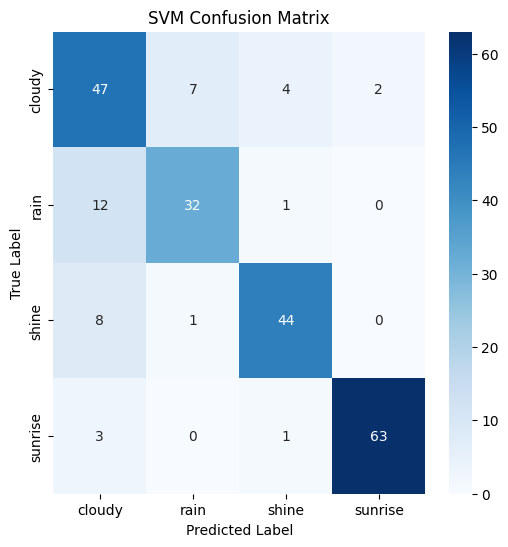

8/8 [==============================] - 1s 95ms/step


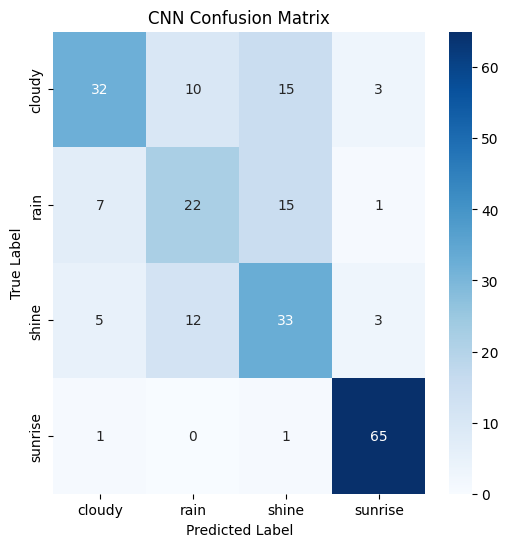

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 407ms/step - loss: 54.0997 - accuracy: 0.4164 - val_loss: 2.5996 - val_accuracy: 0.4056
Epoch 2/10
23/23 [==============================] - 10s 460ms/step - loss: 1.0197 - accuracy: 0.6657 - val_loss: 0.7829 - val_accuracy: 0.7833
Epoch 3/10
23/23 [==============================] - 9s 401ms/step - loss: 0.7255 - accuracy: 0.7437 - val_loss: 0.9439 - val_accuracy: 0.7667
Epoch 4/10
23/23 [==============================] - 10s 411ms/step - loss: 0.6146 - accuracy: 0.7841 - 

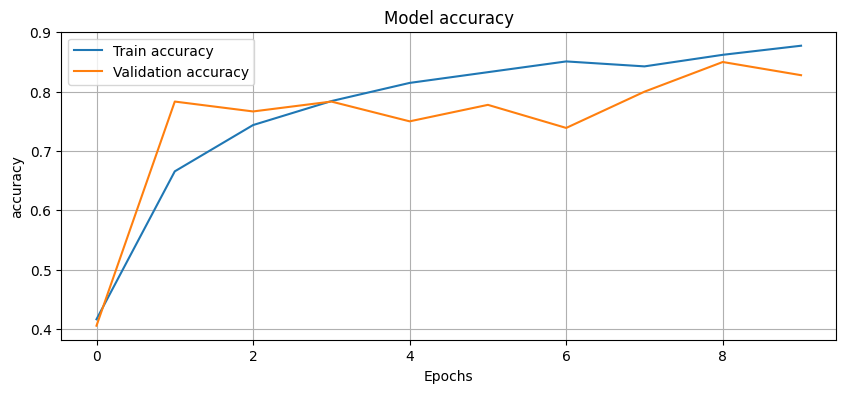

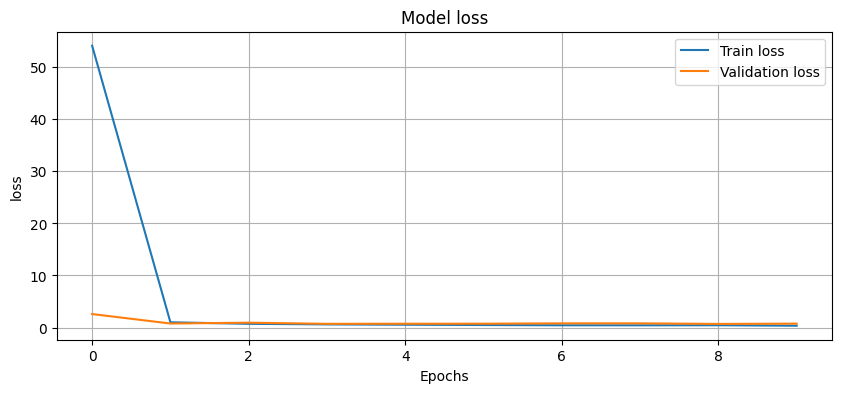

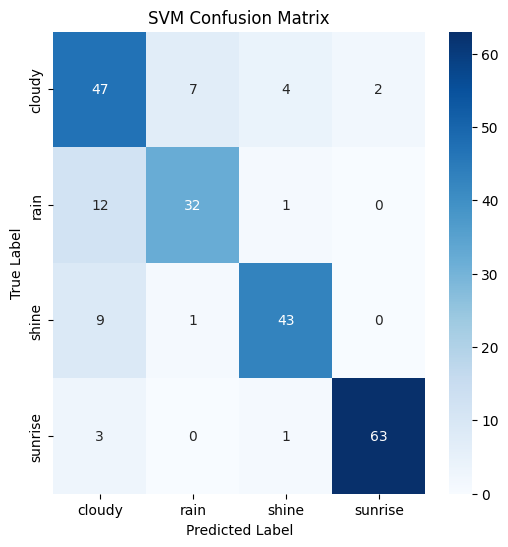

8/8 [==============================] - 1s 98ms/step


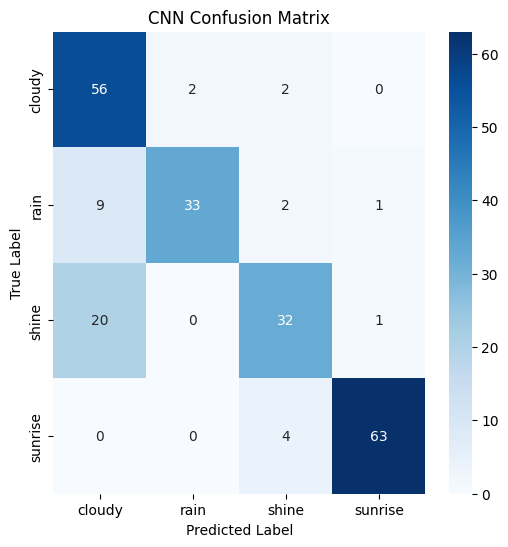

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 12s 475ms/step - loss: 28.2990 - accuracy: 0.4540 - val_loss: 0.9959 - val_accuracy: 0.6000
Epoch 2/10
23/23 [==============================] - 10s 454ms/step - loss: 0.9020 - accuracy: 0.5891 - val_loss: 1.1143 - val_accuracy: 0.6389
Epoch 3/10
23/23 [==============================] - 9s 390ms/step - loss: 0.7495 - accuracy: 0.6671 - val_loss: 1.4307 - val_accuracy: 0.6833
Epoch 4/10
23/23 [==============================] - 11s 463ms/step - loss: 0.5793 - accuracy: 0.7730 - 

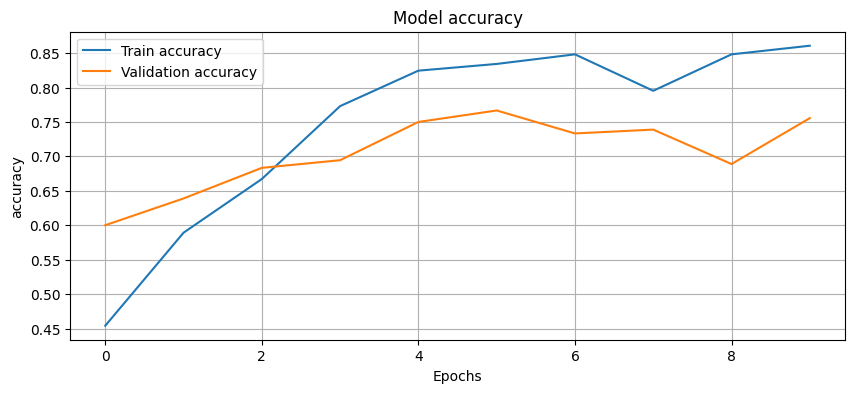

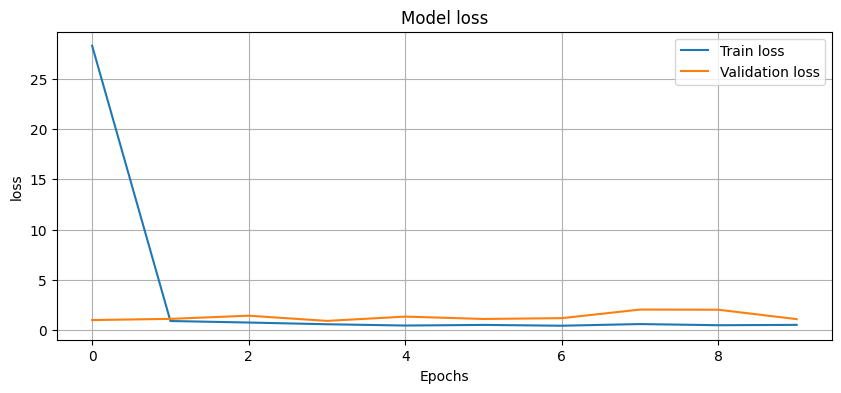

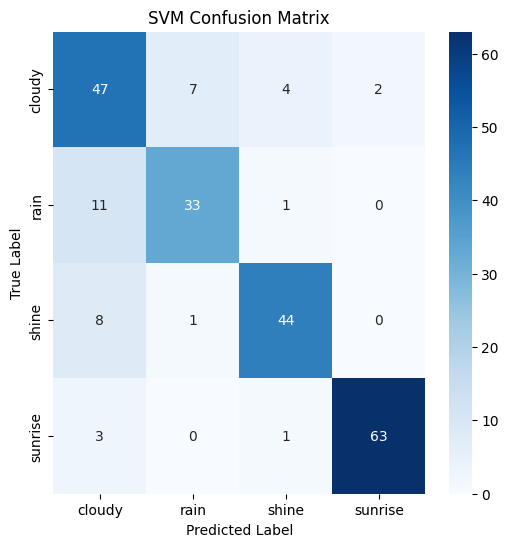

8/8 [==============================] - 1s 136ms/step


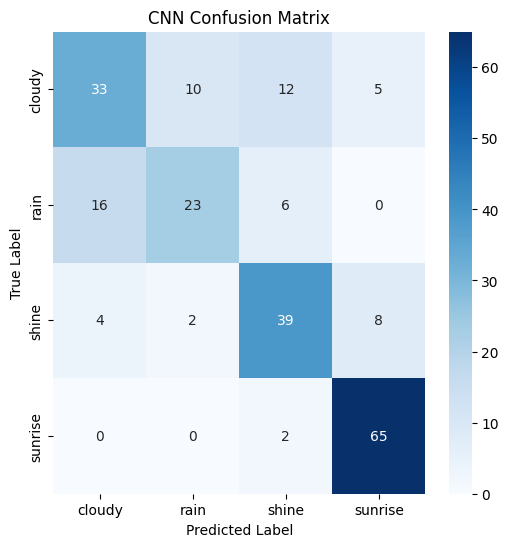

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.69      0.72        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 442ms/step - loss: 30.5867 - accuracy: 0.5334 - val_loss: 1.0348 - val_accuracy: 0.7278
Epoch 2/10
23/23 [==============================] - 10s 438ms/step - loss: 0.7125 - accuracy: 0.7591 - val_loss: 0.9468 - val_accuracy: 0.7611
Epoch 3/10
23/23 [==============================] - 11s 483ms/step - loss: 0.6296 - accuracy: 0.7716 - val_loss: 1.3410 - val_accuracy: 0.7389
Epoch 4/10
23/23 [==============================] - 11s 466ms/step - loss: 0.5768 - accuracy: 0.7646 -

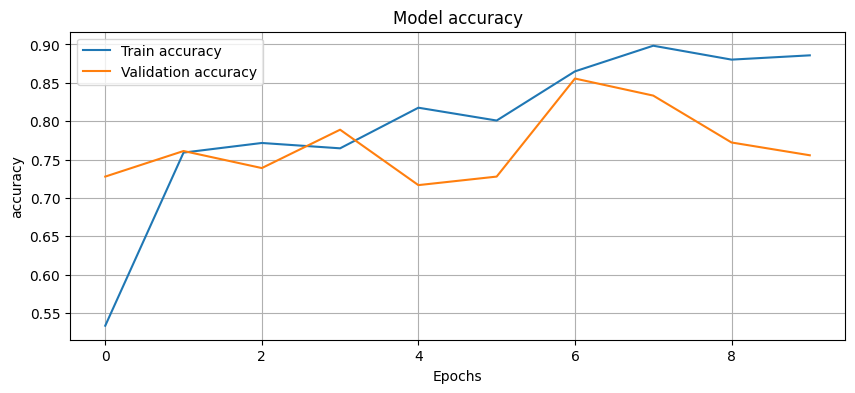

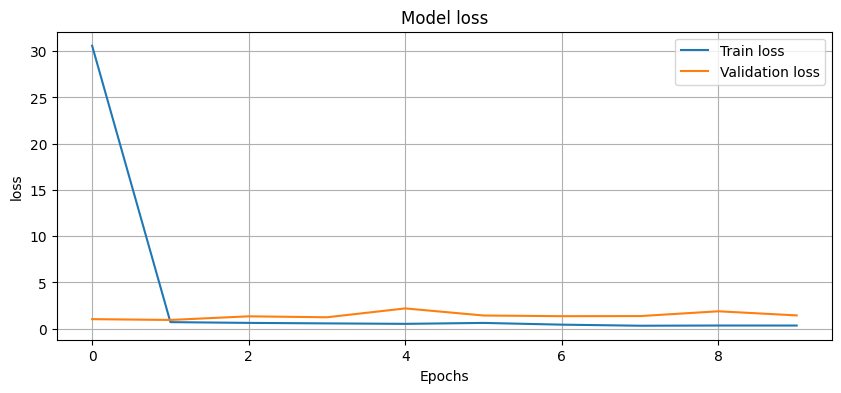

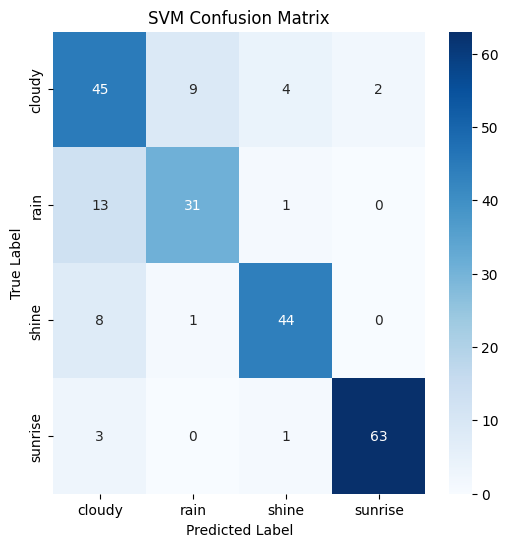

8/8 [==============================] - 1s 105ms/step


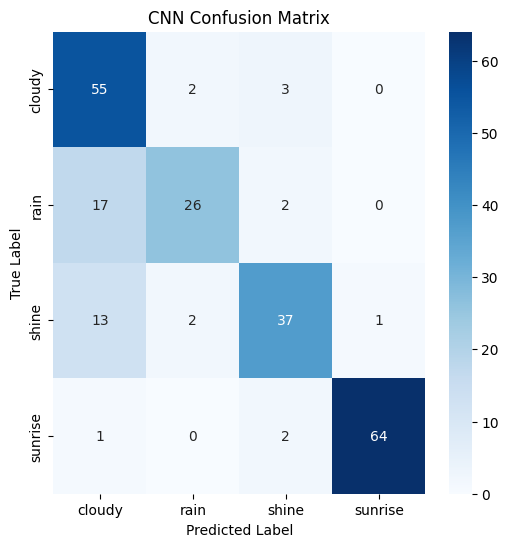

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 12s 493ms/step - loss: 34.7491 - accuracy: 0.5585 - val_loss: 1.0594 - val_accuracy: 0.7556
Epoch 2/10
23/23 [==============================] - 11s 472ms/step - loss: 0.6553 - accuracy: 0.7479 - val_loss: 1.2515 - val_accuracy: 0.7056
Epoch 3/10
23/23 [==============================] - 9s 400ms/step - loss: 0.5839 - accuracy: 0.7994 - val_loss: 0.8970 - val_accuracy: 0.8056
Epoch 4/10
23/23 [==============================] - 11s 466ms/step - loss: 0.9764 - accuracy: 0.7799 - 

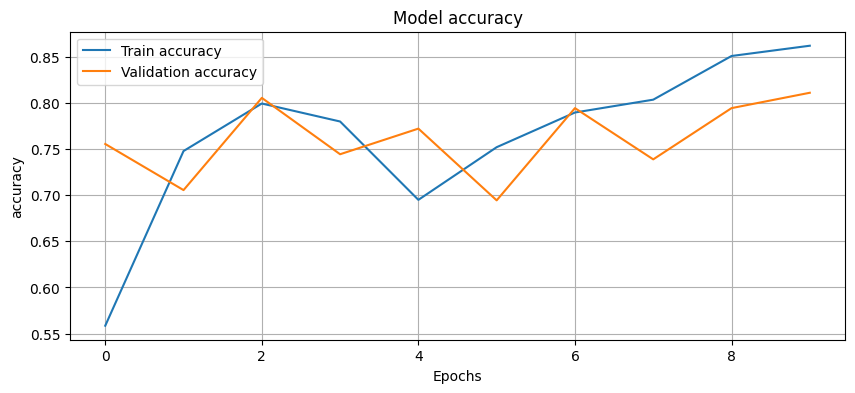

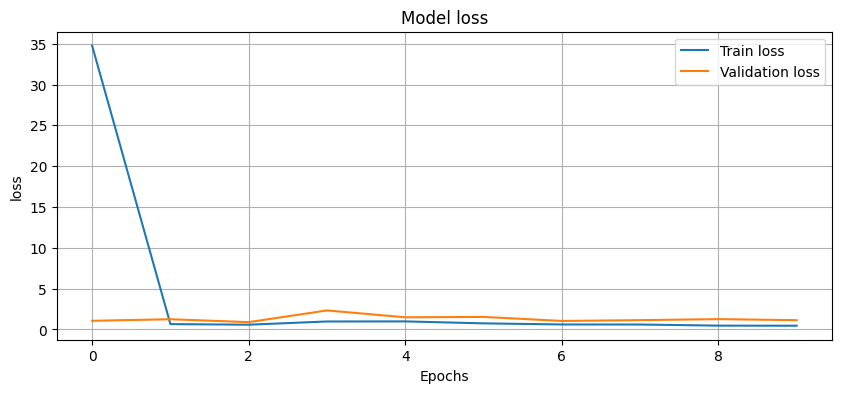

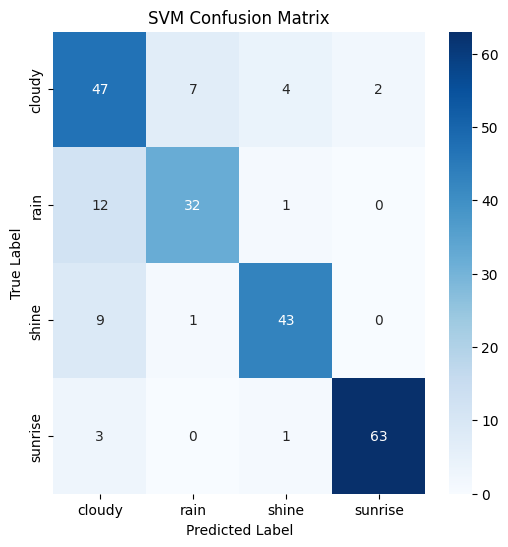

8/8 [==============================] - 1s 172ms/step


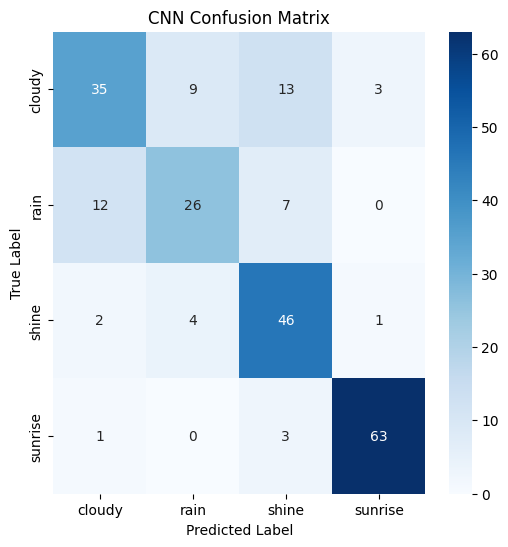

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 13s 517ms/step - loss: 34.4230 - accuracy: 0.4513 - val_loss: 1.5947 - val_accuracy: 0.5556
Epoch 2/10
23/23 [==============================] - 10s 425ms/step - loss: 0.9341 - accuracy: 0.5808 - val_loss: 1.5364 - val_accuracy: 0.5778
Epoch 3/10
23/23 [==============================] - 11s 489ms/step - loss: 0.8050 - accuracy: 0.6532 - val_loss: 1.6608 - val_accuracy: 0.5944
Epoch 4/10
23/23 [==============================] - 12s 506ms/step - loss: 0.6624 - accuracy: 0.7228 -

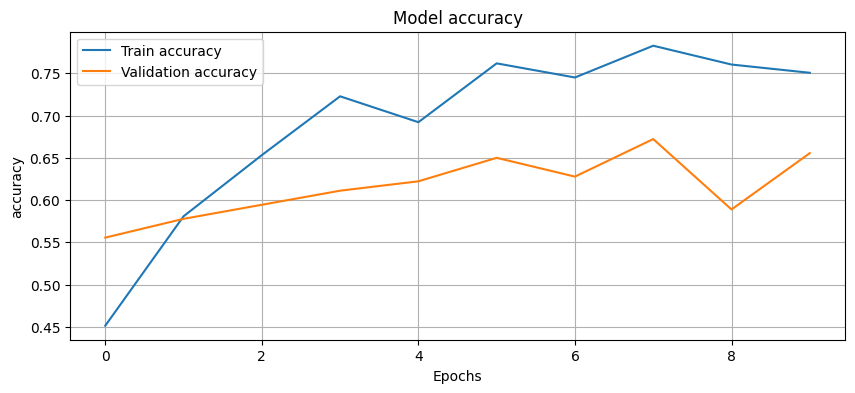

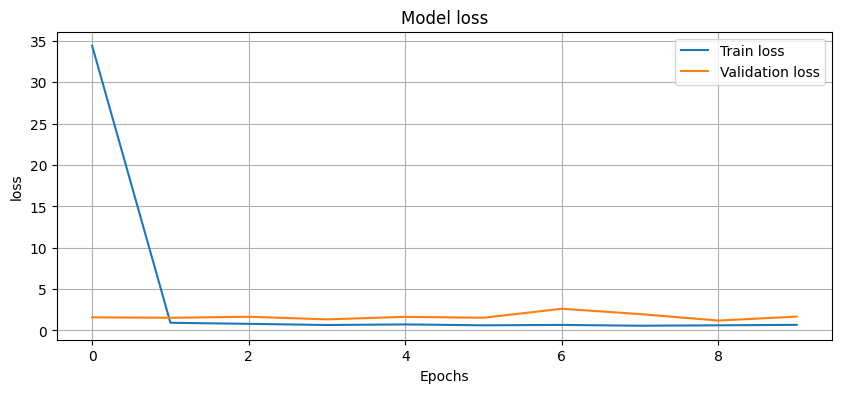

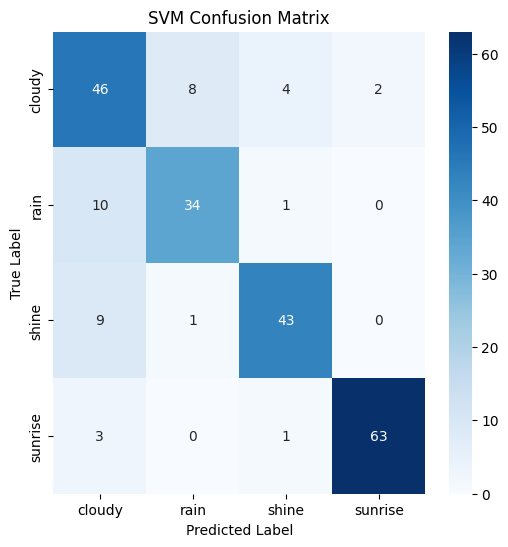

8/8 [==============================] - 1s 124ms/step


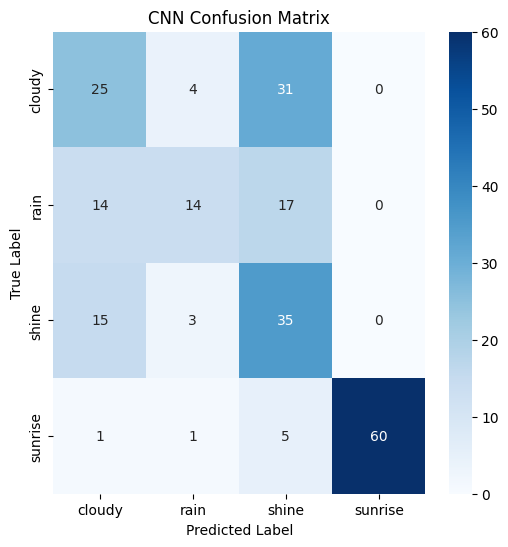

SVM Accuracy: 0.8355555555555556
              precision    recall  f1-score   support

      cloudy       0.69      0.78      0.73        60
        rain       0.81      0.78      0.80        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.84       225
   macro avg       0.84      0.83      0.83       225
weighted avg       0.84      0.84      0.84       225

Epoch 1/10
23/23 [==============================] - 12s 455ms/step - loss: 22.2682 - accuracy: 0.5613 - val_loss: 1.2115 - val_accuracy: 0.6333
Epoch 2/10
23/23 [==============================] - 13s 547ms/step - loss: 0.8171 - accuracy: 0.7089 - val_loss: 0.8926 - val_accuracy: 0.7389
Epoch 3/10
23/23 [==============================] - 13s 551ms/step - loss: 0.6407 - accuracy: 0.7799 - val_loss: 1.2354 - val_accuracy: 0.6722
Epoch 4/10
23/23 [==============================] - 12s 525ms/step - loss: 0.7710 - accuracy: 0.7312 -

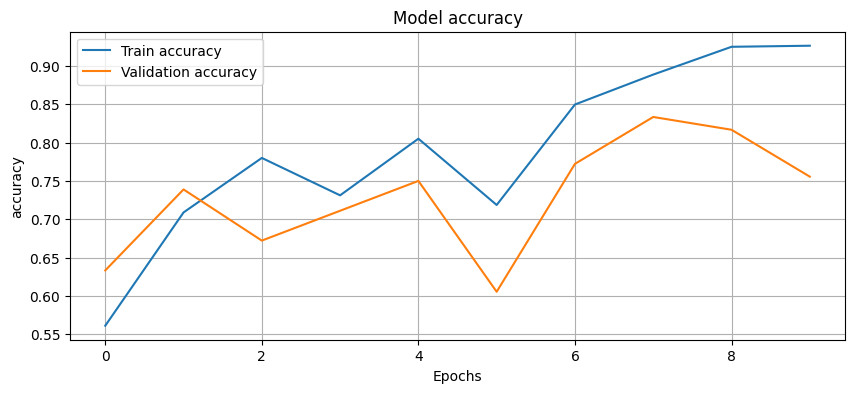

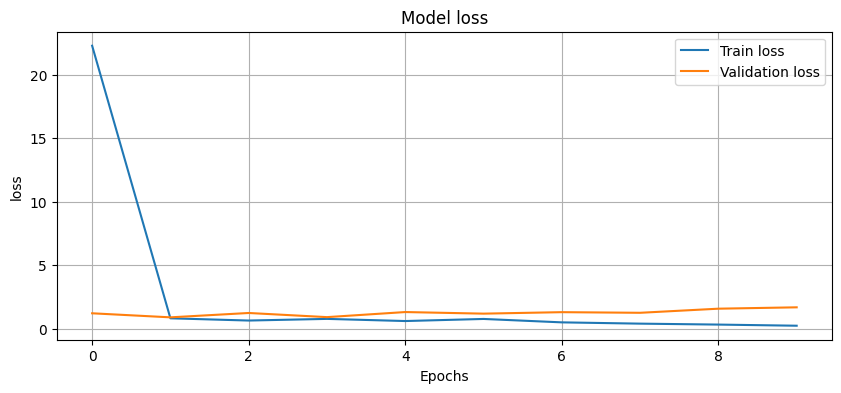

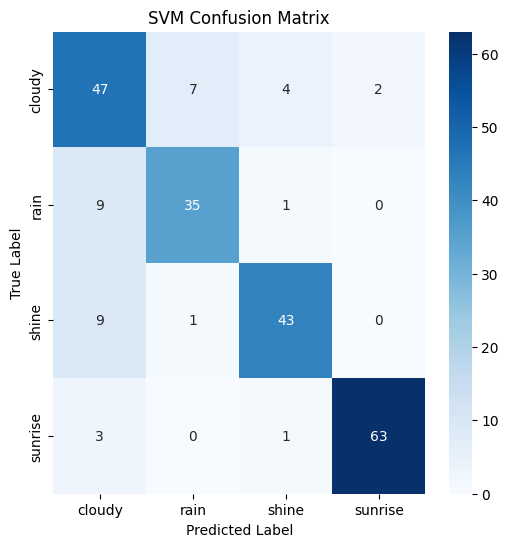

8/8 [==============================] - 1s 164ms/step


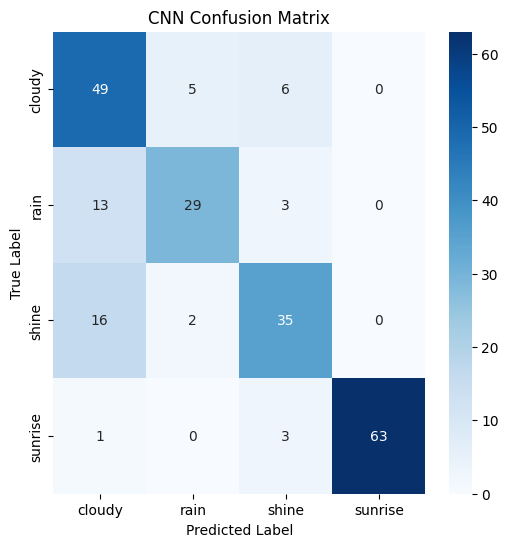

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 15s 578ms/step - loss: 14.7910 - accuracy: 0.5014 - val_loss: 1.5122 - val_accuracy: 0.6833
Epoch 2/10
23/23 [==============================] - 13s 555ms/step - loss: 0.6298 - accuracy: 0.7967 - val_loss: 1.4246 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 12s 525ms/step - loss: 0.4780 - accuracy: 0.8259 - val_loss: 0.9391 - val_accuracy: 0.8000
Epoch 4/10
23/23 [==============================] - 11s 485ms/step - loss: 0.3462 - accuracy: 0.8830 -

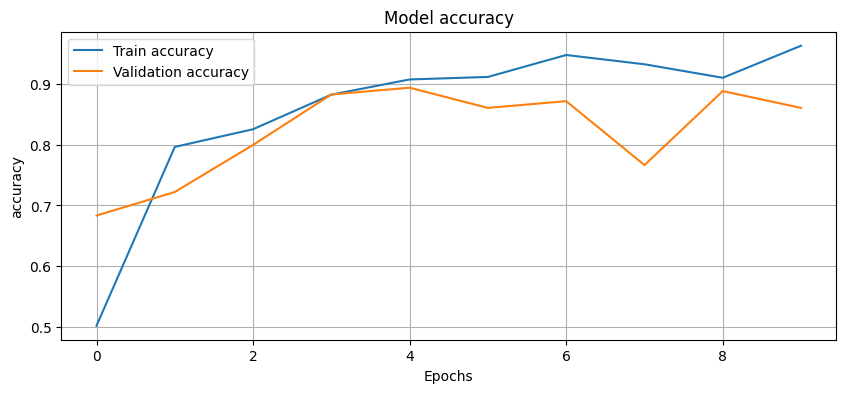

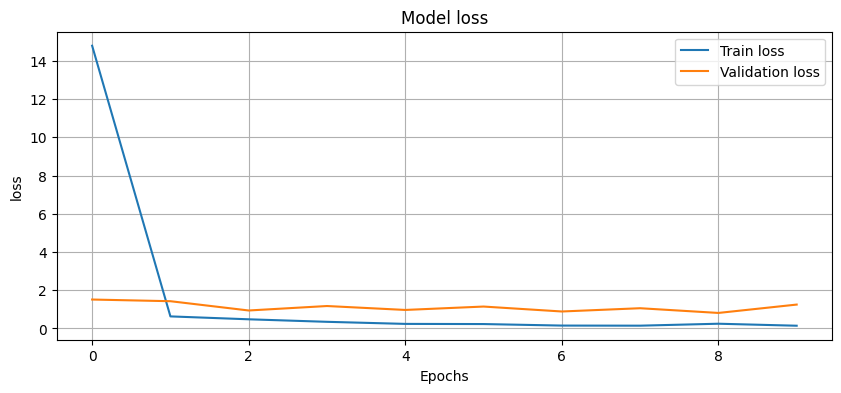

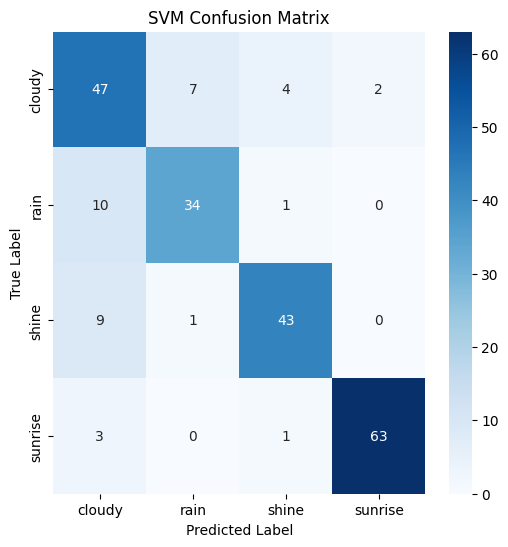

8/8 [==============================] - 1s 122ms/step


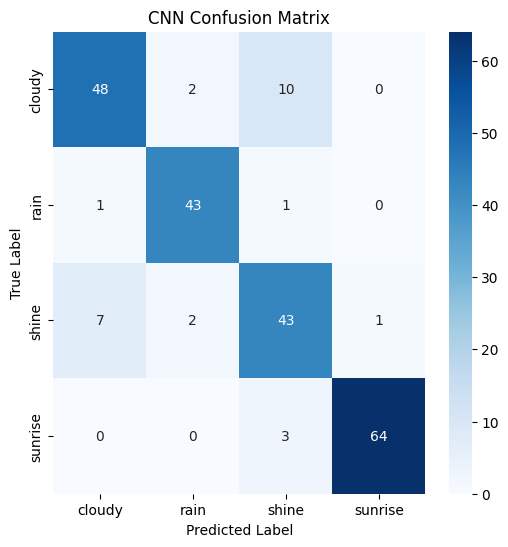

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.75      0.71        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 13s 500ms/step - loss: 24.6749 - accuracy: 0.5571 - val_loss: 1.1048 - val_accuracy: 0.6000
Epoch 2/10
23/23 [==============================] - 12s 526ms/step - loss: 0.7517 - accuracy: 0.7521 - val_loss: 0.9629 - val_accuracy: 0.7333
Epoch 3/10
23/23 [==============================] - 13s 569ms/step - loss: 0.5677 - accuracy: 0.8078 - val_loss: 1.2514 - val_accuracy: 0.7722
Epoch 4/10
23/23 [==============================] - 13s 564ms/step - loss: 0.5136 - accuracy: 0.7953 -

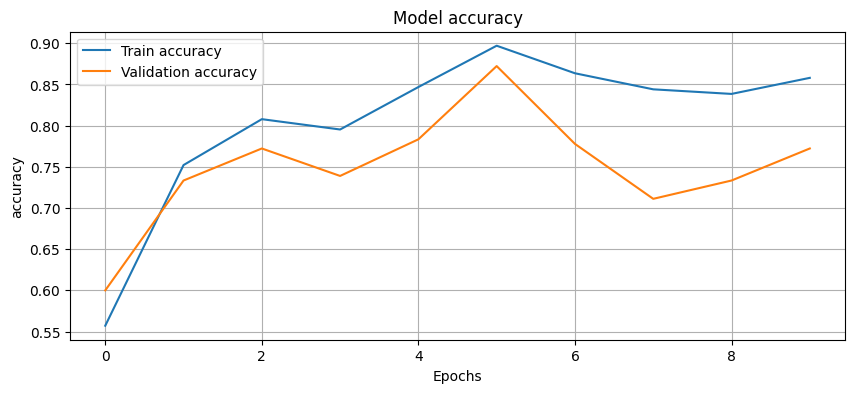

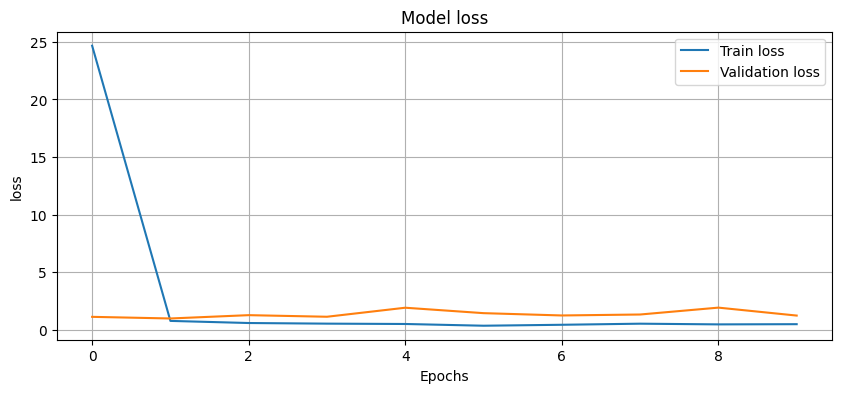

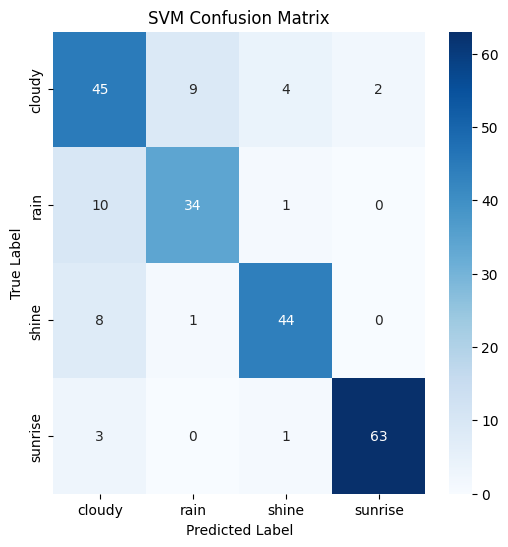

8/8 [==============================] - 1s 170ms/step


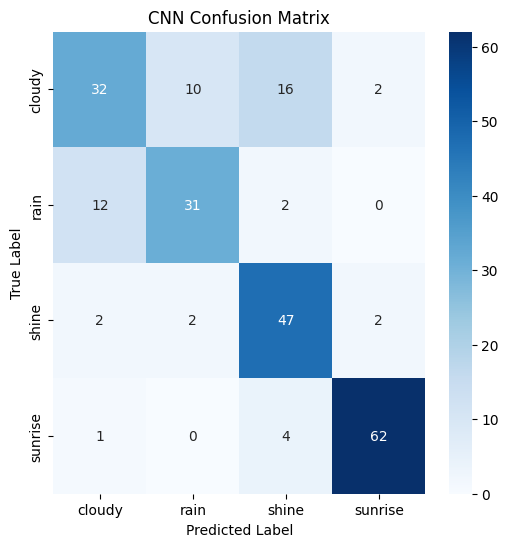

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 14s 559ms/step - loss: 13.9328 - accuracy: 0.5682 - val_loss: 0.9913 - val_accuracy: 0.6944
Epoch 2/10
23/23 [==============================] - 13s 551ms/step - loss: 0.6773 - accuracy: 0.7618 - val_loss: 0.8761 - val_accuracy: 0.7333
Epoch 3/10
23/23 [==============================] - 11s 497ms/step - loss: 0.6251 - accuracy: 0.8092 - val_loss: 0.7303 - val_accuracy: 0.8278
Epoch 4/10
23/23 [==============================] - 12s 493ms/step - loss: 0.4081 - accuracy: 0.8454 -

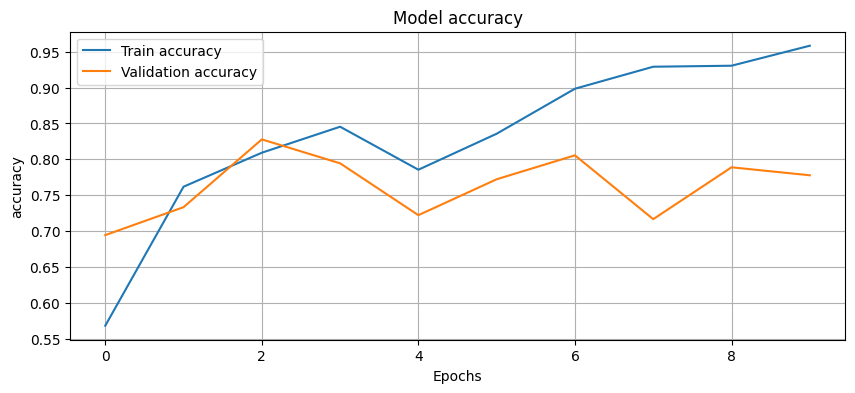

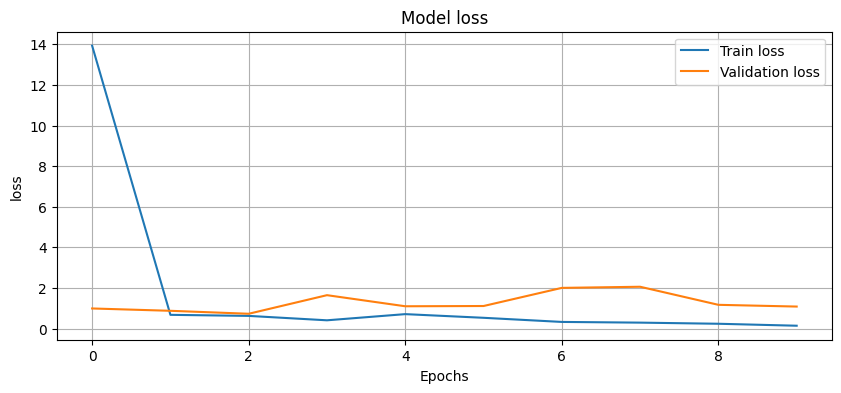

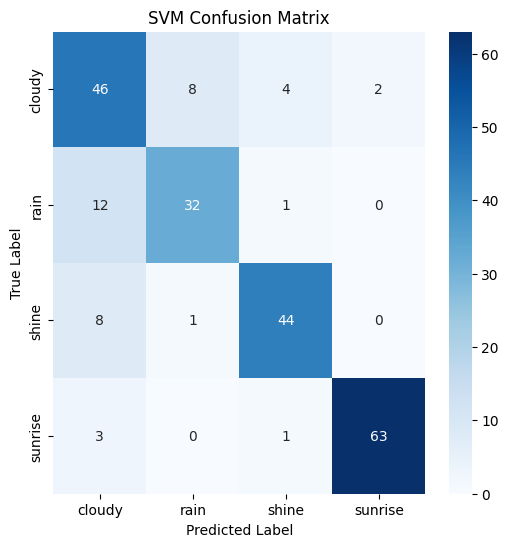

8/8 [==============================] - 2s 194ms/step


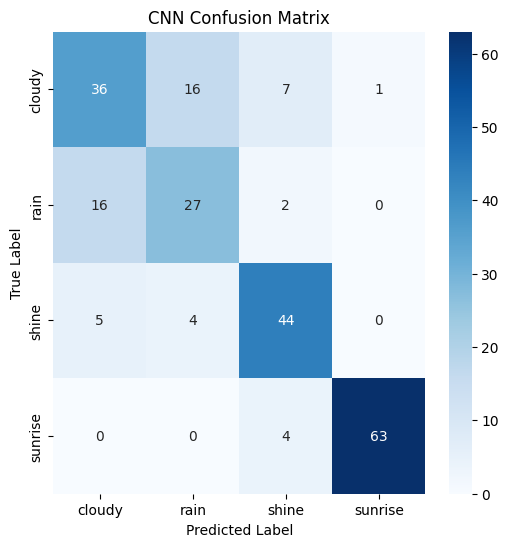

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 15s 603ms/step - loss: 21.4443 - accuracy: 0.5460 - val_loss: 0.9094 - val_accuracy: 0.6389
Epoch 2/10
23/23 [==============================] - 13s 572ms/step - loss: 0.8096 - accuracy: 0.6351 - val_loss: 0.7801 - val_accuracy: 0.7778
Epoch 3/10
23/23 [==============================] - 13s 555ms/step - loss: 0.6420 - accuracy: 0.7674 - val_loss: 1.0404 - val_accuracy: 0.6611
Epoch 4/10
23/23 [==============================] - 12s 515ms/step - loss: 0.4995 - accuracy: 0.8384 -

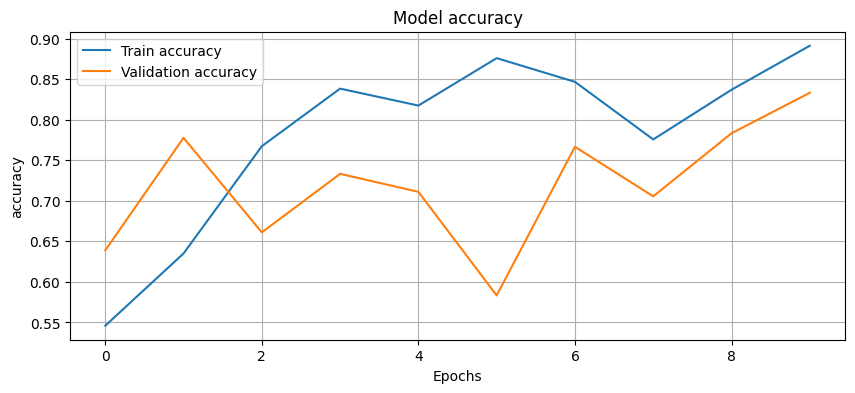

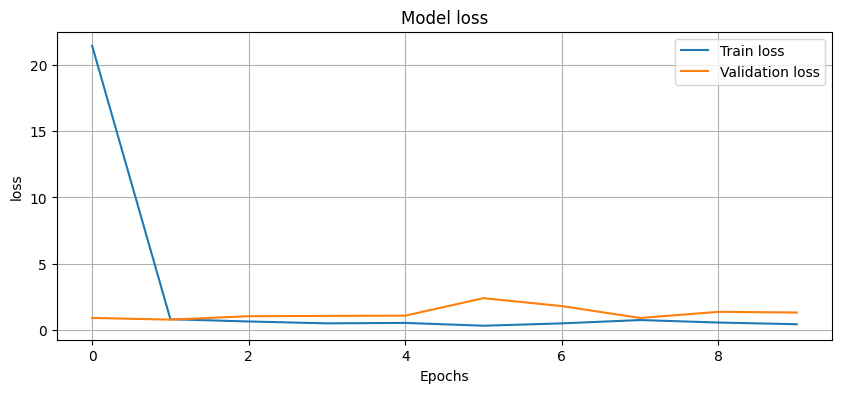

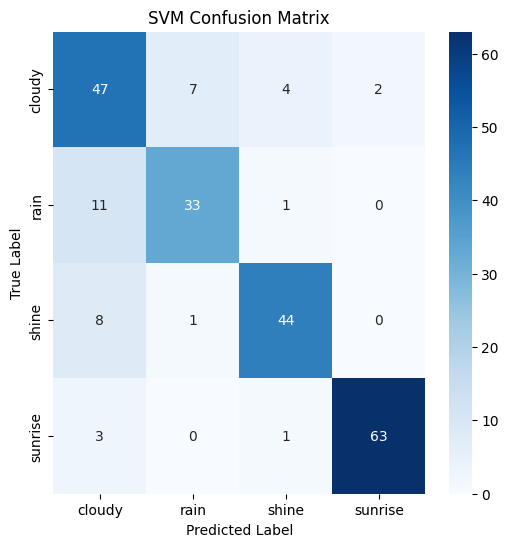

8/8 [==============================] - 1s 143ms/step


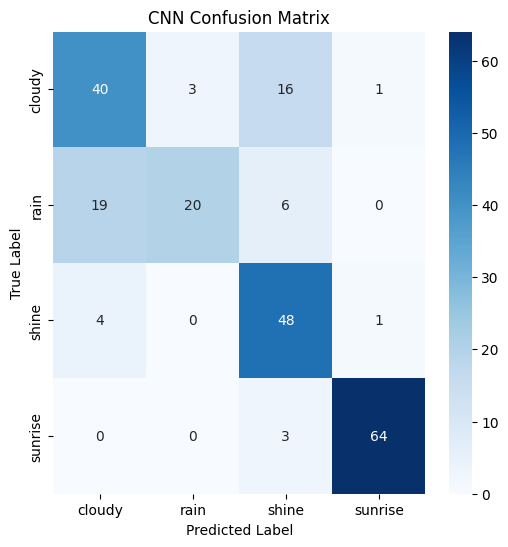

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 15s 603ms/step - loss: 33.7957 - accuracy: 0.4847 - val_loss: 1.3286 - val_accuracy: 0.6333
Epoch 2/10
23/23 [==============================] - 13s 590ms/step - loss: 0.7960 - accuracy: 0.6643 - val_loss: 1.6229 - val_accuracy: 0.6278
Epoch 3/10
23/23 [==============================] - 13s 591ms/step - loss: 0.7202 - accuracy: 0.6950 - val_loss: 1.8020 - val_accuracy: 0.6500
Epoch 4/10
23/23 [==============================] - 14s 592ms/step - loss: 0.6030 - accuracy: 0.7688 -

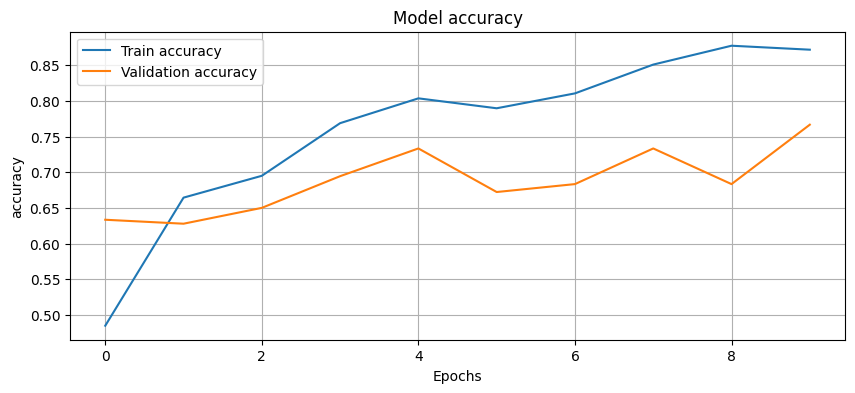

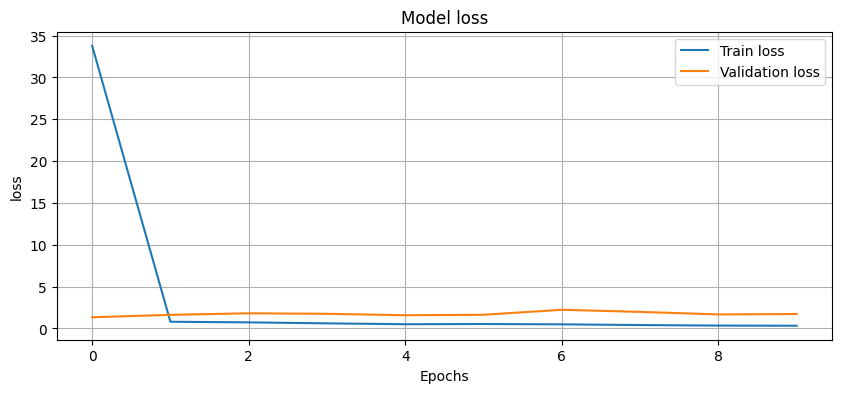

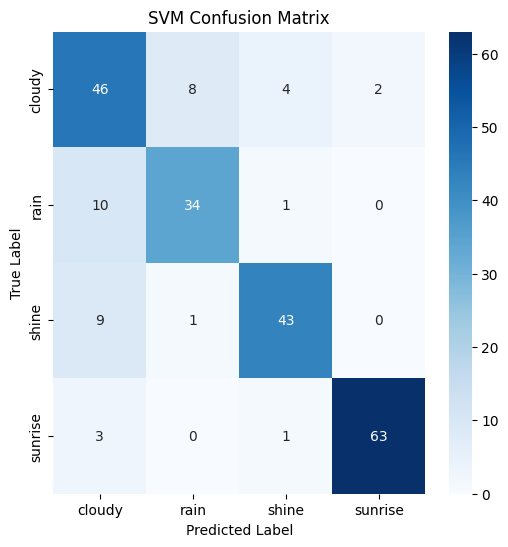

8/8 [==============================] - 1s 149ms/step


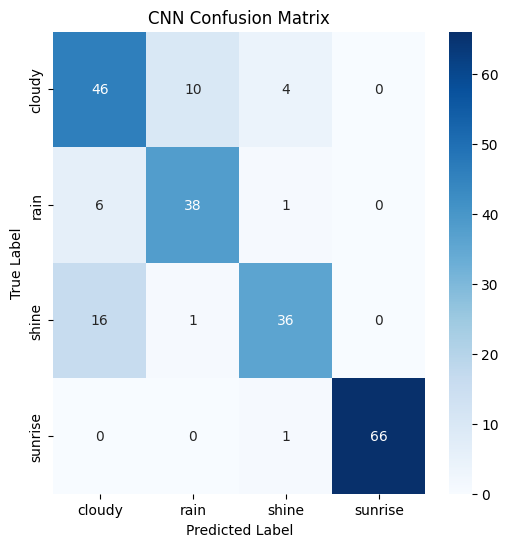

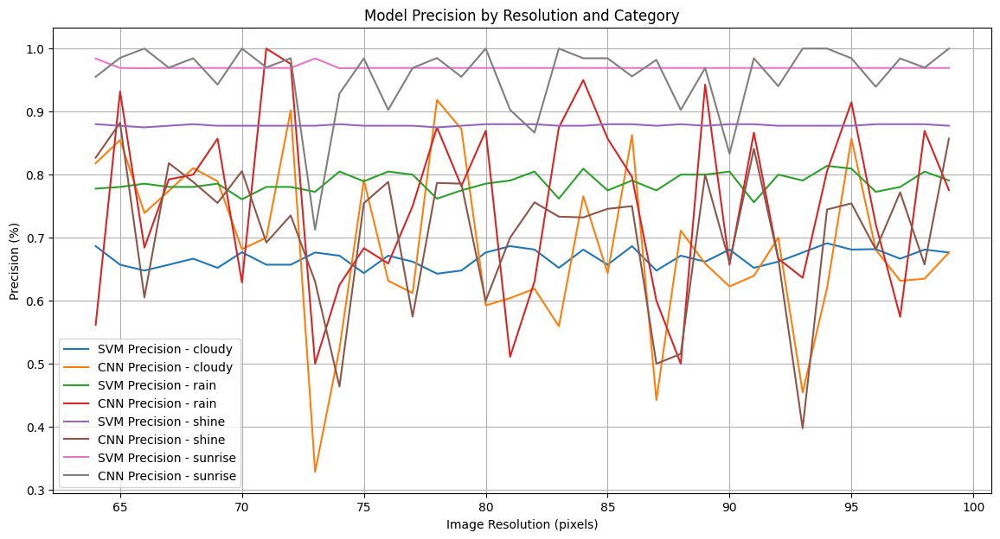

In [ ]:
def plot_metrics(history, metric='accuracy', val_metric='val_accuracy'):
    plt.figure(figsize=(10, 4))
    plt.plot(history.history[metric], label='Train ' + metric)
    plt.plot(history.history[val_metric], label='Validation ' + metric)
    plt.title('Model ' + metric)
    plt.ylabel(metric)
    plt.xlabel('Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path)
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image)  # Do not flatten, keep as 3D array
                labels.append(category)

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data
    X_train, X_test, y_train, y_test = train_test_split(
        np.array(data), encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train.reshape(X_train.shape[0], -1), y_train)  # Flatten here for SVM
    svm_predictions = svm_model.predict(X_test.reshape(X_test.shape[0], -1))  # Flatten here for SVM
    svm_accuracy = accuracy_score(y_test, svm_predictions)
    svm_report = precision_recall_fscore_support(y_test, svm_predictions, average=None, labels=[0,1,2,3])
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test, svm_predictions, target_names=label_encoder.classes_))

    # CNN model
    cnn_model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax')
    ])

    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    # Train CNN
    history = cnn_model.fit(X_train, y_train, epochs=10, validation_split=0.2)
    cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test, y_test)
    print(f"CNN Accuracy: {cnn_accuracy}")

    # Plot accuracy and loss
    plot_metrics(history, 'accuracy', 'val_accuracy')
    plot_metrics(history, 'loss', 'val_loss')

    # Confusion matrices
    svm_cm = confusion_matrix(y_test, svm_predictions)
    plot_confusion_matrix(svm_cm, label_encoder.classes_, "SVM Confusion Matrix")

    cnn_predictions = cnn_model.predict(X_test)
    cnn_predictions = np.argmax(cnn_predictions, axis=1)
    cnn_report = precision_recall_fscore_support(y_test, cnn_predictions, average=None, labels=[0,1,2,3])
    cnn_cm = confusion_matrix(y_test, cnn_predictions)
    plot_confusion_matrix(cnn_cm, label_encoder.classes_, "CNN Confusion Matrix")

    return svm_report, cnn_report, label_encoder.classes_

# Collecting accuracies
svm_results = []
cnn_results = []
resolutions = range(64, 100)  # Change range as needed
labels = []

for i in resolutions:
    svm_report, cnn_report, classes = train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset', (i, i))
    svm_results.append(svm_report)
    cnn_results.append(cnn_report)
    labels = classes  # Save label names for later use

# Plotting
plt.figure(figsize=(14, 7))

for i, category in enumerate(labels):
    category_accuracies_svm = [result[0][i] for result in svm_results]  # Precision values for SVM
    category_accuracies_cnn = [result[0][i] for result in cnn_results]  # Precision values for CNN
    plt.plot(resolutions, category_accuracies_svm, label=f'SVM Precision - {category}')
    plt.plot(resolutions, category_accuracies_cnn, label=f'CNN Precision - {category}')

plt.xlabel('Image Resolution (pixels)')
plt.ylabel('Precision (%)')
plt.title('Model Precision by Resolution and Category')
plt.legend()
plt.grid(True)
plt.show()

In [76]:
print(svm_results)
print(cnn_results)
print(resolutions)

[(array([0.68656716, 0.77777778, 0.88      , 0.98412698]), array([0.76666667, 0.77777778, 0.83018868, 0.92537313]), array([0.72440945, 0.77777778, 0.85436893, 0.95384615]), array([60, 45, 53, 67])), (array([0.65714286, 0.7804878 , 0.87755102, 0.96923077]), array([0.76666667, 0.71111111, 0.81132075, 0.94029851]), array([0.70769231, 0.74418605, 0.84313725, 0.95454545]), array([60, 45, 53, 67])), (array([0.64788732, 0.78571429, 0.875     , 0.96875   ]), array([0.76666667, 0.73333333, 0.79245283, 0.92537313]), array([0.70229008, 0.75862069, 0.83168317, 0.94656489]), array([60, 45, 53, 67])), (array([0.65714286, 0.7804878 , 0.87755102, 0.96923077]), array([0.76666667, 0.71111111, 0.81132075, 0.94029851]), array([0.70769231, 0.74418605, 0.84313725, 0.95454545]), array([60, 45, 53, 67])), (array([0.66666667, 0.7804878 , 0.88      , 0.96923077]), array([0.76666667, 0.71111111, 0.83018868, 0.94029851]), array([0.71317829, 0.74418605, 0.85436893, 0.95454545]), array([60, 45, 53, 67])), (array([0

In [59]:
def max_f1(y,x):
    # Extracting F1-scores for each condition
    f1_scores = {
        "rain": [],
        "cloudy": [],
        "shine": [],
        "sunrise": []
    }
    avg_f1=[]
    for result in x:
        f1_scores["rain"].append(result[2][1])
        f1_scores["cloudy"].append(result[2][0])
        f1_scores["shine"].append(result[2][2])
        f1_scores["sunrise"].append(result[2][3])
        avg_f1.append((result[2][0]+result[2][1]+result[2][2]+result[2][3])/4)

    # Finding the maximum F1-score for each weather condition
    max_f1_scores = {}
    for condition, scores in f1_scores.items():
        max_value = max(scores)
        max_index = scores.index(max_value)+64
        max_f1_scores[condition] = (max_value, max_index)



    print(y)
    print(max_f1_scores)
    print(y," Max Average ", avg_f1.index(max(avg_f1))+64 ," F1-scores  Resolution:", max(avg_f1) )


max_f1("SVM",svm_results)
max_f1("CNN",cnn_results)

SVM
{'rain': (0.79545455, 94), 'cloudy': (0.734375, 94), 'shine': (0.85436893, 64), 'sunrise': (0.96183206, 73)}
SVM  Max Average  94  F1-scores  Resolution: 0.8318780625
CNN
{'rain': (0.9347826086956522, 95), 'cloudy': (0.8688524590163934, 65), 'shine': (0.8653846153846154, 65), 'sunrise': (0.9925925925925926, 65)}
CNN  Max Average  65  F1-scores  Resolution: 0.9120444954000857


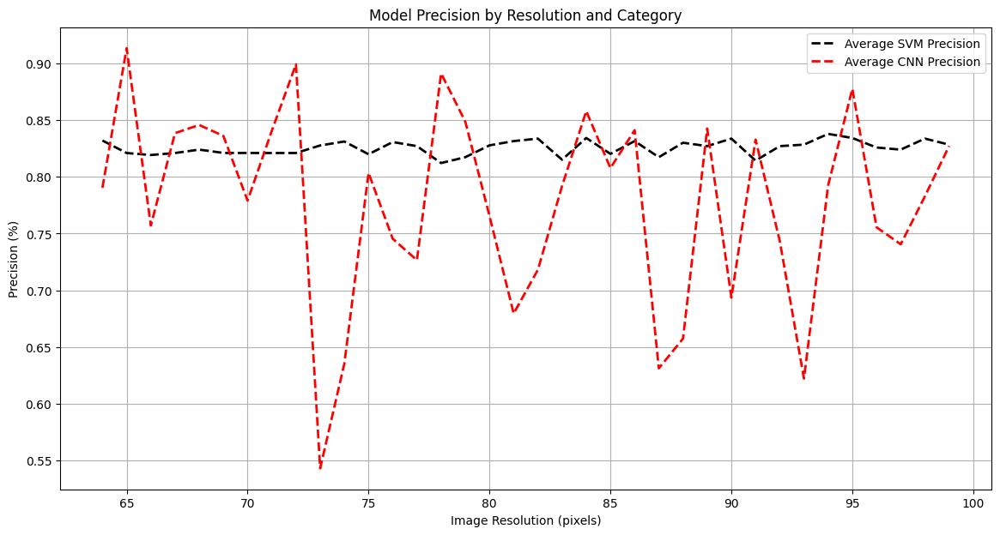

In [81]:
plt.figure(figsize=(14, 7))

# Plot precision for each category
# for i, category in enumerate(labels):
#     category_accuracies_svm = [result[0][i] for result in svm_results]
#     category_accuracies_cnn = [result[0][i] for result in cnn_results]
#     plt.plot(resolutions, category_accuracies_svm, label=f'SVM Precision - {category}')
#     plt.plot(resolutions, category_accuracies_cnn, label=f'CNN Precision - {category}')

# Calculate and plot average precision across all categories for each resolution
average_precision_svm = [np.mean([result[0][j] for j in range(len(labels))]) for result in svm_results]
average_precision_cnn = [np.mean([result[0][j] for j in range(len(labels))]) for result in cnn_results]
plt.plot(resolutions, average_precision_svm, 'k--', label='Average SVM Precision', linewidth=2)
plt.plot(resolutions, average_precision_cnn, 'r--', label='Average CNN Precision', linewidth=2)

plt.xlabel('Image Resolution (pixels)')
plt.ylabel('Precision (%)')
plt.title('Model Precision by Resolution and Category')
plt.legend()
plt.grid(True)
plt.show()


SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.78      0.78      0.78        45
       shine       0.88      0.83      0.85        53
     sunrise       0.98      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.83      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 259ms/step - loss: 11.5095 - accuracy: 0.5209 - val_loss: 0.9696 - val_accuracy: 0.6833
Epoch 2/10
23/23 [==============================] - 4s 166ms/step - loss: 0.6326 - accuracy: 0.7660 - val_loss: 1.0018 - val_accuracy: 0.7889
Epoch 3/10
23/23 [==============================] - 4s 166ms/step - loss: 0.4824 - accuracy: 0.8231 - val_loss: 1.0393 - val_accuracy: 0.7389
Epoch 4/10
23/23 [==============================] - 5s 240ms/step - loss: 0.4116 - accuracy: 0.8510 - val

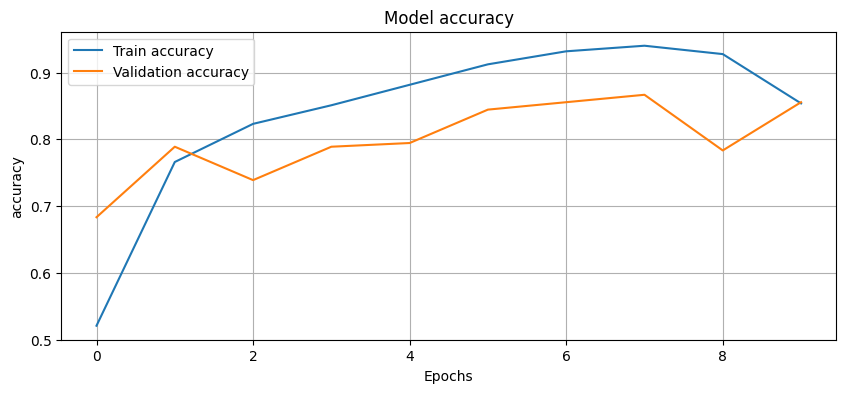

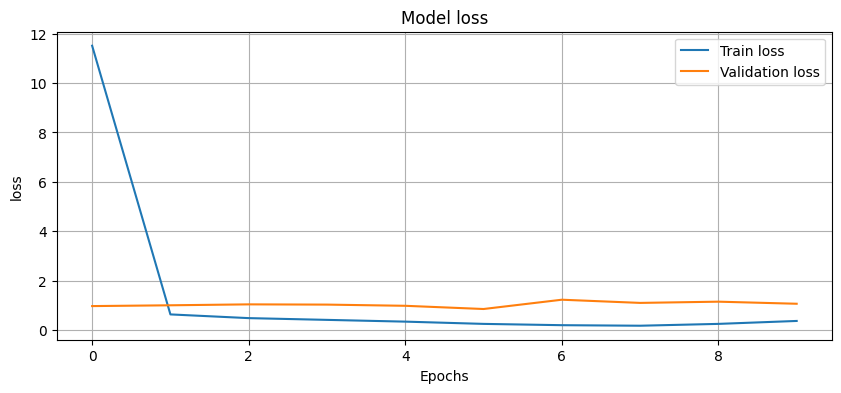

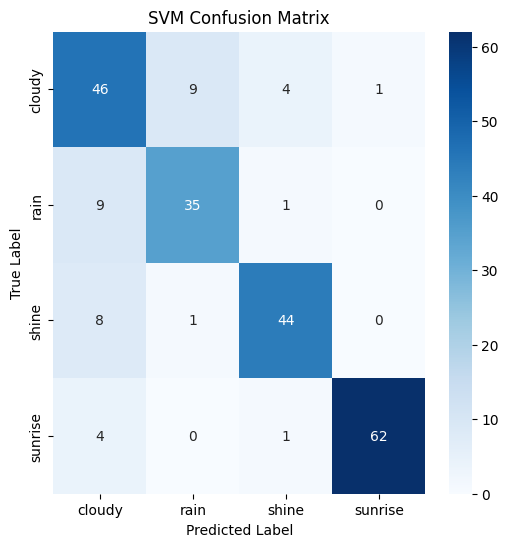

8/8 [==============================] - 1s 68ms/step


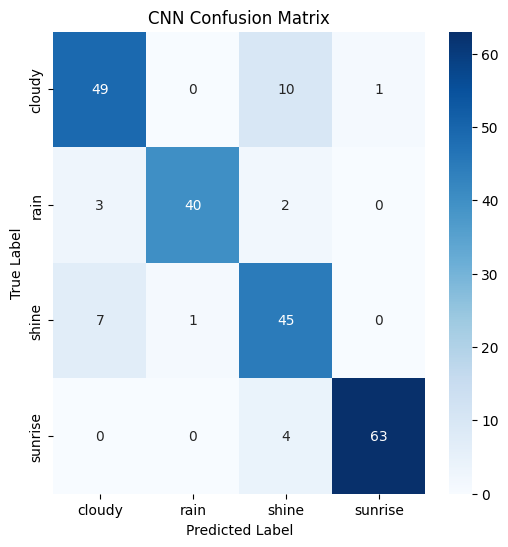

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 213ms/step - loss: 16.1501 - accuracy: 0.5279 - val_loss: 0.9040 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 5s 203ms/step - loss: 1.2666 - accuracy: 0.6281 - val_loss: 0.9427 - val_accuracy: 0.5833
Epoch 3/10
23/23 [==============================] - 4s 167ms/step - loss: 0.8745 - accuracy: 0.6337 - val_loss: 1.3871 - val_accuracy: 0.5778
Epoch 4/10
23/23 [==============================] - 4s 165ms/step - loss: 0.7047 - accuracy: 0.6992 - val

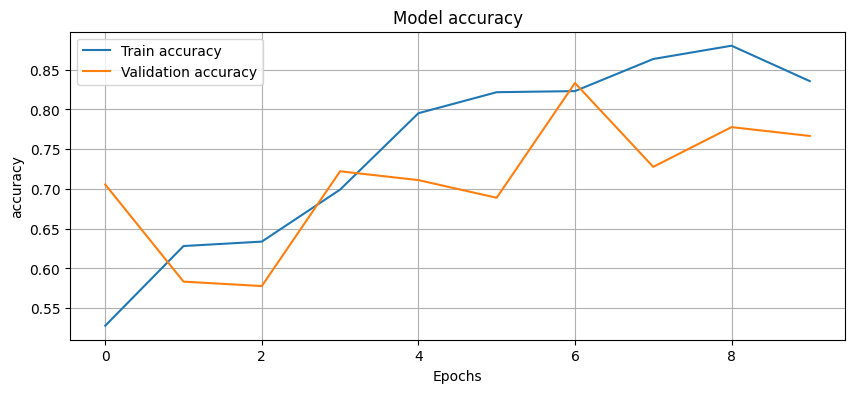

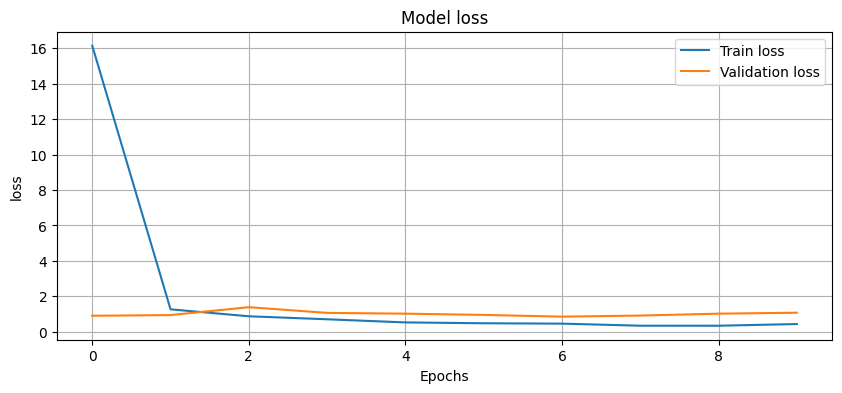

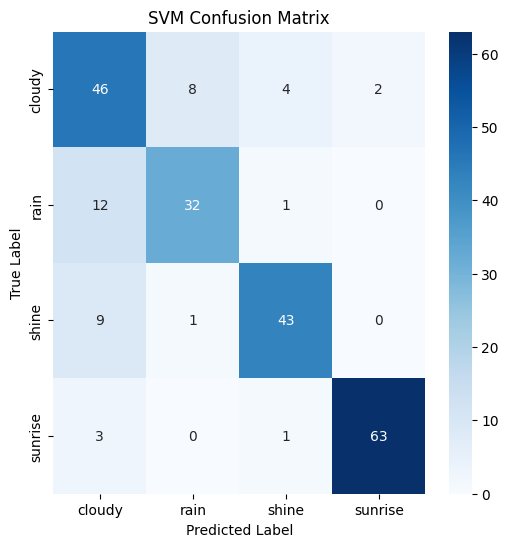

8/8 [==============================] - 1s 67ms/step


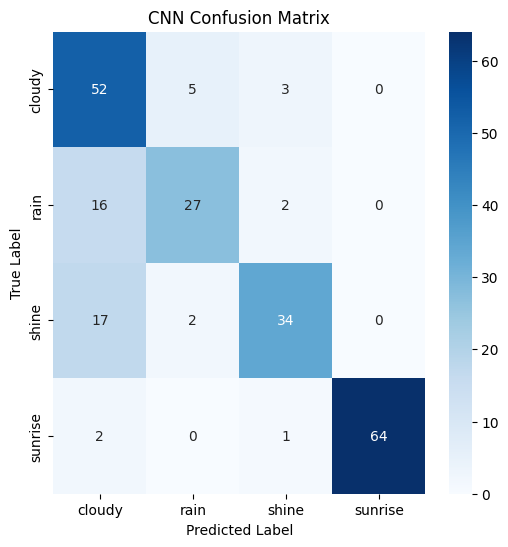

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 316ms/step - loss: 16.9688 - accuracy: 0.5237 - val_loss: 0.6427 - val_accuracy: 0.7611
Epoch 2/10
23/23 [==============================] - 4s 184ms/step - loss: 0.6523 - accuracy: 0.7674 - val_loss: 0.5695 - val_accuracy: 0.8389
Epoch 3/10
23/23 [==============================] - 4s 180ms/step - loss: 0.4364 - accuracy: 0.8301 - val_loss: 0.3933 - val_accuracy: 0.8667
Epoch 4/10
23/23 [==============================] - 6s 259ms/step - loss: 0.3416 - accuracy: 0.8830 - val

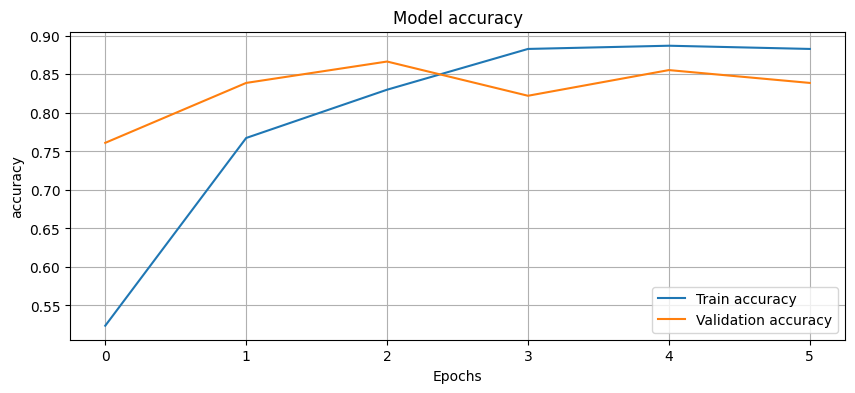

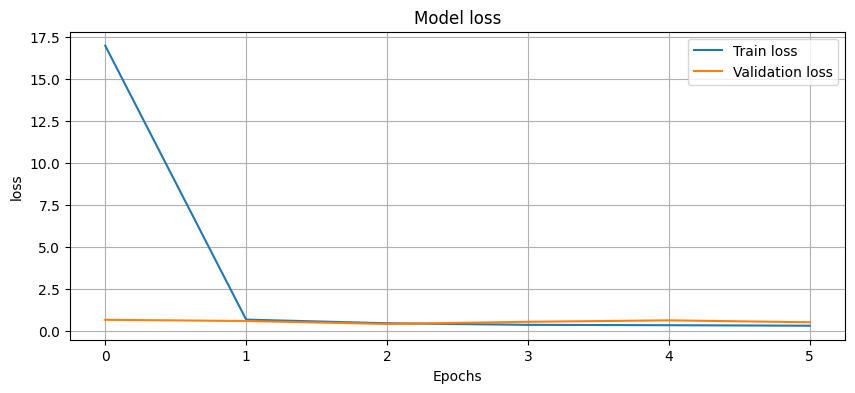

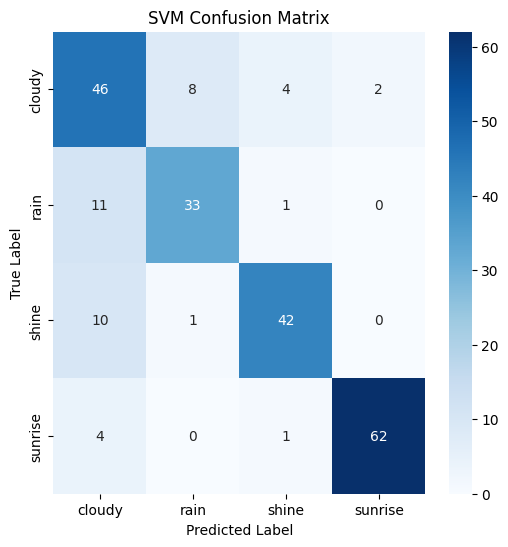

8/8 [==============================] - 0s 47ms/step


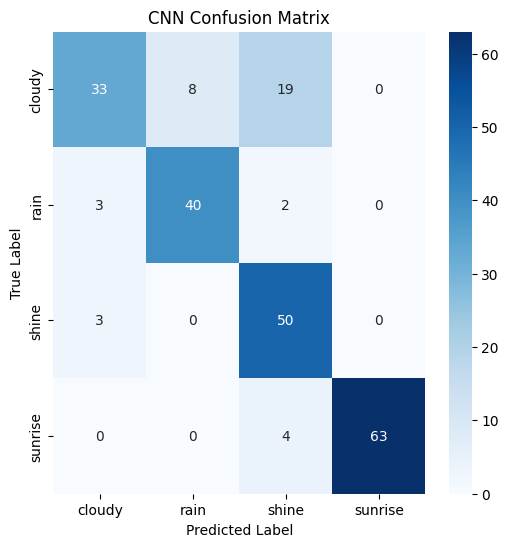

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 5s 193ms/step - loss: 13.4661 - accuracy: 0.4694 - val_loss: 0.9059 - val_accuracy: 0.6778
Epoch 2/10
23/23 [==============================] - 6s 261ms/step - loss: 0.7381 - accuracy: 0.6476 - val_loss: 0.8693 - val_accuracy: 0.6278
Epoch 3/10
23/23 [==============================] - 4s 181ms/step - loss: 0.6157 - accuracy: 0.7396 - val_loss: 1.0218 - val_accuracy: 0.7111
Epoch 4/10
23/23 [==============================] - 4s 184ms/step - loss: 0.5032 - accuracy: 0.8412 - val

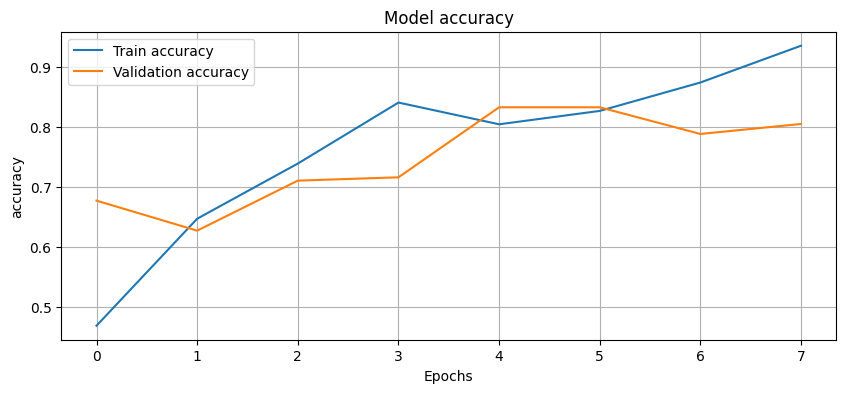

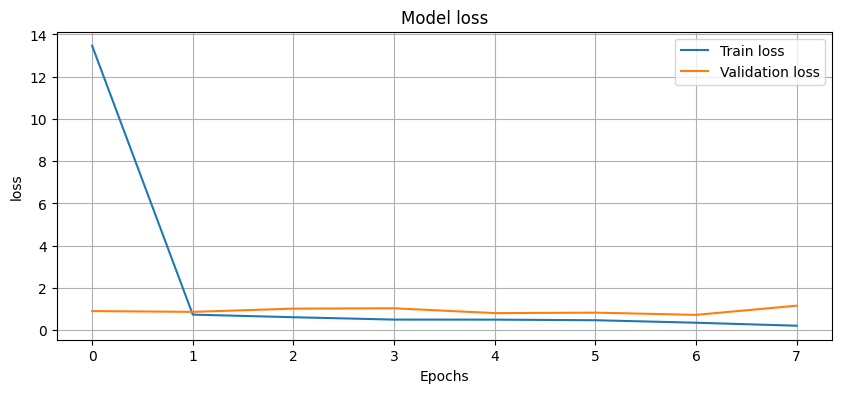

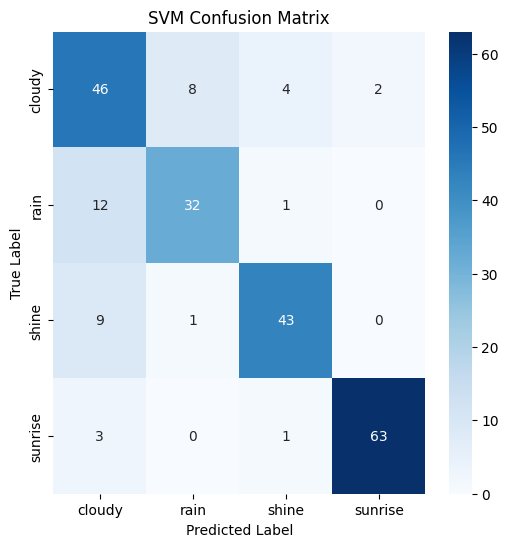

8/8 [==============================] - 0s 46ms/step


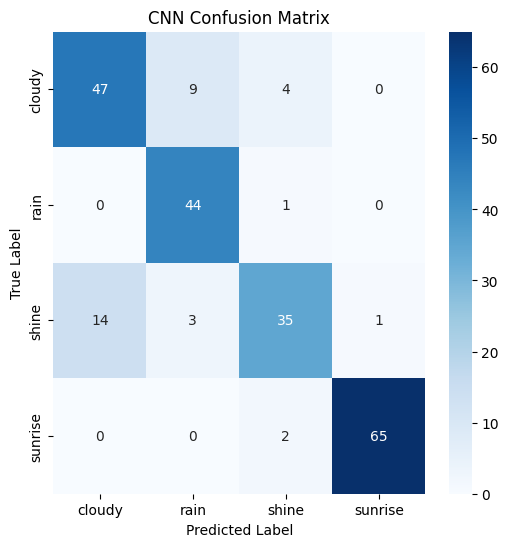

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 204ms/step - loss: 19.2829 - accuracy: 0.5390 - val_loss: 1.5629 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 6s 274ms/step - loss: 0.6437 - accuracy: 0.7618 - val_loss: 1.1524 - val_accuracy: 0.8000
Epoch 3/10
23/23 [==============================] - 4s 194ms/step - loss: 0.4863 - accuracy: 0.8064 - val_loss: 1.2733 - val_accuracy: 0.7667
Epoch 4/10
23/23 [==============================] - 4s 194ms/step - loss: 0.4555 - accuracy: 0.8092 - val

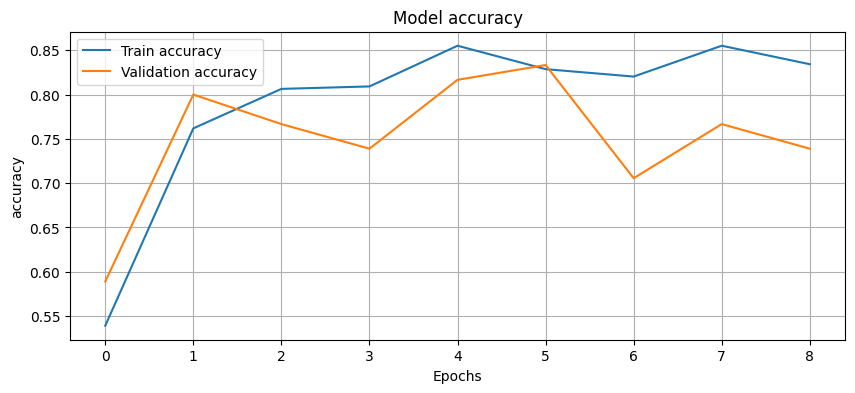

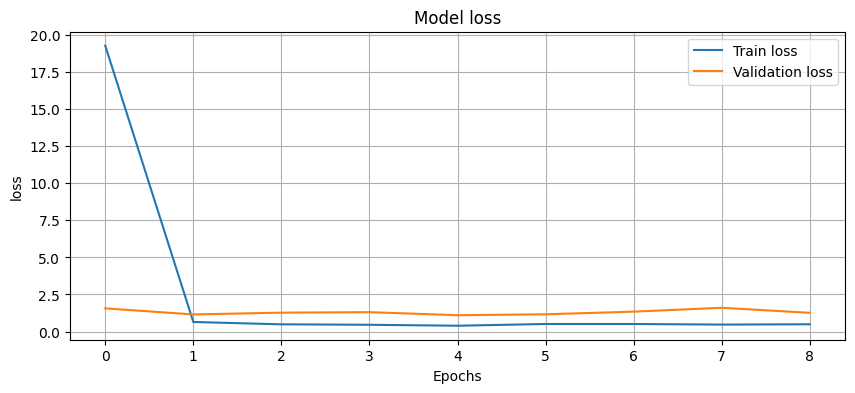

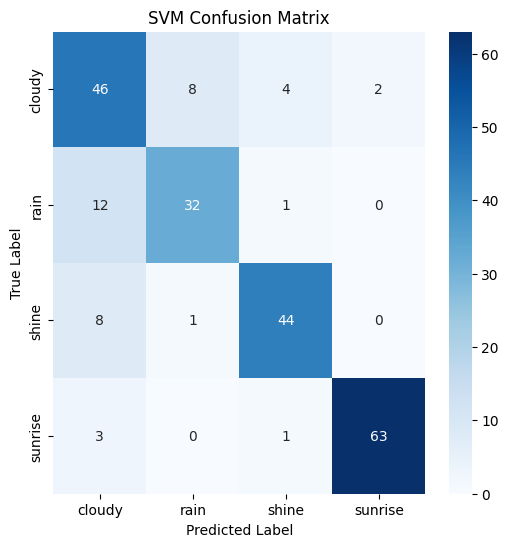

8/8 [==============================] - 1s 52ms/step


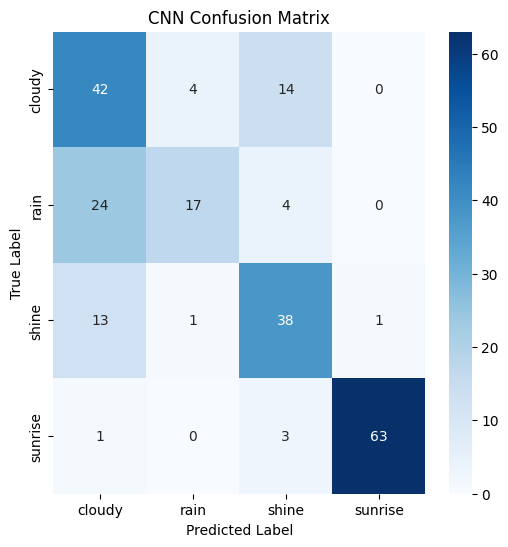

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 206ms/step - loss: 35.8914 - accuracy: 0.3955 - val_loss: 1.1322 - val_accuracy: 0.4722
Epoch 2/10
23/23 [==============================] - 6s 243ms/step - loss: 0.9579 - accuracy: 0.5724 - val_loss: 1.2063 - val_accuracy: 0.6722
Epoch 3/10
23/23 [==============================] - 5s 221ms/step - loss: 0.7576 - accuracy: 0.7047 - val_loss: 1.1551 - val_accuracy: 0.7111
Epoch 4/10
23/23 [==============================] - 5s 195ms/step - loss: 0.6725 - accuracy: 0.7089 - val

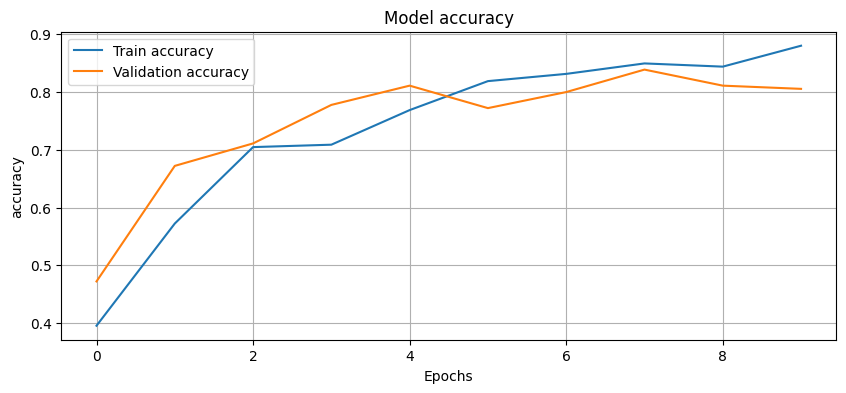

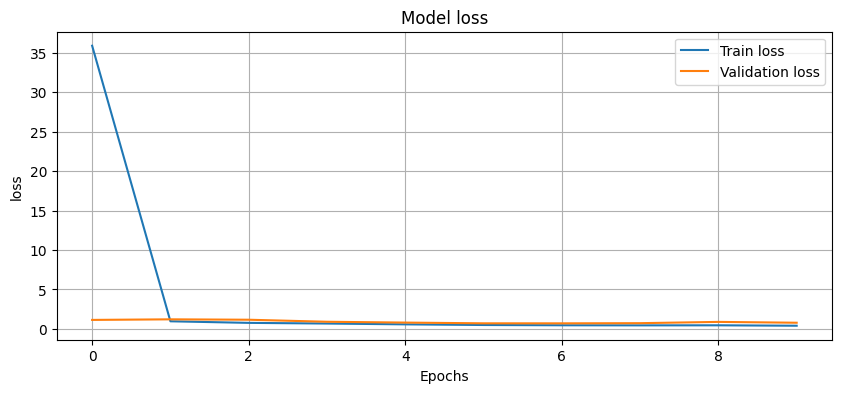

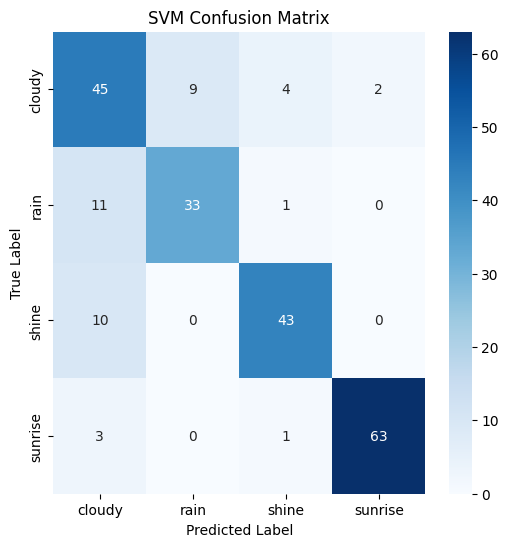

8/8 [==============================] - 0s 51ms/step


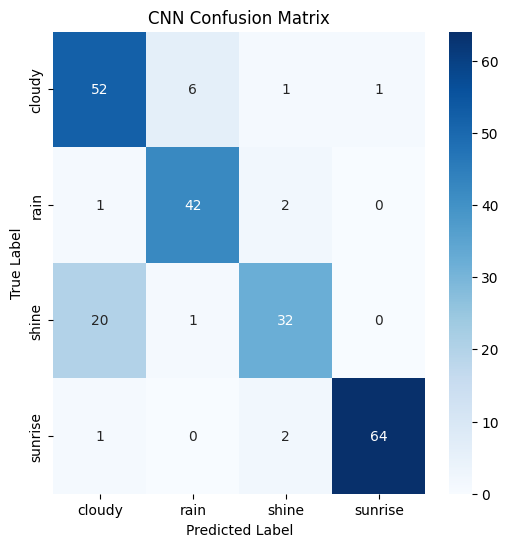

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.68      0.73      0.70        60
        rain       0.76      0.78      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.82      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 254ms/step - loss: 14.3869 - accuracy: 0.4624 - val_loss: 1.0334 - val_accuracy: 0.6444
Epoch 2/10
23/23 [==============================] - 6s 257ms/step - loss: 0.6704 - accuracy: 0.7228 - val_loss: 0.6770 - val_accuracy: 0.7444
Epoch 3/10
23/23 [==============================] - 5s 211ms/step - loss: 0.5970 - accuracy: 0.7855 - val_loss: 0.7925 - val_accuracy: 0.8000
Epoch 4/10
23/23 [==============================] - 7s 294ms/step - loss: 0.3991 - accuracy: 0.8510 - val

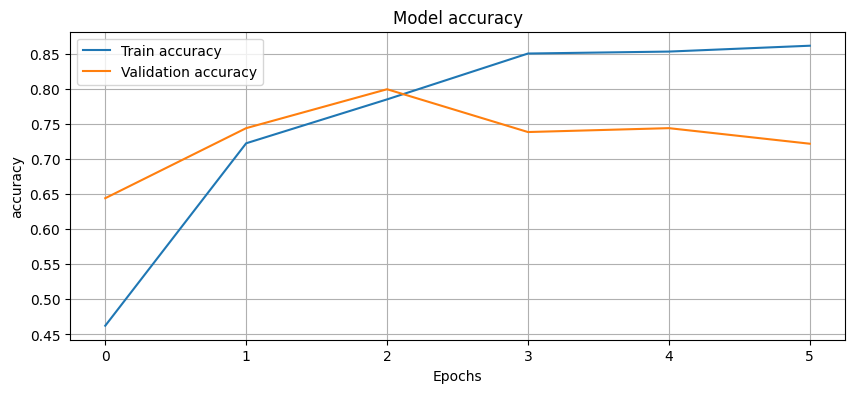

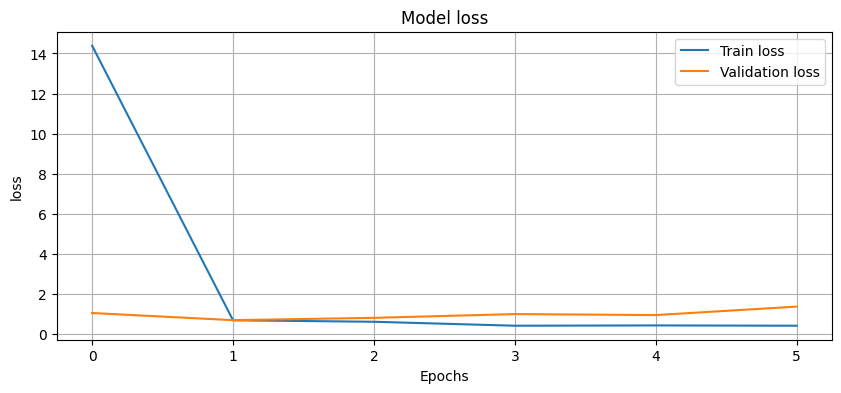

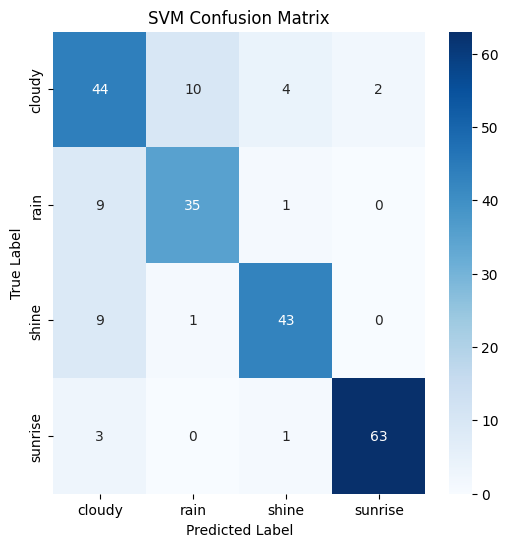

8/8 [==============================] - 1s 54ms/step


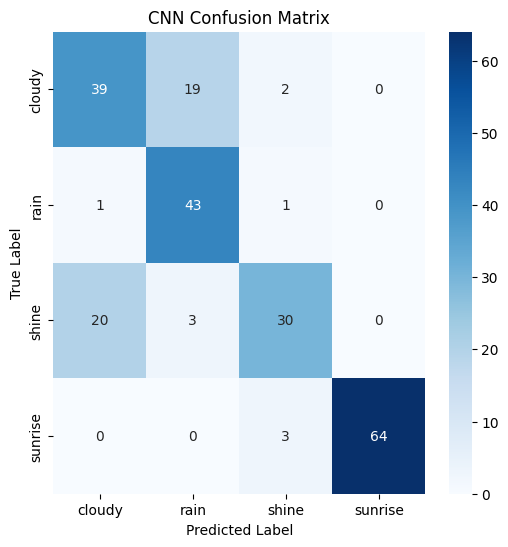

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 6s 222ms/step - loss: 21.1732 - accuracy: 0.5446 - val_loss: 1.1950 - val_accuracy: 0.6833
Epoch 2/10
23/23 [==============================] - 7s 292ms/step - loss: 0.7191 - accuracy: 0.7228 - val_loss: 0.9240 - val_accuracy: 0.7500
Epoch 3/10
23/23 [==============================] - 5s 213ms/step - loss: 0.6548 - accuracy: 0.7799 - val_loss: 1.4973 - val_accuracy: 0.7611
Epoch 4/10
23/23 [==============================] - 5s 229ms/step - loss: 0.5489 - accuracy: 0.8148 - val

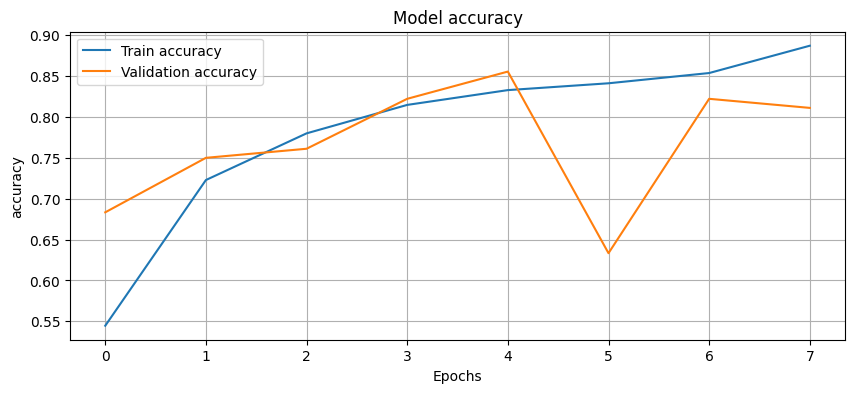

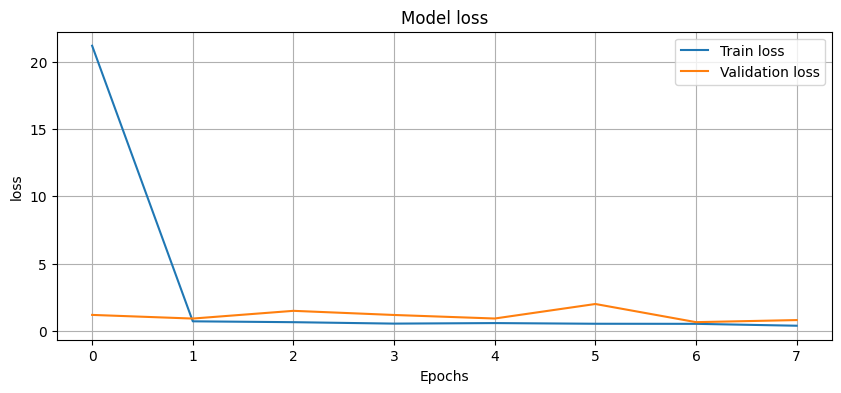

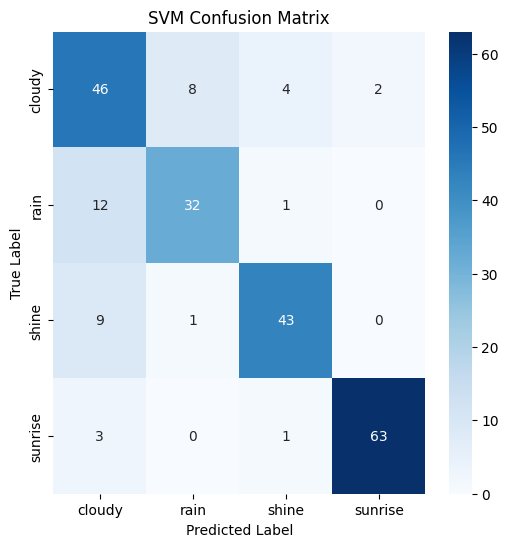

8/8 [==============================] - 1s 56ms/step


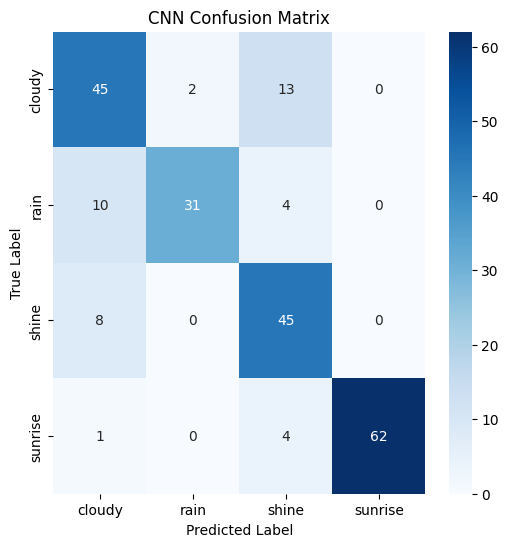

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 259ms/step - loss: 33.3786 - accuracy: 0.4471 - val_loss: 0.9614 - val_accuracy: 0.6722
Epoch 2/10
23/23 [==============================] - 6s 264ms/step - loss: 0.7877 - accuracy: 0.6365 - val_loss: 1.1246 - val_accuracy: 0.5944
Epoch 3/10
23/23 [==============================] - 5s 219ms/step - loss: 0.7654 - accuracy: 0.6462 - val_loss: 0.9651 - val_accuracy: 0.7722
Epoch 4/10
23/23 [==============================] - 7s 306ms/step - loss: 0.7378 - accuracy: 0.6755 - val

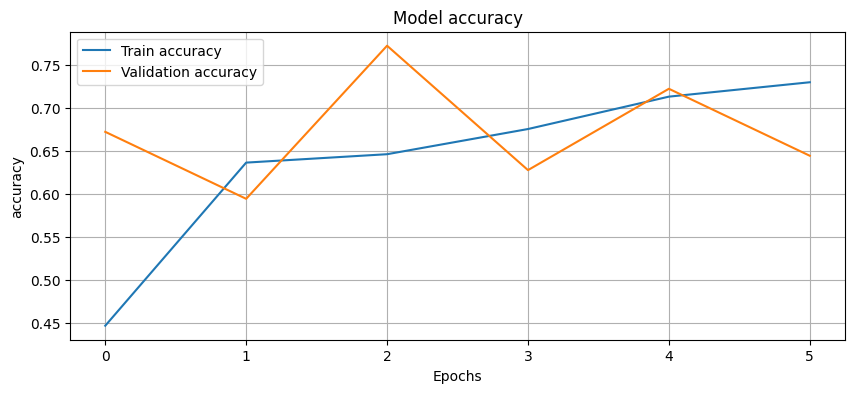

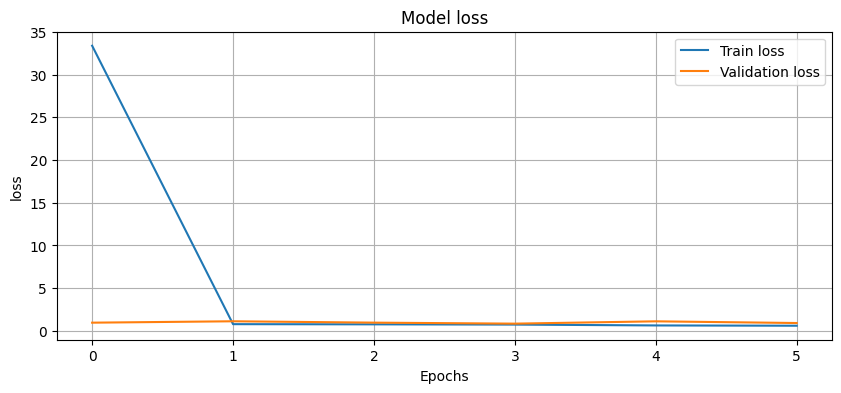

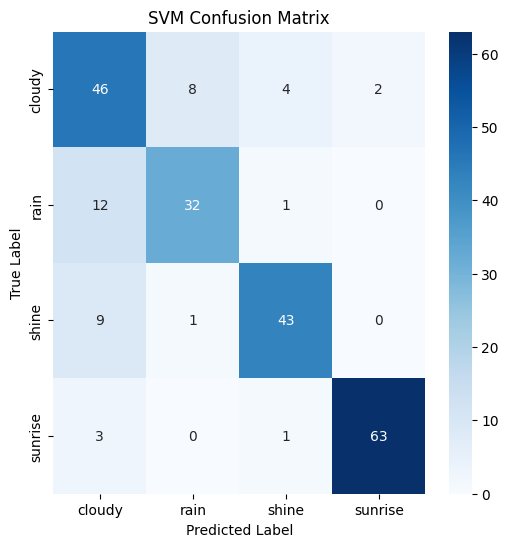

8/8 [==============================] - 1s 59ms/step


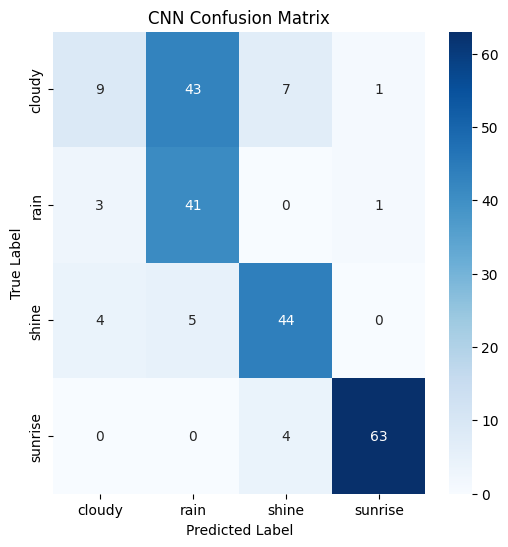

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.81      0.84        53
     sunrise       0.98      0.94      0.96        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 6s 232ms/step - loss: 27.9078 - accuracy: 0.4986 - val_loss: 1.0743 - val_accuracy: 0.5778
Epoch 2/10
23/23 [==============================] - 7s 300ms/step - loss: 0.7633 - accuracy: 0.7006 - val_loss: 1.2345 - val_accuracy: 0.6111
Epoch 3/10
23/23 [==============================] - 5s 221ms/step - loss: 0.6982 - accuracy: 0.7507 - val_loss: 0.8215 - val_accuracy: 0.7667
Epoch 4/10
23/23 [==============================] - 6s 242ms/step - loss: 0.5914 - accuracy: 0.7925 - val

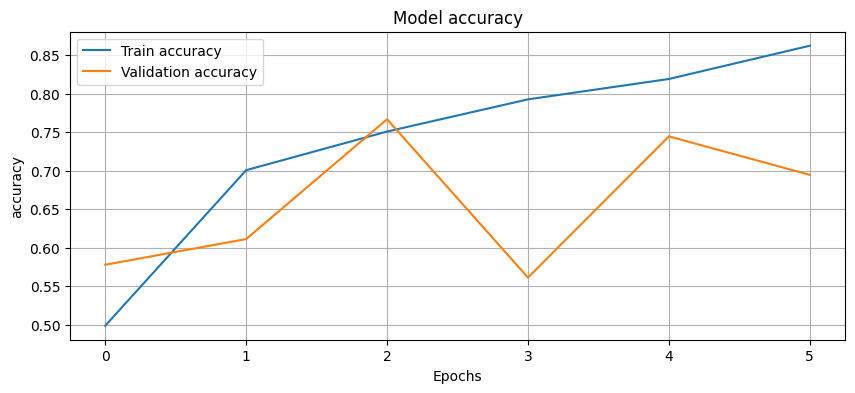

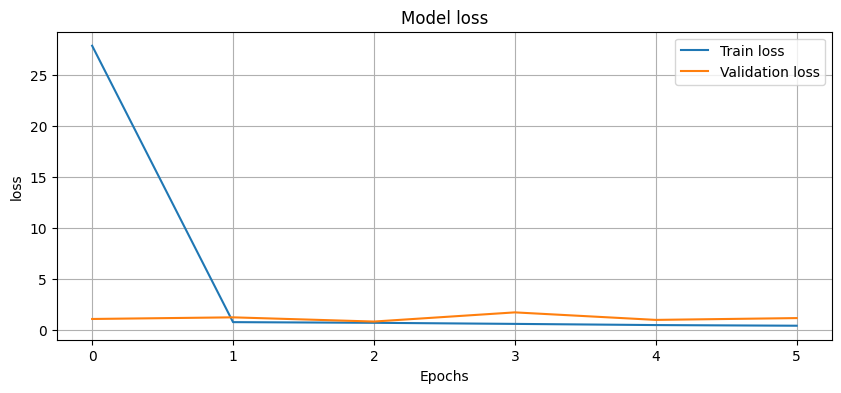

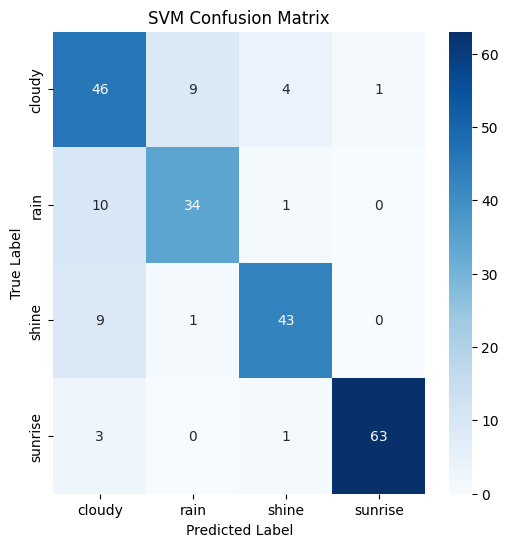

8/8 [==============================] - 1s 59ms/step


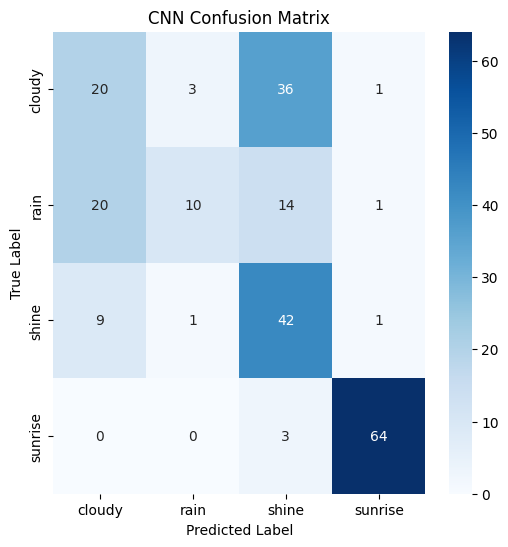

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.93      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 7s 263ms/step - loss: 21.1307 - accuracy: 0.4735 - val_loss: 0.8363 - val_accuracy: 0.7000
Epoch 2/10
23/23 [==============================] - 8s 329ms/step - loss: 0.6445 - accuracy: 0.7465 - val_loss: 0.6695 - val_accuracy: 0.7778
Epoch 3/10
23/23 [==============================] - 6s 251ms/step - loss: 0.5142 - accuracy: 0.8092 - val_loss: 0.7448 - val_accuracy: 0.7833
Epoch 4/10
23/23 [==============================] - 7s 330ms/step - loss: 0.3649 - accuracy: 0.8802 - val

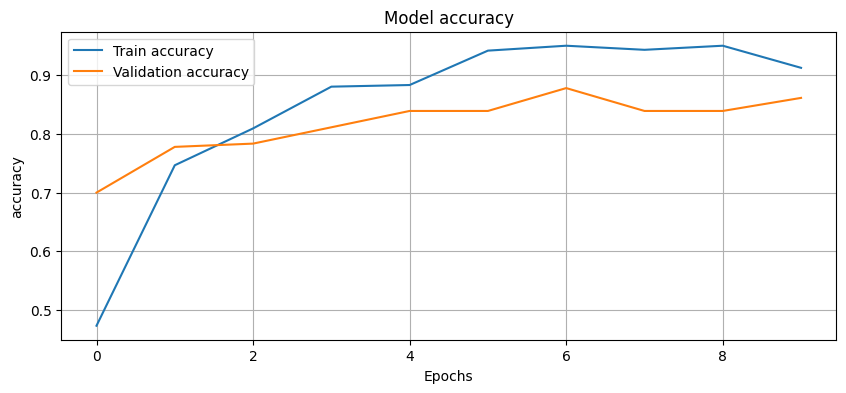

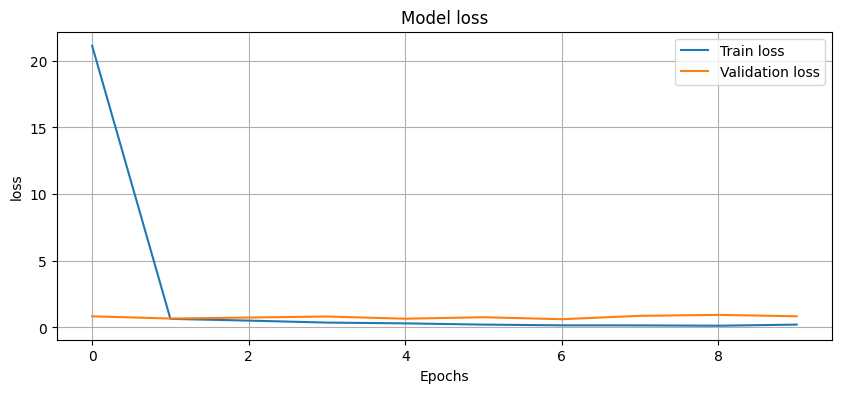

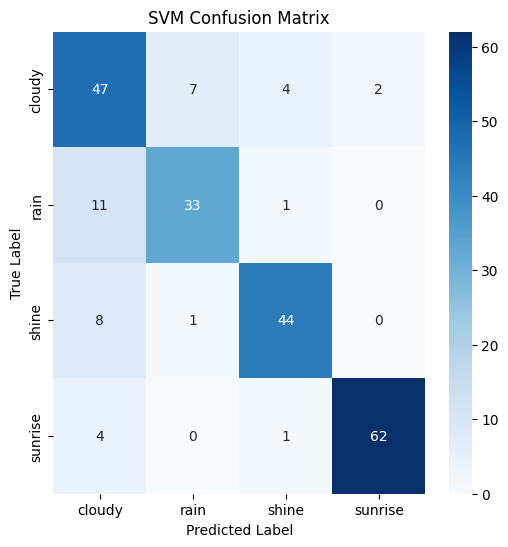

8/8 [==============================] - 1s 64ms/step


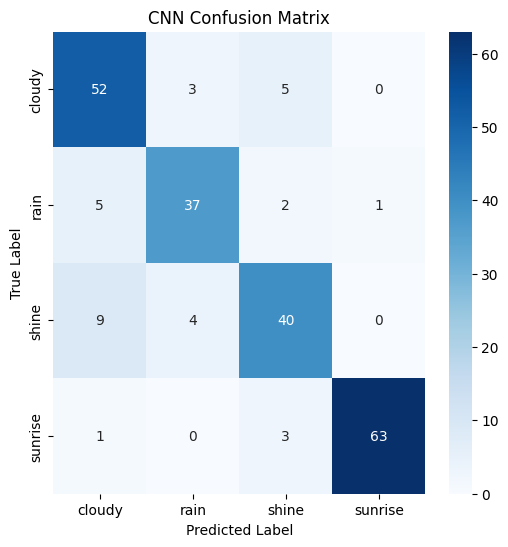

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.64      0.78      0.71        60
        rain       0.79      0.67      0.72        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 7s 252ms/step - loss: 18.9503 - accuracy: 0.4596 - val_loss: 1.2032 - val_accuracy: 0.6778
Epoch 2/10
23/23 [==============================] - 7s 305ms/step - loss: 0.7453 - accuracy: 0.6880 - val_loss: 1.4097 - val_accuracy: 0.6778
Epoch 3/10
23/23 [==============================] - 6s 275ms/step - loss: 0.6287 - accuracy: 0.7437 - val_loss: 0.8293 - val_accuracy: 0.8167
Epoch 4/10
23/23 [==============================] - 6s 268ms/step - loss: 0.5932 - accuracy: 0.7604 - val

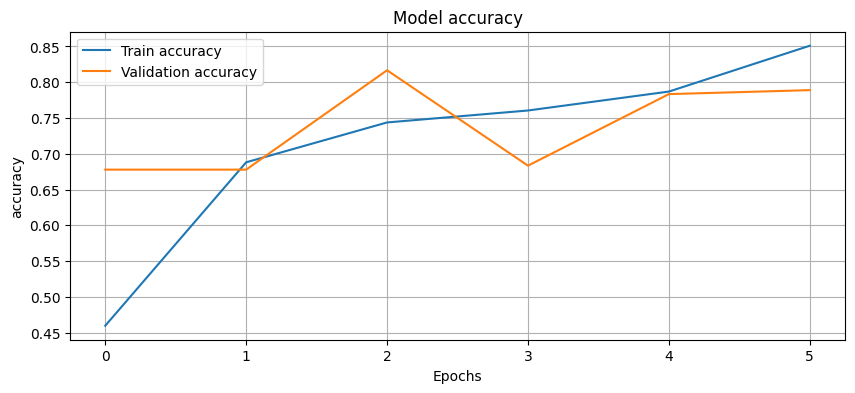

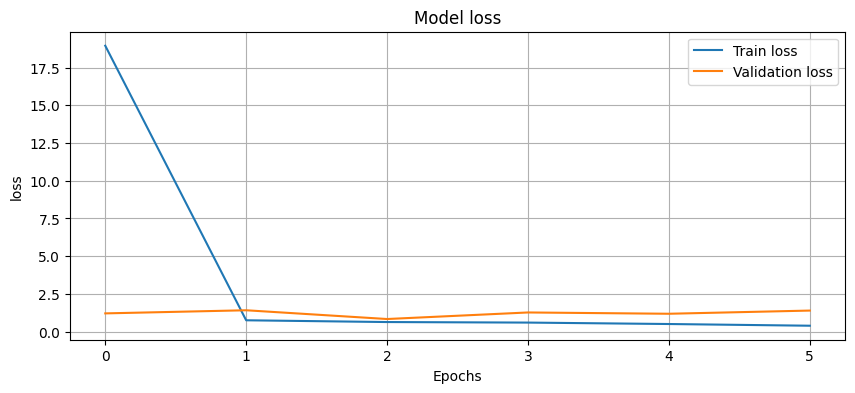

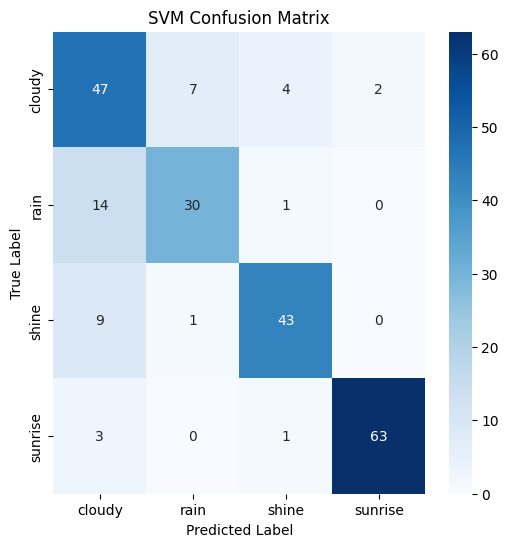

8/8 [==============================] - 1s 66ms/step


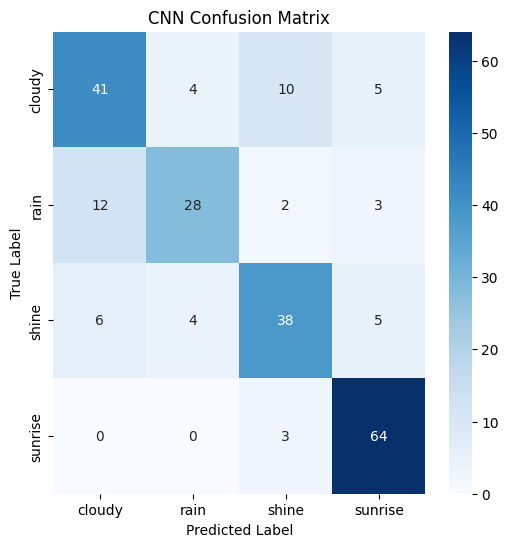

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 8s 290ms/step - loss: 12.6383 - accuracy: 0.5292 - val_loss: 1.0787 - val_accuracy: 0.6944
Epoch 2/10
23/23 [==============================] - 8s 366ms/step - loss: 0.6593 - accuracy: 0.7688 - val_loss: 1.3178 - val_accuracy: 0.6778
Epoch 3/10
23/23 [==============================] - 6s 279ms/step - loss: 0.5168 - accuracy: 0.8245 - val_loss: 1.2140 - val_accuracy: 0.8222
Epoch 4/10
23/23 [==============================] - 8s 361ms/step - loss: 0.3796 - accuracy: 0.8649 - val

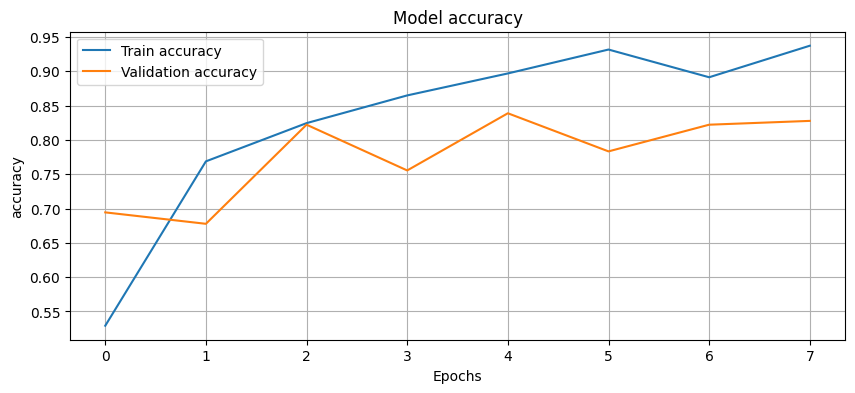

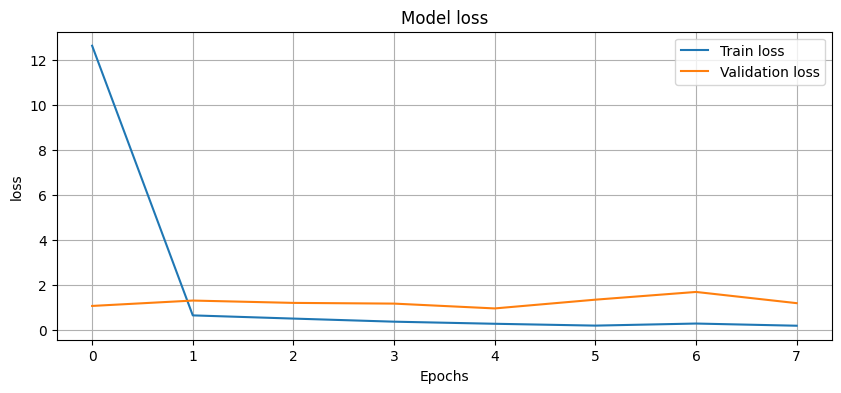

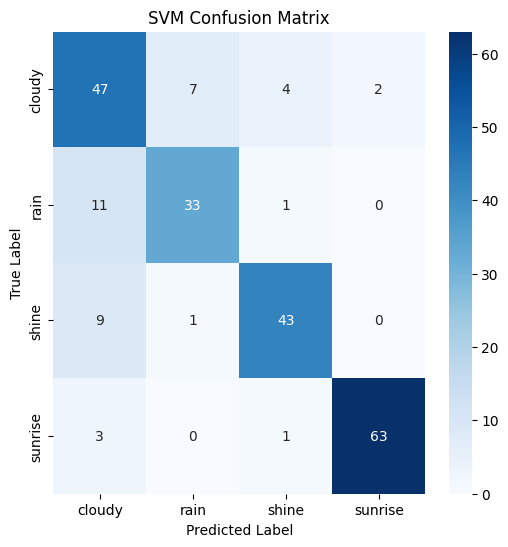

8/8 [==============================] - 1s 70ms/step


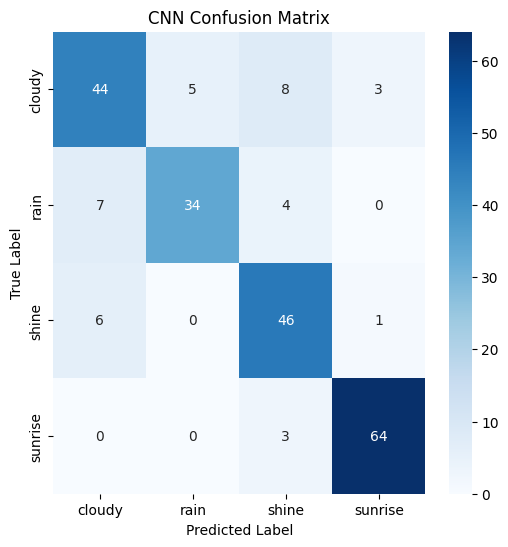

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 283ms/step - loss: 17.4701 - accuracy: 0.4415 - val_loss: 1.6660 - val_accuracy: 0.6056
Epoch 2/10
23/23 [==============================] - 8s 340ms/step - loss: 0.9430 - accuracy: 0.6031 - val_loss: 1.4036 - val_accuracy: 0.6222
Epoch 3/10
23/23 [==============================] - 6s 278ms/step - loss: 0.8229 - accuracy: 0.6128 - val_loss: 1.0731 - val_accuracy: 0.6556
Epoch 4/10
23/23 [==============================] - 7s 310ms/step - loss: 0.7340 - accuracy: 0.7033 - val

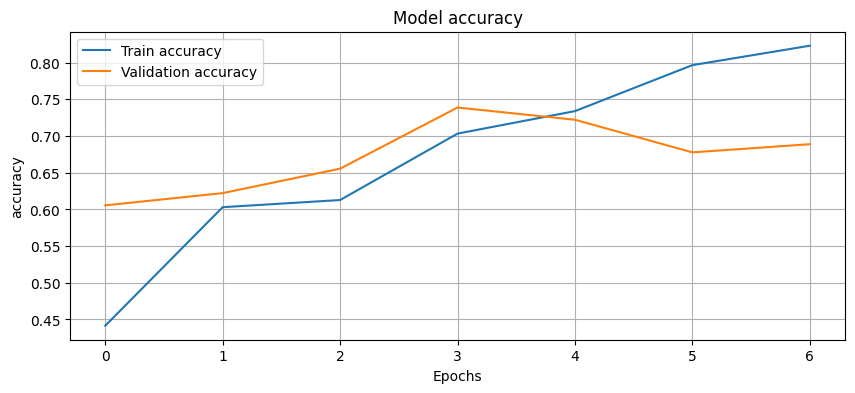

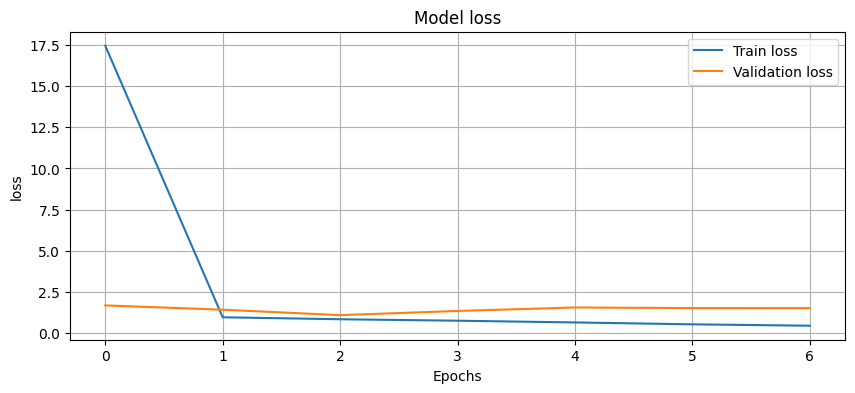

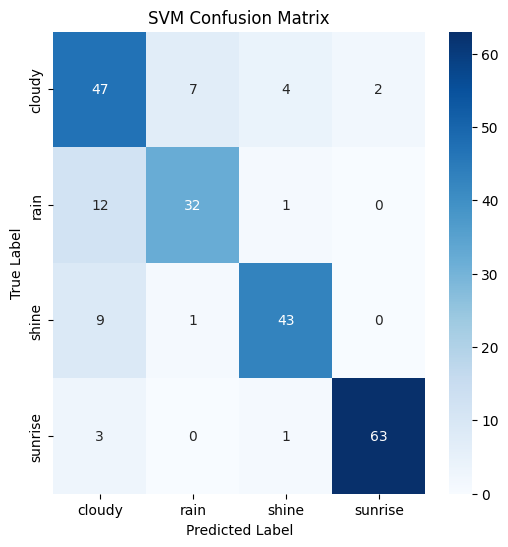

8/8 [==============================] - 1s 70ms/step


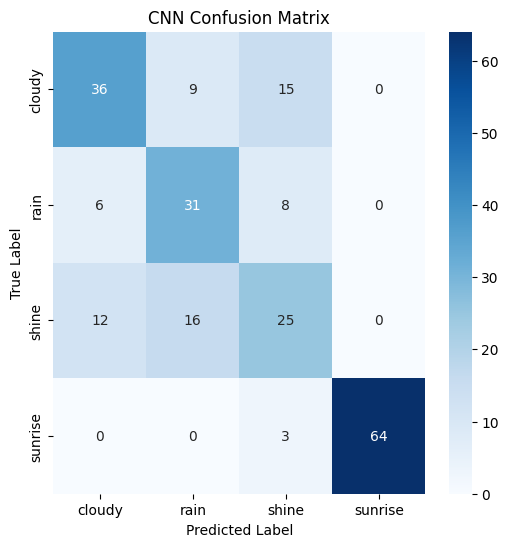

SVM Accuracy: 0.8088888888888889
              precision    recall  f1-score   support

      cloudy       0.64      0.75      0.69        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.79      0.83        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.80       225
weighted avg       0.82      0.81      0.81       225

Epoch 1/10
23/23 [==============================] - 8s 312ms/step - loss: 31.0579 - accuracy: 0.5070 - val_loss: 0.8613 - val_accuracy: 0.7111
Epoch 2/10
23/23 [==============================] - 8s 329ms/step - loss: 0.7302 - accuracy: 0.7270 - val_loss: 1.2705 - val_accuracy: 0.7389
Epoch 3/10
23/23 [==============================] - 7s 299ms/step - loss: 0.6566 - accuracy: 0.7730 - val_loss: 1.0313 - val_accuracy: 0.7667
Epoch 4/10
23/23 [==============================] - 7s 321ms/step - loss: 0.5121 - accuracy: 0.8092 - val

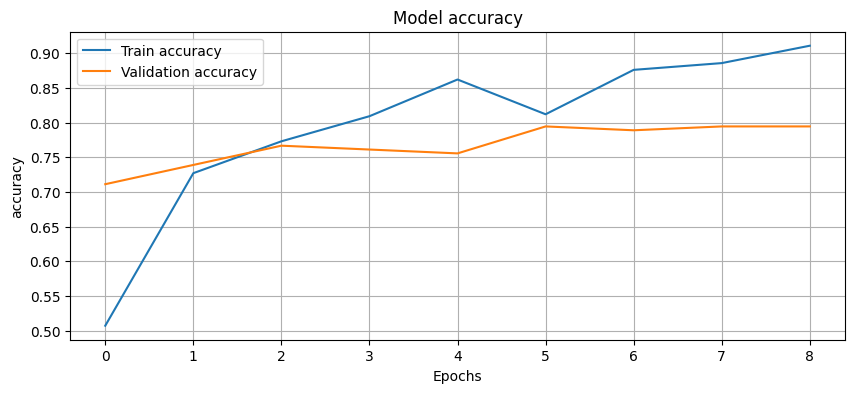

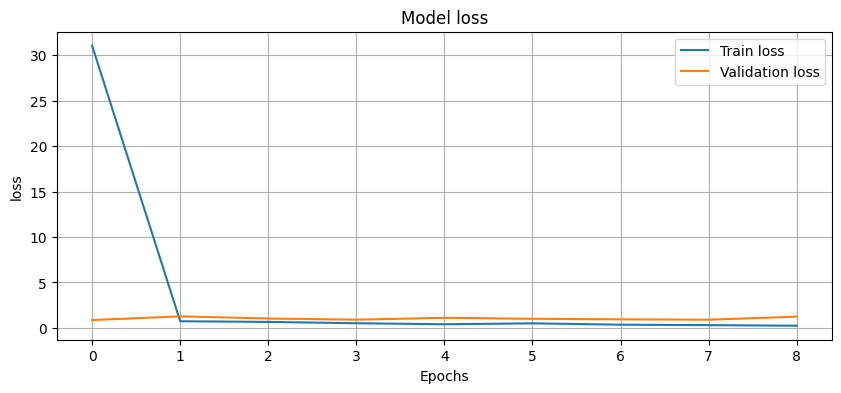

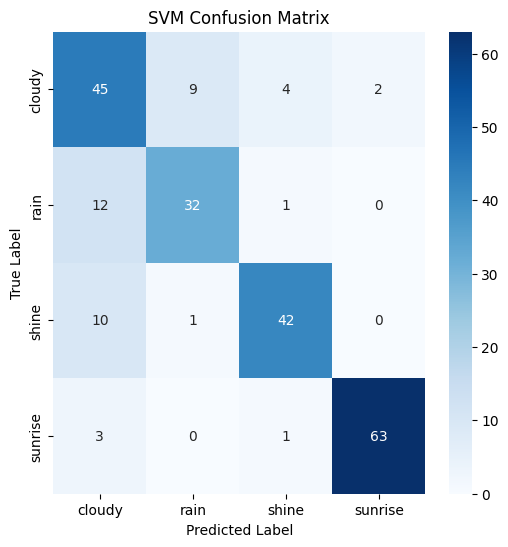

8/8 [==============================] - 1s 72ms/step


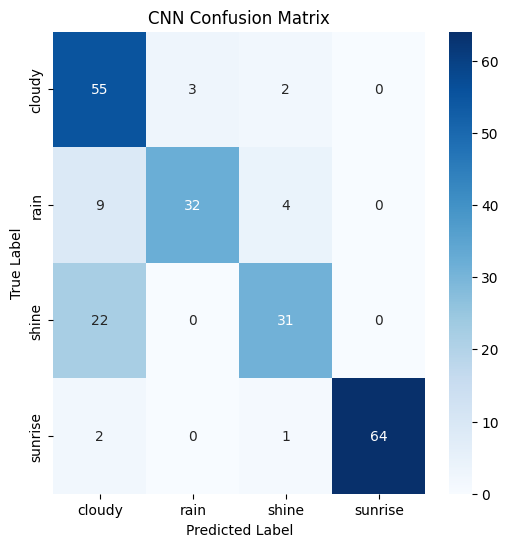

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 8s 304ms/step - loss: 20.0682 - accuracy: 0.5237 - val_loss: 1.1275 - val_accuracy: 0.6722
Epoch 2/10
23/23 [==============================] - 9s 375ms/step - loss: 0.6546 - accuracy: 0.7409 - val_loss: 1.1026 - val_accuracy: 0.6111
Epoch 3/10
23/23 [==============================] - 7s 284ms/step - loss: 0.5620 - accuracy: 0.7744 - val_loss: 1.0488 - val_accuracy: 0.8000
Epoch 4/10
23/23 [==============================] - 8s 355ms/step - loss: 0.4954 - accuracy: 0.8022 - val

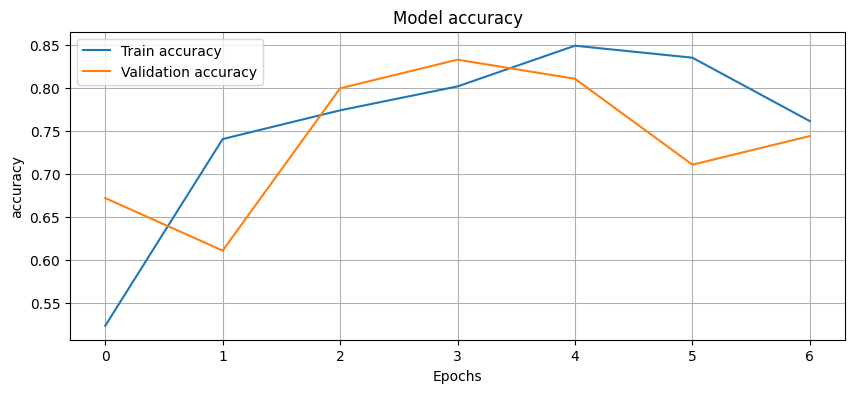

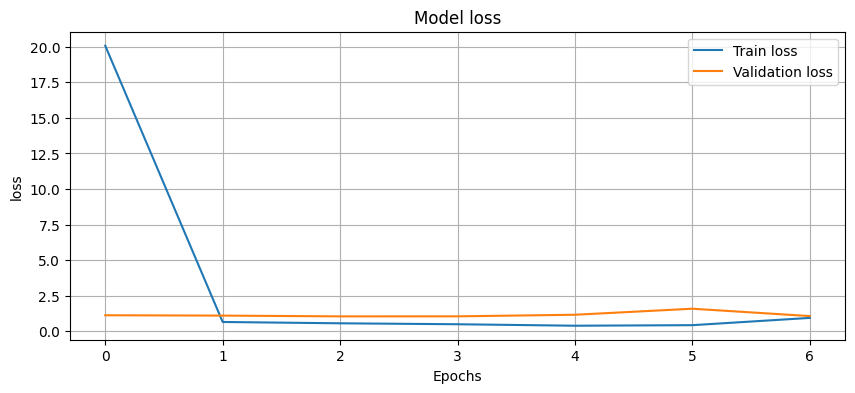

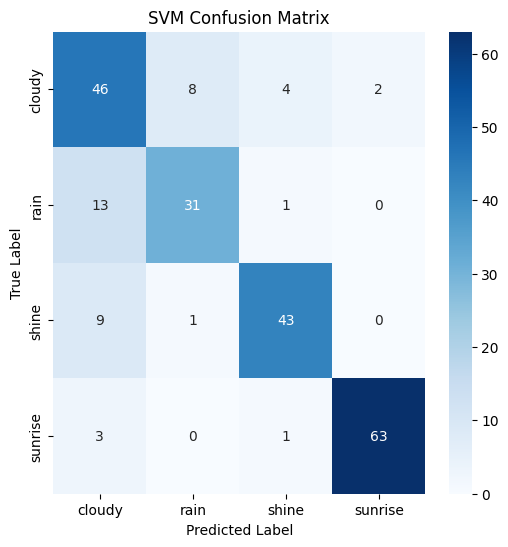

8/8 [==============================] - 1s 75ms/step


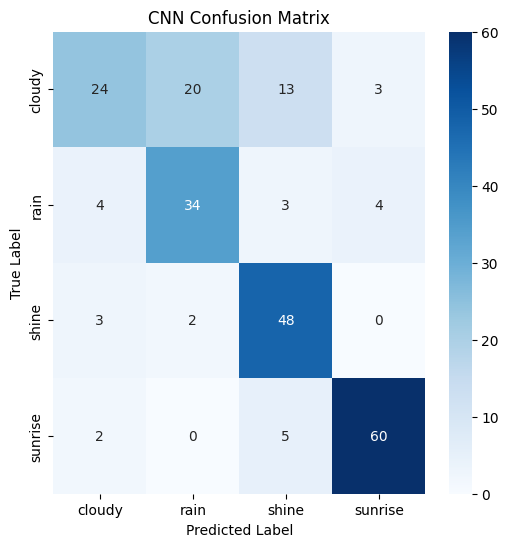

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.73      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 8s 311ms/step - loss: 15.0126 - accuracy: 0.5181 - val_loss: 0.9008 - val_accuracy: 0.7722
Epoch 2/10
23/23 [==============================] - 9s 377ms/step - loss: 0.5885 - accuracy: 0.7911 - val_loss: 0.9312 - val_accuracy: 0.7500
Epoch 3/10
23/23 [==============================] - 7s 295ms/step - loss: 0.5260 - accuracy: 0.7953 - val_loss: 0.8720 - val_accuracy: 0.8389
Epoch 4/10
23/23 [==============================] - 8s 363ms/step - loss: 0.4818 - accuracy: 0.8078 - val

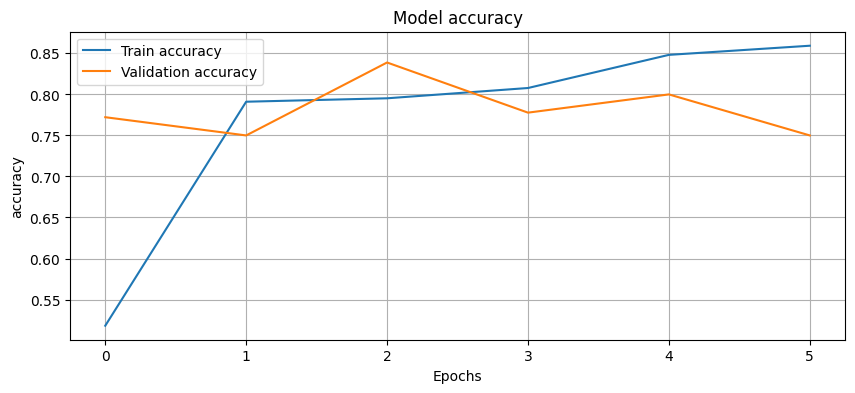

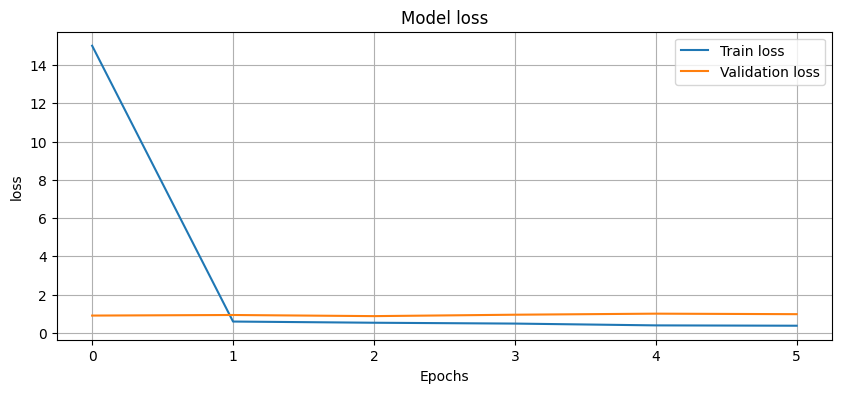

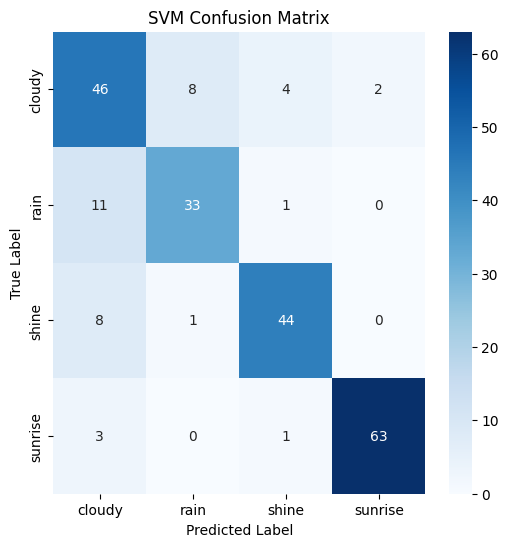

8/8 [==============================] - 1s 81ms/step


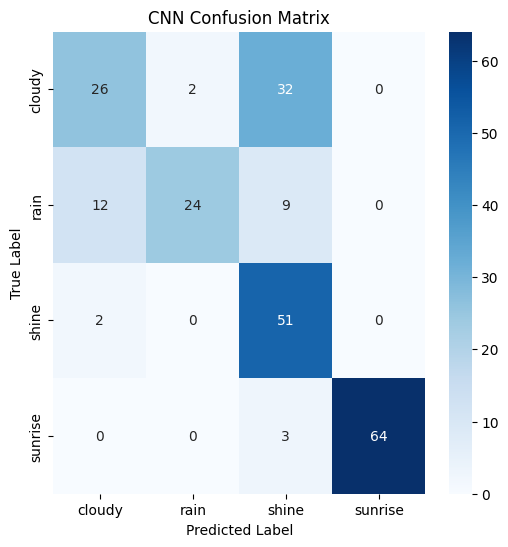

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 414ms/step - loss: 57.9387 - accuracy: 0.4554 - val_loss: 1.3078 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 7s 317ms/step - loss: 0.7836 - accuracy: 0.6769 - val_loss: 1.2683 - val_accuracy: 0.7778
Epoch 3/10
23/23 [==============================] - 9s 398ms/step - loss: 0.6522 - accuracy: 0.7702 - val_loss: 1.8165 - val_accuracy: 0.6333
Epoch 4/10
23/23 [==============================] - 7s 308ms/step - loss: 0.7041 - accuracy: 0.7061 - va

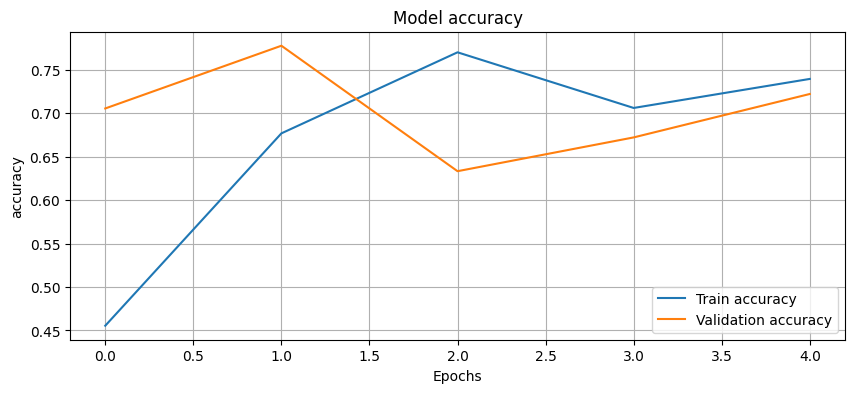

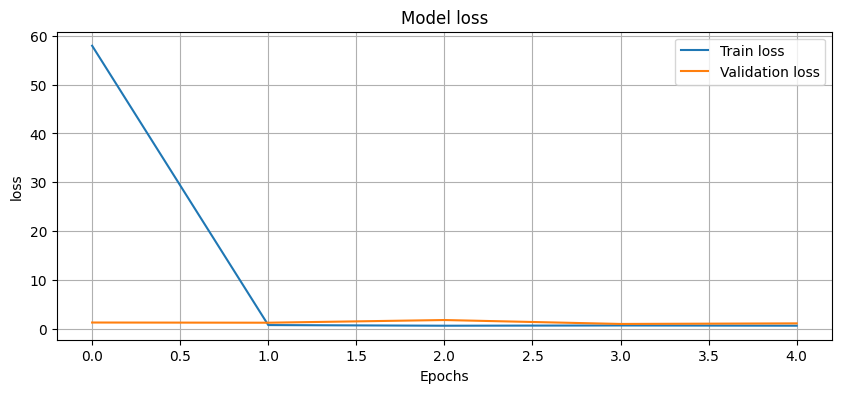

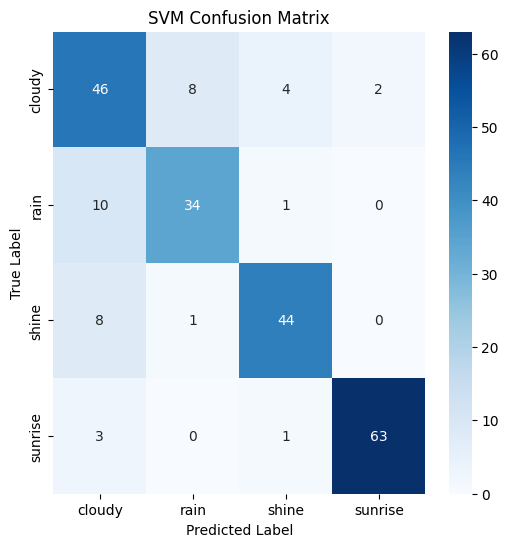

8/8 [==============================] - 1s 80ms/step


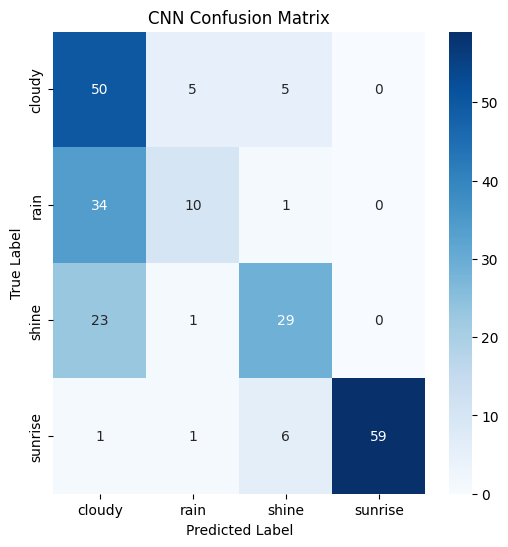

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 423ms/step - loss: 23.6335 - accuracy: 0.4694 - val_loss: 0.9365 - val_accuracy: 0.6389
Epoch 2/10
23/23 [==============================] - 8s 351ms/step - loss: 0.8661 - accuracy: 0.6616 - val_loss: 1.2084 - val_accuracy: 0.5944
Epoch 3/10
23/23 [==============================] - 9s 374ms/step - loss: 0.8126 - accuracy: 0.7047 - val_loss: 0.9919 - val_accuracy: 0.7000
Epoch 4/10
23/23 [==============================] - 9s 414ms/step - loss: 0.6584 - accuracy: 0.7827 - va

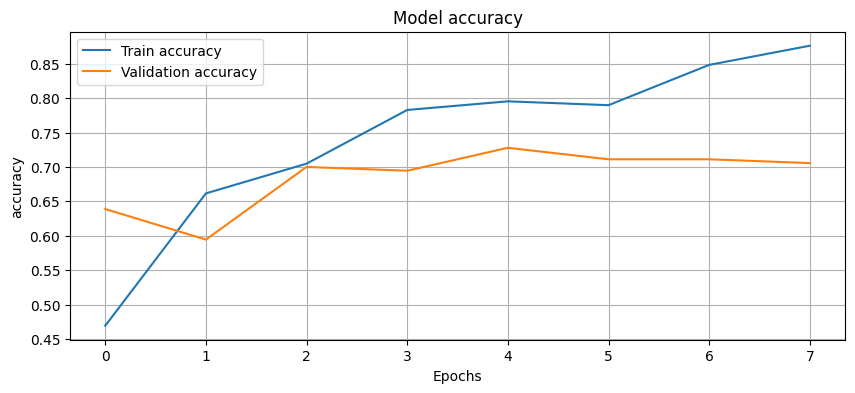

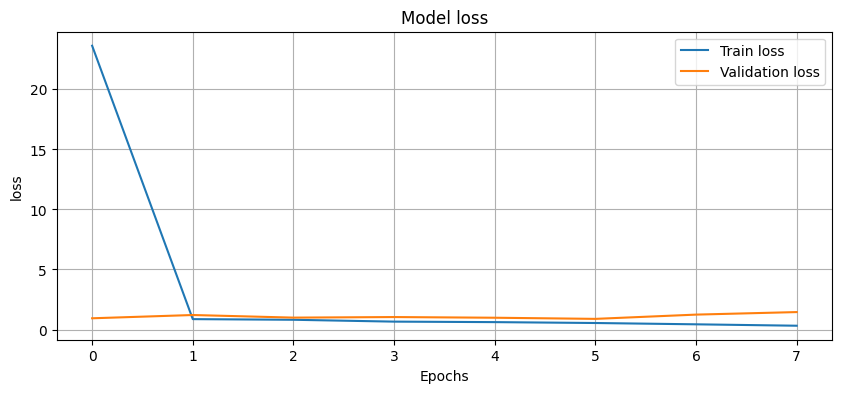

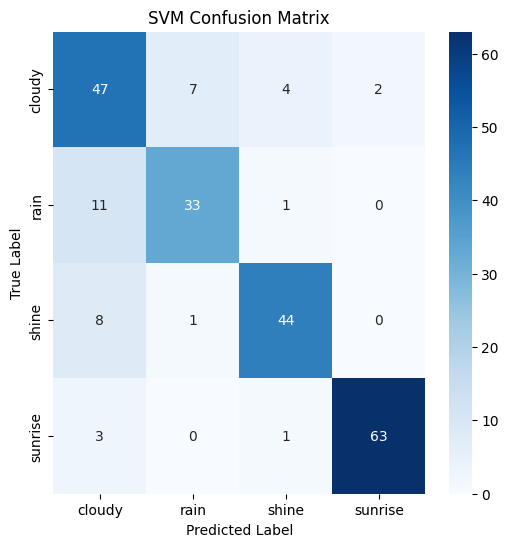

8/8 [==============================] - 1s 84ms/step


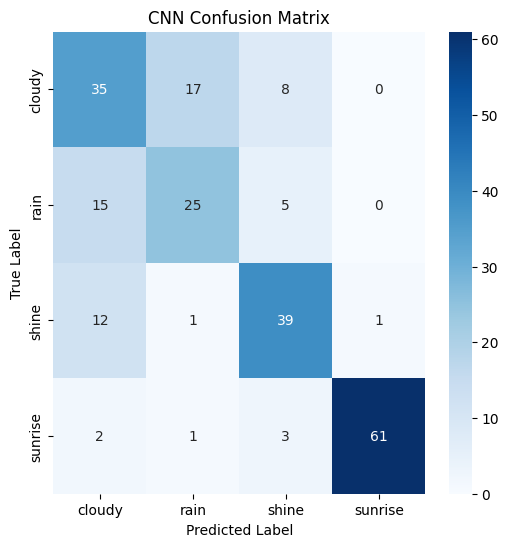

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.71      0.74        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 10s 407ms/step - loss: 12.8195 - accuracy: 0.4582 - val_loss: 1.0915 - val_accuracy: 0.5389
Epoch 2/10
23/23 [==============================] - 7s 327ms/step - loss: 0.9198 - accuracy: 0.5780 - val_loss: 1.2144 - val_accuracy: 0.6333
Epoch 3/10
23/23 [==============================] - 9s 414ms/step - loss: 0.7961 - accuracy: 0.6671 - val_loss: 1.5136 - val_accuracy: 0.6222
Epoch 4/10
23/23 [==============================] - 9s 388ms/step - loss: 0.8877 - accuracy: 0.6671 - va

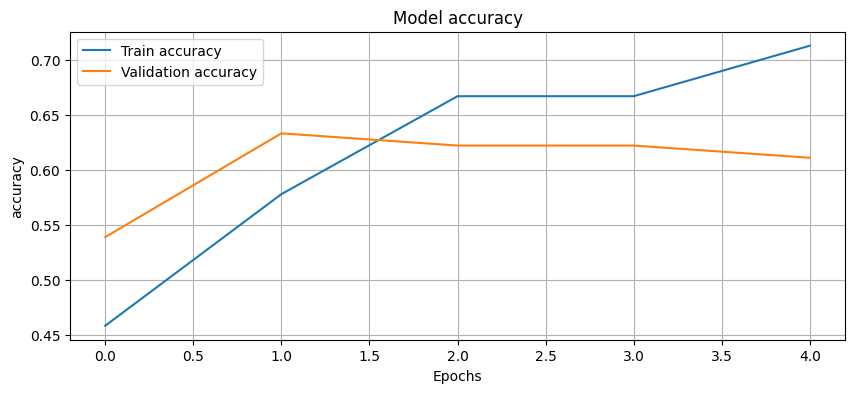

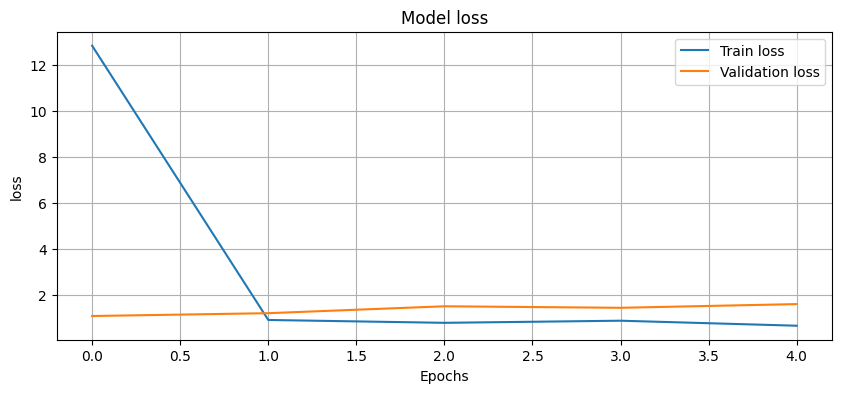

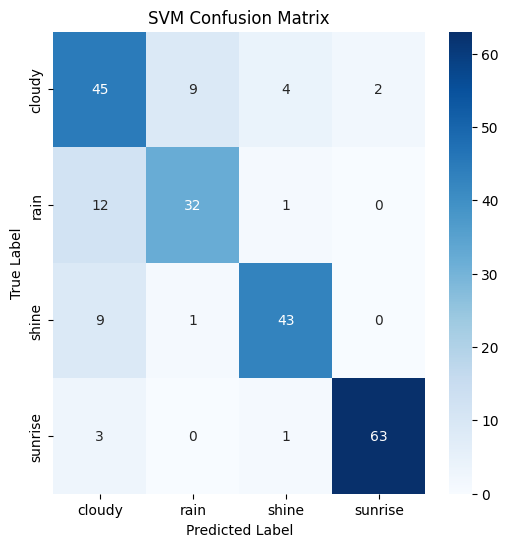

8/8 [==============================] - 1s 86ms/step


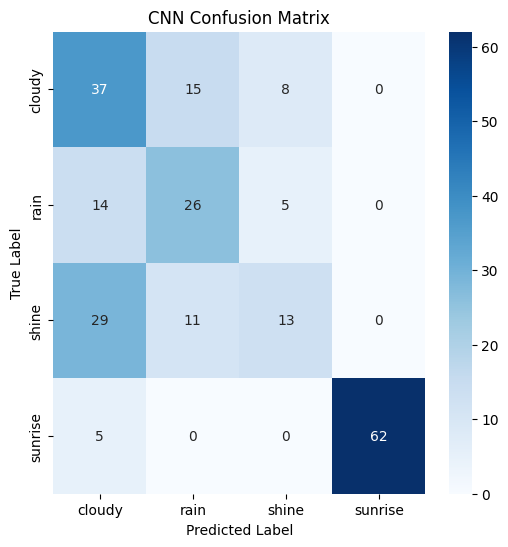

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 10s 355ms/step - loss: 24.3804 - accuracy: 0.4318 - val_loss: 1.0297 - val_accuracy: 0.6778
Epoch 2/10
23/23 [==============================] - 9s 410ms/step - loss: 0.8552 - accuracy: 0.6769 - val_loss: 1.1416 - val_accuracy: 0.7667
Epoch 3/10
23/23 [==============================] - 8s 340ms/step - loss: 0.6722 - accuracy: 0.7646 - val_loss: 1.3389 - val_accuracy: 0.6833
Epoch 4/10
23/23 [==============================] - 10s 425ms/step - loss: 0.5617 - accuracy: 0.7897 - v

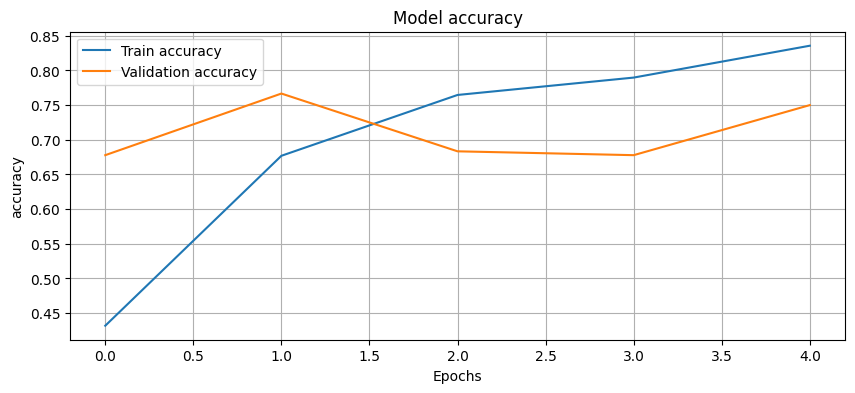

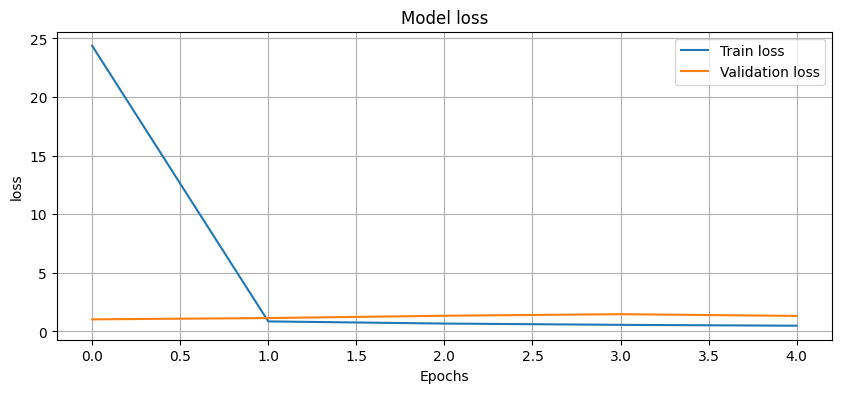

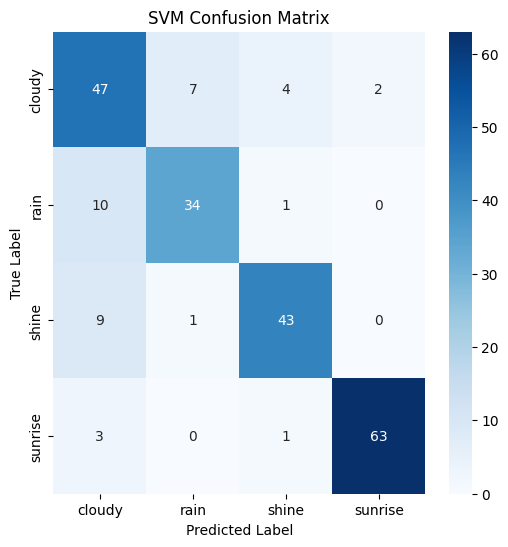

8/8 [==============================] - 1s 88ms/step


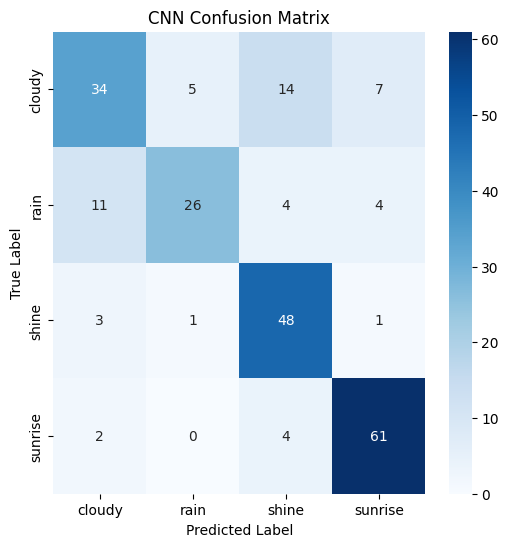

SVM Accuracy: 0.8177777777777778
              precision    recall  f1-score   support

      cloudy       0.66      0.77      0.71        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.81       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 9s 336ms/step - loss: 34.1242 - accuracy: 0.5181 - val_loss: 0.9418 - val_accuracy: 0.5889
Epoch 2/10
23/23 [==============================] - 9s 392ms/step - loss: 0.7471 - accuracy: 0.6448 - val_loss: 0.9788 - val_accuracy: 0.7222
Epoch 3/10
23/23 [==============================] - 9s 394ms/step - loss: 0.8222 - accuracy: 0.7423 - val_loss: 0.7982 - val_accuracy: 0.7833
Epoch 4/10
23/23 [==============================] - 8s 322ms/step - loss: 0.6252 - accuracy: 0.7437 - val

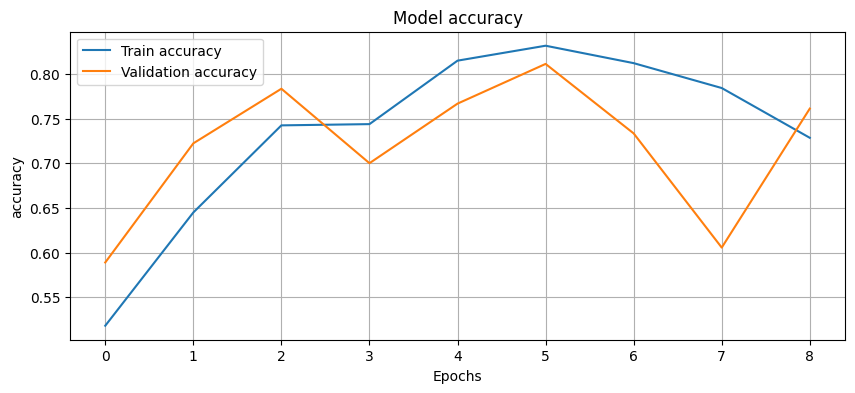

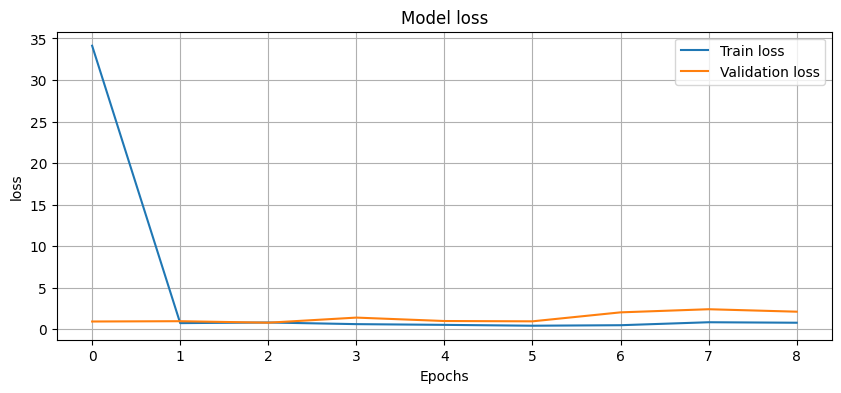

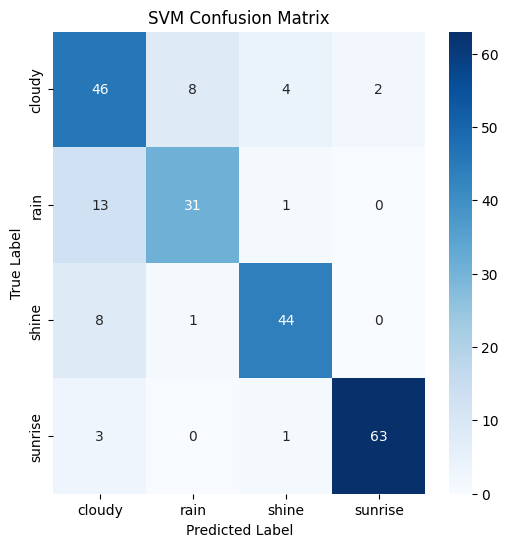

8/8 [==============================] - 1s 116ms/step


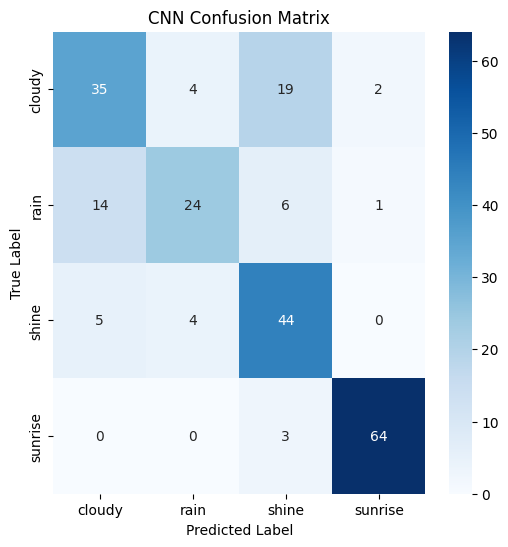

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.69      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 422ms/step - loss: 16.1406 - accuracy: 0.4582 - val_loss: 0.9104 - val_accuracy: 0.6778
Epoch 2/10
23/23 [==============================] - 8s 339ms/step - loss: 0.8504 - accuracy: 0.6908 - val_loss: 1.0358 - val_accuracy: 0.6333
Epoch 3/10
23/23 [==============================] - 10s 420ms/step - loss: 0.6970 - accuracy: 0.7145 - val_loss: 1.0064 - val_accuracy: 0.6333
Epoch 4/10
23/23 [==============================] - 8s 338ms/step - loss: 0.7806 - accuracy: 0.6866 - v

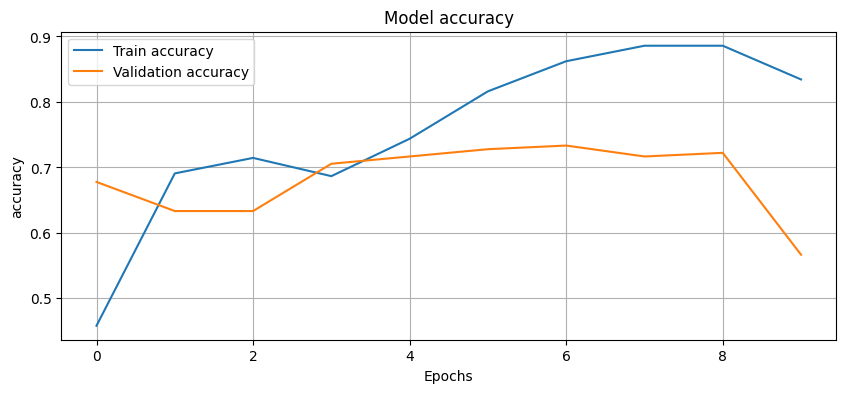

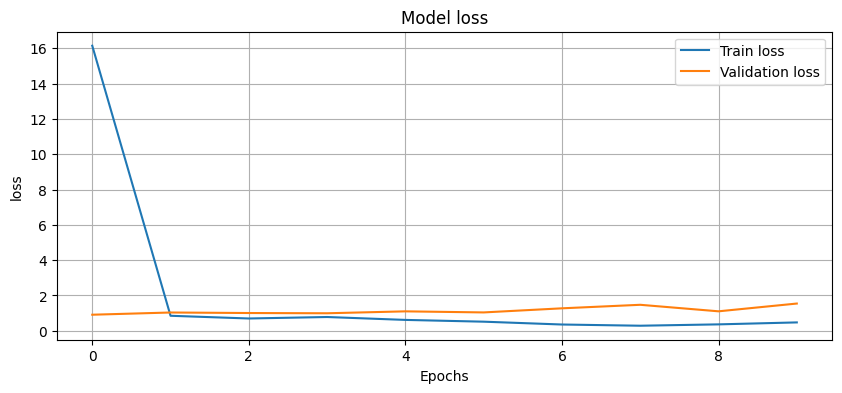

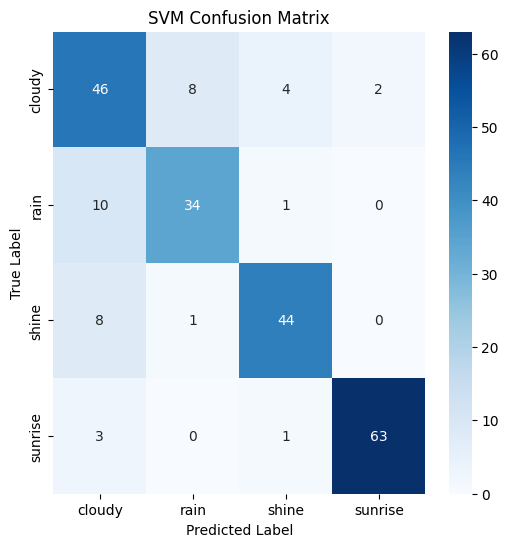

8/8 [==============================] - 1s 95ms/step


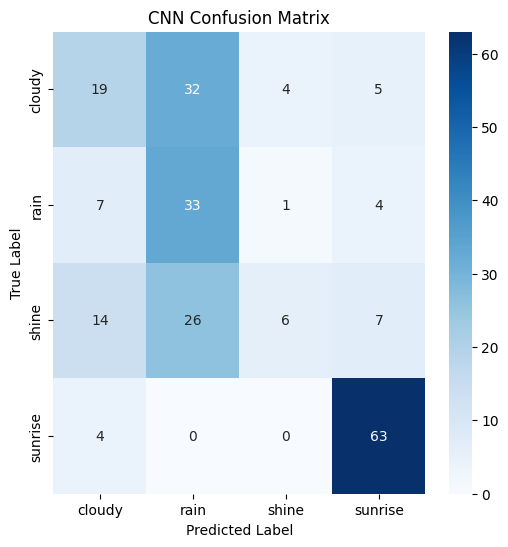

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.77      0.70        60
        rain       0.78      0.69      0.73        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.82      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 436ms/step - loss: 29.3728 - accuracy: 0.4847 - val_loss: 1.1607 - val_accuracy: 0.6167
Epoch 2/10
23/23 [==============================] - 10s 430ms/step - loss: 0.8921 - accuracy: 0.6574 - val_loss: 1.1407 - val_accuracy: 0.8222
Epoch 3/10
23/23 [==============================] - 8s 365ms/step - loss: 0.8177 - accuracy: 0.7242 - val_loss: 1.3794 - val_accuracy: 0.7167
Epoch 4/10
23/23 [==============================] - 10s 433ms/step - loss: 0.6784 - accuracy: 0.7786 - 

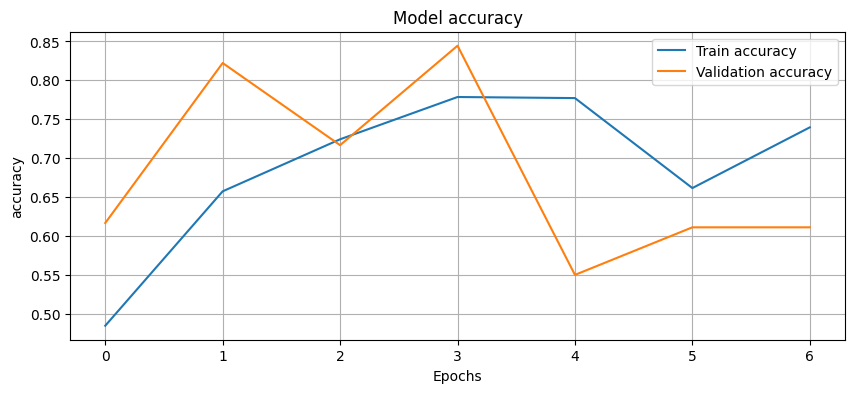

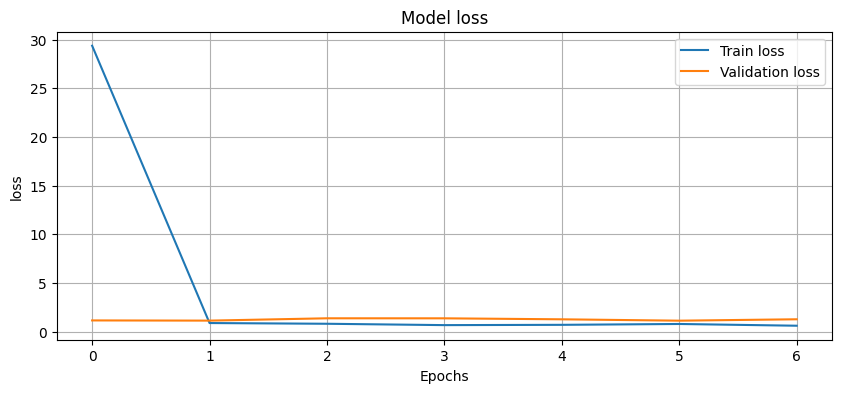

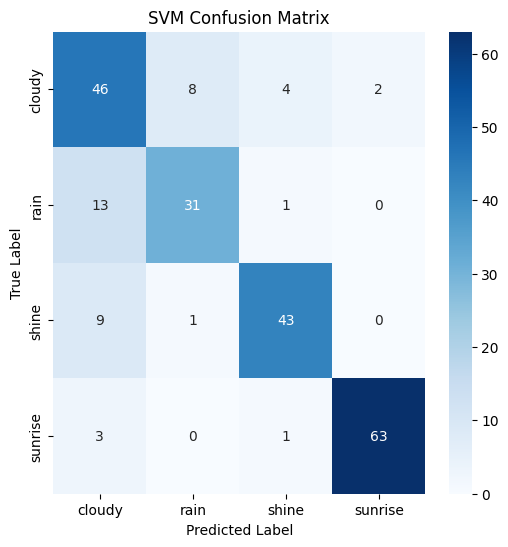

8/8 [==============================] - 1s 92ms/step


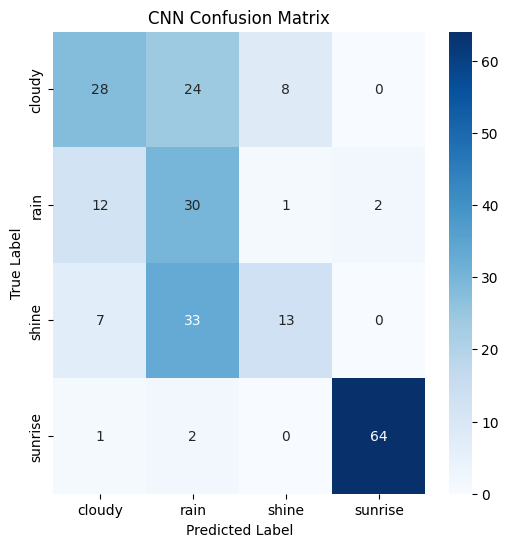

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.67      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 454ms/step - loss: 22.1420 - accuracy: 0.5599 - val_loss: 1.1391 - val_accuracy: 0.7611
Epoch 2/10
23/23 [==============================] - 10s 434ms/step - loss: 0.6497 - accuracy: 0.7465 - val_loss: 1.2610 - val_accuracy: 0.7111
Epoch 3/10
23/23 [==============================] - 9s 370ms/step - loss: 0.5874 - accuracy: 0.7660 - val_loss: 1.1714 - val_accuracy: 0.7444
Epoch 4/10
23/23 [==============================] - 10s 441ms/step - loss: 0.4329 - accuracy: 0.8203 - 

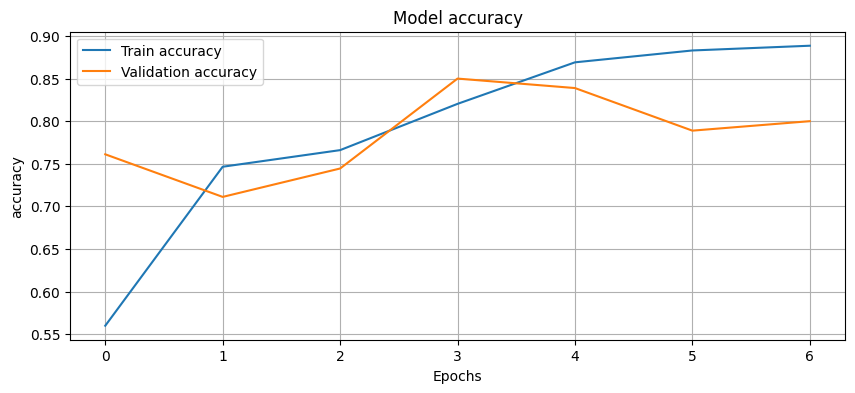

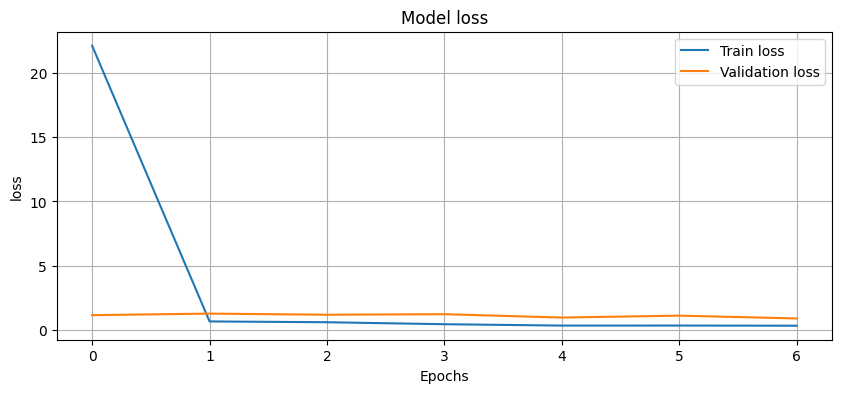

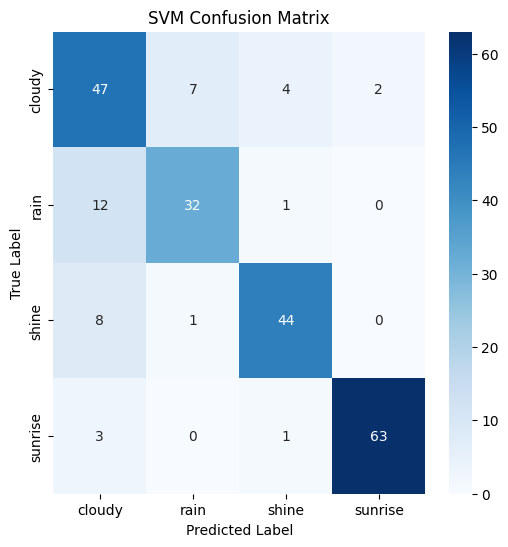

8/8 [==============================] - 1s 99ms/step


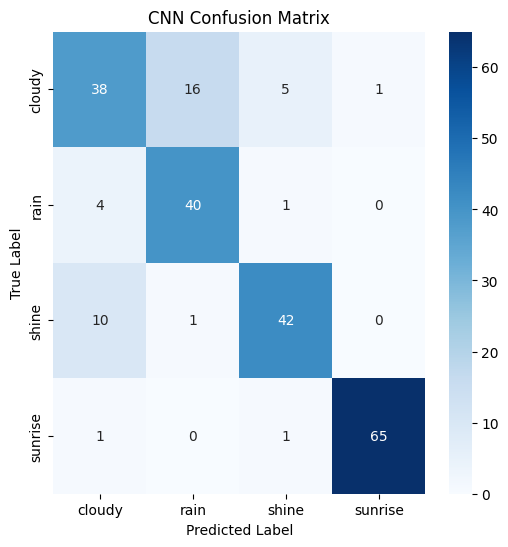

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 11s 425ms/step - loss: 28.7880 - accuracy: 0.4624 - val_loss: 1.3197 - val_accuracy: 0.5944
Epoch 2/10
23/23 [==============================] - 10s 438ms/step - loss: 0.8664 - accuracy: 0.6685 - val_loss: 0.9569 - val_accuracy: 0.6944
Epoch 3/10
23/23 [==============================] - 8s 357ms/step - loss: 0.5127 - accuracy: 0.8273 - val_loss: 1.0271 - val_accuracy: 0.8444
Epoch 4/10
23/23 [==============================] - 10s 437ms/step - loss: 0.3695 - accuracy: 0.8788 - 

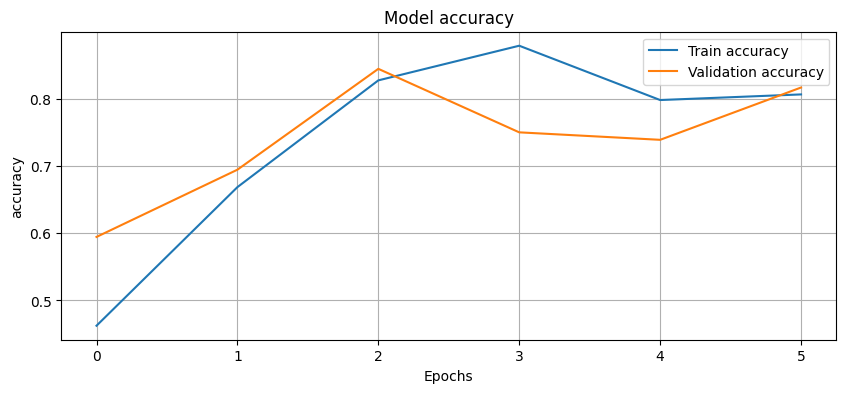

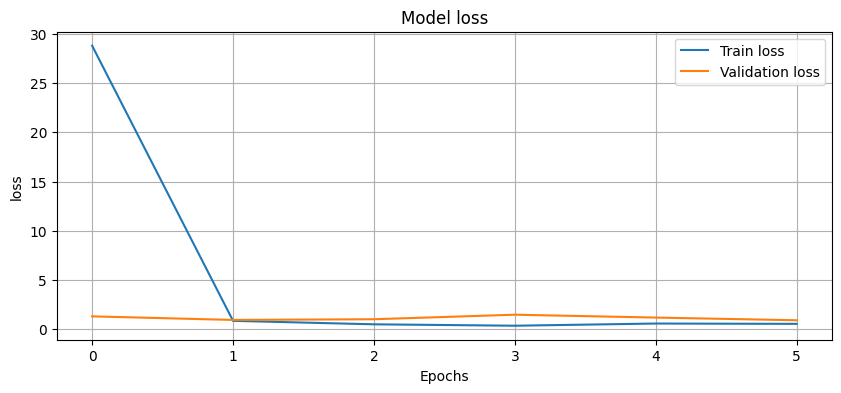

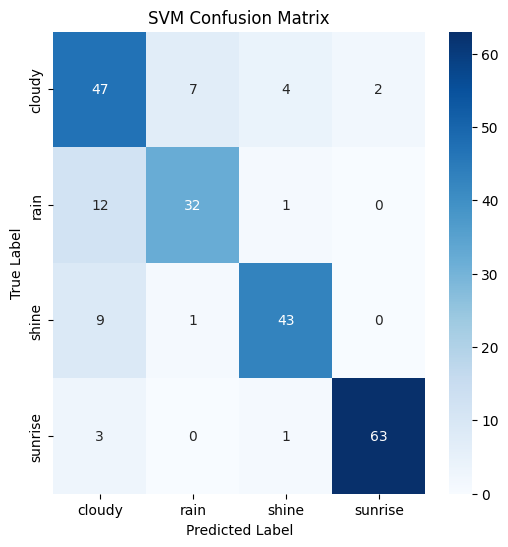

8/8 [==============================] - 1s 137ms/step


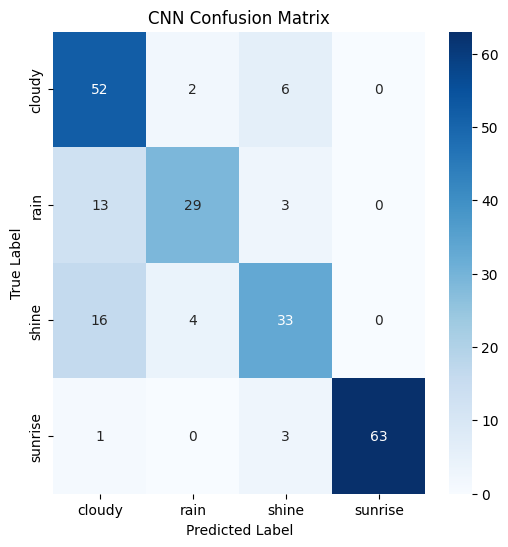

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 11s 428ms/step - loss: 26.5816 - accuracy: 0.3900 - val_loss: 1.0445 - val_accuracy: 0.5278
Epoch 2/10
23/23 [==============================] - 11s 470ms/step - loss: 0.9682 - accuracy: 0.6003 - val_loss: 1.0511 - val_accuracy: 0.5667
Epoch 3/10
23/23 [==============================] - 10s 443ms/step - loss: 0.9532 - accuracy: 0.5780 - val_loss: 1.2083 - val_accuracy: 0.5944
Epoch 4/10
23/23 [==============================] - 9s 399ms/step - loss: 0.8301 - accuracy: 0.6518 - 

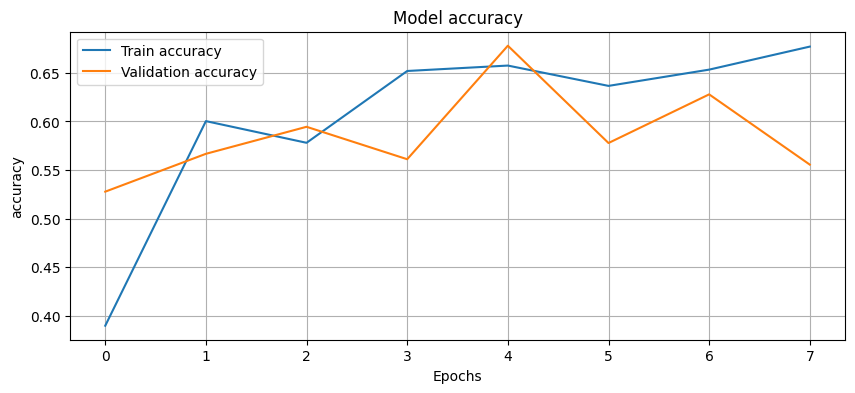

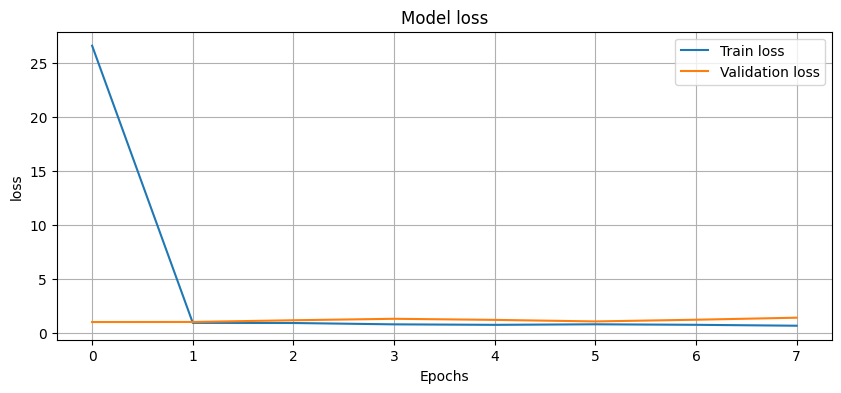

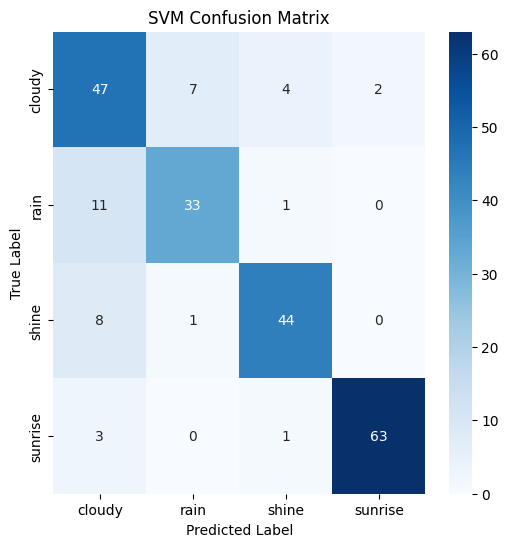

8/8 [==============================] - 1s 101ms/step


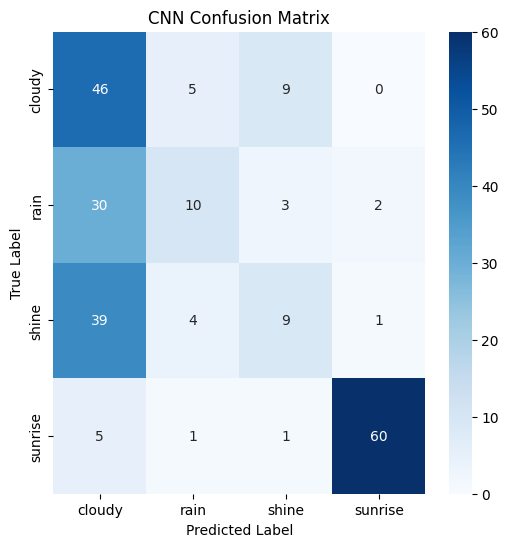

SVM Accuracy: 0.8133333333333334
              precision    recall  f1-score   support

      cloudy       0.65      0.75      0.70        60
        rain       0.76      0.69      0.72        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.81       225
   macro avg       0.81      0.80      0.81       225
weighted avg       0.82      0.81      0.82       225

Epoch 1/10
23/23 [==============================] - 12s 458ms/step - loss: 40.0479 - accuracy: 0.4485 - val_loss: 0.8015 - val_accuracy: 0.6278
Epoch 2/10
23/23 [==============================] - 11s 470ms/step - loss: 0.7231 - accuracy: 0.7047 - val_loss: 0.9493 - val_accuracy: 0.7056
Epoch 3/10
23/23 [==============================] - 10s 453ms/step - loss: 0.6962 - accuracy: 0.7409 - val_loss: 1.0921 - val_accuracy: 0.7611
Epoch 4/10
23/23 [==============================] - 10s 414ms/step - loss: 0.6147 - accuracy: 0.8120 -

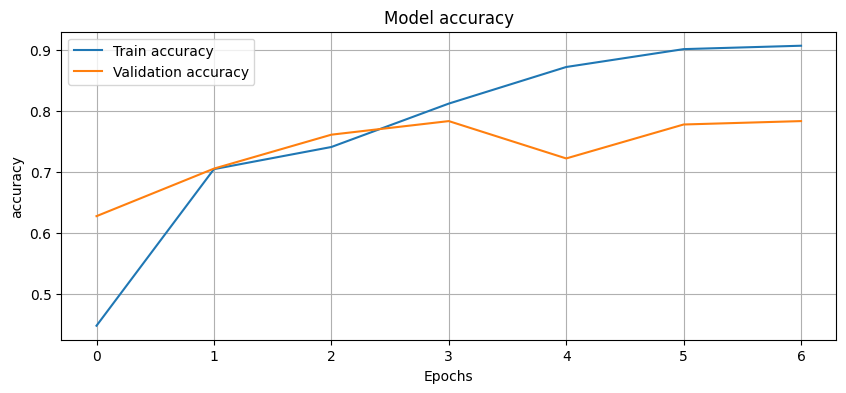

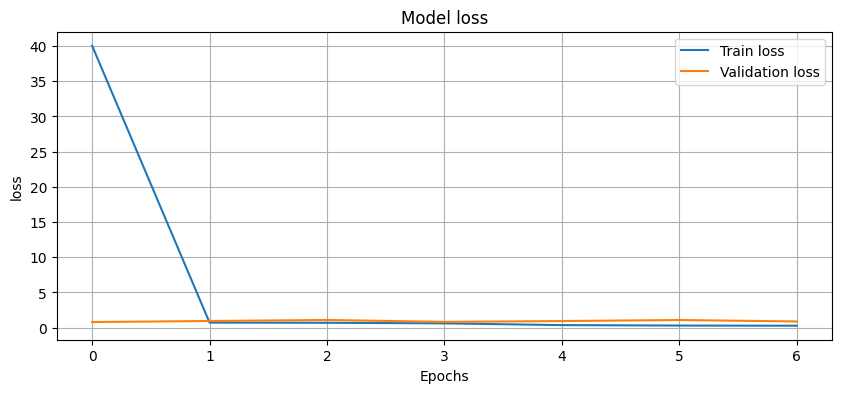

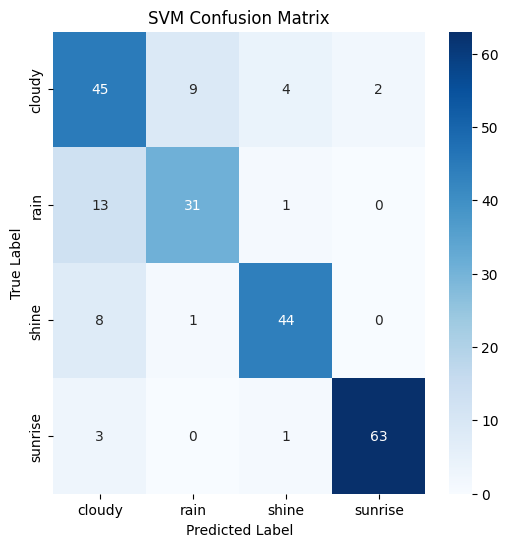

8/8 [==============================] - 1s 103ms/step


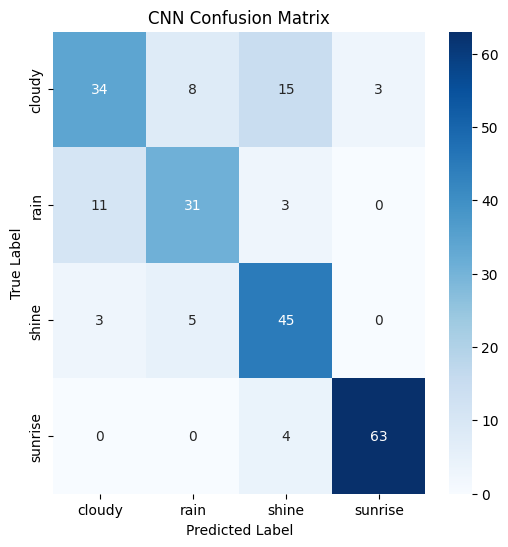

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.66      0.78      0.72        60
        rain       0.80      0.71      0.75        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.83      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 12s 476ms/step - loss: 33.3052 - accuracy: 0.5529 - val_loss: 1.1507 - val_accuracy: 0.7056
Epoch 2/10
23/23 [==============================] - 11s 486ms/step - loss: 0.7098 - accuracy: 0.7270 - val_loss: 0.9053 - val_accuracy: 0.7278
Epoch 3/10
23/23 [==============================] - 10s 454ms/step - loss: 0.7239 - accuracy: 0.7033 - val_loss: 1.0406 - val_accuracy: 0.7722
Epoch 4/10
23/23 [==============================] - 10s 410ms/step - loss: 0.6107 - accuracy: 0.8120 -

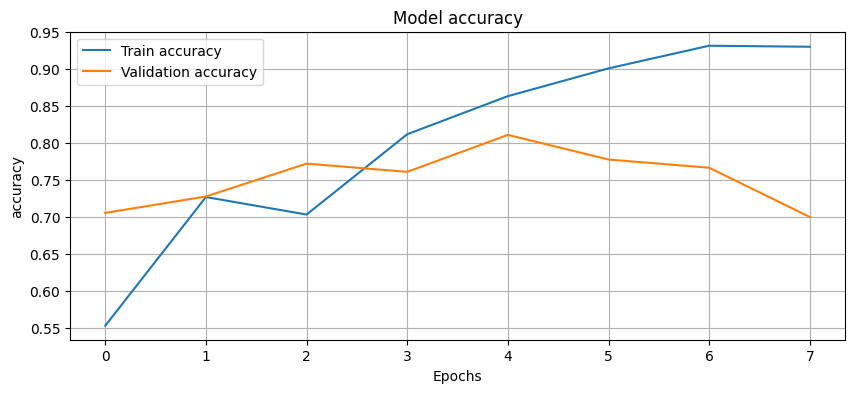

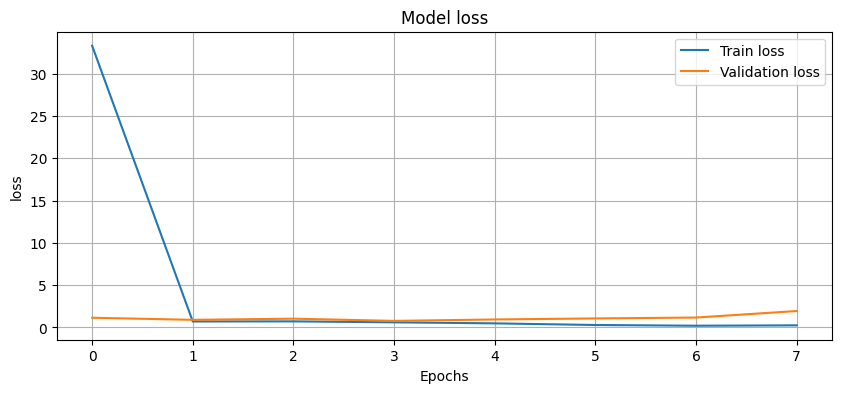

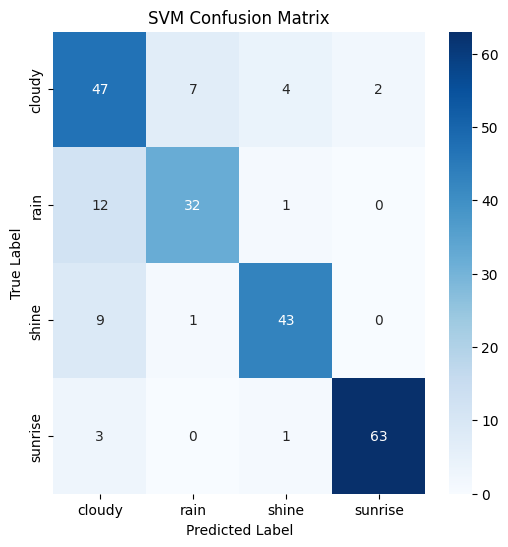

8/8 [==============================] - 1s 108ms/step


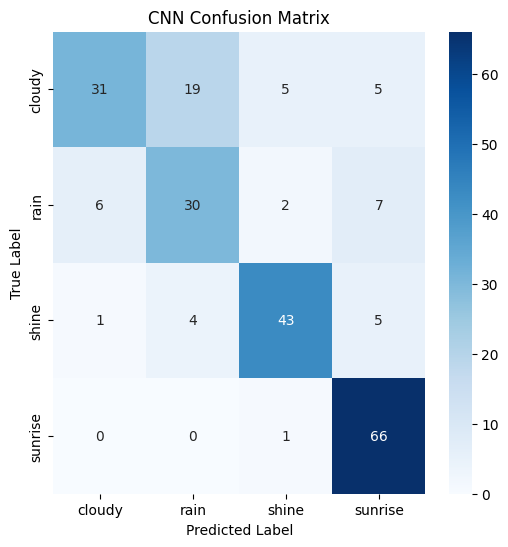

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 12s 500ms/step - loss: 19.1016 - accuracy: 0.5390 - val_loss: 1.4884 - val_accuracy: 0.5222
Epoch 2/10
23/23 [==============================] - 11s 490ms/step - loss: 0.9141 - accuracy: 0.5710 - val_loss: 1.0784 - val_accuracy: 0.7444
Epoch 3/10
23/23 [==============================] - 11s 477ms/step - loss: 0.8134 - accuracy: 0.6825 - val_loss: 1.5196 - val_accuracy: 0.6944
Epoch 4/10
23/23 [==============================] - 10s 432ms/step - loss: 0.6221 - accuracy: 0.7646 -

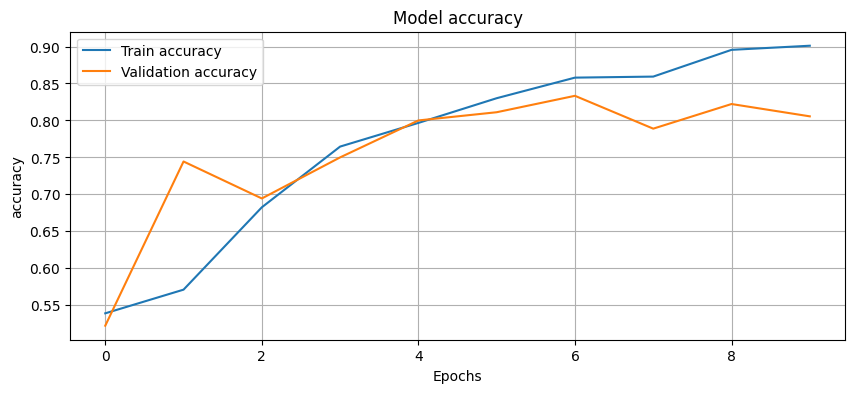

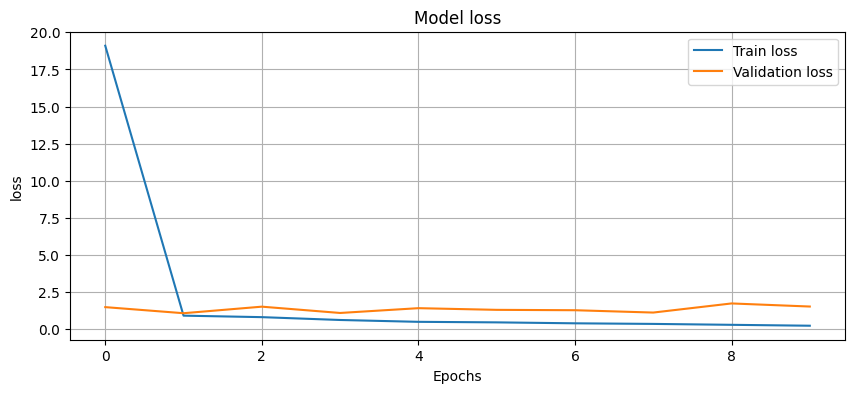

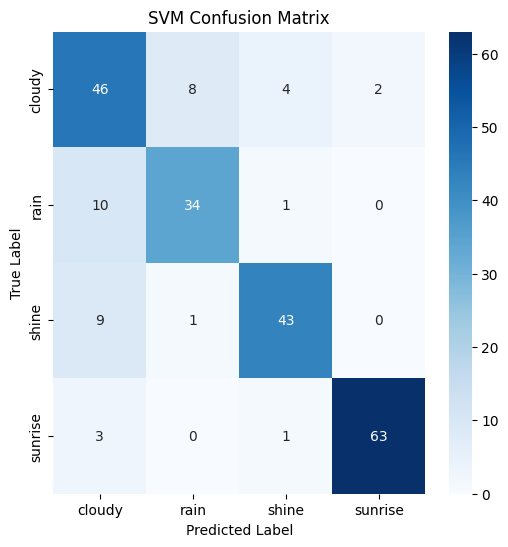

8/8 [==============================] - 1s 155ms/step


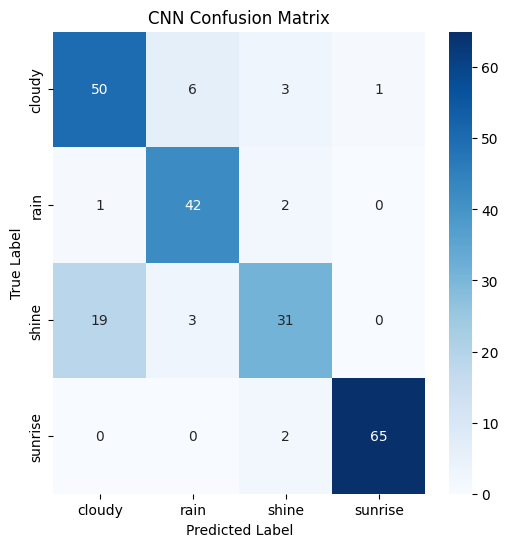

SVM Accuracy: 0.8355555555555556
              precision    recall  f1-score   support

      cloudy       0.69      0.78      0.73        60
        rain       0.81      0.78      0.80        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.84       225
   macro avg       0.84      0.83      0.83       225
weighted avg       0.84      0.84      0.84       225

Epoch 1/10
23/23 [==============================] - 14s 522ms/step - loss: 45.9107 - accuracy: 0.4666 - val_loss: 1.0107 - val_accuracy: 0.5444
Epoch 2/10
23/23 [==============================] - 11s 469ms/step - loss: 0.9435 - accuracy: 0.6267 - val_loss: 1.4178 - val_accuracy: 0.6167
Epoch 3/10
23/23 [==============================] - 11s 455ms/step - loss: 0.8837 - accuracy: 0.6504 - val_loss: 1.0911 - val_accuracy: 0.6611
Epoch 4/10
23/23 [==============================] - 12s 504ms/step - loss: 0.7075 - accuracy: 0.7228 -

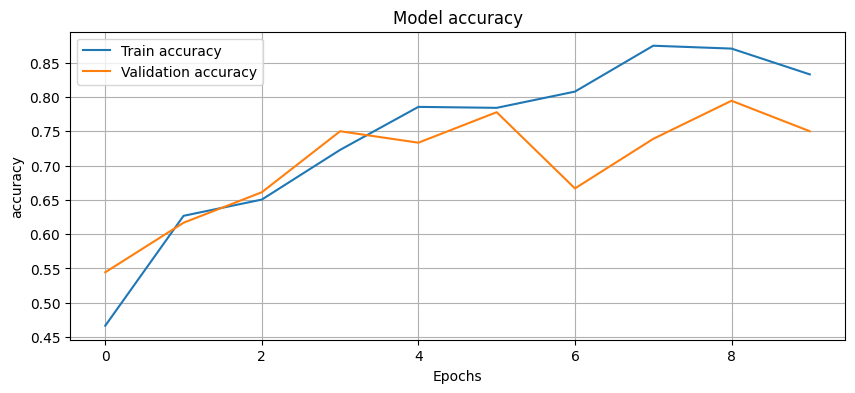

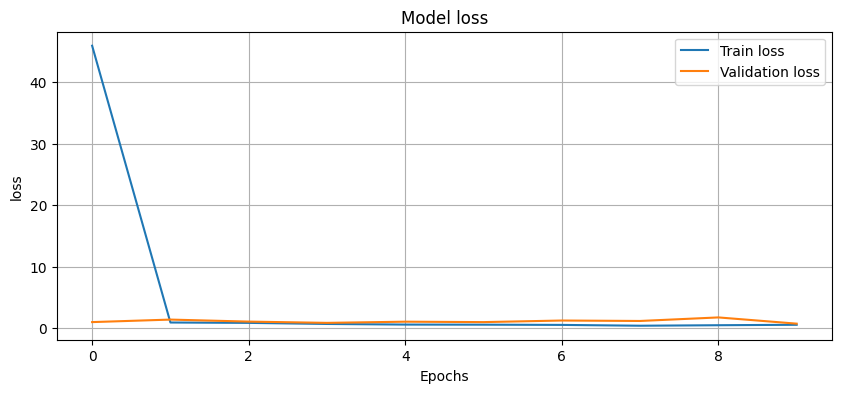

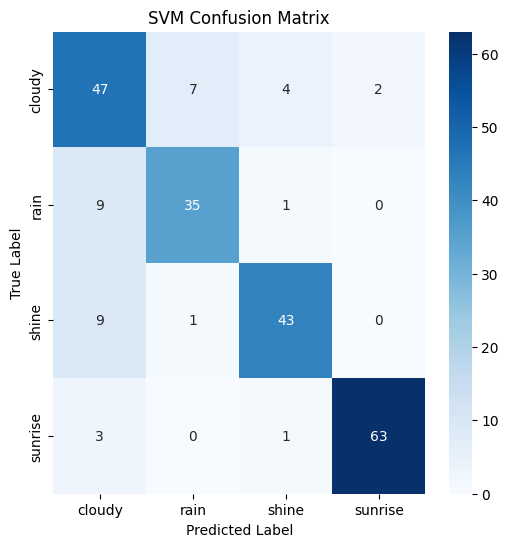

8/8 [==============================] - 1s 122ms/step


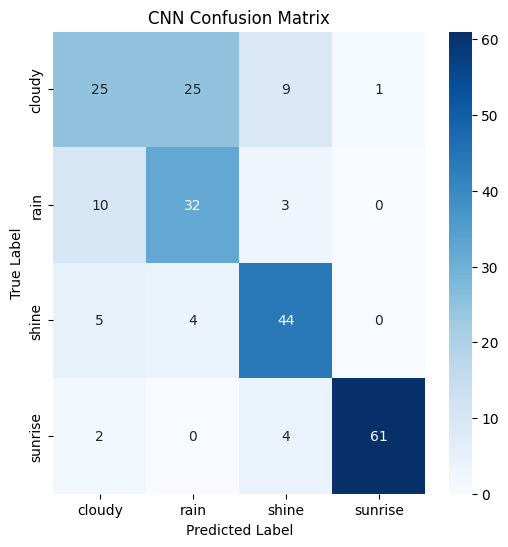

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.81      0.76      0.78        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 12s 481ms/step - loss: 38.6259 - accuracy: 0.4666 - val_loss: 0.9722 - val_accuracy: 0.6667
Epoch 2/10
23/23 [==============================] - 11s 472ms/step - loss: 0.8588 - accuracy: 0.6045 - val_loss: 1.0042 - val_accuracy: 0.6111
Epoch 3/10
23/23 [==============================] - 12s 514ms/step - loss: 0.6466 - accuracy: 0.7437 - val_loss: 1.0890 - val_accuracy: 0.6889
Epoch 4/10
23/23 [==============================] - 12s 507ms/step - loss: 0.5311 - accuracy: 0.8203 -

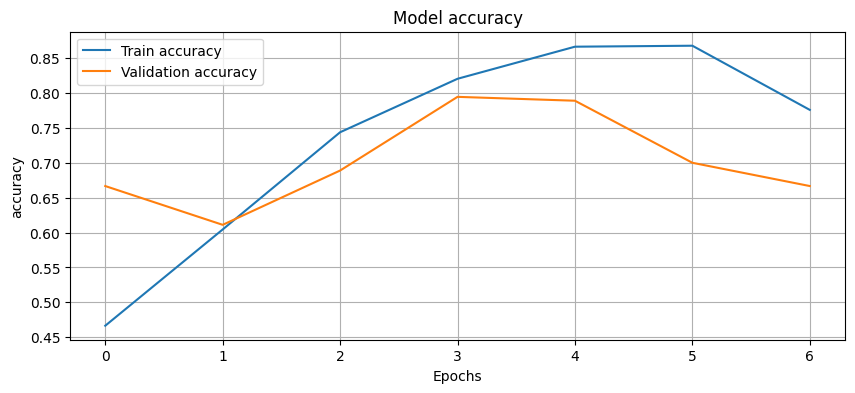

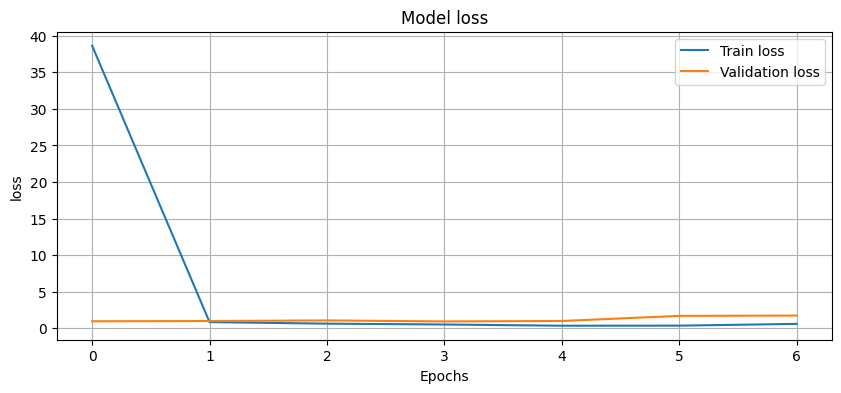

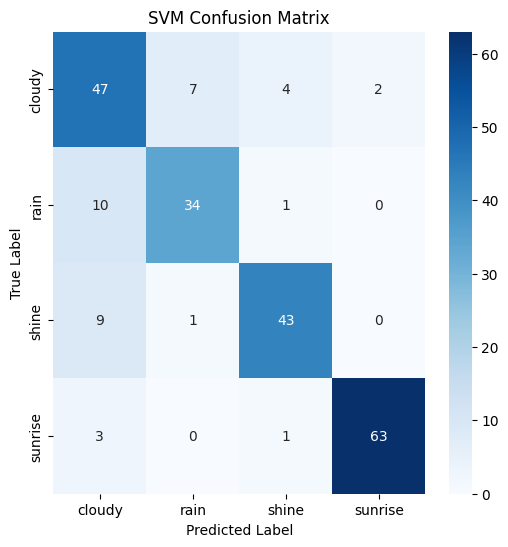

8/8 [==============================] - 1s 165ms/step


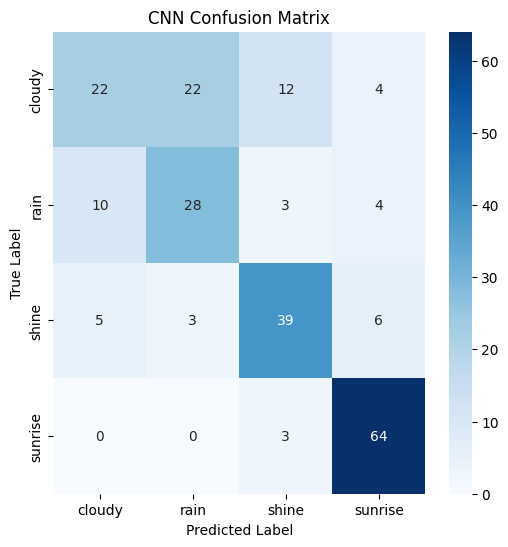

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.75      0.71        60
        rain       0.77      0.76      0.76        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 13s 540ms/step - loss: 16.0479 - accuracy: 0.4220 - val_loss: 1.0909 - val_accuracy: 0.4833
Epoch 2/10
23/23 [==============================] - 12s 526ms/step - loss: 0.7765 - accuracy: 0.6908 - val_loss: 0.9951 - val_accuracy: 0.7000
Epoch 3/10
23/23 [==============================] - 11s 473ms/step - loss: 0.7085 - accuracy: 0.7423 - val_loss: 1.0221 - val_accuracy: 0.7778
Epoch 4/10
23/23 [==============================] - 12s 514ms/step - loss: 0.5839 - accuracy: 0.8217 -

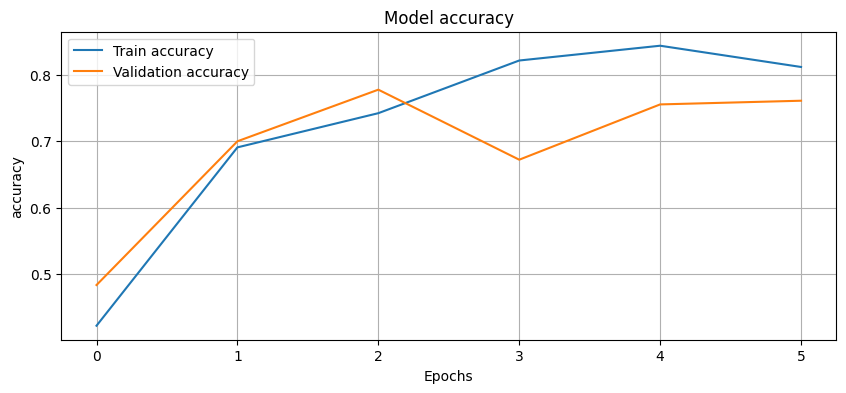

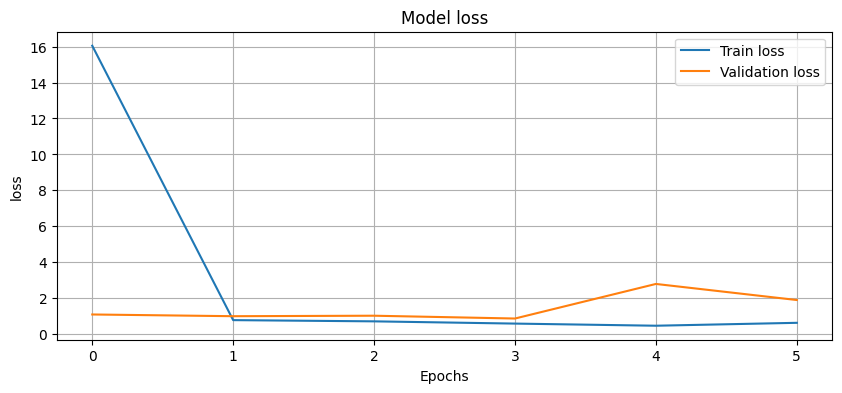

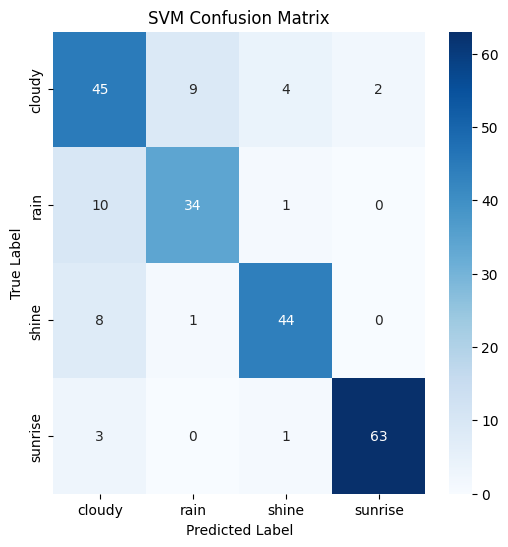

8/8 [==============================] - 1s 123ms/step


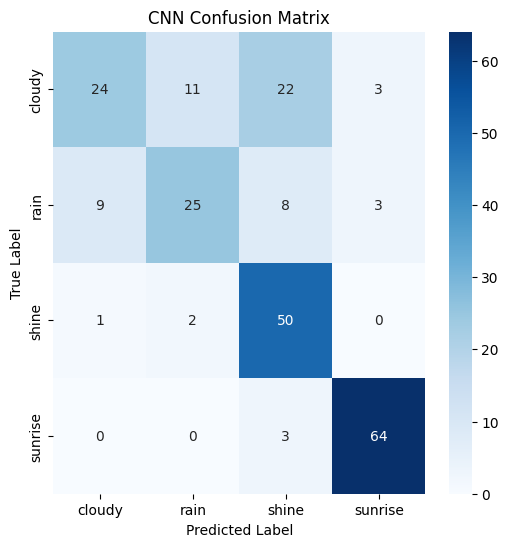

SVM Accuracy: 0.8222222222222222
              precision    recall  f1-score   support

      cloudy       0.67      0.77      0.71        60
        rain       0.78      0.71      0.74        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.82       225
   macro avg       0.82      0.81      0.82       225
weighted avg       0.83      0.82      0.82       225

Epoch 1/10
23/23 [==============================] - 14s 573ms/step - loss: 20.8191 - accuracy: 0.5376 - val_loss: 1.1076 - val_accuracy: 0.6389
Epoch 2/10
23/23 [==============================] - 12s 533ms/step - loss: 0.5829 - accuracy: 0.7897 - val_loss: 1.1627 - val_accuracy: 0.7111
Epoch 3/10
23/23 [==============================] - 13s 552ms/step - loss: 0.5165 - accuracy: 0.8036 - val_loss: 0.8375 - val_accuracy: 0.8333
Epoch 4/10
23/23 [==============================] - 11s 473ms/step - loss: 0.3753 - accuracy: 0.8552 -

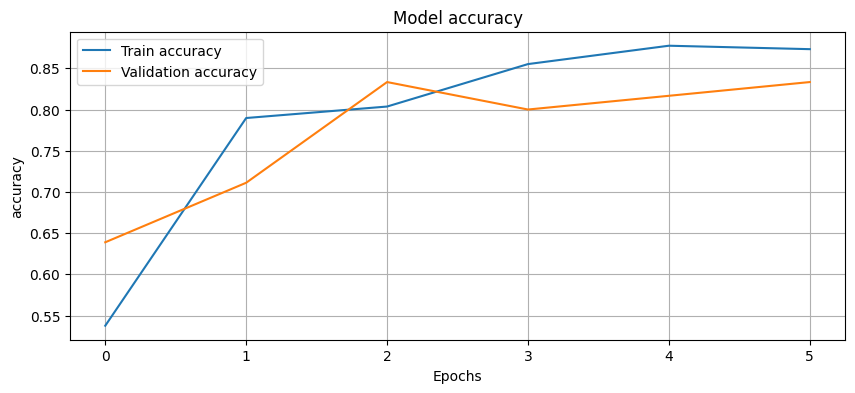

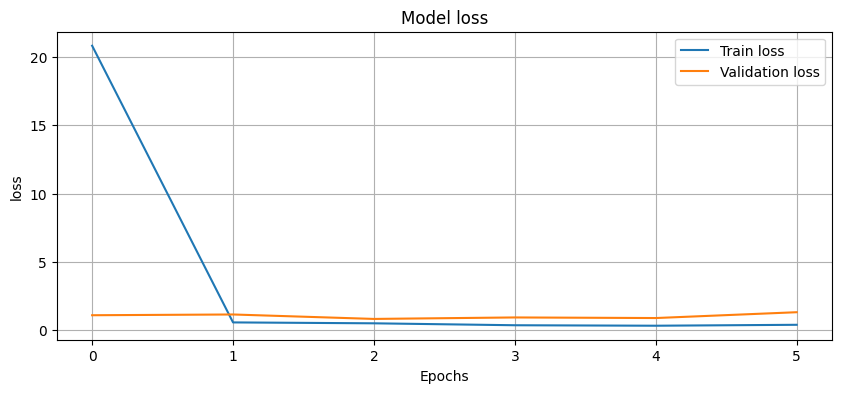

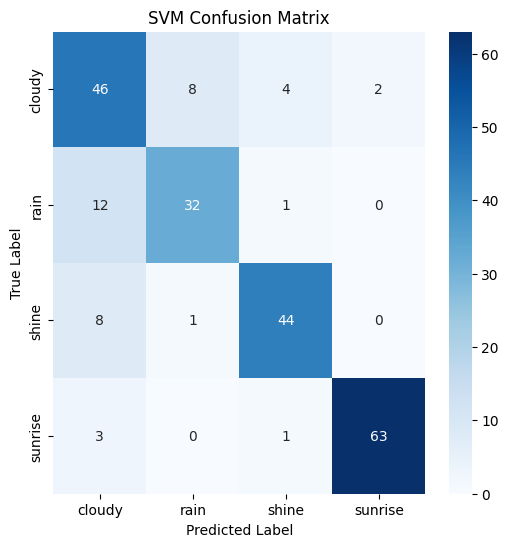

8/8 [==============================] - 1s 126ms/step


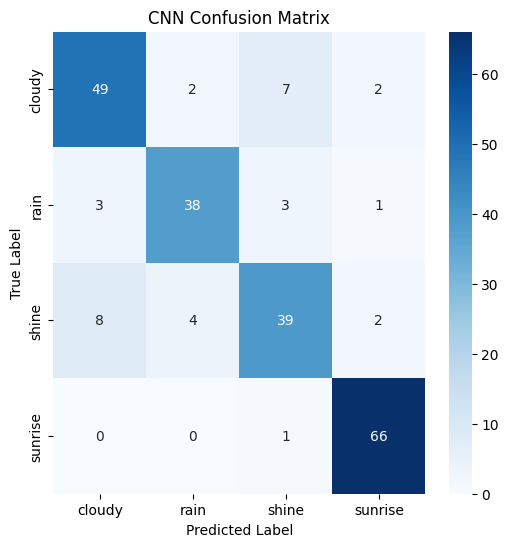

SVM Accuracy: 0.8311111111111111
              precision    recall  f1-score   support

      cloudy       0.68      0.78      0.73        60
        rain       0.80      0.73      0.77        45
       shine       0.88      0.83      0.85        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.83       225
weighted avg       0.84      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 15s 604ms/step - loss: 39.6625 - accuracy: 0.4039 - val_loss: 0.9148 - val_accuracy: 0.5444
Epoch 2/10
23/23 [==============================] - 13s 556ms/step - loss: 0.7226 - accuracy: 0.6797 - val_loss: 1.0070 - val_accuracy: 0.7111
Epoch 3/10
23/23 [==============================] - 12s 527ms/step - loss: 0.6372 - accuracy: 0.7312 - val_loss: 1.1448 - val_accuracy: 0.7611
Epoch 4/10
23/23 [==============================] - 13s 549ms/step - loss: 0.5330 - accuracy: 0.8022 -

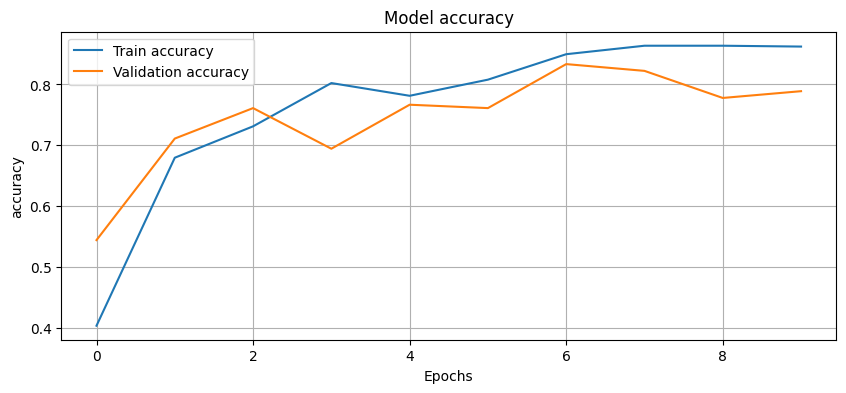

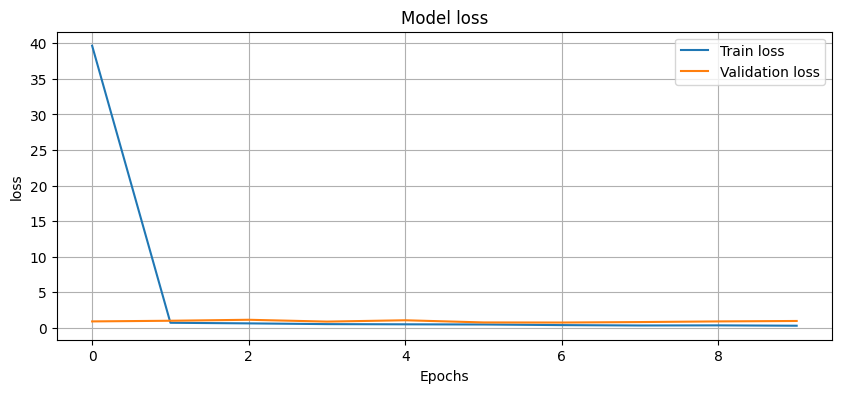

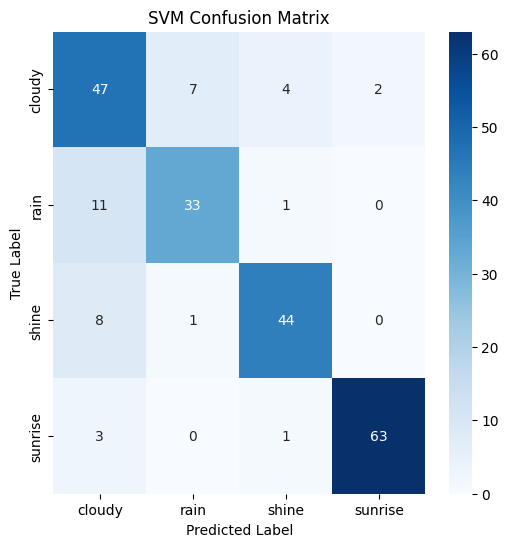

8/8 [==============================] - 2s 179ms/step


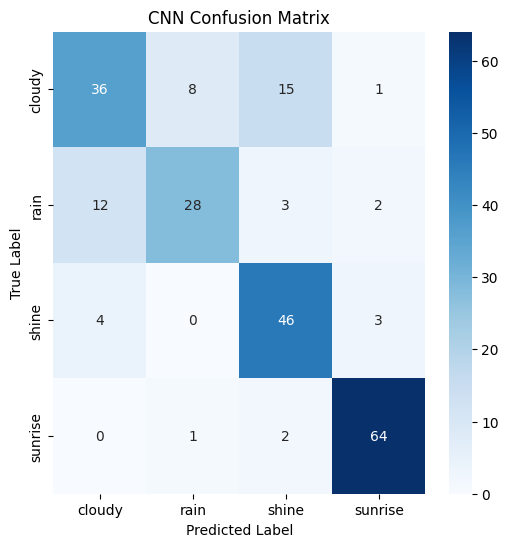

SVM Accuracy: 0.8266666666666667
              precision    recall  f1-score   support

      cloudy       0.68      0.77      0.72        60
        rain       0.79      0.76      0.77        45
       shine       0.88      0.81      0.84        53
     sunrise       0.97      0.94      0.95        67

    accuracy                           0.83       225
   macro avg       0.83      0.82      0.82       225
weighted avg       0.83      0.83      0.83       225

Epoch 1/10
23/23 [==============================] - 14s 578ms/step - loss: 35.4544 - accuracy: 0.4109 - val_loss: 1.0470 - val_accuracy: 0.6222
Epoch 2/10
23/23 [==============================] - 14s 596ms/step - loss: 0.7438 - accuracy: 0.6852 - val_loss: 1.1626 - val_accuracy: 0.7611
Epoch 3/10
23/23 [==============================] - 14s 593ms/step - loss: 0.7067 - accuracy: 0.7604 - val_loss: 0.8082 - val_accuracy: 0.7833
Epoch 4/10
23/23 [==============================] - 14s 596ms/step - loss: 0.6171 - accuracy: 0.7883 -

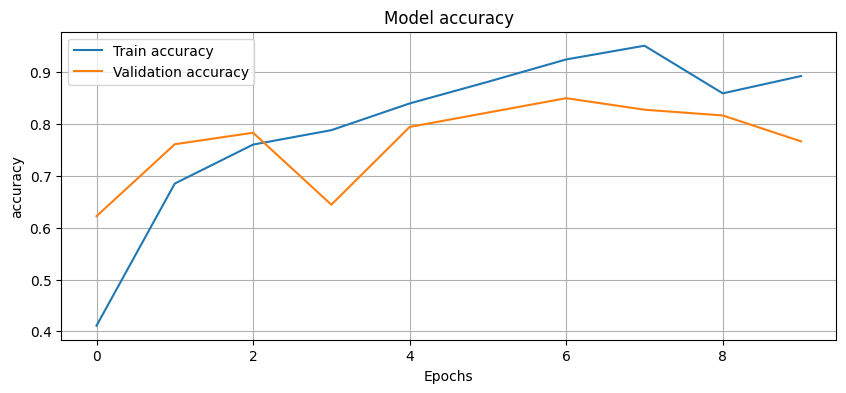

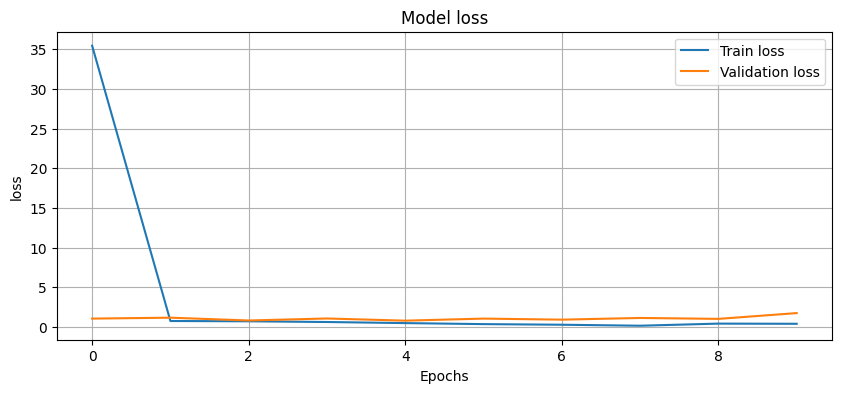

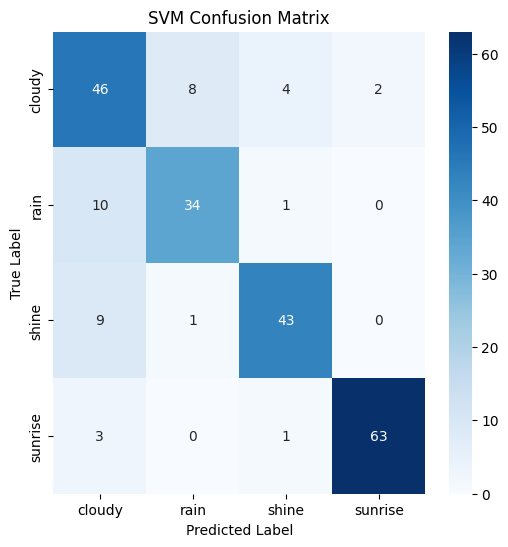

8/8 [==============================] - 1s 173ms/step


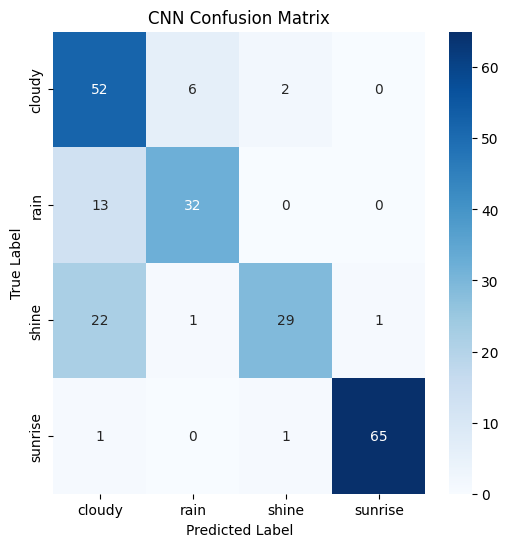

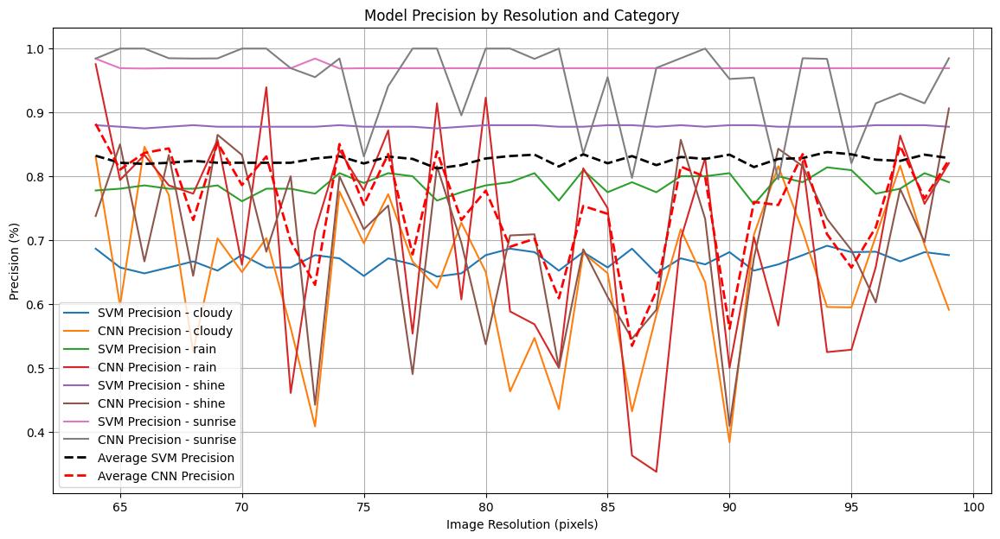

In [89]:
def plot_metrics(history, metric='accuracy', val_metric='val_accuracy'):
    plt.figure(figsize=(10, 4))
    plt.plot(history.history[metric], label='Train ' + metric)
    plt.plot(history.history[val_metric], label='Validation ' + metric)
    plt.title('Model ' + metric)
    plt.ylabel(metric)
    plt.xlabel('Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

def train_and_evaluate_models(source_folder, target_size=(64, 64)):
    categories = ['rain', 'cloudy', 'shine', 'sunrise']
    data = []
    labels = []

    # Load and preprocess images
    for category in categories:
        category_path = os.path.join(source_folder, category)
        for image_name in os.listdir(category_path):
            image_path = os.path.join(category_path, image_name)
            image = cv2.imread(image_path)
            if image is not None:
                resized_image = cv2.resize(image, target_size)
                data.append(resized_image)  # Do not flatten, keep as 3D array
                labels.append(category)

    # Encode labels
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)

    # Split data
    X_train, X_test, y_train, y_test = train_test_split(
        np.array(data), encoded_labels, test_size=0.2, random_state=42)

    # SVM model
    svm_model = svm.SVC(kernel='linear')
    svm_model.fit(X_train.reshape(X_train.shape[0], -1), y_train)  # Flatten here for SVM
    svm_predictions = svm_model.predict(X_test.reshape(X_test.shape[0], -1))  # Flatten here for SVM
    svm_accuracy = accuracy_score(y_test, svm_predictions)
    svm_report = precision_recall_fscore_support(y_test, svm_predictions, average=None, labels=[0,1,2,3])
    print(f"SVM Accuracy: {svm_accuracy}")
    print(classification_report(y_test, svm_predictions, target_names=label_encoder.classes_))
    early_stopping = EarlyStopping(monitor='val_accuracy', patience=3)
    # CNN model
    cnn_model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(target_size[0], target_size[1], 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(len(categories), activation='softmax')
    ])

    cnn_model.compile(optimizer='adam',
                      loss='sparse_categorical_crossentropy',
                      metrics=['accuracy'])

    # Train CNN
    history = cnn_model.fit(X_train, y_train, epochs=10, validation_split=0.2, callbacks=[early_stopping])
    cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test, y_test)
    print(f"CNN Accuracy: {cnn_accuracy}")

    # Plot accuracy and loss
    plot_metrics(history, 'accuracy', 'val_accuracy')
    plot_metrics(history, 'loss', 'val_loss')

    # Confusion matrices
    svm_cm = confusion_matrix(y_test, svm_predictions)
    plot_confusion_matrix(svm_cm, label_encoder.classes_, "SVM Confusion Matrix")

    cnn_predictions = cnn_model.predict(X_test)
    cnn_predictions = np.argmax(cnn_predictions, axis=1)
    cnn_report = precision_recall_fscore_support(y_test, cnn_predictions, average=None, labels=[0,1,2,3])
    cnn_cm = confusion_matrix(y_test, cnn_predictions)
    plot_confusion_matrix(cnn_cm, label_encoder.classes_, "CNN Confusion Matrix")

    return svm_report, cnn_report, label_encoder.classes_

# Collecting accuracies
svm_results = []
cnn_results = []
resolutions = range(64, 100)  # Change range as needed
labels = []

for i in resolutions:
    svm_report, cnn_report, classes = train_and_evaluate_models('/content/drive/MyDrive/WeatherImageDataset', (i, i))
    svm_results.append(svm_report)
    cnn_results.append(cnn_report)
    labels = classes  # Save label names for later use

# Plotting
plt.figure(figsize=(14, 7))

for i, category in enumerate(labels):
    category_accuracies_svm = [result[0][i] for result in svm_results]  # Precision values for SVM
    category_accuracies_cnn = [result[0][i] for result in cnn_results]  # Precision values for CNN
    plt.plot(resolutions, category_accuracies_svm, label=f'SVM Precision - {category}')
    plt.plot(resolutions, category_accuracies_cnn, label=f'CNN Precision - {category}')


# Calculate and plot average precision across all categories for each resolution
average_precision_svm = [np.mean([result[0][j] for j in range(len(labels))]) for result in svm_results]
average_precision_cnn = [np.mean([result[0][j] for j in range(len(labels))]) for result in cnn_results]
plt.plot(resolutions, average_precision_svm, 'k--', label='Average SVM Precision', linewidth=2)
plt.plot(resolutions, average_precision_cnn, 'r--', label='Average CNN Precision', linewidth=2)

plt.xlabel('Image Resolution (pixels)')
plt.ylabel('Precision (%)')
plt.title('Model Precision by Resolution and Category')
plt.legend()
plt.grid(True)
plt.show()